## Import libraries

In [1]:
# Python libraries
import os
import sys
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
import tensorflow as tf
from sklearn.model_selection import train_test_split
from datetime import datetime
import time

# Plotting
import matplotlib.pyplot as plt

# To enable LaTeX and select a font
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": "Helvetica",
})

# Using ipynb import functions defined in other nb
sys.path.append("myfun/")
from ipynb.fs.defs.myfun_load_dataset import *
from ipynb.fs.full.myfun_model_nn import *
from ipynb.fs.defs.myfun_plot import *

2024-02-08 20:33:30.363662: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-08 20:33:30.363722: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-08 20:33:30.392572: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-08 20:33:30.463767: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-08 20:33:31.538973: W tensorflow/compiler/tf2

## Data Acquisition

In [2]:
# Load the dataset
par_dir = os.path.dirname(os.getcwd()) # parent dir
dir_name = par_dir + "/NN-interaction"

In [3]:
processed_flag = 'pre'
# load the data
_, dflist = load_dataset(dir_name, processed_flag)
dataset = dflist

print(f"In this dataset we have {np.sum([d.shape[0] for d in dataset])} scenes")

In this dataset we have 671 scenes


## Params

In [4]:
DOE =[1,1,1,1] #Design of experiment

In [5]:
v0 = 30
NUM_ITER = 500
LEARNING_RATE_v0 = 0.5
test = 0.9

plot_flag = True
flag_save = True

----------------------------------------------------------------------------------------------------
Analyzing 10 dfs. NN structure: 1-1-1-1
****************************************************************************************************
Analyzing 1/10 dfs.
In DataFrame n.1 we have 109 scenes.
    To train the model we use 10 scenes, the remaining 99 to test the model.

Training step. (10 scenes)
DataFrame n.1. Scene n.1/10
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [531.64,533.24]


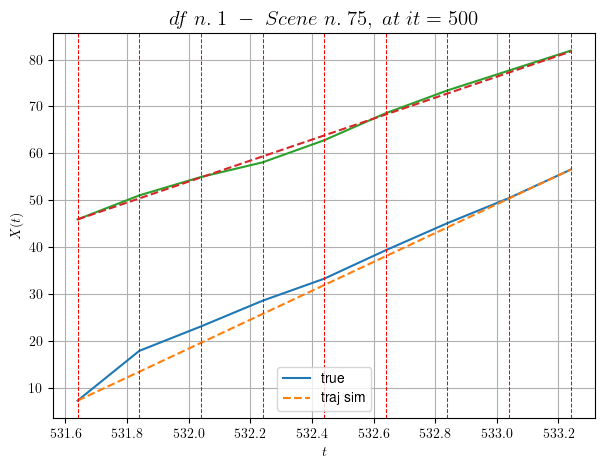

----------------------------------------------------------------------------------------------------
        For scene 1/10:
        * After LR finder: LR_NN=0.0001 with mse=26.818062386321404 at it=24
        * v0 = 22.38264840590196
        * MSE = 2.6676472088597984
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/10
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [148.04,148.44]


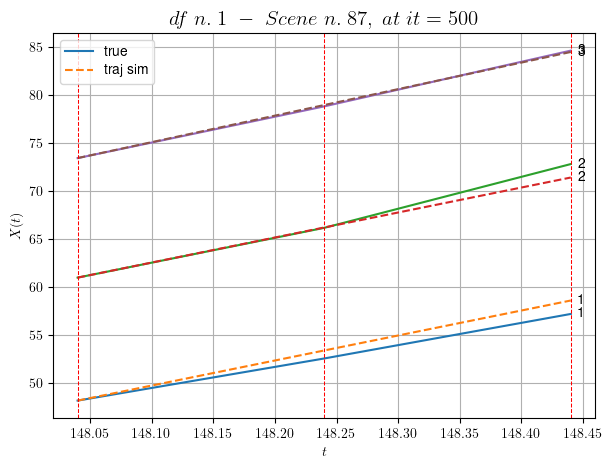

----------------------------------------------------------------------------------------------------
        For scene 2/10:
        * After LR finder: LR_NN=0.0005 with mse=0.9294670714563358 at it=24
        * v0 = 27.621656721216034
        * MSE = 0.516753734190857
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/10
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


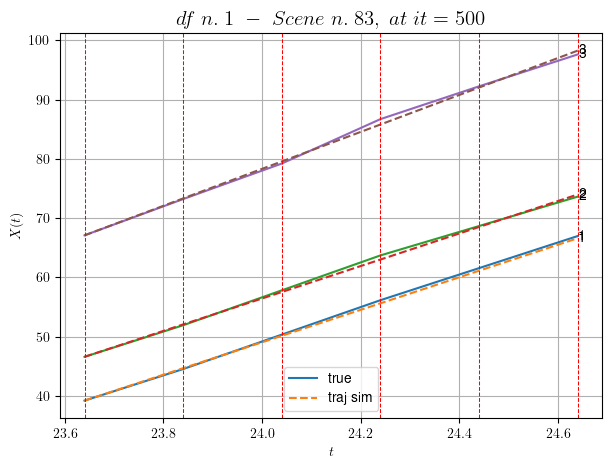

----------------------------------------------------------------------------------------------------
        For scene 3/10:
        * After LR finder: LR_NN=0.001 with mse=0.3561580394623575 at it=24
        * v0 = 31.1844205658401
        * MSE = 0.15653089266454112
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/10
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [159.84,160.64]


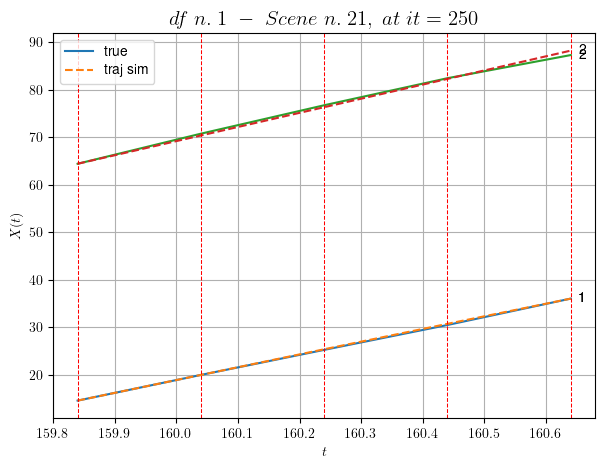

----------------------------------------------------------------------------------------------------
        For scene 4/10:
        * After LR finder: LR_NN=0.005 with mse=0.15292978201837207 at it=24
        * v0 = 29.799065986142246
        * MSE = 0.12893858364745217
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/10
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [429.24,429.84]


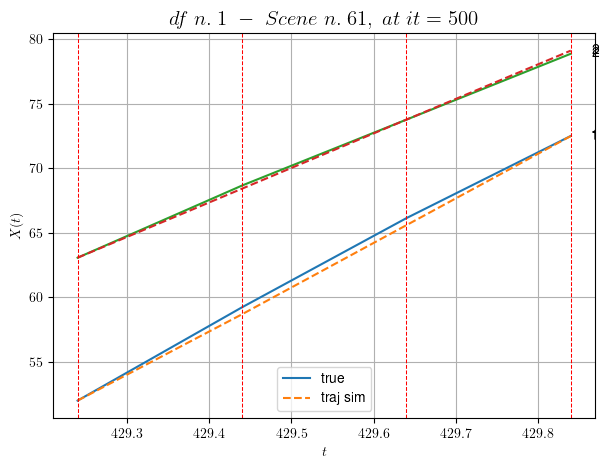

----------------------------------------------------------------------------------------------------
        For scene 5/10:
        * After LR finder: LR_NN=0.005 with mse=0.9270490434329925 at it=24
        * v0 = 26.764923514729645
        * MSE = 0.08704864803757541
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/10
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [489.04,489.84]


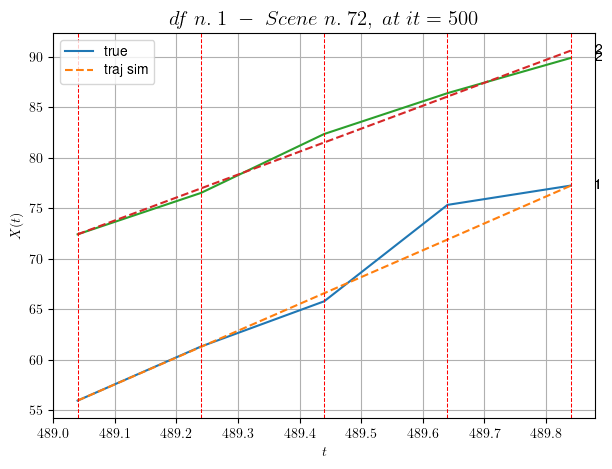

----------------------------------------------------------------------------------------------------
        For scene 6/10:
        * After LR finder: LR_NN=0.0001 with mse=7.580635166552003 at it=24
        * v0 = 22.729734196718866
        * MSE = 1.2770614655215966
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/10
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [116.04,117.04]


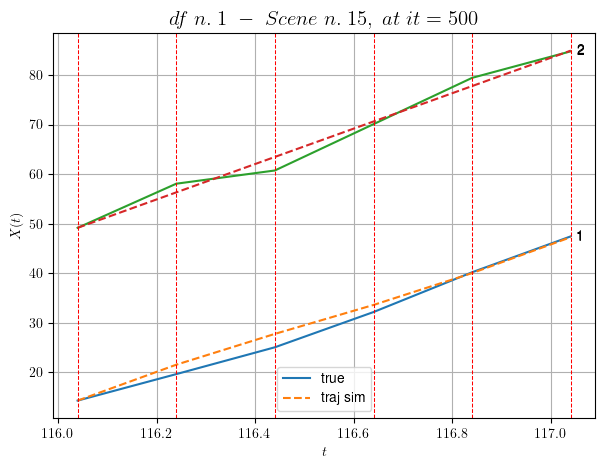

----------------------------------------------------------------------------------------------------
        For scene 7/10:
        * After LR finder: LR_NN=0.01 with mse=7.746748848598358 at it=24
        * v0 = 35.75445949476077
        * MSE = 1.6085021100786587
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/10
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [253.64,254.04]


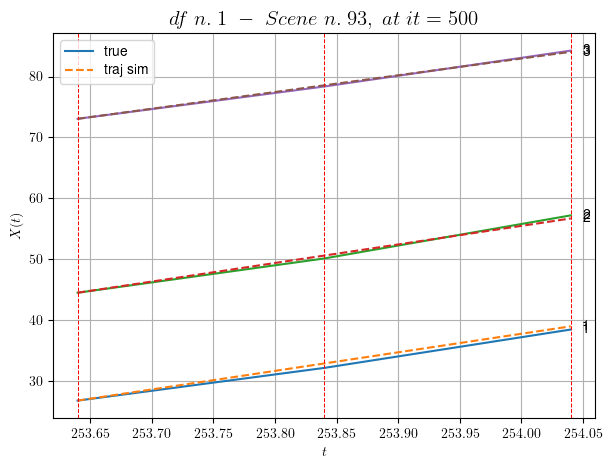

----------------------------------------------------------------------------------------------------
        For scene 8/10:
        * After LR finder: LR_NN=5e-05 with mse=1.591735435524954 at it=24
        * v0 = 27.474879582348542
        * MSE = 0.1522620148106125
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/10
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [358.84,359.64]


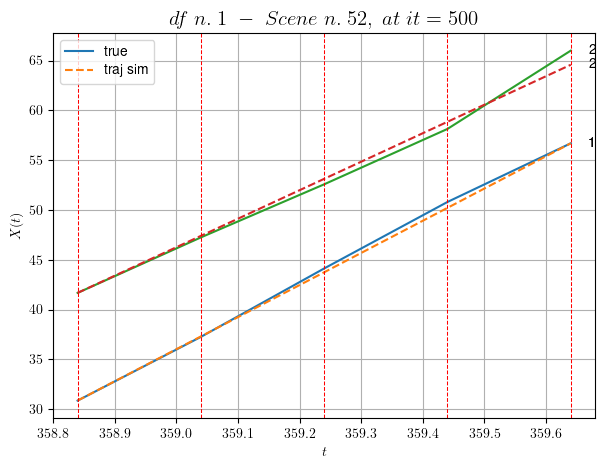

----------------------------------------------------------------------------------------------------
        For scene 9/10:
        * After LR finder: LR_NN=0.001 with mse=1.2834411885863959 at it=24
        * v0 = 28.626441976919647
        * MSE = 0.32416557309217625
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/10
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [495.84,496.24]


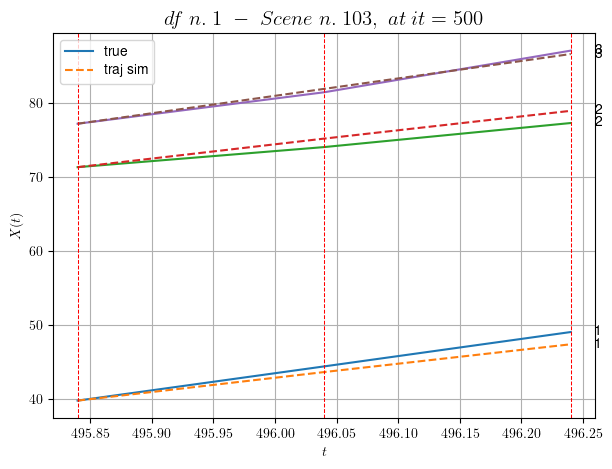

----------------------------------------------------------------------------------------------------
        For scene 10/10:
        * After LR finder: LR_NN=0.01 with mse=1.6460698640233389 at it=24
        * v0 = 23.563093490872426
        * MSE = 0.8630996471061484
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.7782009878009417
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (99 scenes)
DataFrame n.1. Scene n.1/99


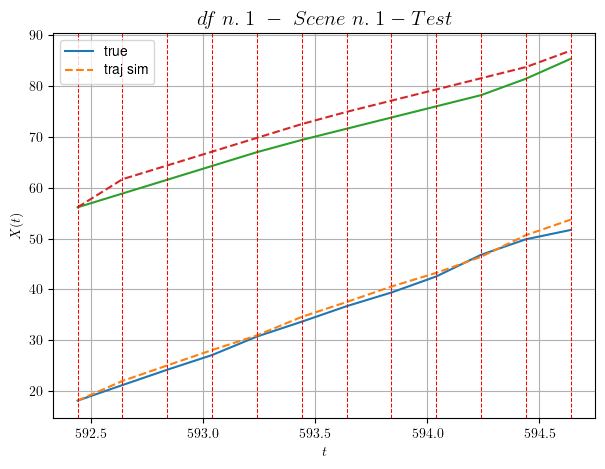

        For scene 1/99:
        * MSE = 4.32719175391516
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/99


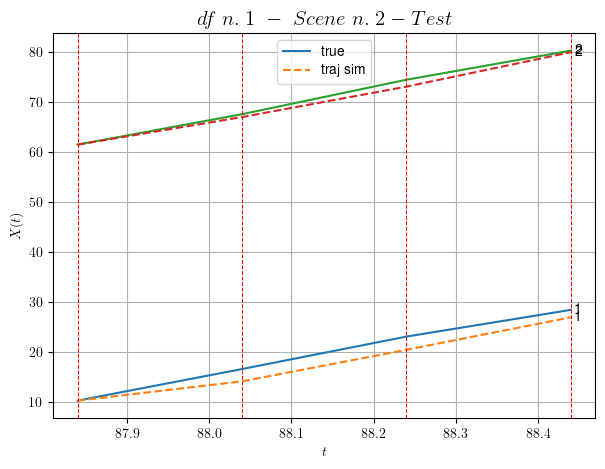

        For scene 2/99:
        * MSE = 2.196153382702019
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/99


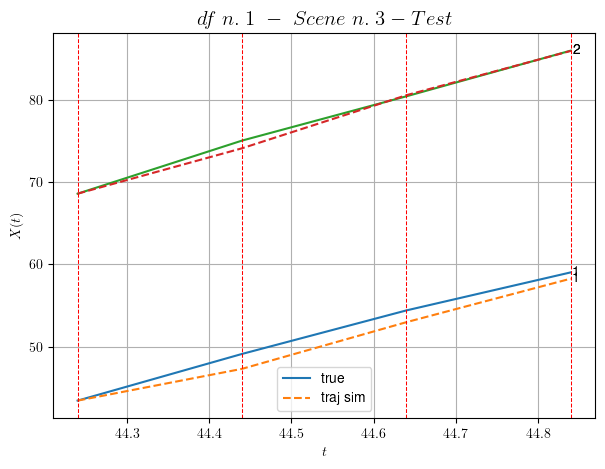

        For scene 3/99:
        * MSE = 0.849763519409524
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/99


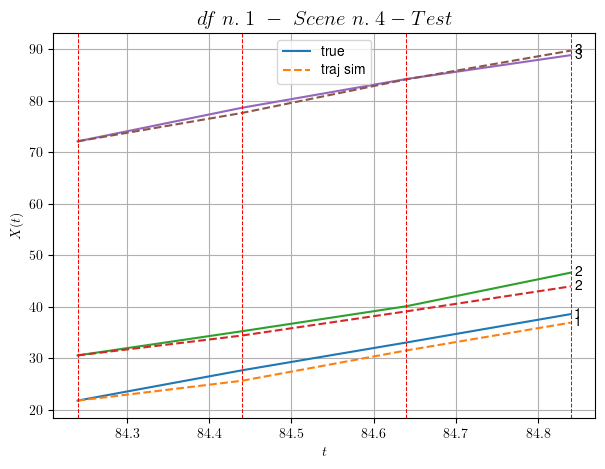

        For scene 4/99:
        * MSE = 1.6543329239868327
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/99


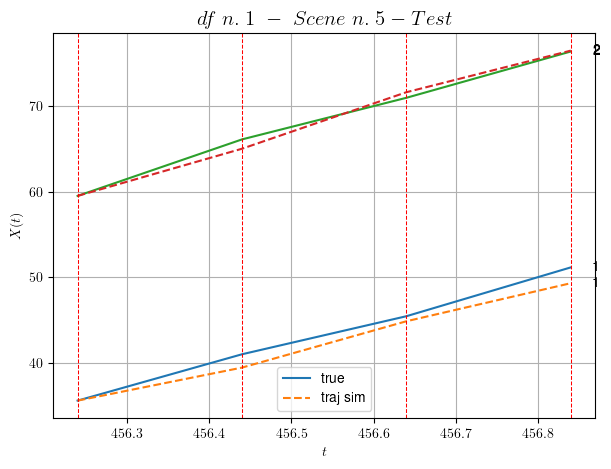

        For scene 5/99:
        * MSE = 0.9777171268924729
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/99


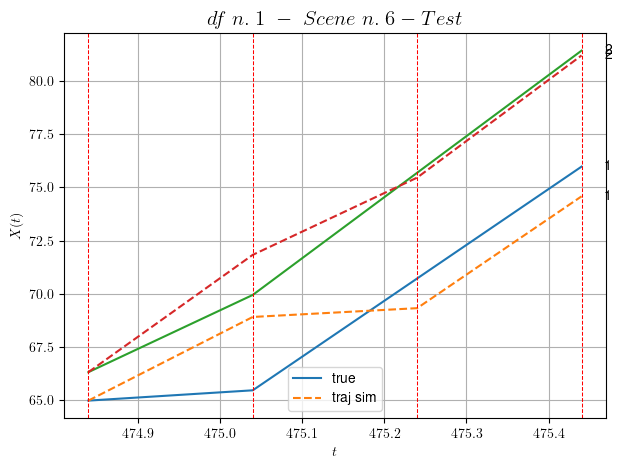

        For scene 6/99:
        * MSE = 2.4333143984345815
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/99


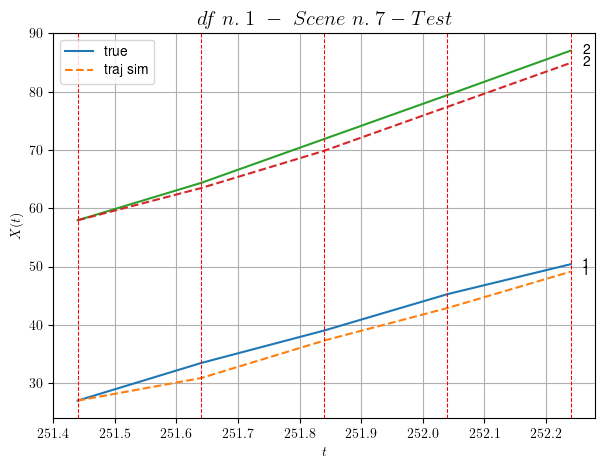

        For scene 7/99:
        * MSE = 3.0287702191220705
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/99


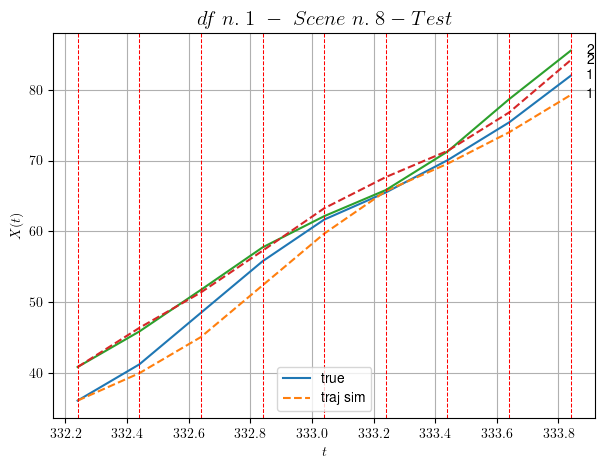

        For scene 8/99:
        * MSE = 2.7145641190747978
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/99


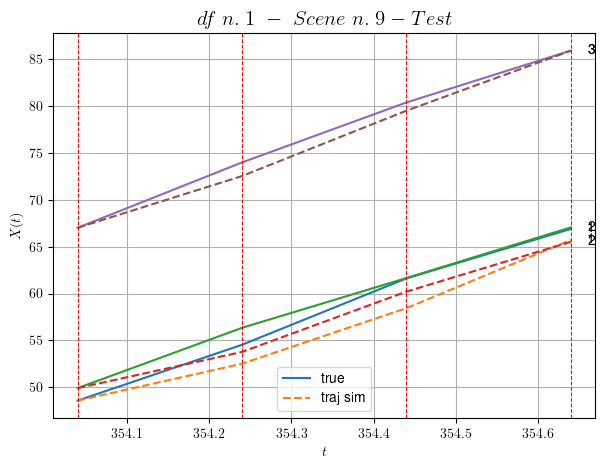

        For scene 9/99:
        * MSE = 2.45600360755118
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/99


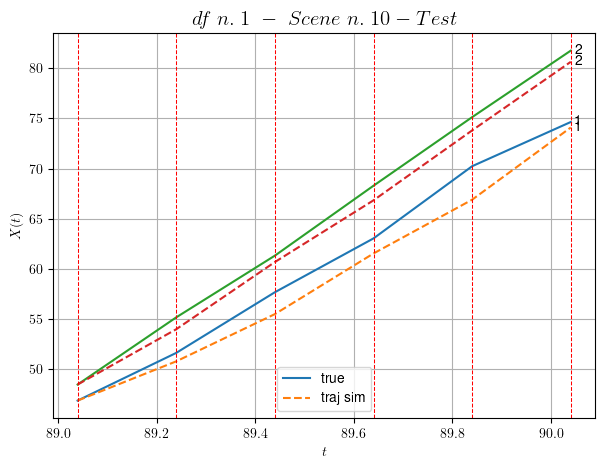

        For scene 10/99:
        * MSE = 2.175682372926015
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/99


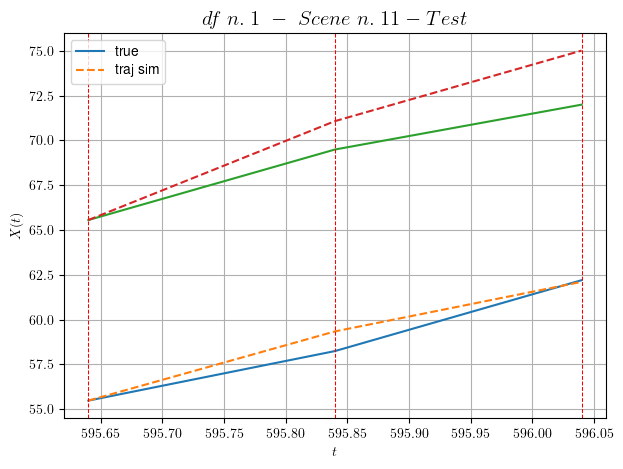

        For scene 11/99:
        * MSE = 2.1358133592685116
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/99


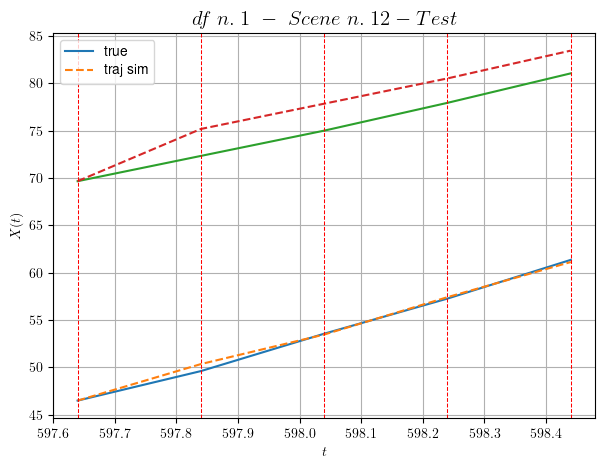

        For scene 12/99:
        * MSE = 2.928435315728683
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/99


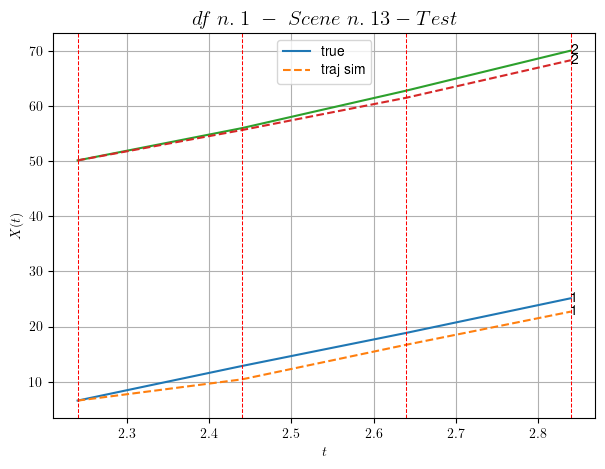

        For scene 13/99:
        * MSE = 2.6605149352205033
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/99


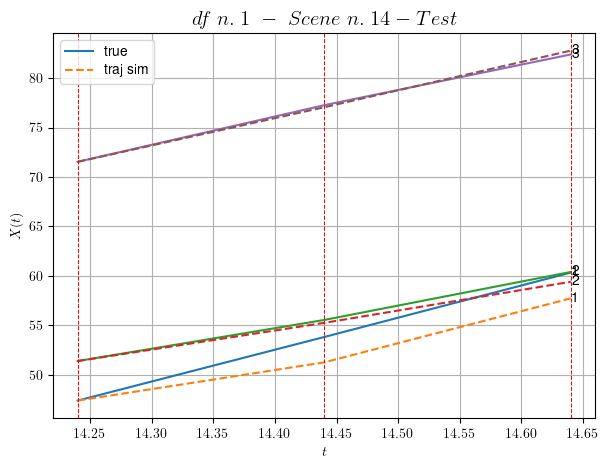

        For scene 14/99:
        * MSE = 1.6241607396081132
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/99


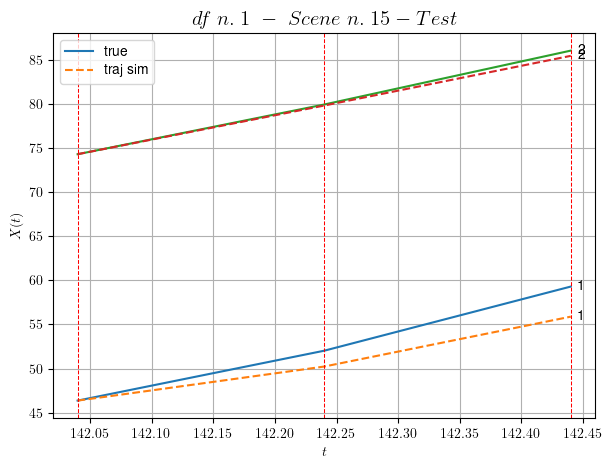

        For scene 15/99:
        * MSE = 2.537523483302193
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/99


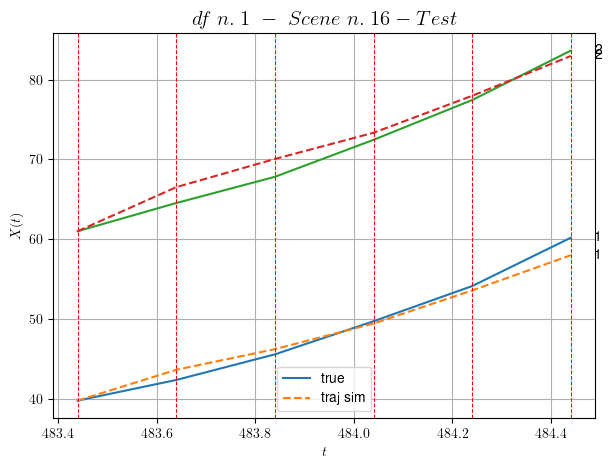

        For scene 16/99:
        * MSE = 1.4761117239630395
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/99


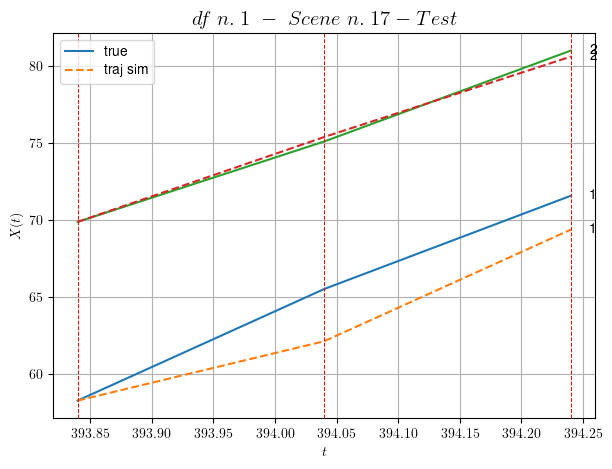

        For scene 17/99:
        * MSE = 2.765930653620309
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/99


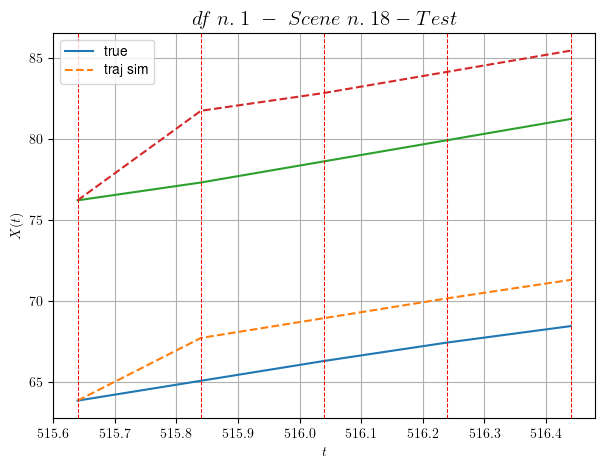

        For scene 18/99:
        * MSE = 10.226416524063387
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/99


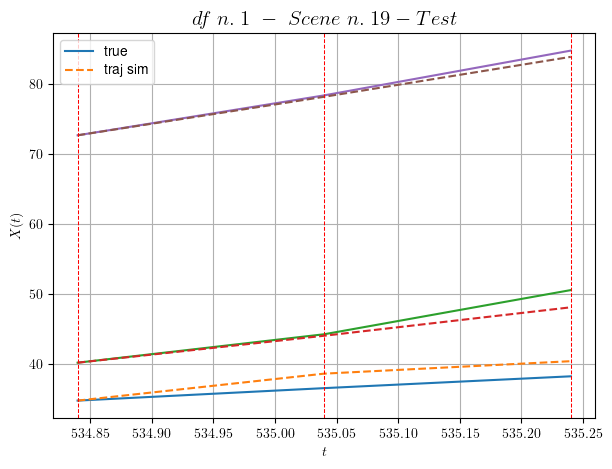

        For scene 19/99:
        * MSE = 1.7743910663570197
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/99


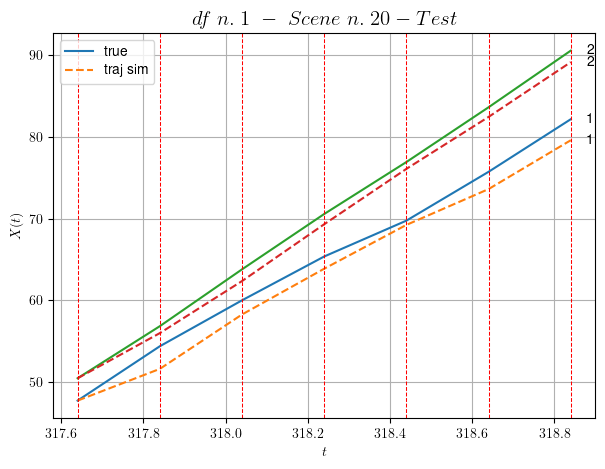

        For scene 20/99:
        * MSE = 2.331550578805283
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/99


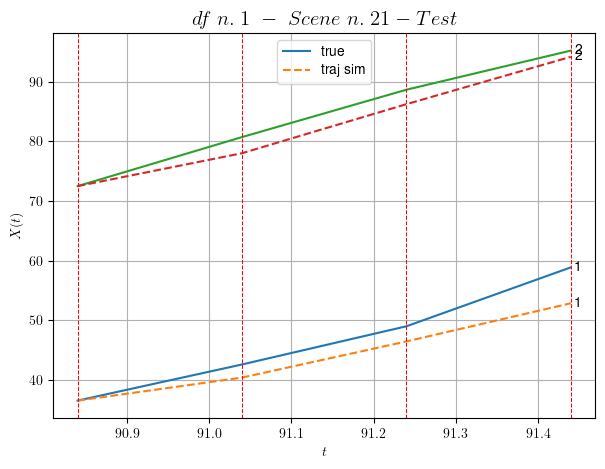

        For scene 21/99:
        * MSE = 7.716816413767606
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/99


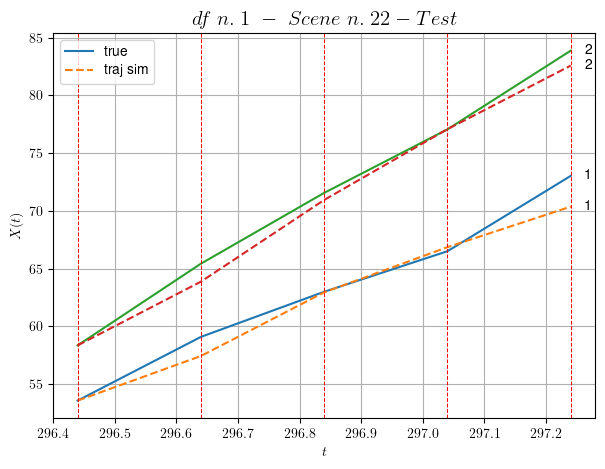

        For scene 22/99:
        * MSE = 1.4438891890370198
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/99


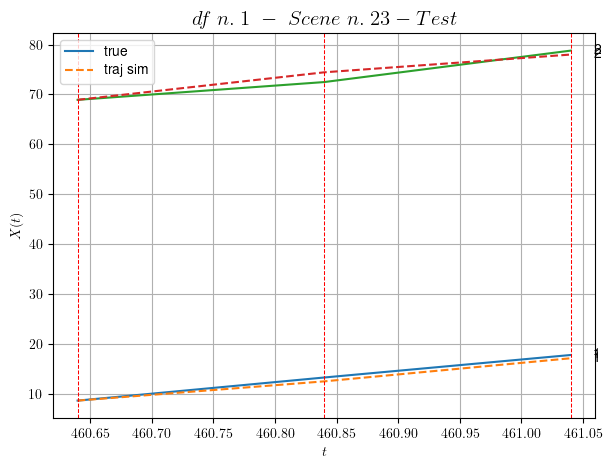

        For scene 23/99:
        * MSE = 0.9108795185431855
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/99


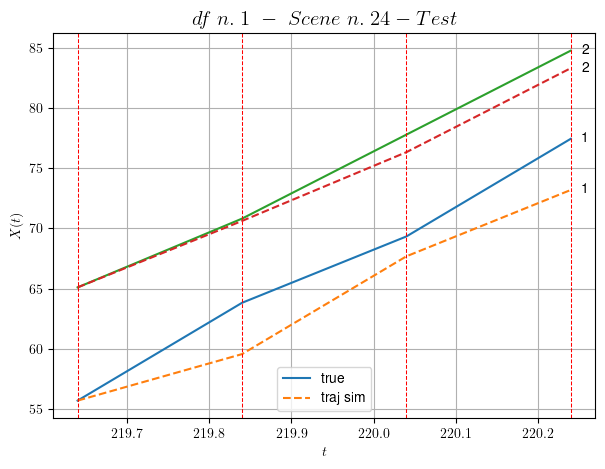

        For scene 24/99:
        * MSE = 5.401403008472328
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/99


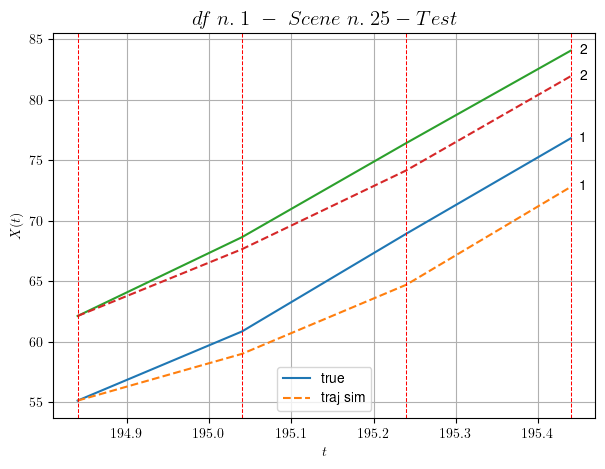

        For scene 25/99:
        * MSE = 5.978638688850103
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/99


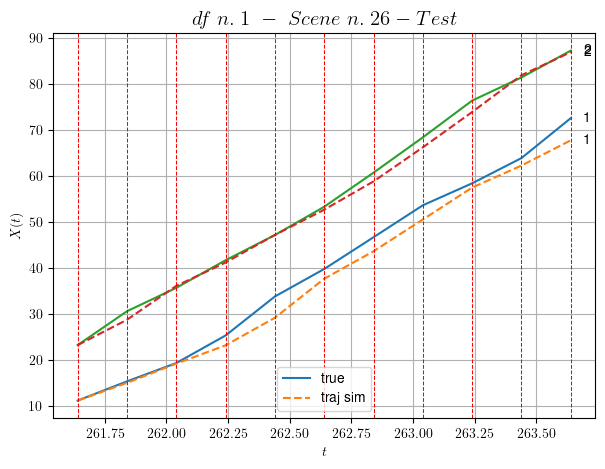

        For scene 26/99:
        * MSE = 4.340825247142829
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/99


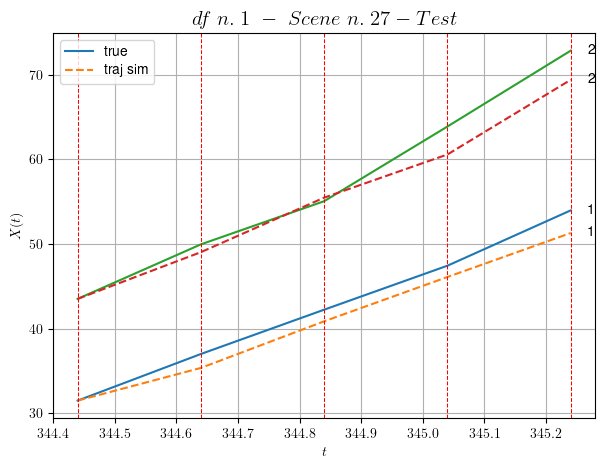

        For scene 27/99:
        * MSE = 3.7308269201245903
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/99


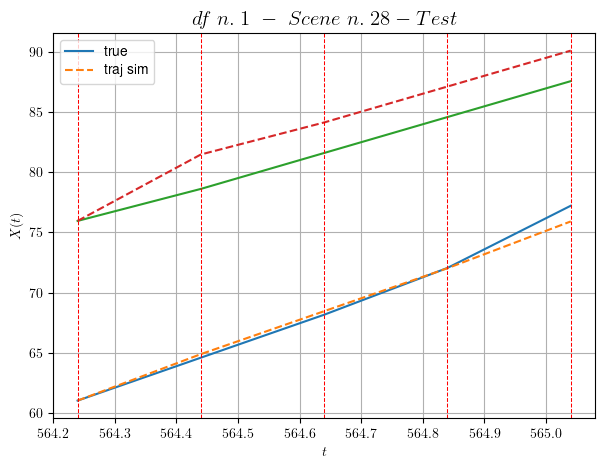

        For scene 28/99:
        * MSE = 2.9325387409566117
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/99


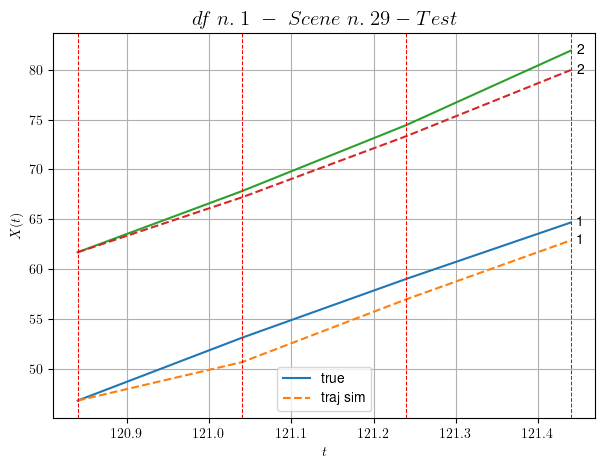

        For scene 29/99:
        * MSE = 2.355678829367929
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/99


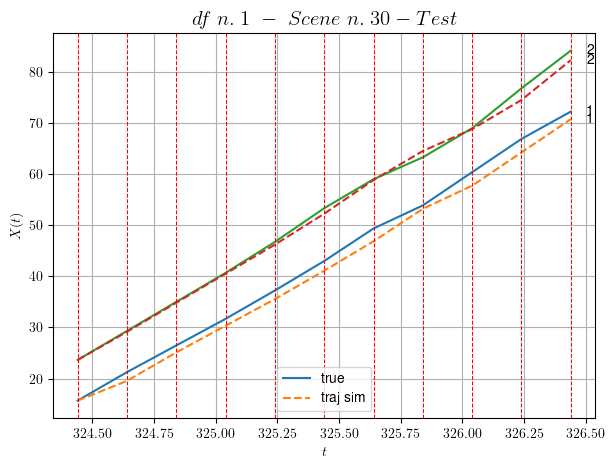

        For scene 30/99:
        * MSE = 2.1695266952926513
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/99


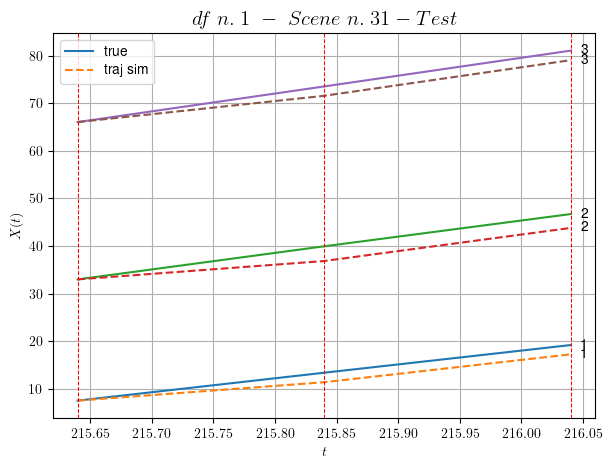

        For scene 31/99:
        * MSE = 3.741633245048122
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/99


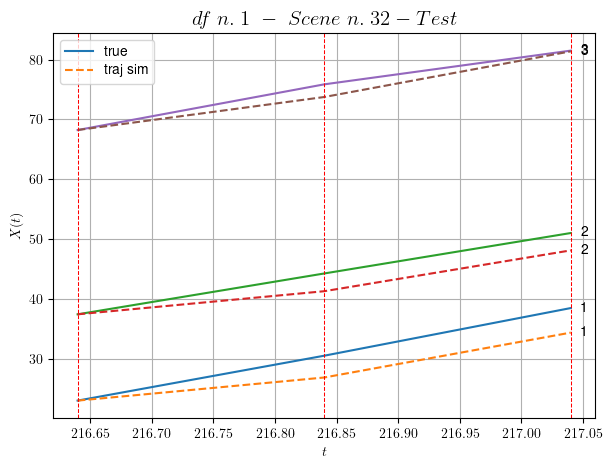

        For scene 32/99:
        * MSE = 5.759213005585342
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/99


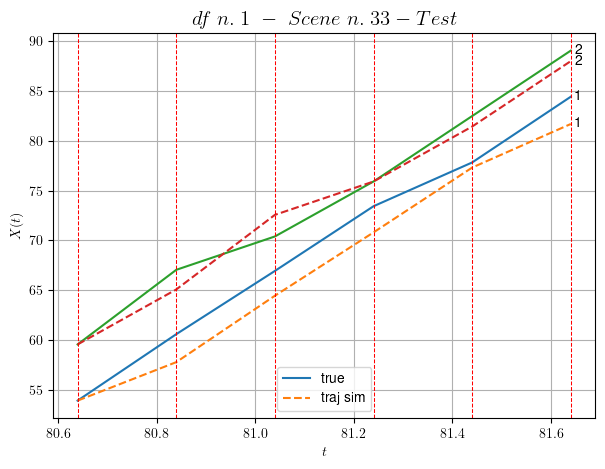

        For scene 33/99:
        * MSE = 3.296141482042599
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/99


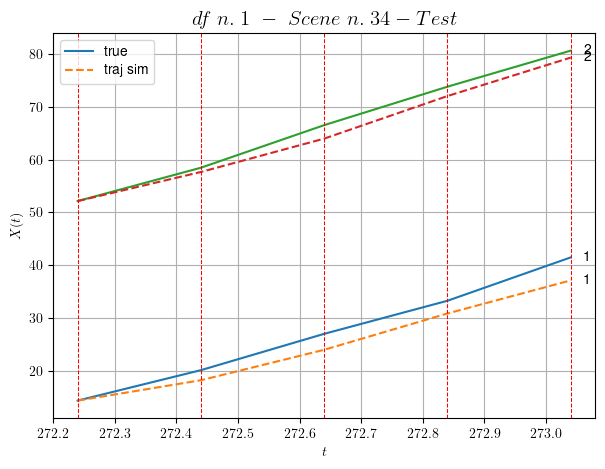

        For scene 34/99:
        * MSE = 4.969930214570777
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/99


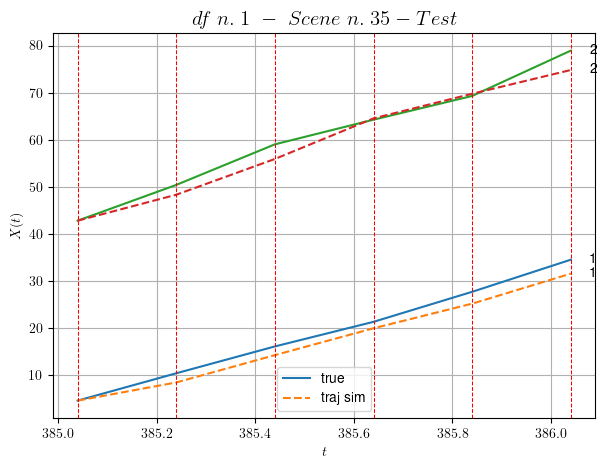

        For scene 35/99:
        * MSE = 4.6357555140620175
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/99


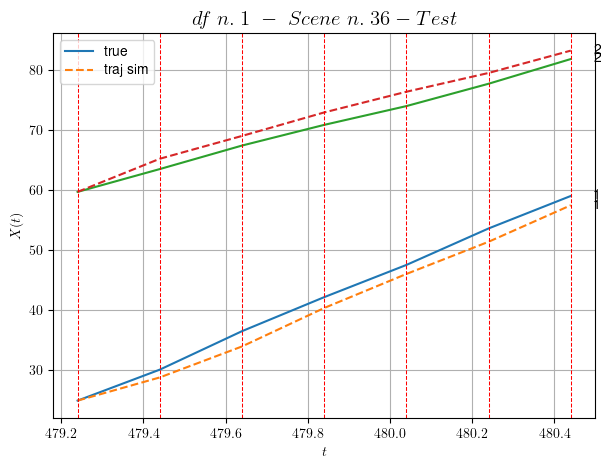

        For scene 36/99:
        * MSE = 2.980327708840647
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.37/99


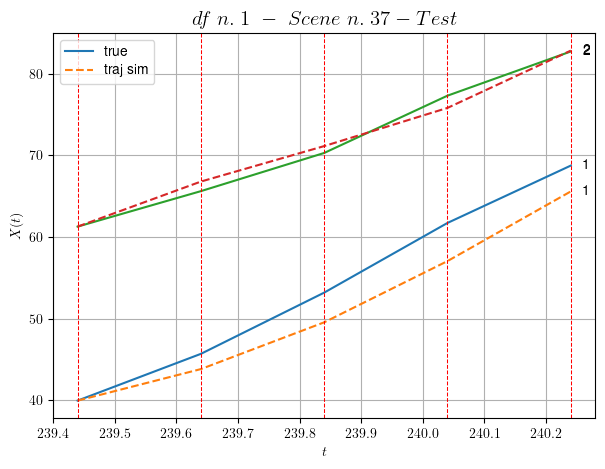

        For scene 37/99:
        * MSE = 5.2890319565593655
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.38/99


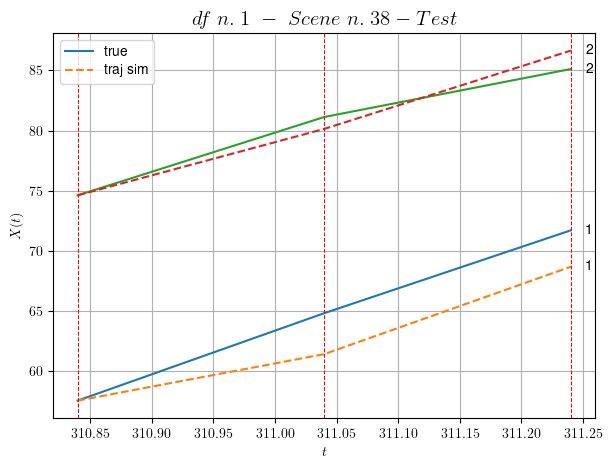

        For scene 38/99:
        * MSE = 4.008620303779776
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.39/99


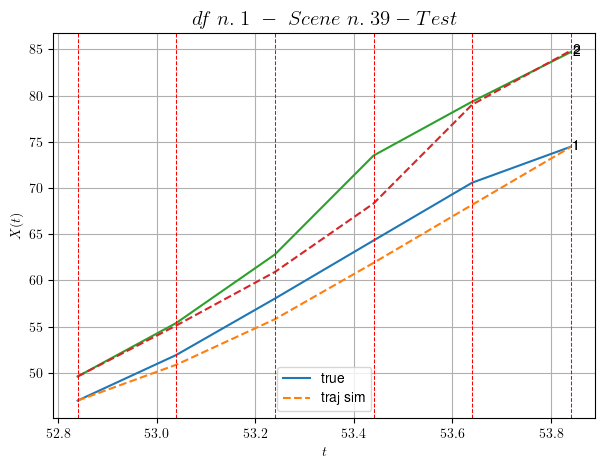

        For scene 39/99:
        * MSE = 4.029016307809378
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.40/99


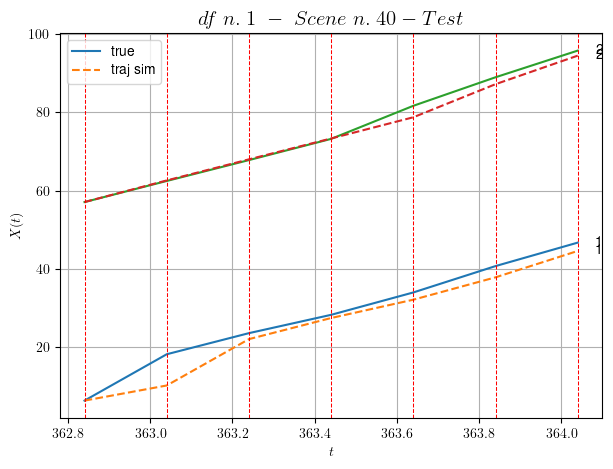

        For scene 40/99:
        * MSE = 6.868725872249809
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.41/99


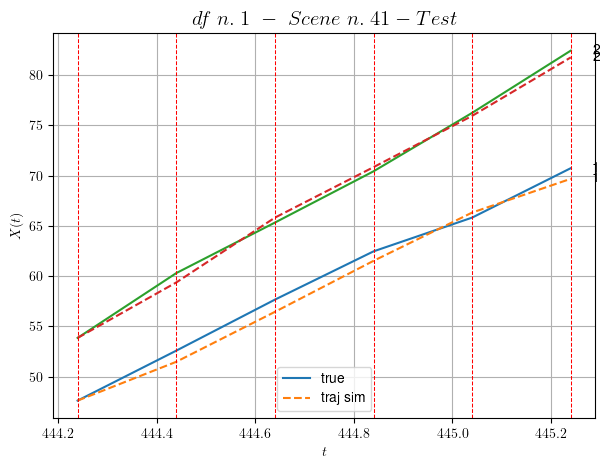

        For scene 41/99:
        * MSE = 0.5658596465999819
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.42/99


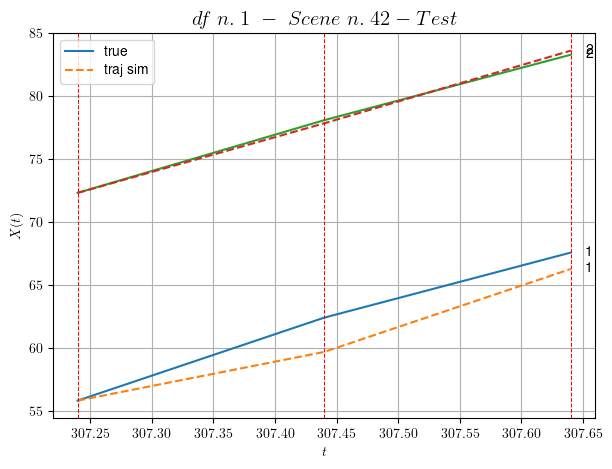

        For scene 42/99:
        * MSE = 1.5429442694938156
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.43/99


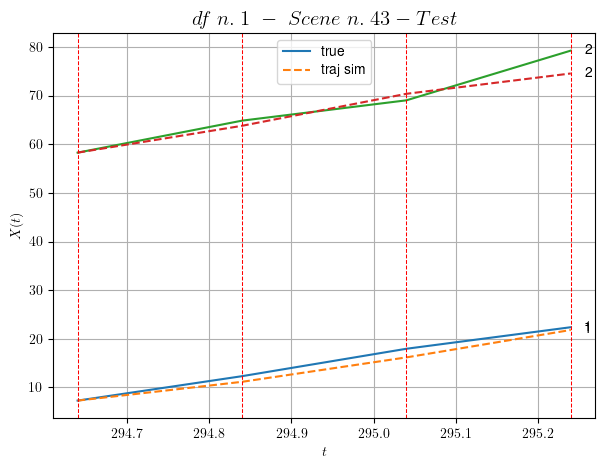

        For scene 43/99:
        * MSE = 3.7226020950416854
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.44/99


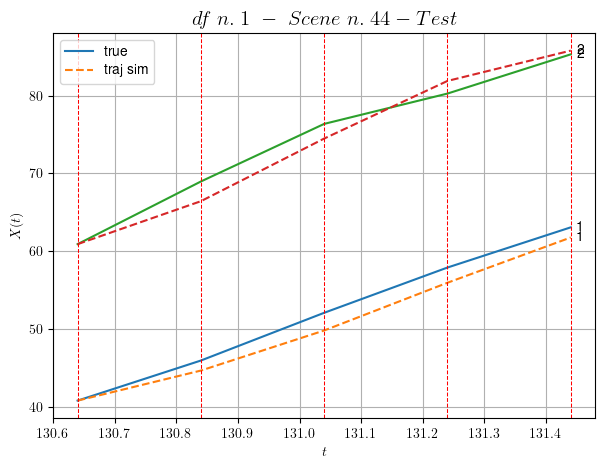

        For scene 44/99:
        * MSE = 2.5166175890444302
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.45/99


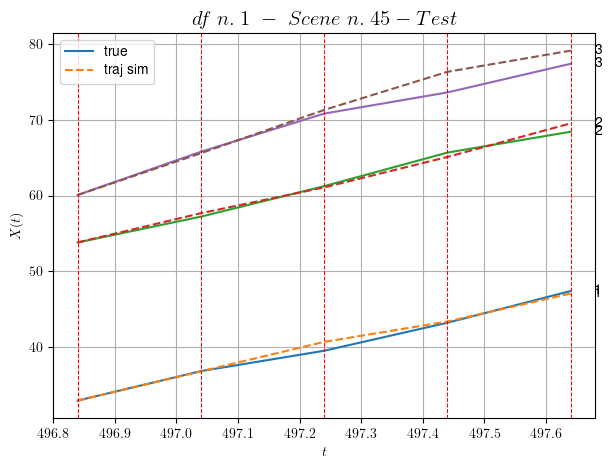

        For scene 45/99:
        * MSE = 0.9312490386237516
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.46/99


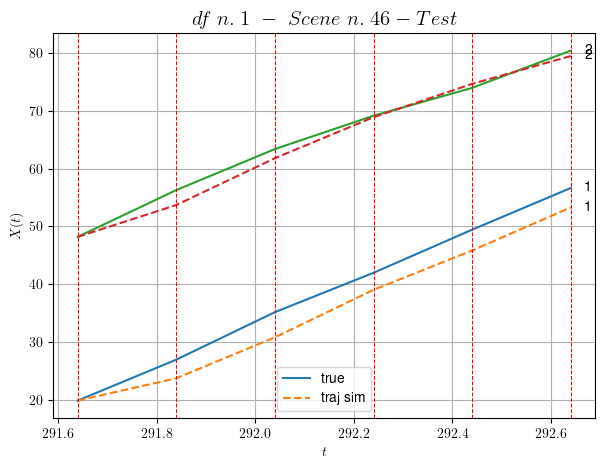

        For scene 46/99:
        * MSE = 6.089726397049457
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.47/99


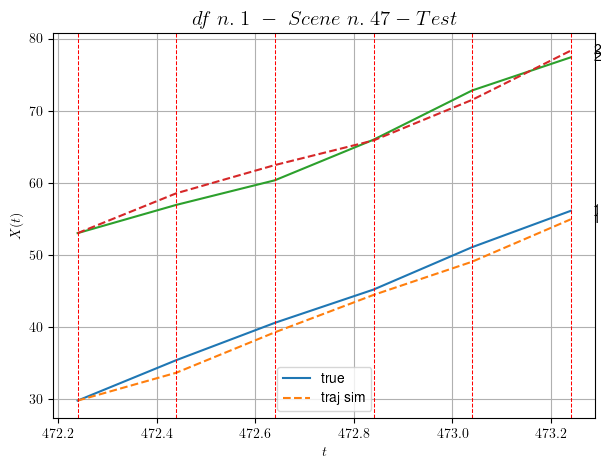

        For scene 47/99:
        * MSE = 1.6948410805497547
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.48/99


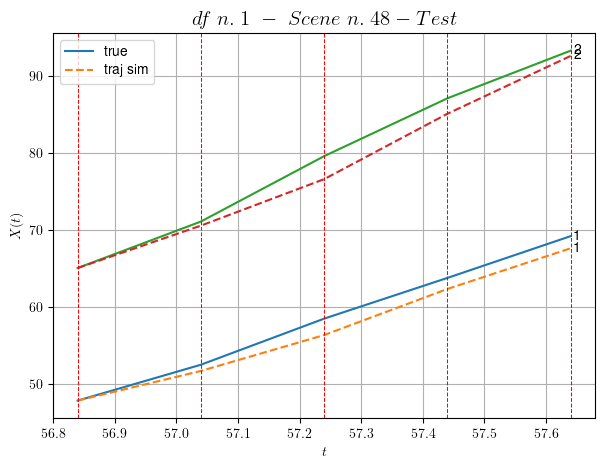

        For scene 48/99:
        * MSE = 2.353474777560941
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.49/99


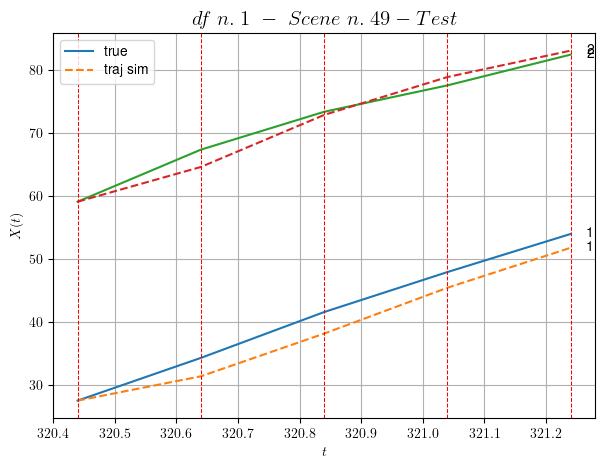

        For scene 49/99:
        * MSE = 4.121642413842553
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.50/99


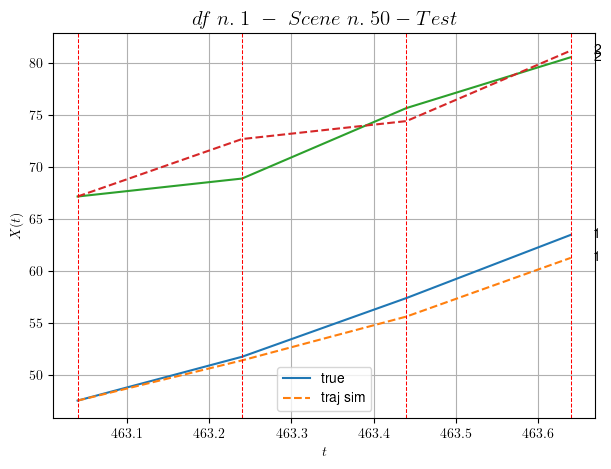

        For scene 50/99:
        * MSE = 3.0651181432044474
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.51/99


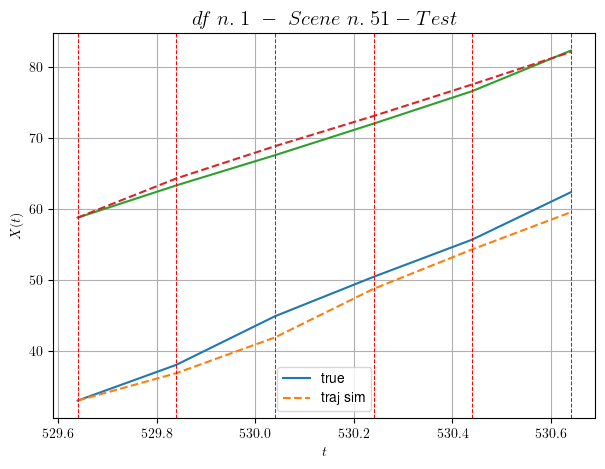

        For scene 51/99:
        * MSE = 2.294323641751324
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.52/99


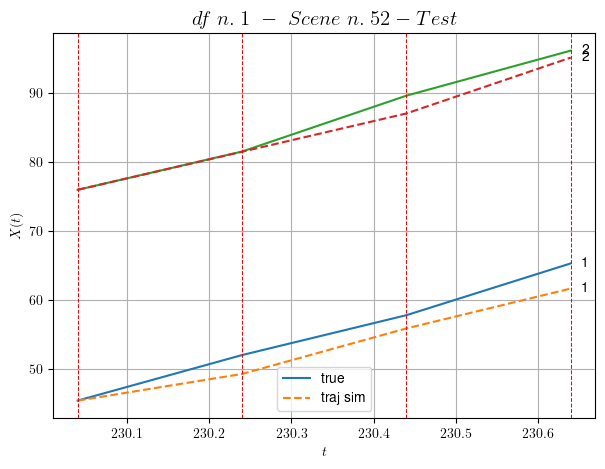

        For scene 52/99:
        * MSE = 4.016263219434363
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.53/99


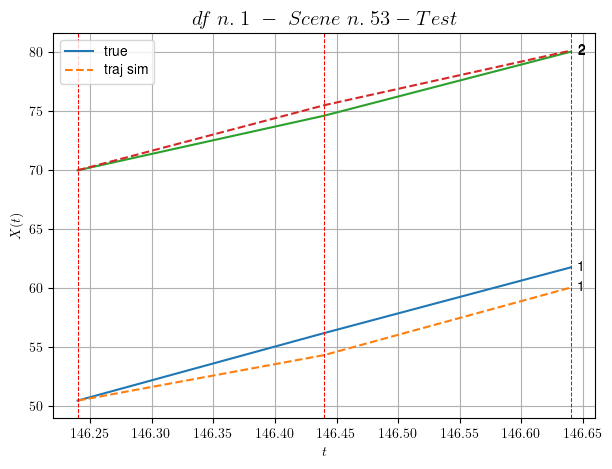

        For scene 53/99:
        * MSE = 1.19924384423027
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.54/99


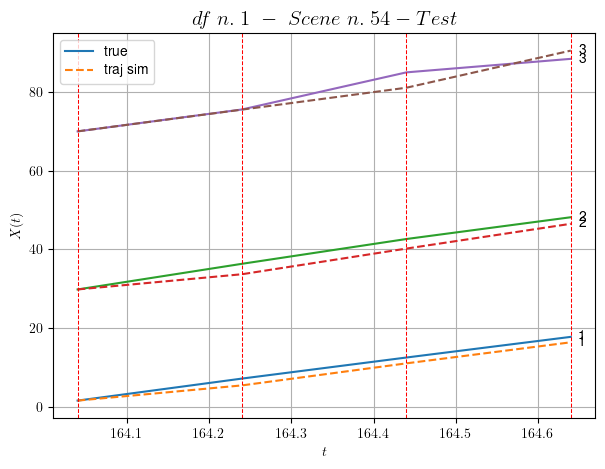

        For scene 54/99:
        * MSE = 3.5192664426577287
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.55/99


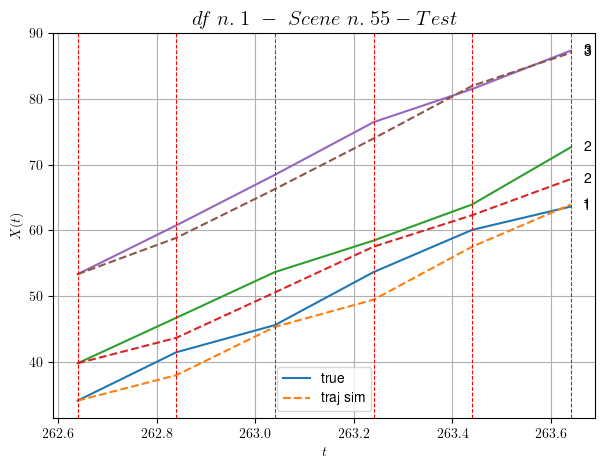

        For scene 55/99:
        * MSE = 5.394546126854788
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.56/99


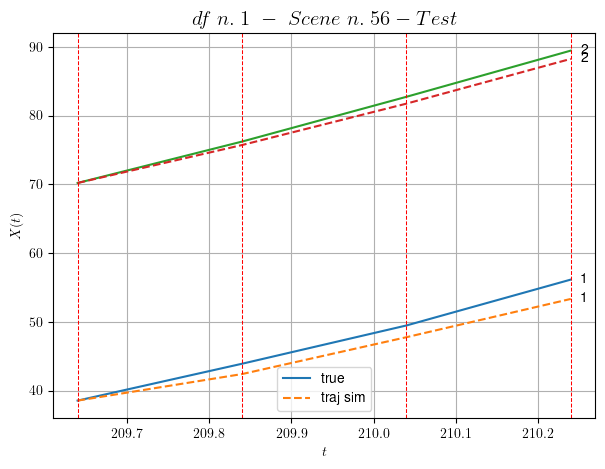

        For scene 56/99:
        * MSE = 1.9717771101797485
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.57/99


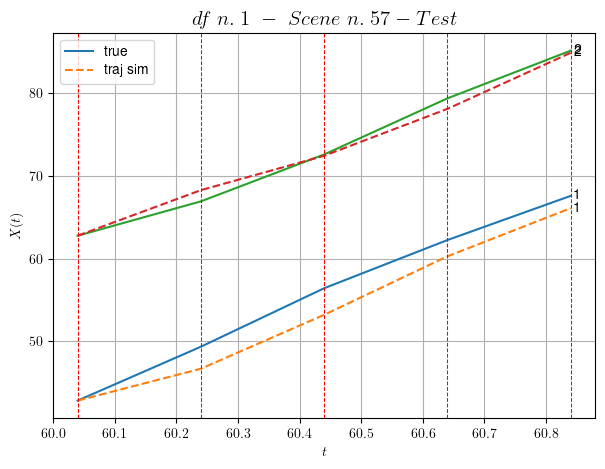

        For scene 57/99:
        * MSE = 2.710955447903671
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.58/99


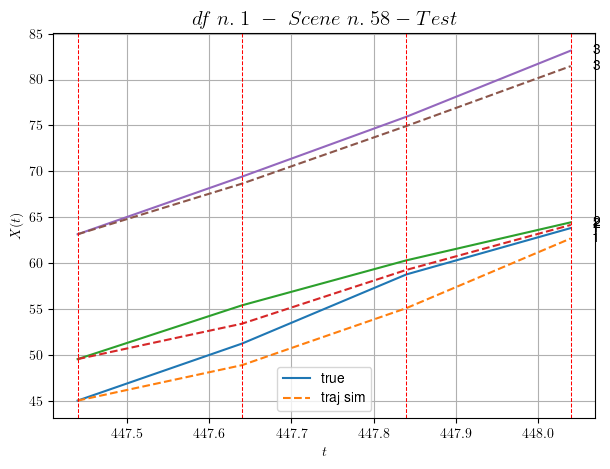

        For scene 58/99:
        * MSE = 2.491918517485057
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.59/99


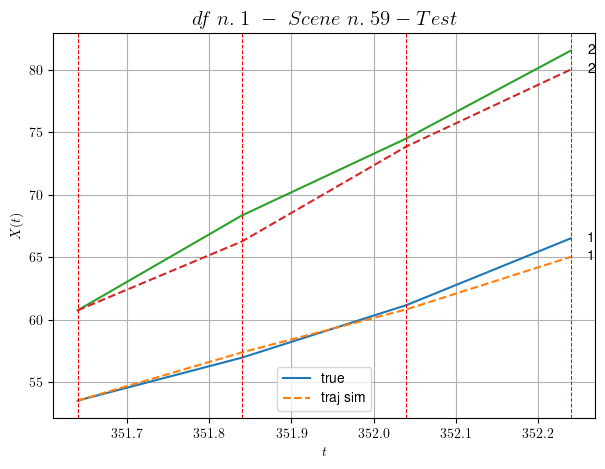

        For scene 59/99:
        * MSE = 1.1919595903756985
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.60/99


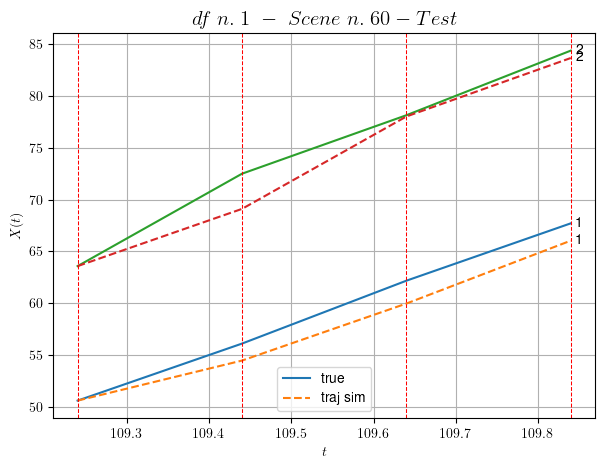

        For scene 60/99:
        * MSE = 2.7959153271992925
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.61/99


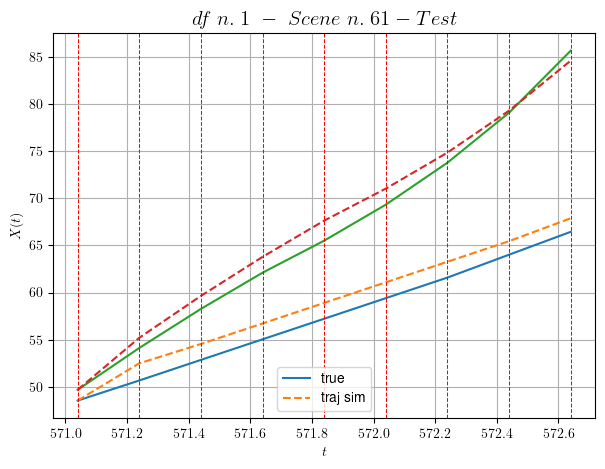

        For scene 61/99:
        * MSE = 2.0623314641831545
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.62/99


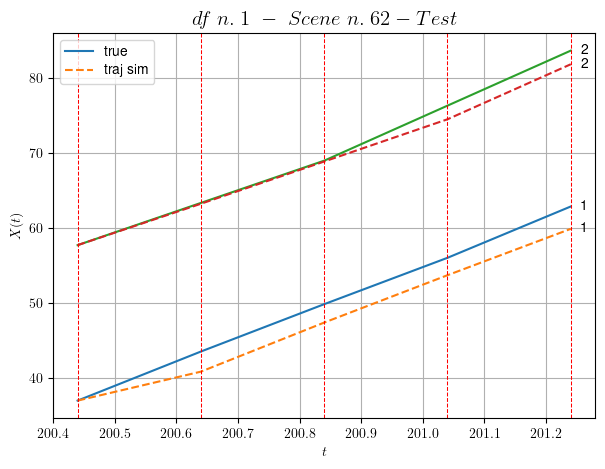

        For scene 62/99:
        * MSE = 3.4108379828300213
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.63/99


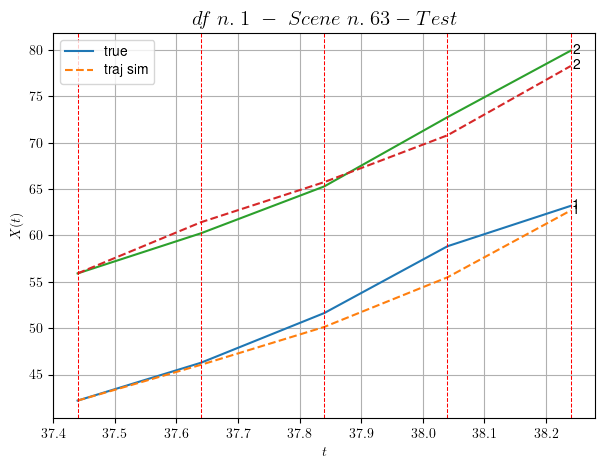

        For scene 63/99:
        * MSE = 2.193267065349772
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.64/99


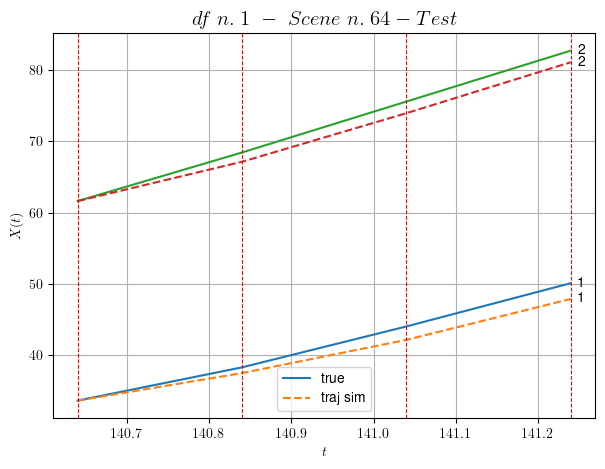

        For scene 64/99:
        * MSE = 2.0151463694012484
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.65/99


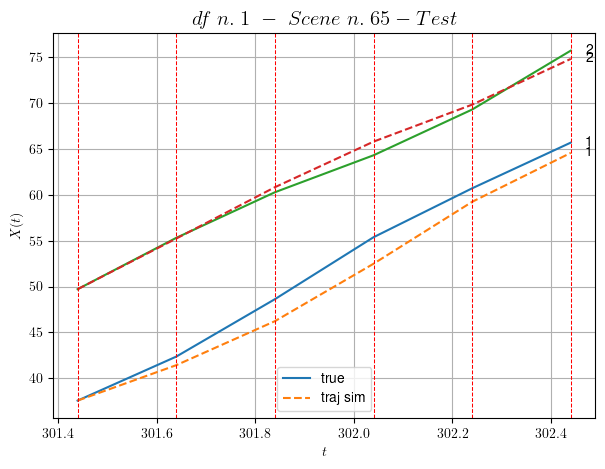

        For scene 65/99:
        * MSE = 1.8341800240959096
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.66/99


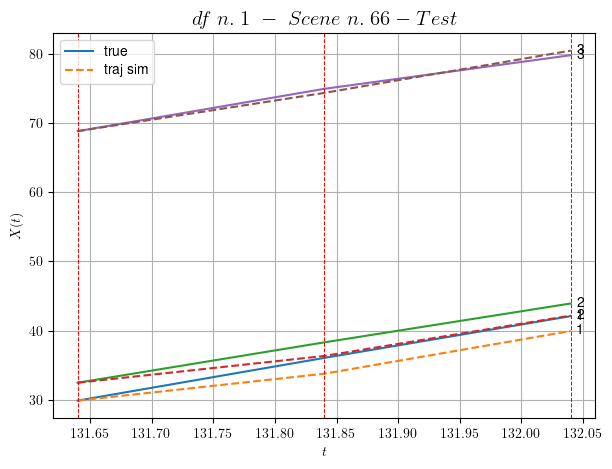

        For scene 66/99:
        * MSE = 1.9431512428821778
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.67/99


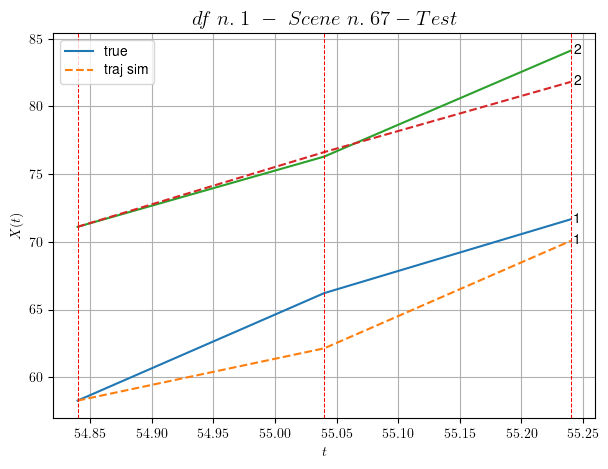

        For scene 67/99:
        * MSE = 4.100023237274938
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.68/99


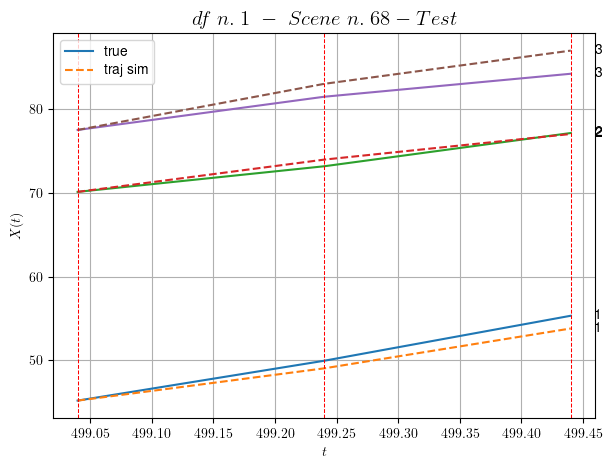

        For scene 68/99:
        * MSE = 1.5369569497214985
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.69/99


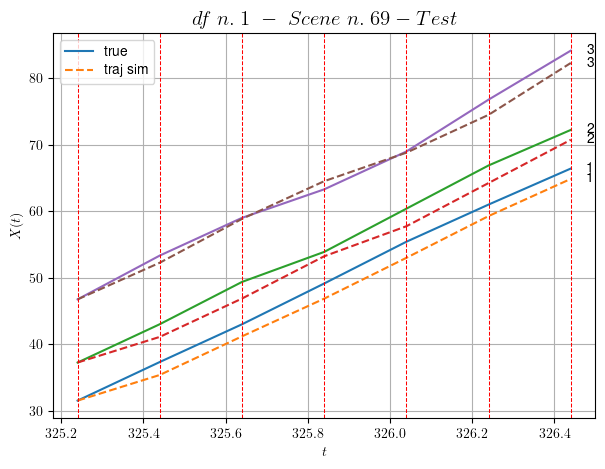

        For scene 69/99:
        * MSE = 2.9285716466078004
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.70/99


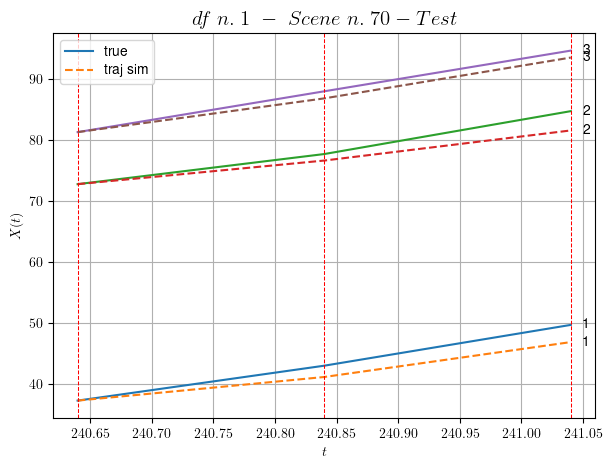

        For scene 70/99:
        * MSE = 2.7806867716508052
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.71/99


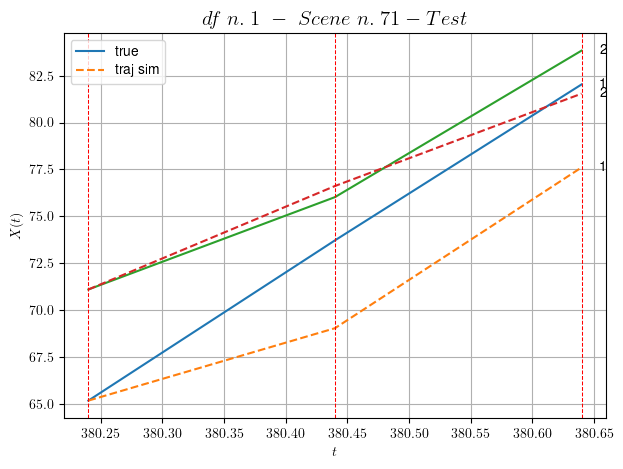

        For scene 71/99:
        * MSE = 7.862148700813034
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.72/99


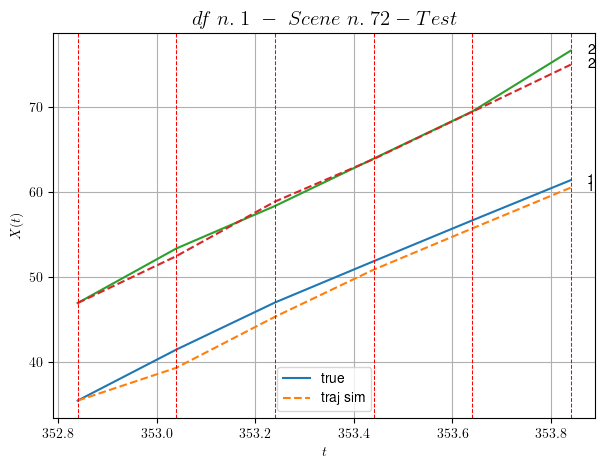

        For scene 72/99:
        * MSE = 1.1566815034578373
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.73/99


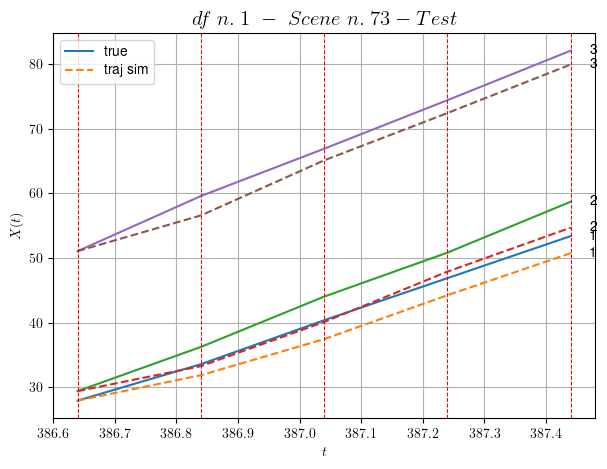

        For scene 73/99:
        * MSE = 6.337996546987168
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.74/99


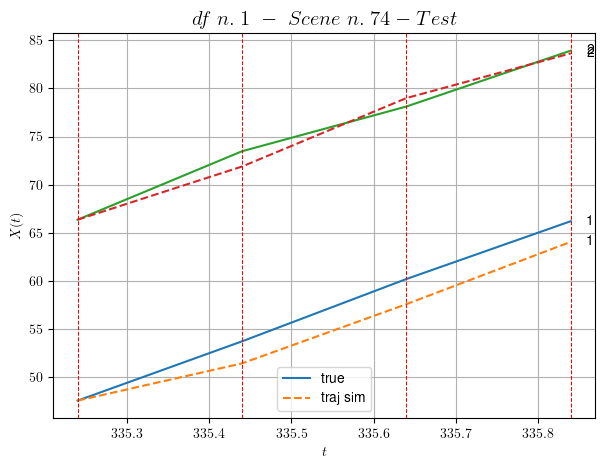

        For scene 74/99:
        * MSE = 2.49934280963205
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.75/99


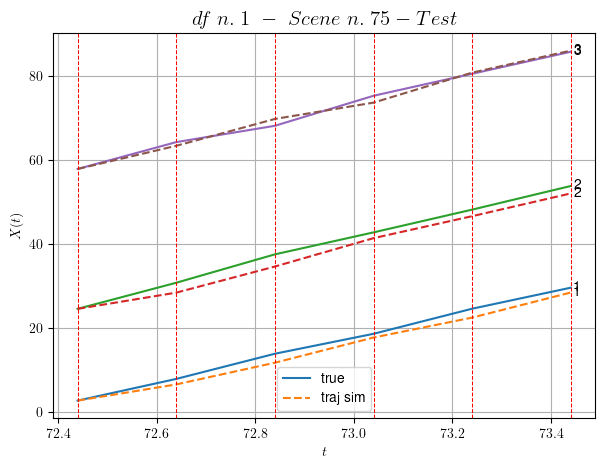

        For scene 75/99:
        * MSE = 2.2552968709589045
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.76/99


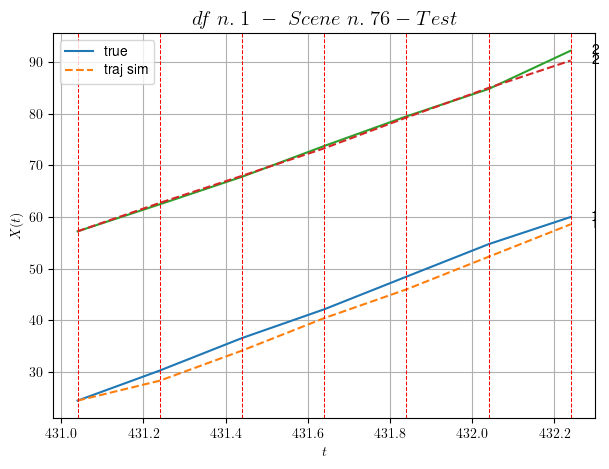

        For scene 76/99:
        * MSE = 2.2014631441941668
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.77/99


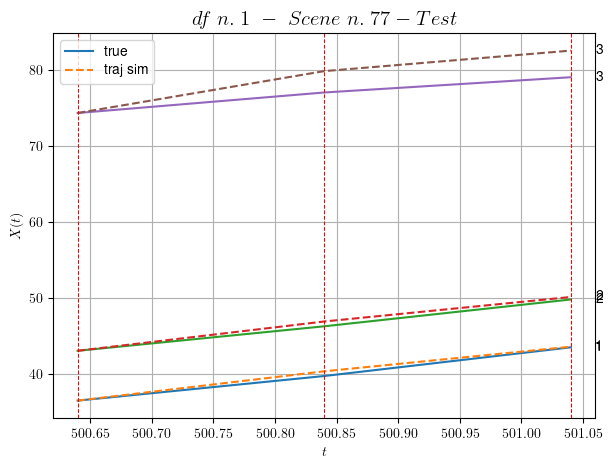

        For scene 77/99:
        * MSE = 2.3475435889854013
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.78/99


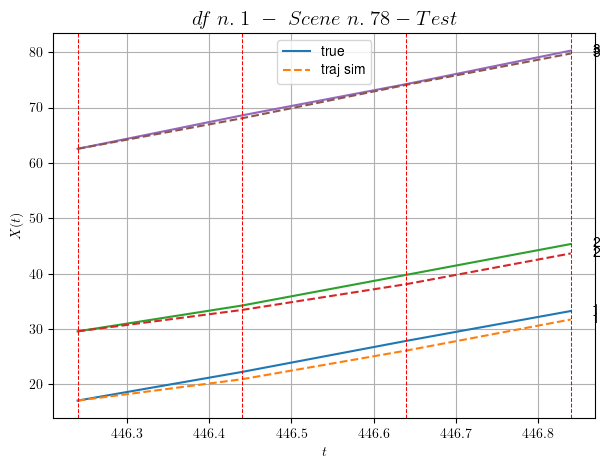

        For scene 78/99:
        * MSE = 1.1707930648955858
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.79/99


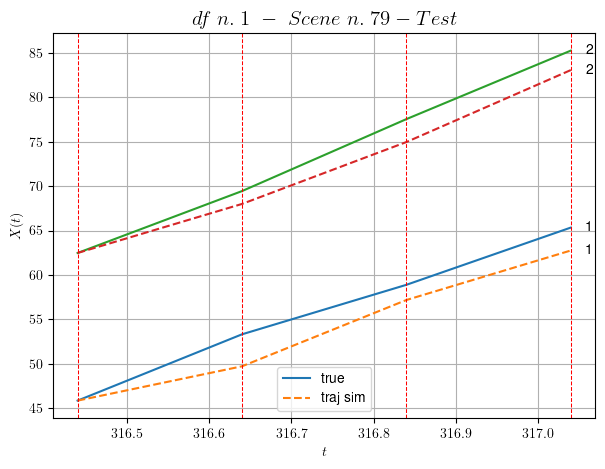

        For scene 79/99:
        * MSE = 4.510117326146733
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.80/99


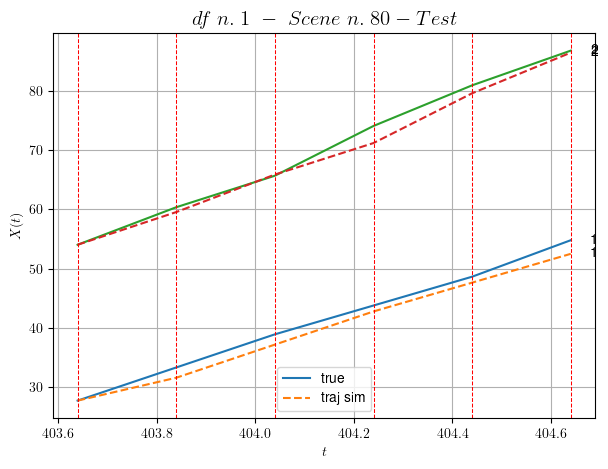

        For scene 80/99:
        * MSE = 2.022206628519861
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.81/99


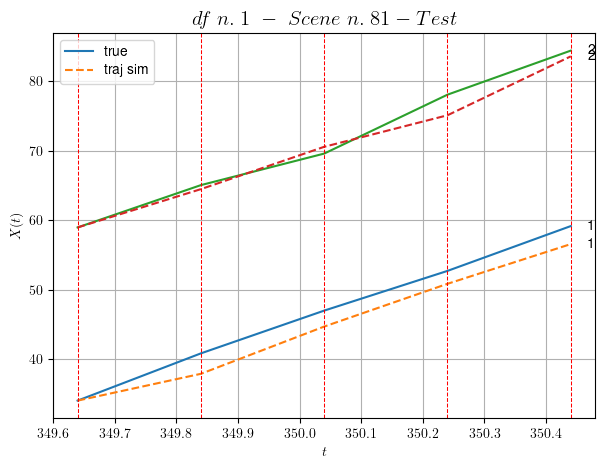

        For scene 81/99:
        * MSE = 3.4903993905848063
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.82/99


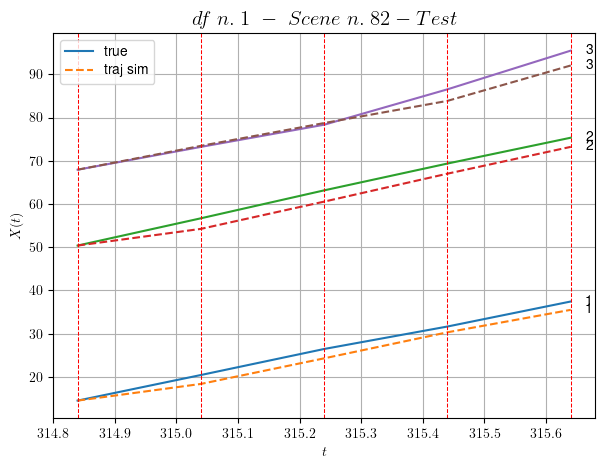

        For scene 82/99:
        * MSE = 3.757790048638368
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.83/99


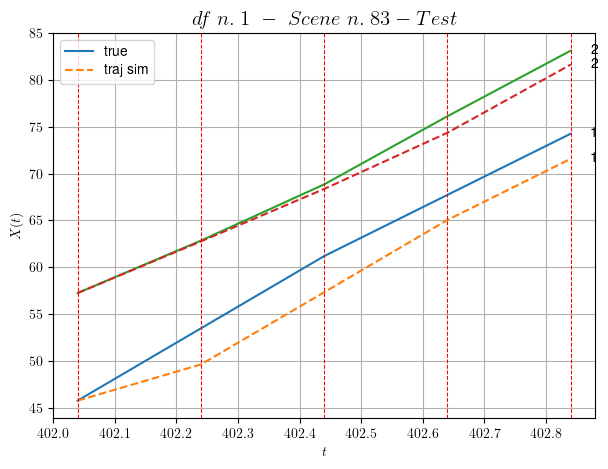

        For scene 83/99:
        * MSE = 4.972638008312558
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.84/99


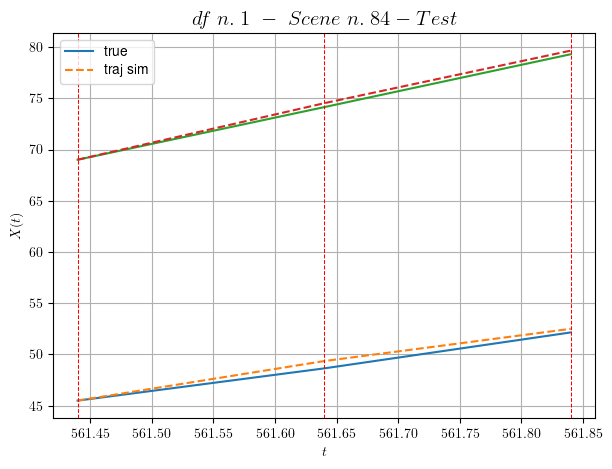

        For scene 84/99:
        * MSE = 0.1506316843939186
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.85/99


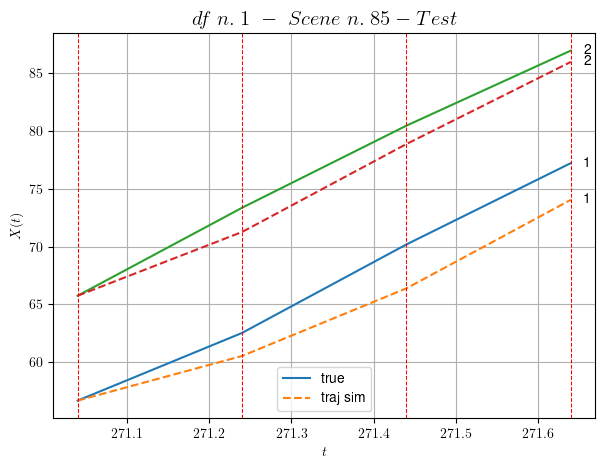

        For scene 85/99:
        * MSE = 4.5516964014208625
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.86/99


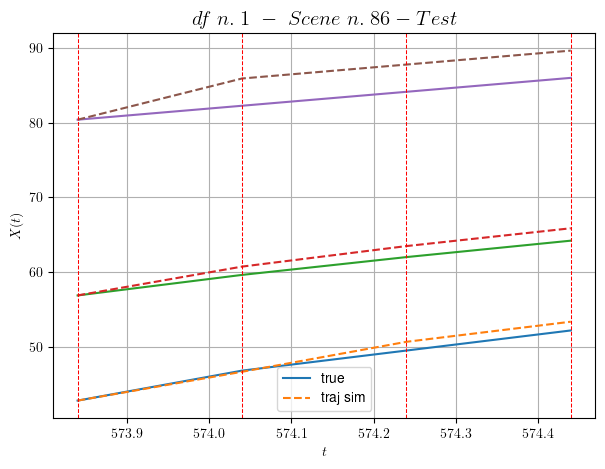

        For scene 86/99:
        * MSE = 4.076052212979324
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.87/99


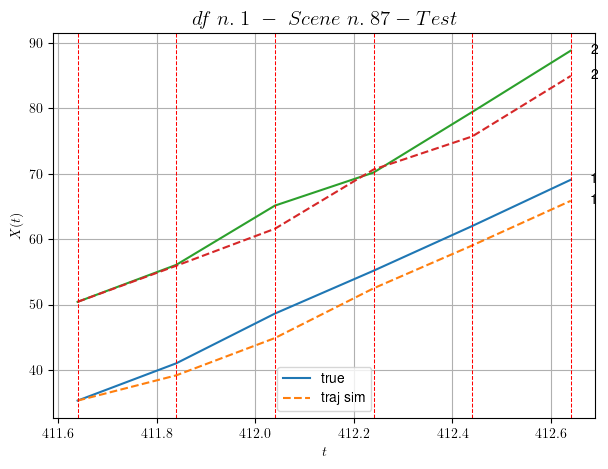

        For scene 87/99:
        * MSE = 7.122911462955262
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.88/99


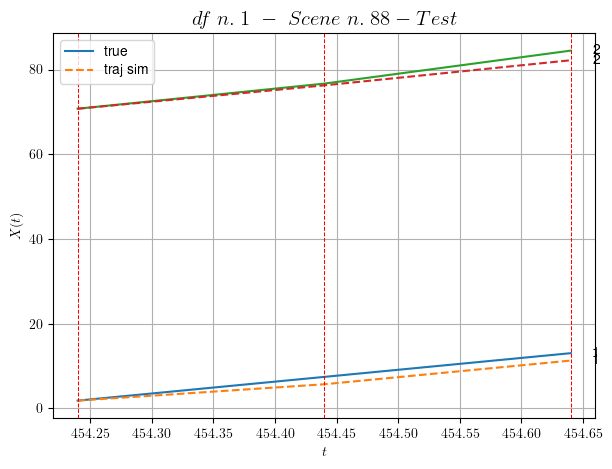

        For scene 88/99:
        * MSE = 1.9030551247218908
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.89/99


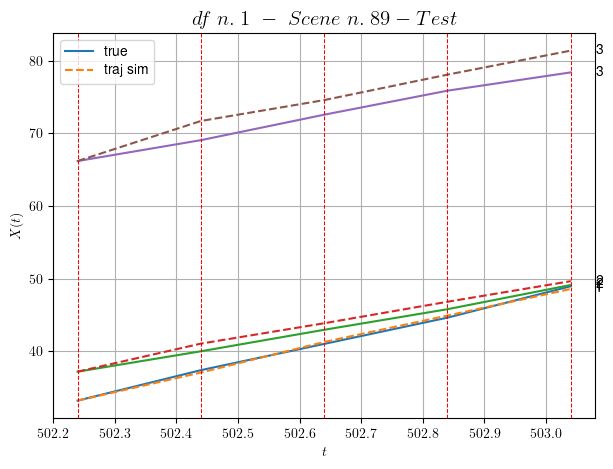

        For scene 89/99:
        * MSE = 1.9032095012211876
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.90/99


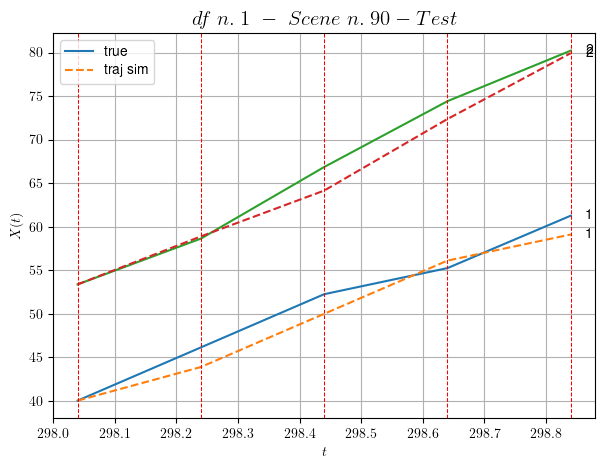

        For scene 90/99:
        * MSE = 2.7271807004087343
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.91/99


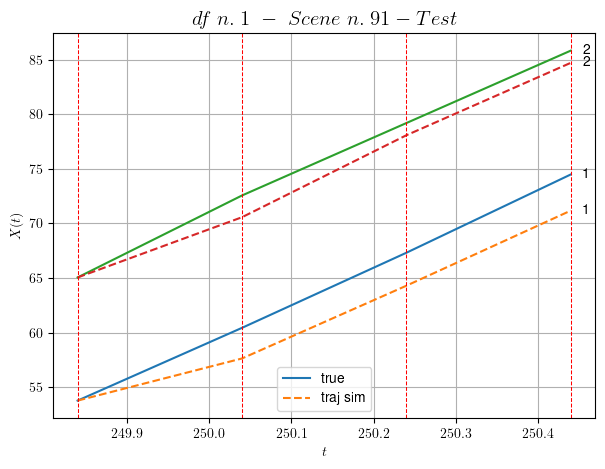

        For scene 91/99:
        * MSE = 4.3030472939711775
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.92/99


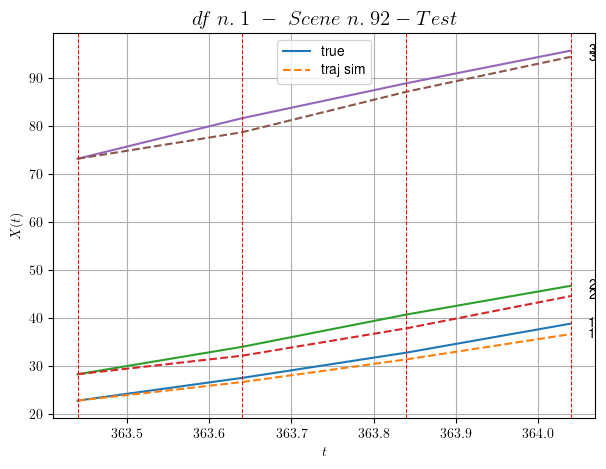

        For scene 92/99:
        * MSE = 3.0871086954462066
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.93/99


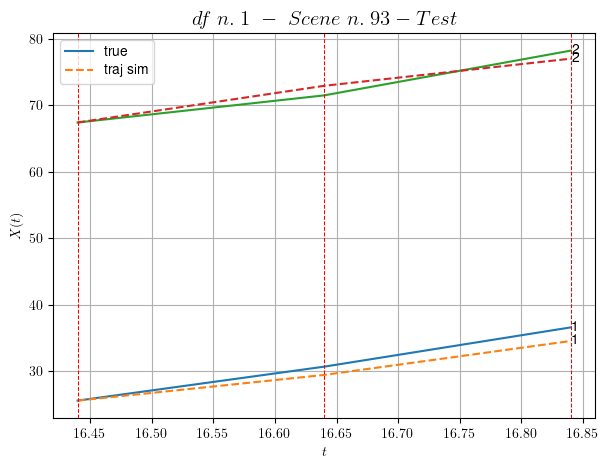

        For scene 93/99:
        * MSE = 1.544978543529064
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.94/99


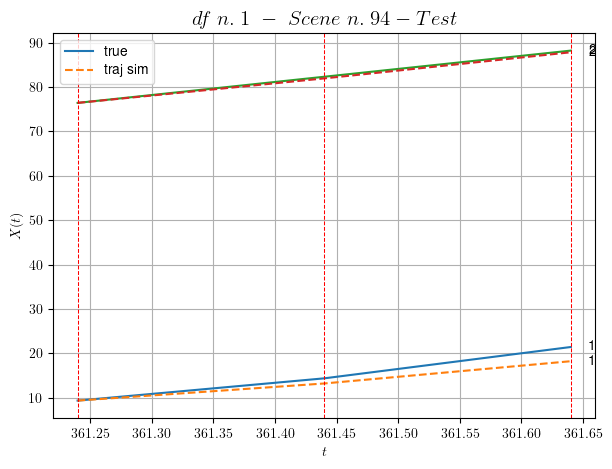

        For scene 94/99:
        * MSE = 1.9771360479263043
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.95/99


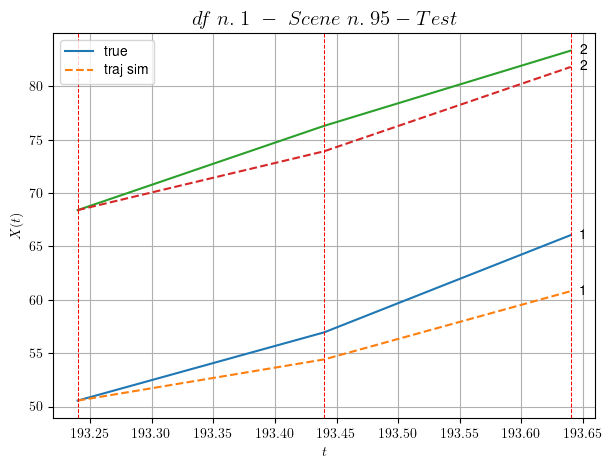

        For scene 95/99:
        * MSE = 7.009887404755083
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.96/99


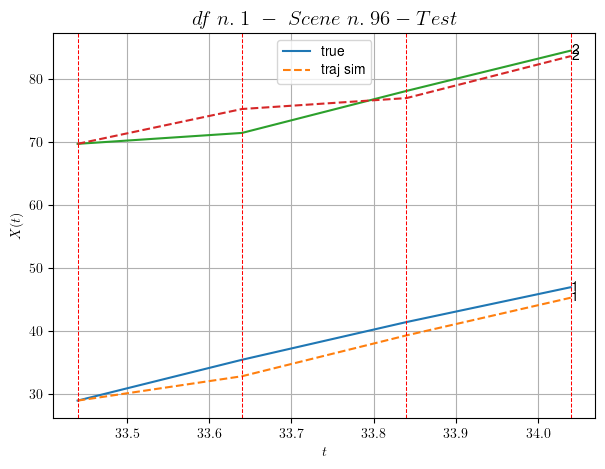

        For scene 96/99:
        * MSE = 3.803691773577881
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.97/99


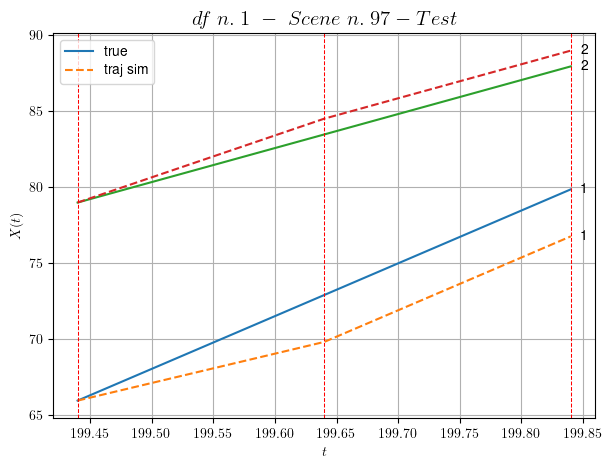

        For scene 97/99:
        * MSE = 3.5427841727907188
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.98/99


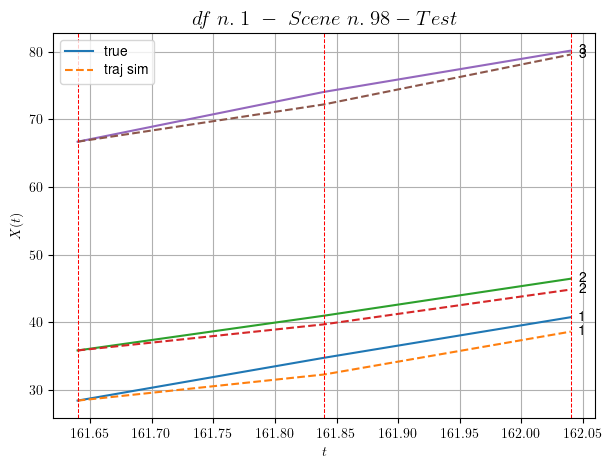

        For scene 98/99:
        * MSE = 2.0651917928255745
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.99/99


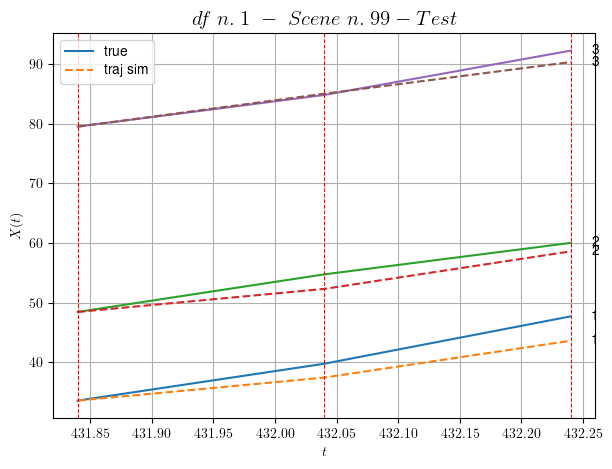

        For scene 99/99:
        * MSE = 3.748283677541378
----------------------------------------------------------------------------------------------------


MSE test: 3.1609133561790466

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.7782009878009417
          * MSE test: 3.1609133561790466
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 2/10 dfs.
In DataFrame n.2 we have 69 scenes.
    To train the model we use 6 scenes, the remaining 63 to test the model.

Training step. (6 scenes)
DataFrame n.2. Scene n.1/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [52.76,53.56]


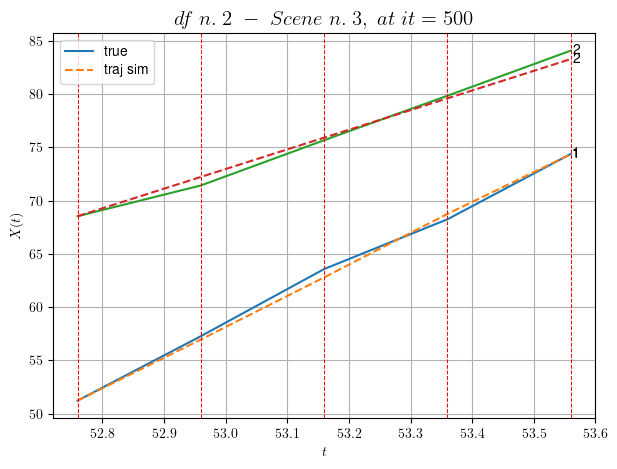

----------------------------------------------------------------------------------------------------
        For scene 1/6:
        * After LR finder: LR_NN=0.005 with mse=15.089977880851029 at it=24
        * v0 = 18.434937295304216
        * MSE = 0.23046619371592347
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [250.16,250.96]


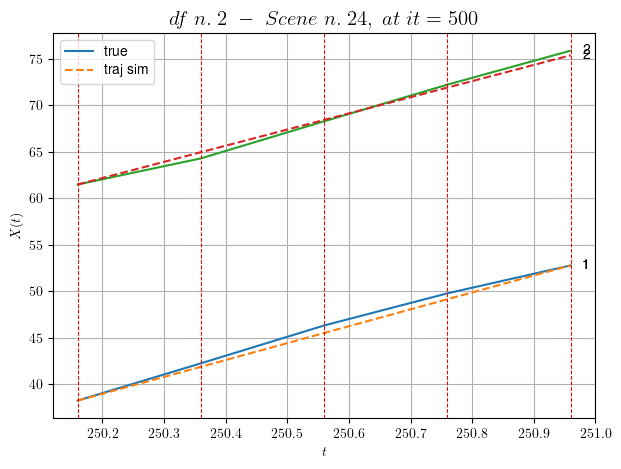

----------------------------------------------------------------------------------------------------
        For scene 2/6:
        * After LR finder: LR_NN=0.0001 with mse=18.379428408689144 at it=24
        * v0 = 17.364515373912617
        * MSE = 0.1397925947650246
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/6
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [223.16,223.56]


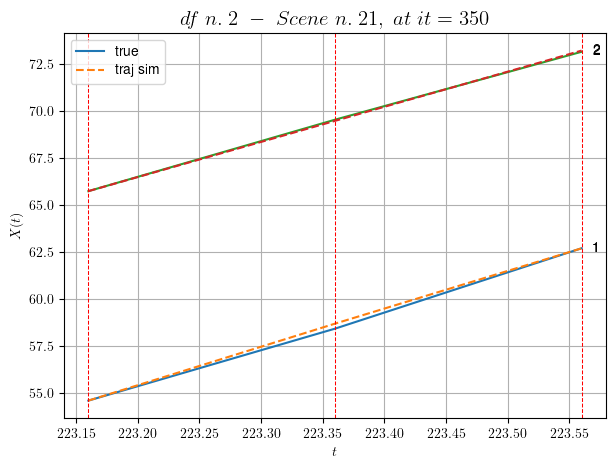

----------------------------------------------------------------------------------------------------
        For scene 3/6:
        * After LR finder: LR_NN=0.005 with mse=4.3190950479028025 at it=24
        * v0 = 18.69837039522235
        * MSE = 0.013201567249889867
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/6
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [442.76,443.76]


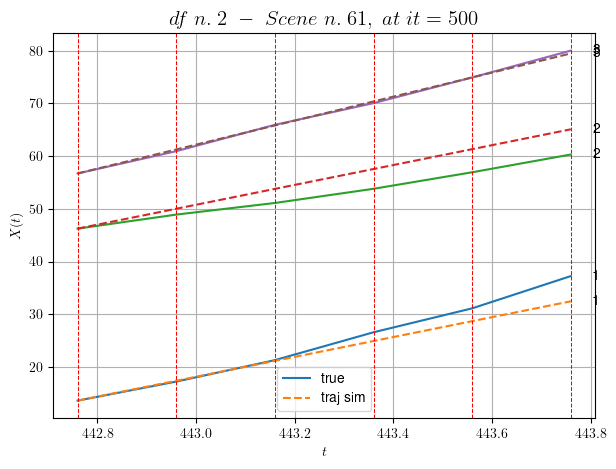

----------------------------------------------------------------------------------------------------
        For scene 4/6:
        * After LR finder: LR_NN=0.0001 with mse=8.190040524982583 at it=24
        * v0 = 22.77589680250484
        * MSE = 5.3674920216574575
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/6
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [198.16,200.16]


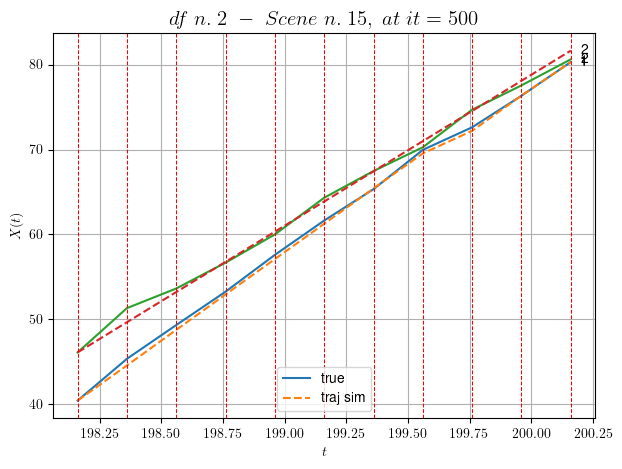

----------------------------------------------------------------------------------------------------
        For scene 5/6:
        * After LR finder: LR_NN=0.005 with mse=108.70109247178098 at it=24
        * v0 = 17.75627925151295
        * MSE = 0.30315450673006683
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.16,86.96]


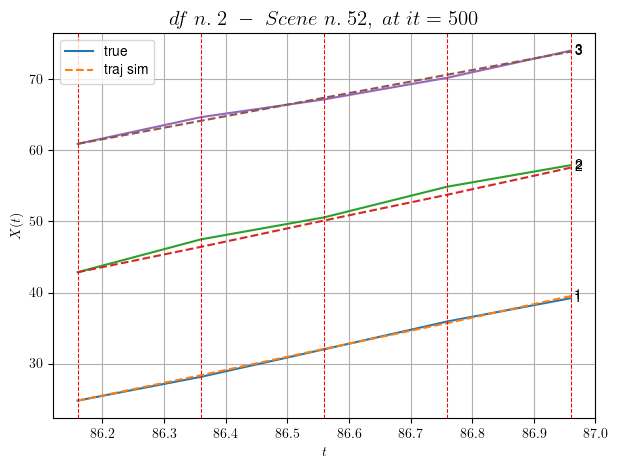

----------------------------------------------------------------------------------------------------
        For scene 6/6:
        * After LR finder: LR_NN=0.01 with mse=15.715215983253527 at it=24
        * v0 = 16.23533006014596
        * MSE = 0.22821169632936686
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.047053096741288
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (63 scenes)
DataFrame n.2. Scene n.1/63


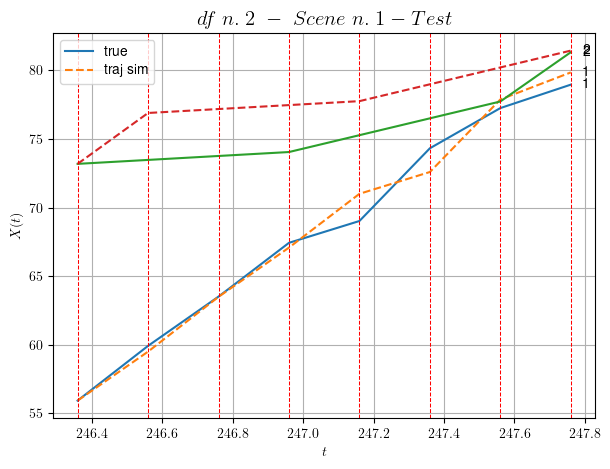

        For scene 1/63:
        * MSE = 3.8750385666477465
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/63


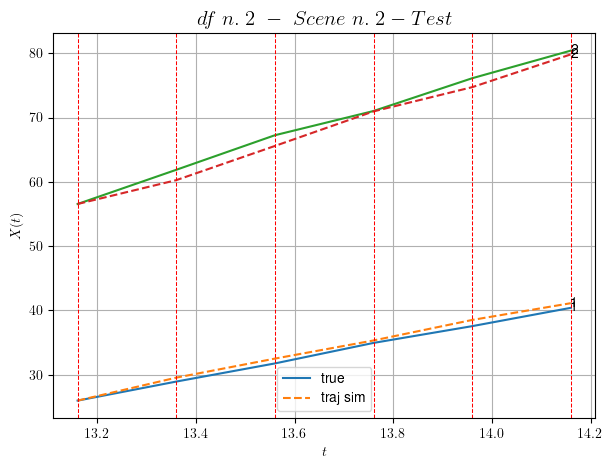

        For scene 2/63:
        * MSE = 0.8490508894332256
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/63


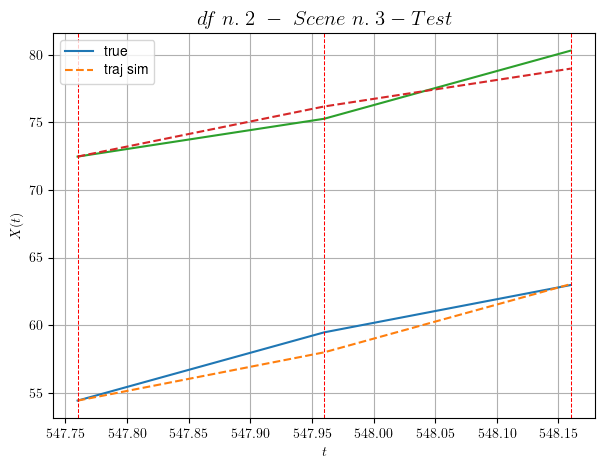

        For scene 3/63:
        * MSE = 0.7983321713824965
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/63


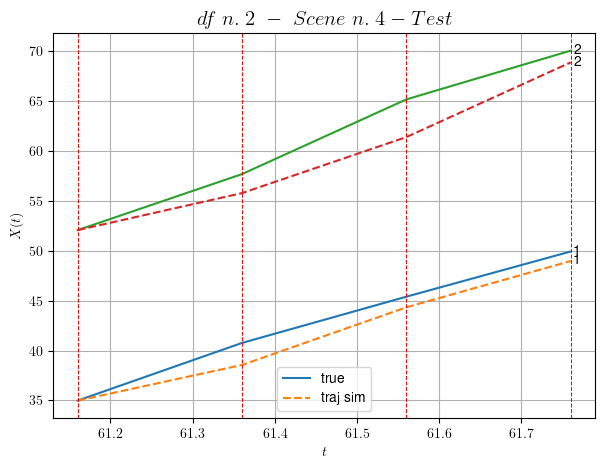

        For scene 4/63:
        * MSE = 3.274839489890437
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/63


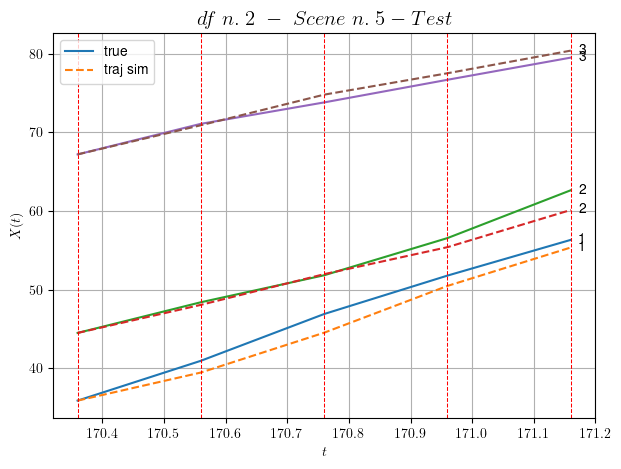

        For scene 5/63:
        * MSE = 1.3872425299006539
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/63


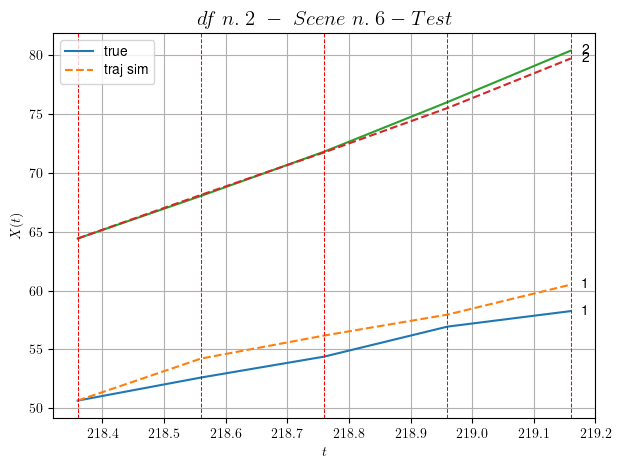

        For scene 6/63:
        * MSE = 1.2635680842193433
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/63


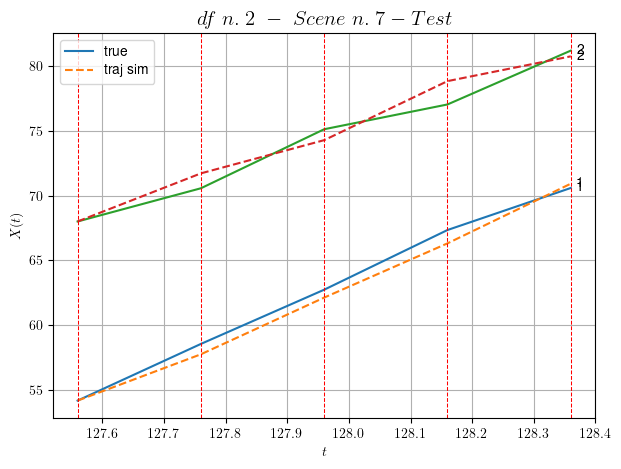

        For scene 7/63:
        * MSE = 0.7633200219760943
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/63


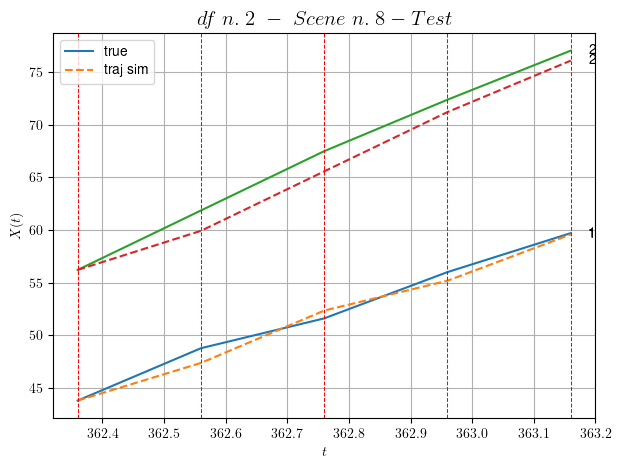

        For scene 8/63:
        * MSE = 1.2865741651323561
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/63


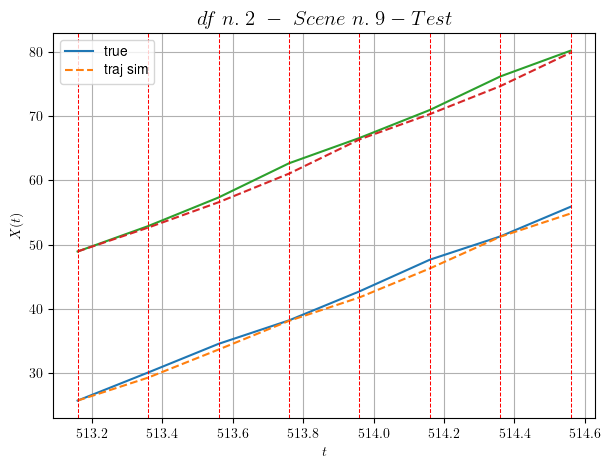

        For scene 9/63:
        * MSE = 0.7053296888677718
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/63


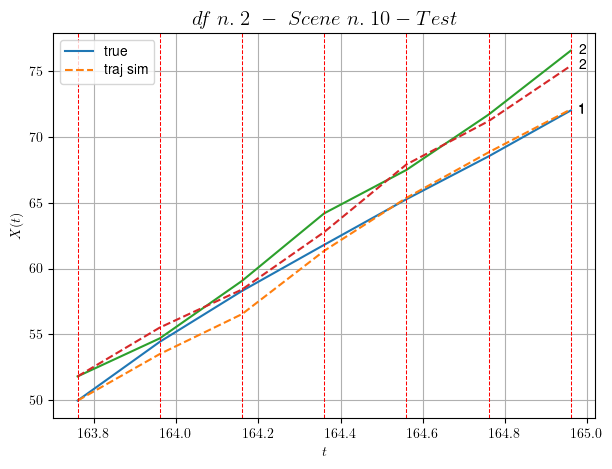

        For scene 10/63:
        * MSE = 0.6529450936774459
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/63


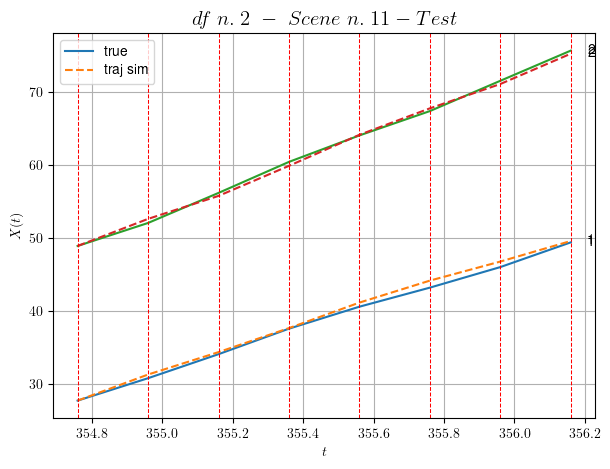

        For scene 11/63:
        * MSE = 0.21728340559985887
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/63


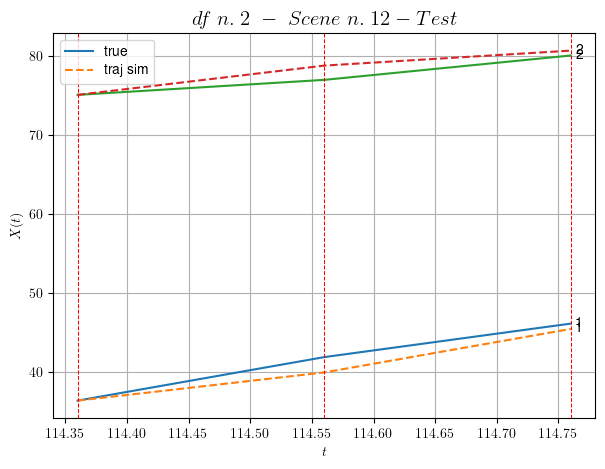

        For scene 12/63:
        * MSE = 1.313095947389483
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/63


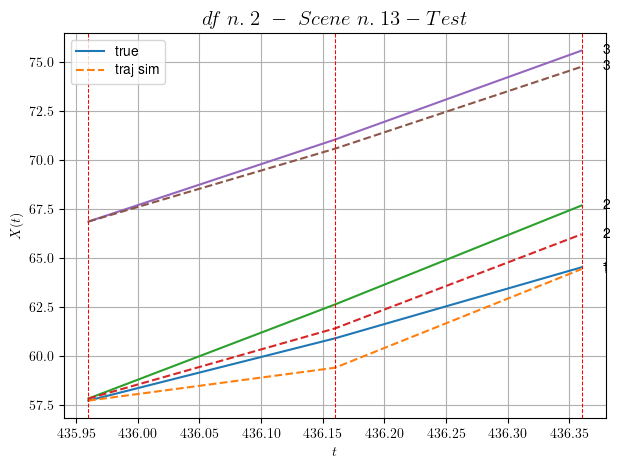

        For scene 13/63:
        * MSE = 0.7526359659551848
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/63


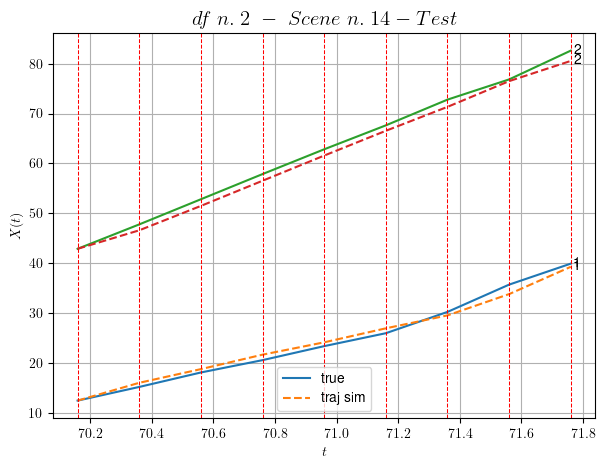

        For scene 14/63:
        * MSE = 1.2577612806224387
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/63


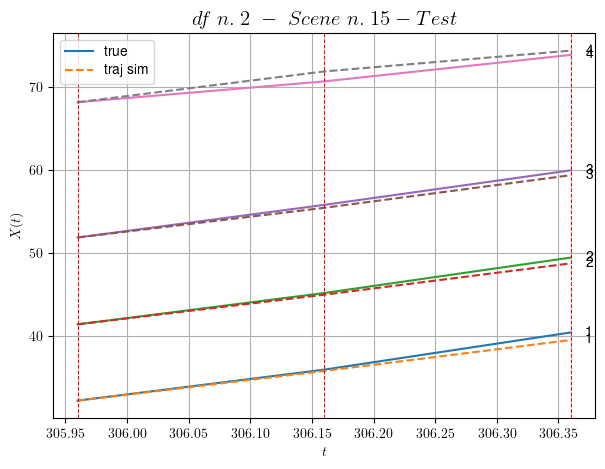

        For scene 15/63:
        * MSE = 0.29650233462211023
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/63


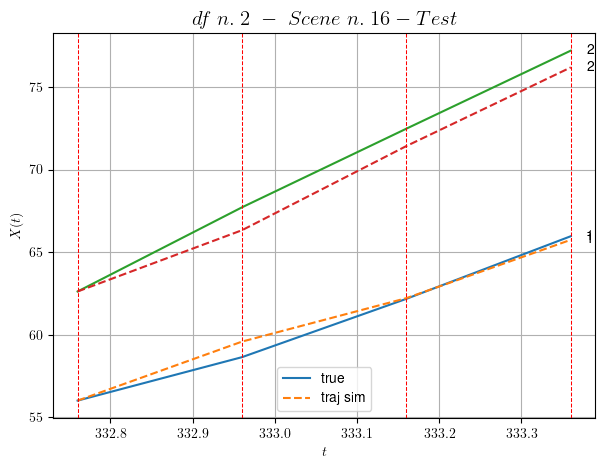

        For scene 16/63:
        * MSE = 0.6241873856765031
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/63


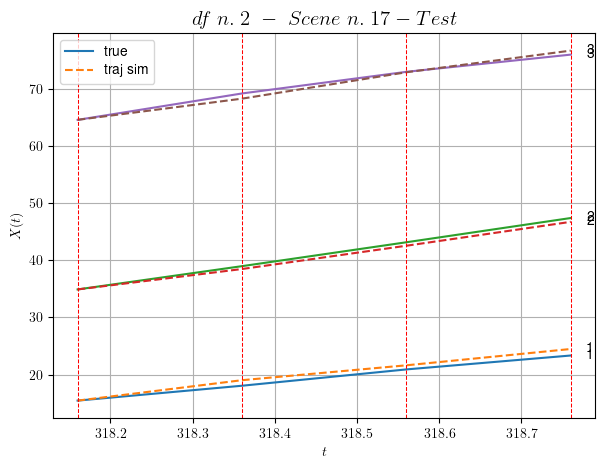

        For scene 17/63:
        * MSE = 0.4283043459089741
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/63


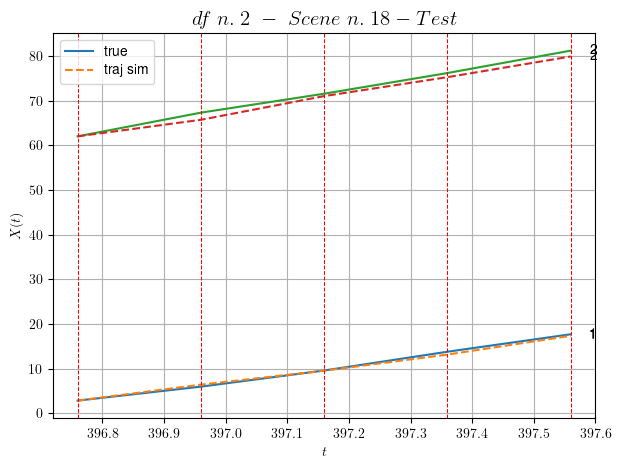

        For scene 18/63:
        * MSE = 0.6132313826383489
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/63


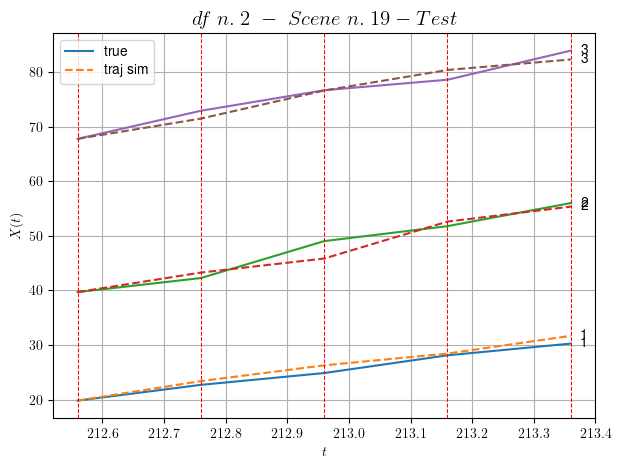

        For scene 19/63:
        * MSE = 1.6513710448221006
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/63


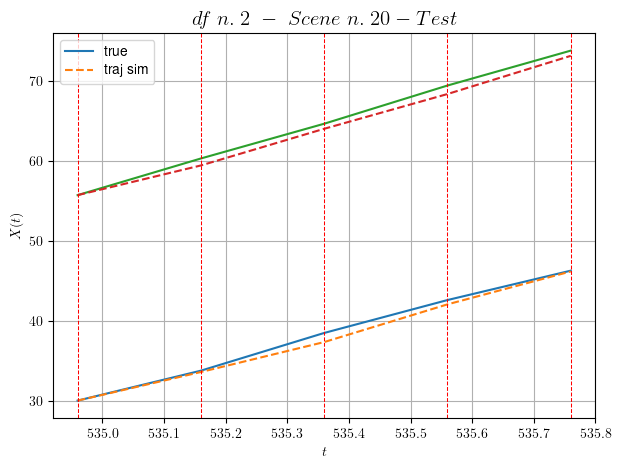

        For scene 20/63:
        * MSE = 0.4333048730161608
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/63


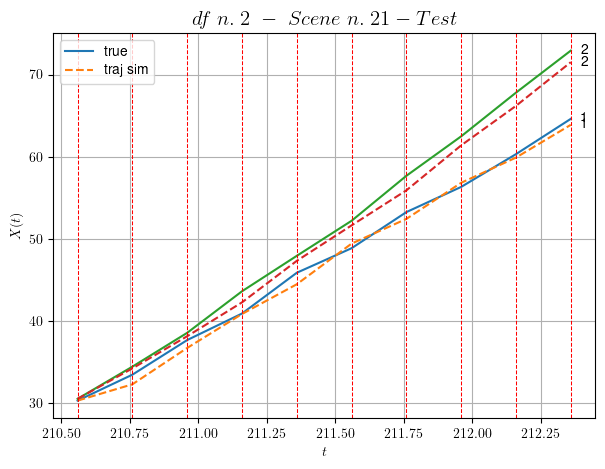

        For scene 21/63:
        * MSE = 0.8950306876425103
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/63


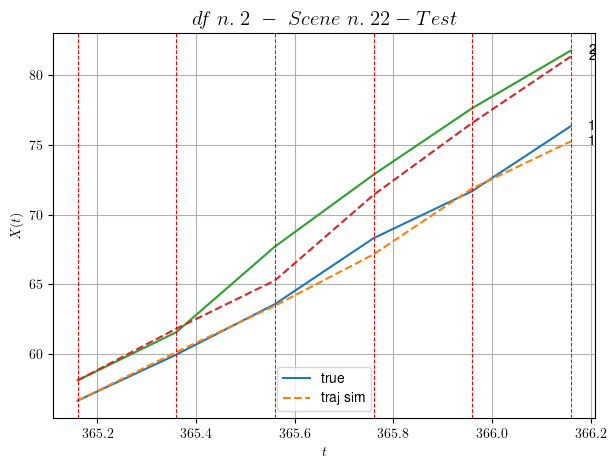

        For scene 22/63:
        * MSE = 0.999558166113554
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/63


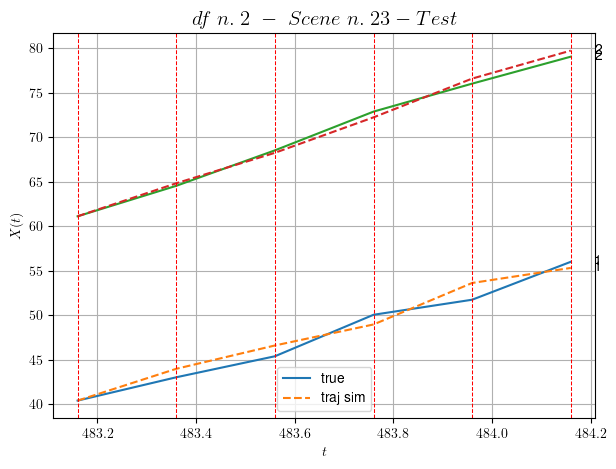

        For scene 23/63:
        * MSE = 0.7440657327504593
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.24/63


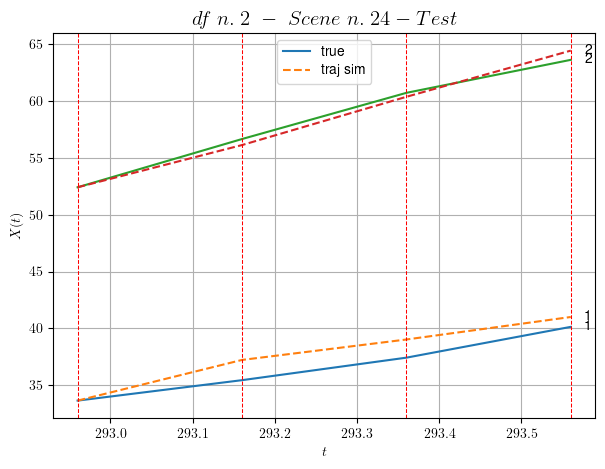

        For scene 24/63:
        * MSE = 0.9387251093122624
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.25/63


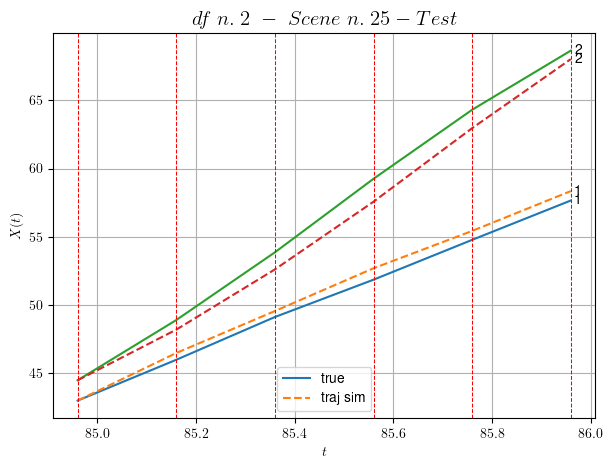

        For scene 25/63:
        * MSE = 0.7601128063282085
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.26/63


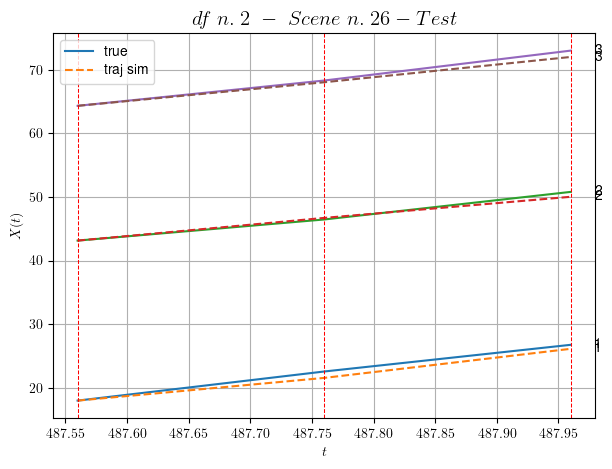

        For scene 26/63:
        * MSE = 0.3484247227421961
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.27/63


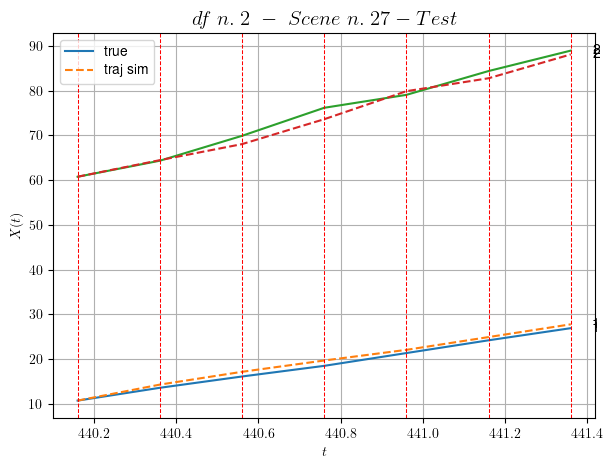

        For scene 27/63:
        * MSE = 1.339531610957144
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.28/63


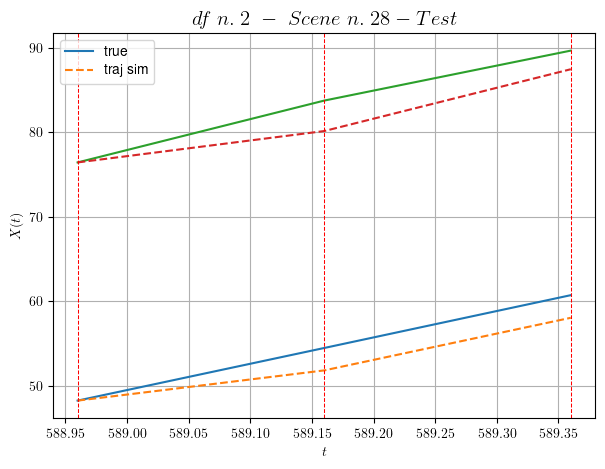

        For scene 28/63:
        * MSE = 5.333642774219601
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.29/63


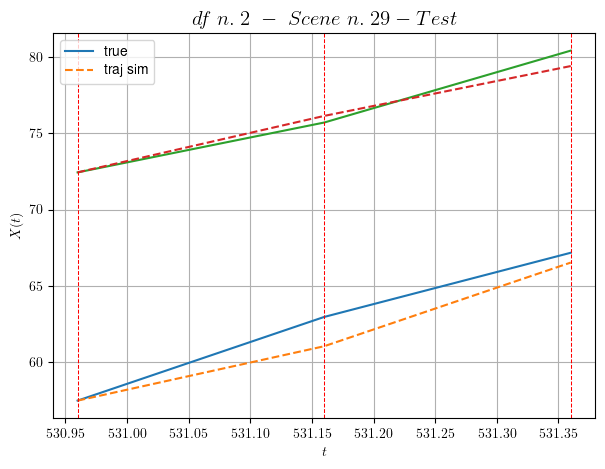

        For scene 29/63:
        * MSE = 0.8879840178953716
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.30/63


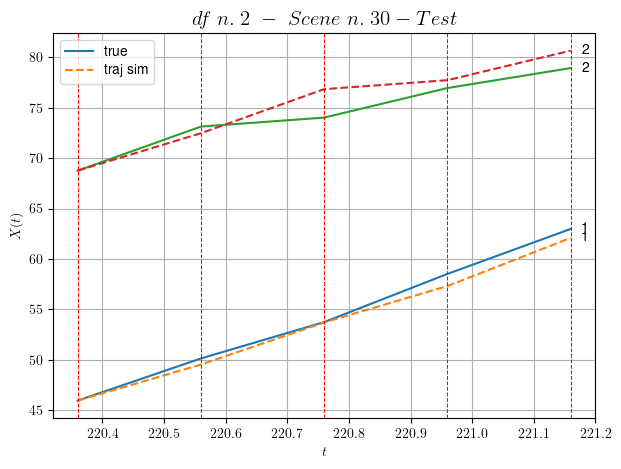

        For scene 30/63:
        * MSE = 1.4579008776078874
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.31/63


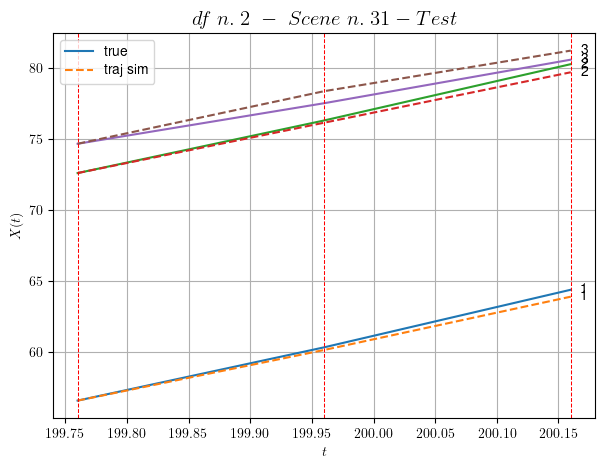

        For scene 31/63:
        * MSE = 0.19476538928819068
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.32/63


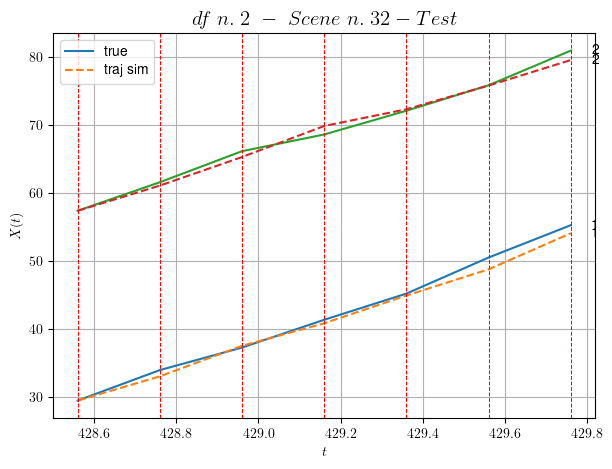

        For scene 32/63:
        * MSE = 0.7286698749344265
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.33/63


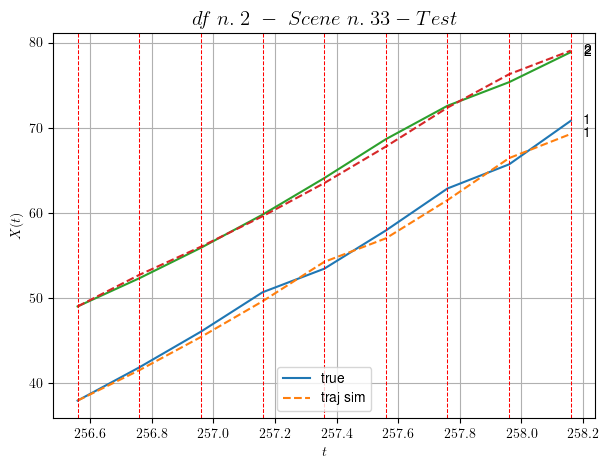

        For scene 33/63:
        * MSE = 0.5658060672154431
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.34/63


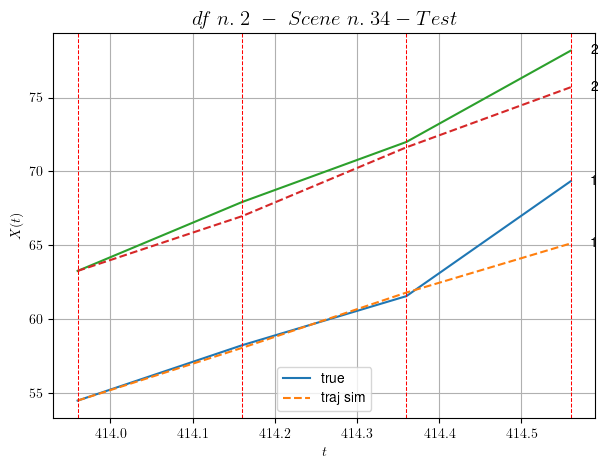

        For scene 34/63:
        * MSE = 3.136371767453099
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.35/63


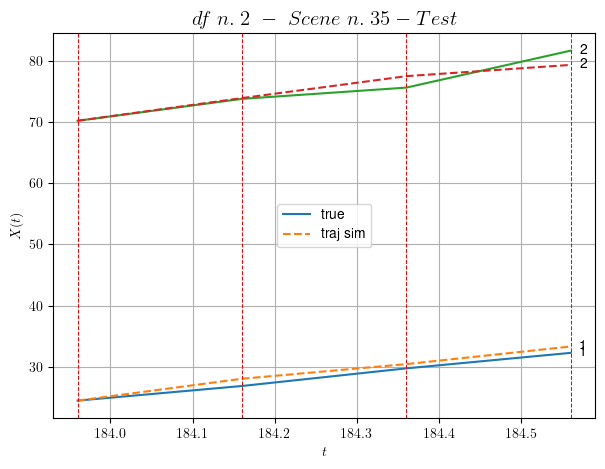

        For scene 35/63:
        * MSE = 1.4884006716331033
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.36/63


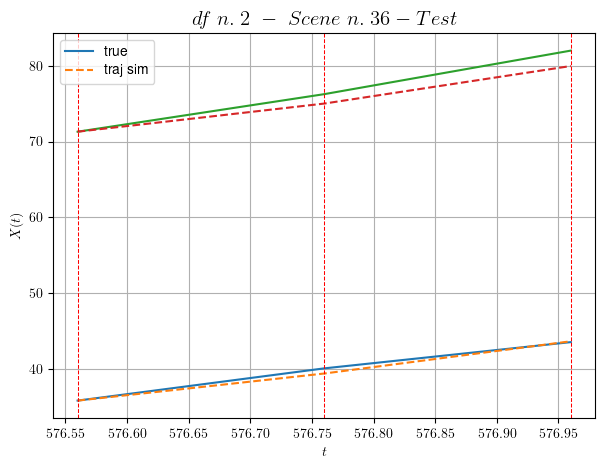

        For scene 36/63:
        * MSE = 1.0237883716874774
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.37/63


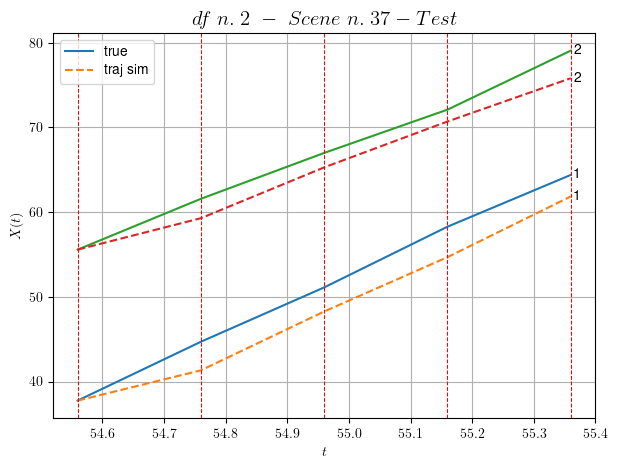

        For scene 37/63:
        * MSE = 5.958363765900451
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.38/63


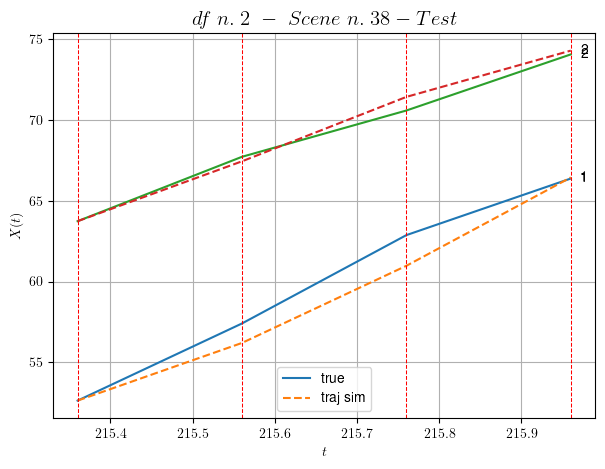

        For scene 38/63:
        * MSE = 0.7384370083325332
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.39/63


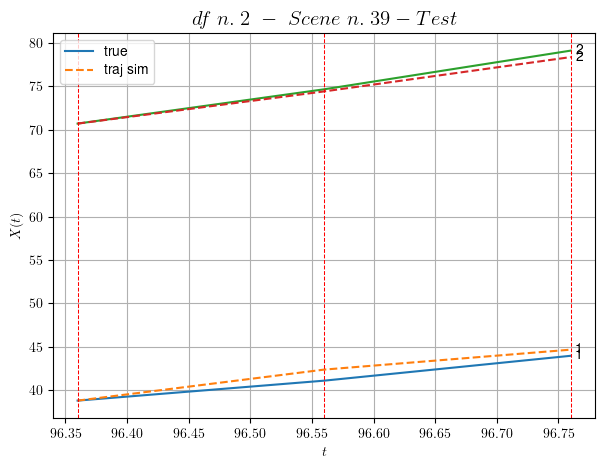

        For scene 39/63:
        * MSE = 0.4561789818945003
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.40/63


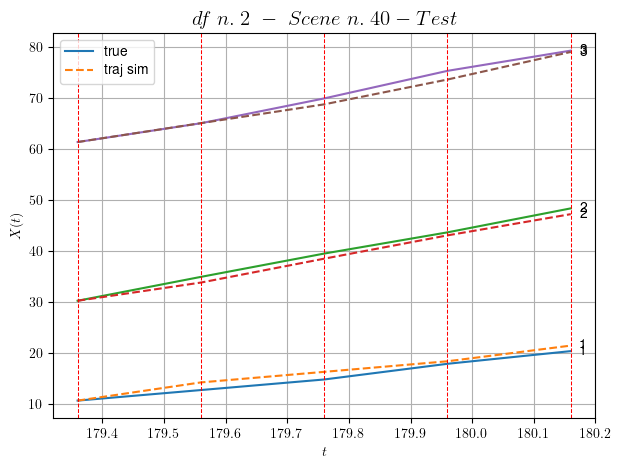

        For scene 40/63:
        * MSE = 0.9404518236742764
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.41/63


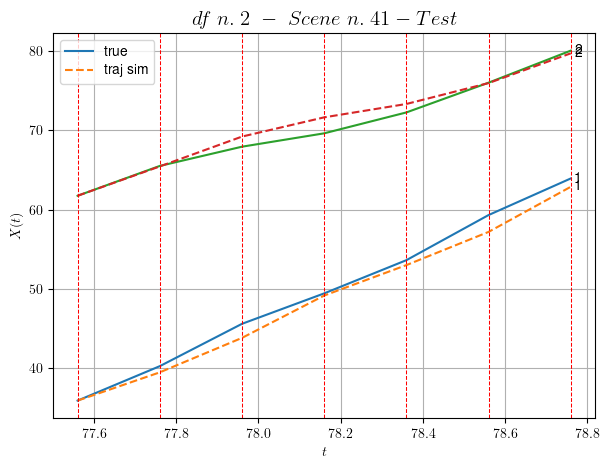

        For scene 41/63:
        * MSE = 1.204378527526881
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.42/63


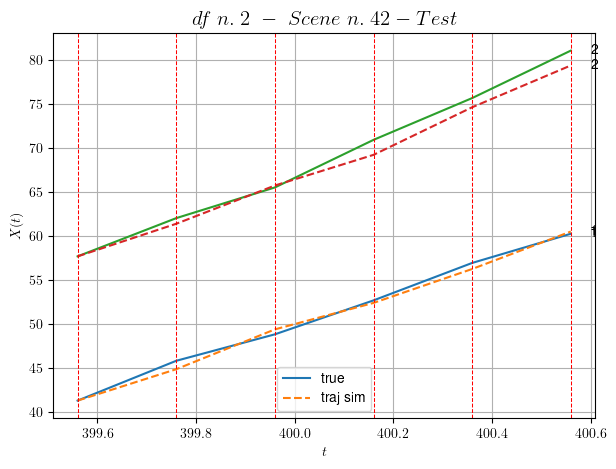

        For scene 42/63:
        * MSE = 0.7637204411025045
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.43/63


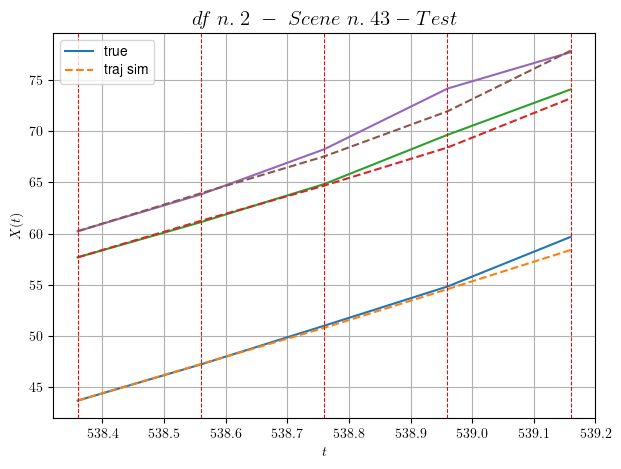

        For scene 43/63:
        * MSE = 0.6354137209945498
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.44/63


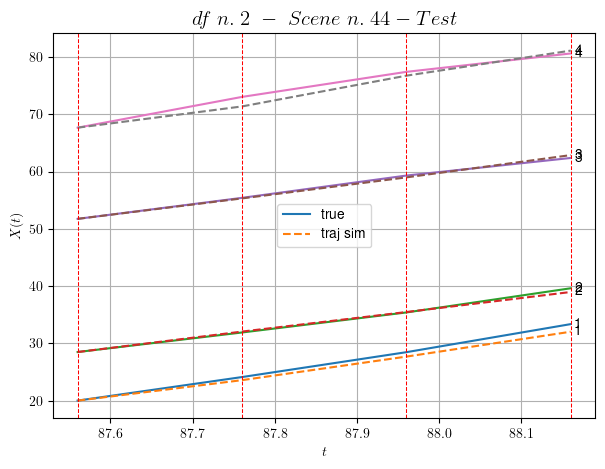

        For scene 44/63:
        * MSE = 0.43329686539457835
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.45/63


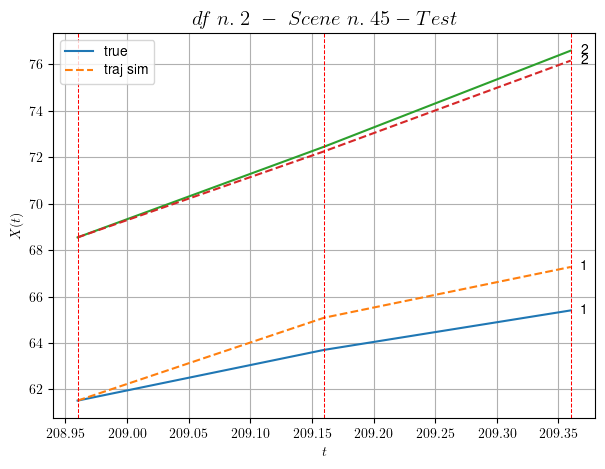

        For scene 45/63:
        * MSE = 0.9413028961667844
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.46/63


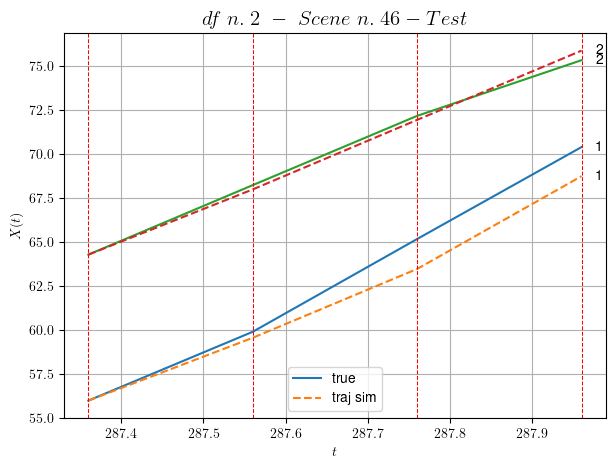

        For scene 46/63:
        * MSE = 0.7702637151871959
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.47/63


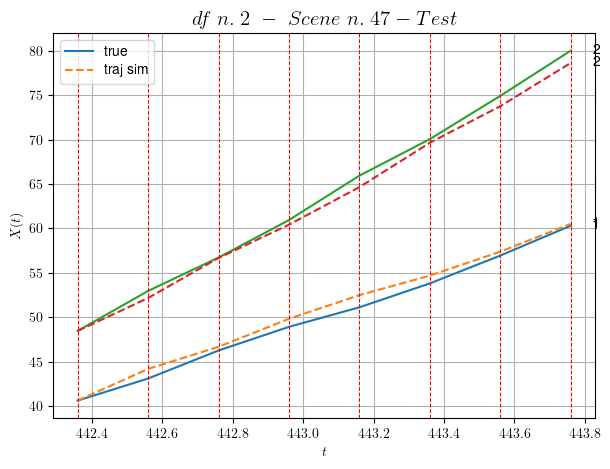

        For scene 47/63:
        * MSE = 0.6920118952227146
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.48/63


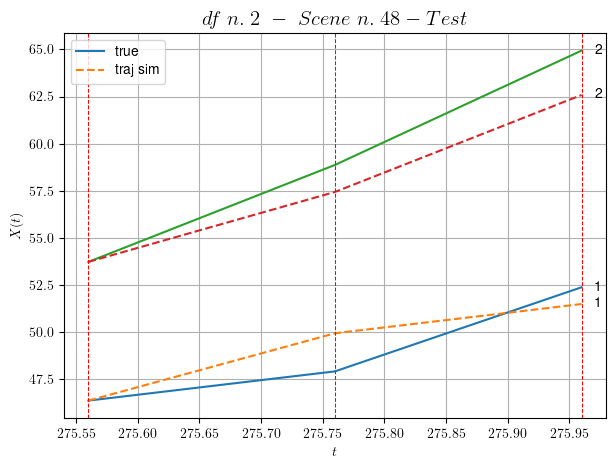

        For scene 48/63:
        * MSE = 2.078763122565725
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.49/63


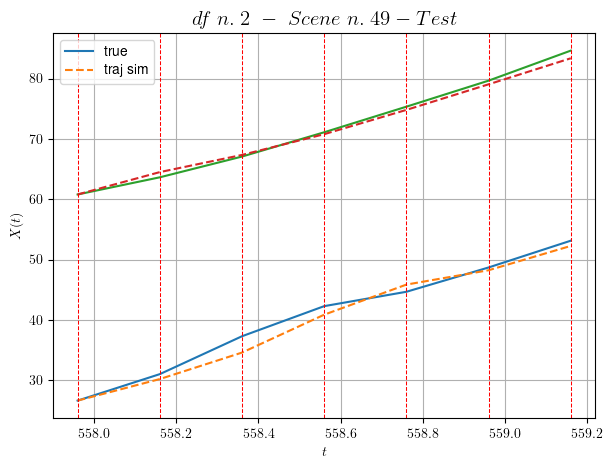

        For scene 49/63:
        * MSE = 1.1129773930307807
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.50/63


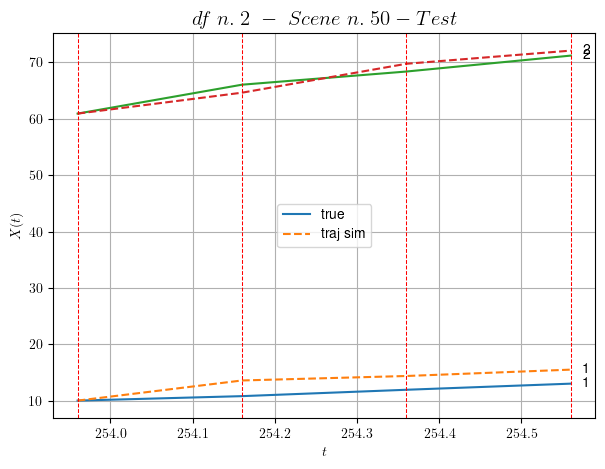

        For scene 50/63:
        * MSE = 3.068896728297167
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.51/63


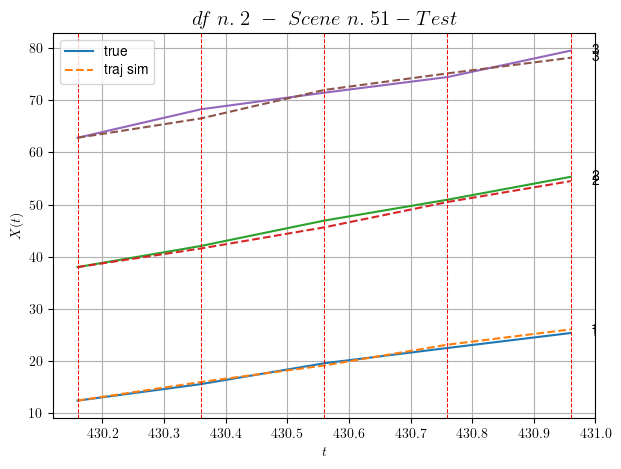

        For scene 51/63:
        * MSE = 0.6480881389569674
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.52/63


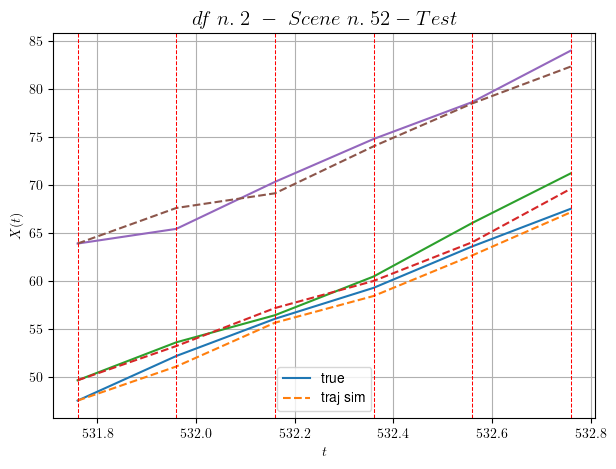

        For scene 52/63:
        * MSE = 1.121209208276599
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.53/63


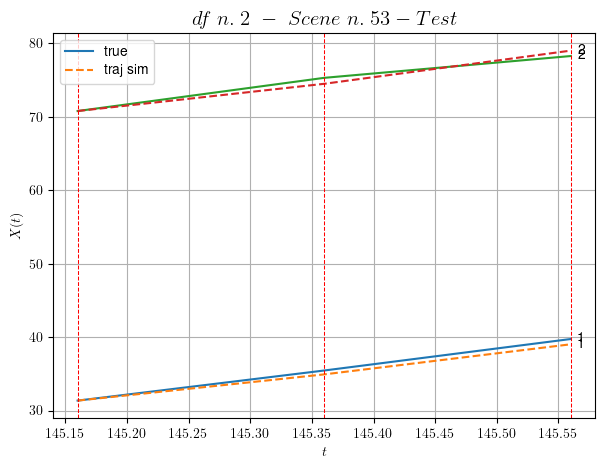

        For scene 53/63:
        * MSE = 0.3331767293229554
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.54/63


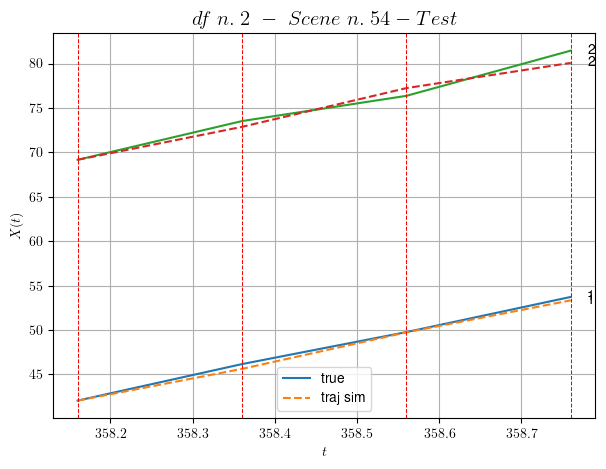

        For scene 54/63:
        * MSE = 0.44115228550605246
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.55/63


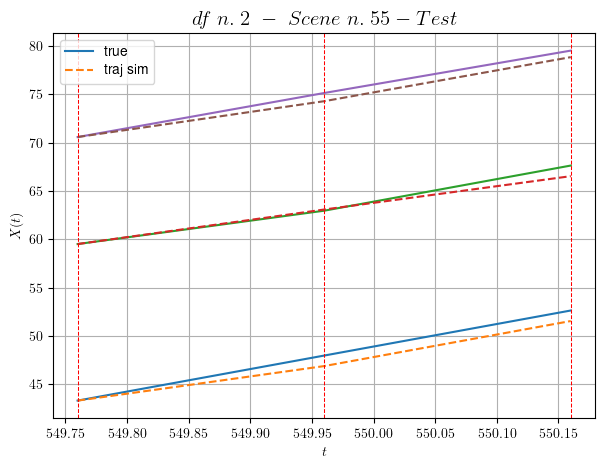

        For scene 55/63:
        * MSE = 0.5295035578222602
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.56/63


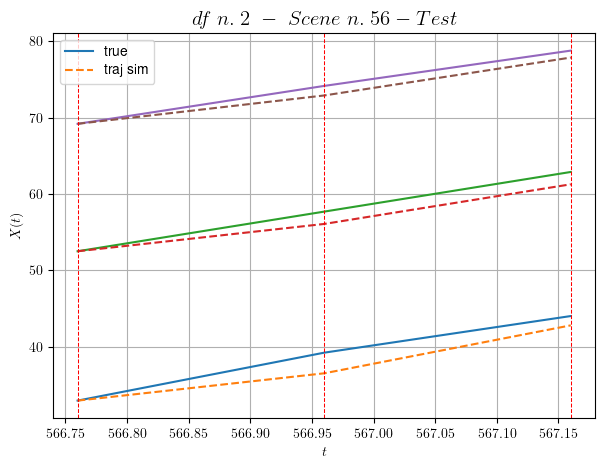

        For scene 56/63:
        * MSE = 1.8174476707690765
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.57/63


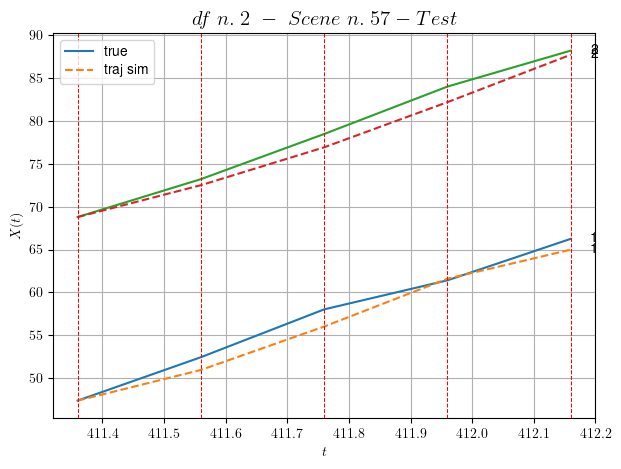

        For scene 57/63:
        * MSE = 1.4260829099726788
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.58/63


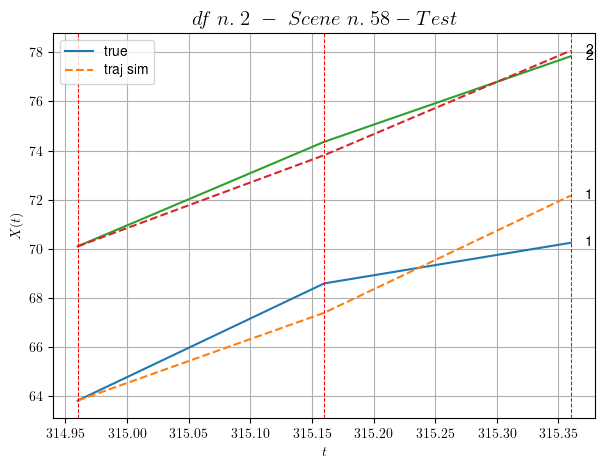

        For scene 58/63:
        * MSE = 0.9097875308166847
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.59/63


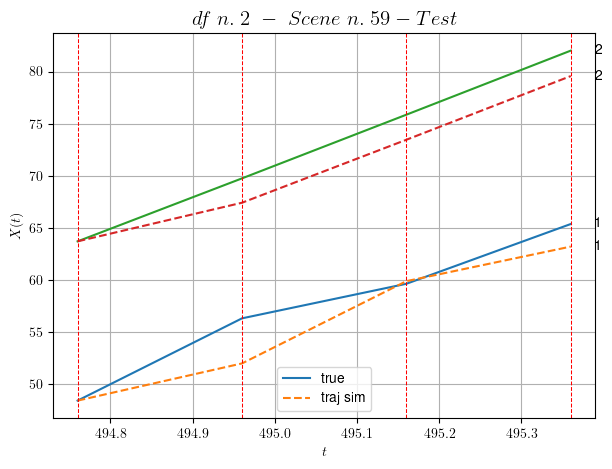

        For scene 59/63:
        * MSE = 5.093344885628053
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.60/63


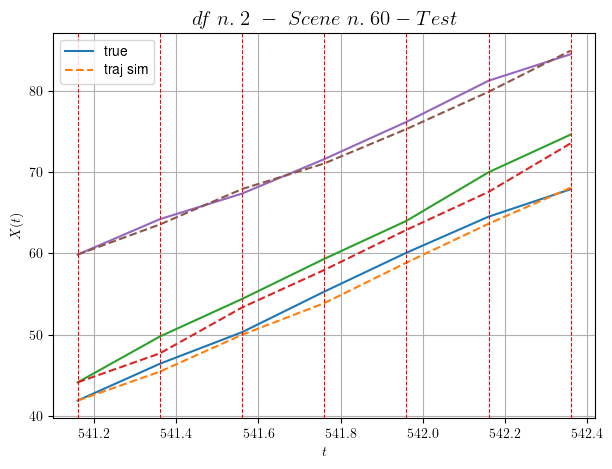

        For scene 60/63:
        * MSE = 1.1765048854008797
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.61/63


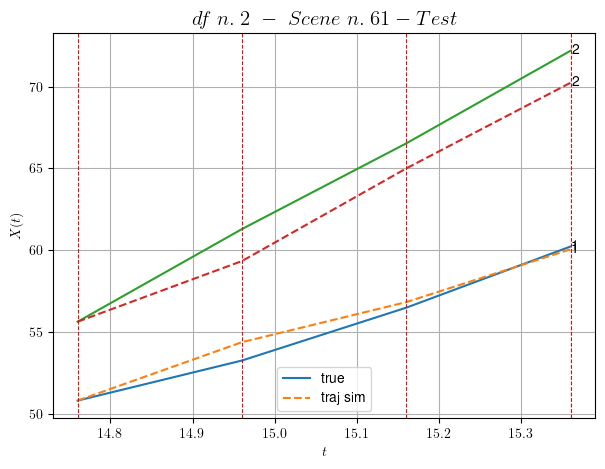

        For scene 61/63:
        * MSE = 1.4246440158301896
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.62/63


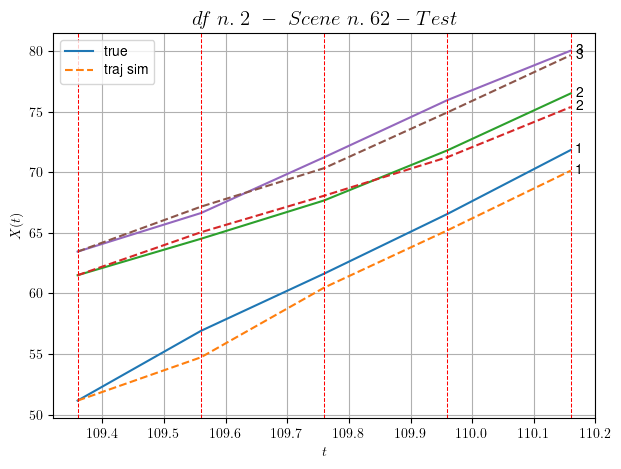

        For scene 62/63:
        * MSE = 1.007655211186733
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.63/63


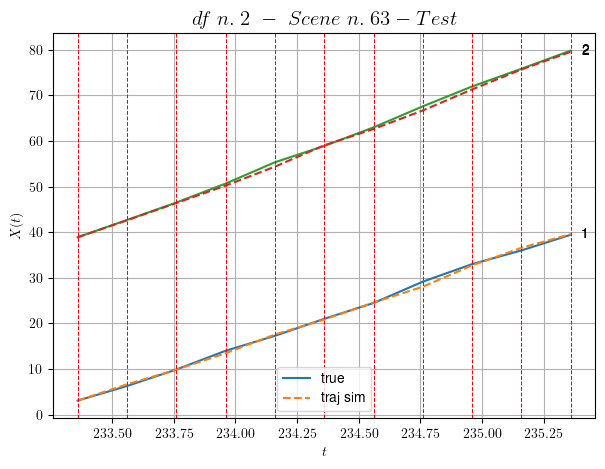

        For scene 63/63:
        * MSE = 0.22135164517939948
----------------------------------------------------------------------------------------------------


MSE test: 1.257636553573315

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.047053096741288
          * MSE test: 1.257636553573315
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 3/10 dfs.
In DataFrame n.3 we have 90 scenes.
    To train the model we use 9 scenes, the remaining 81 to test the model.

Training step. (9 scenes)
DataFrame n.3. Scene n.1/9
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [436.16,437.56]


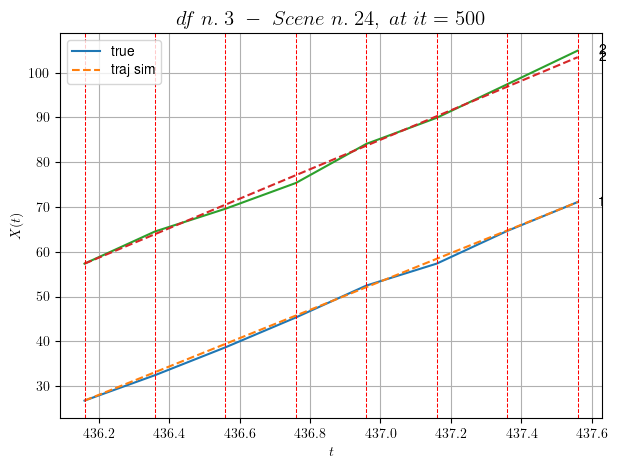

----------------------------------------------------------------------------------------------------
        For scene 1/9:
        * After LR finder: LR_NN=0.0005 with mse=4.065866558249181 at it=24
        * v0 = 32.92393930276385
        * MSE = 0.5921432203014574
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/9
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [170.36,170.76]


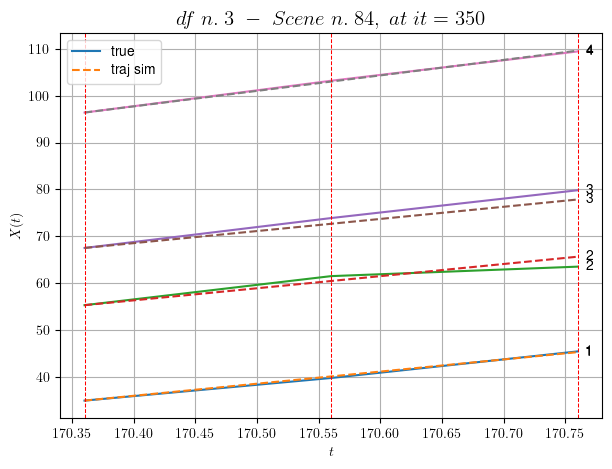

----------------------------------------------------------------------------------------------------
        For scene 2/9:
        * After LR finder: LR_NN=0.0005 with mse=24.396405947651665 at it=24
        * v0 = 32.99611396138449
        * MSE = 0.9275702522500011
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/9
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [579.56,580.56]


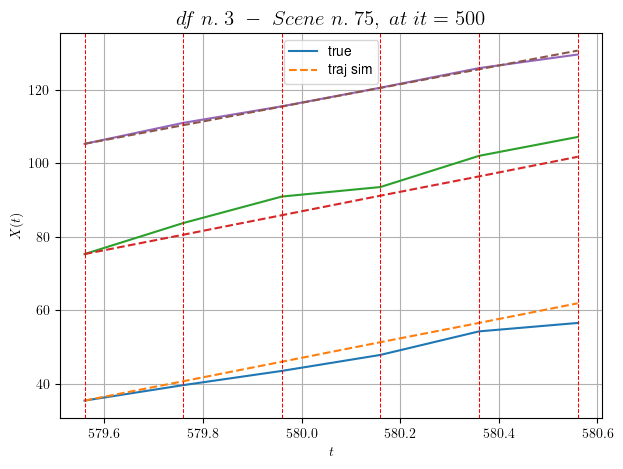

----------------------------------------------------------------------------------------------------
        For scene 3/9:
        * After LR finder: LR_NN=0.001 with mse=11.943531050319082 at it=24
        * v0 = 25.358404463470816
        * MSE = 8.690608977331648
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/9
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [142.16,142.76]


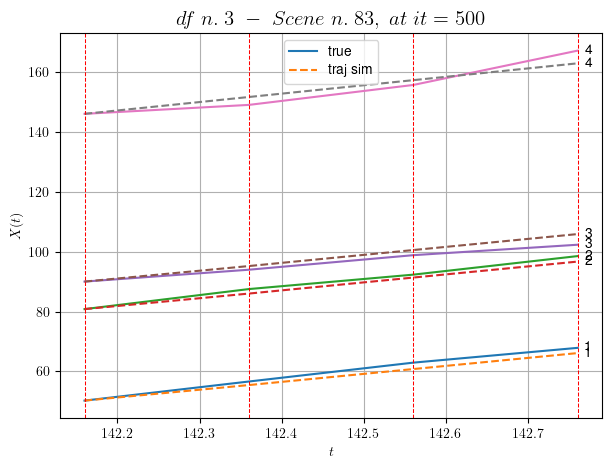

----------------------------------------------------------------------------------------------------
        For scene 4/9:
        * After LR finder: LR_NN=0.005 with mse=3.596354495814679 at it=24
        * v0 = 28.1212377485378
        * MSE = 3.538351308272568
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/9
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [417.16,418.16]


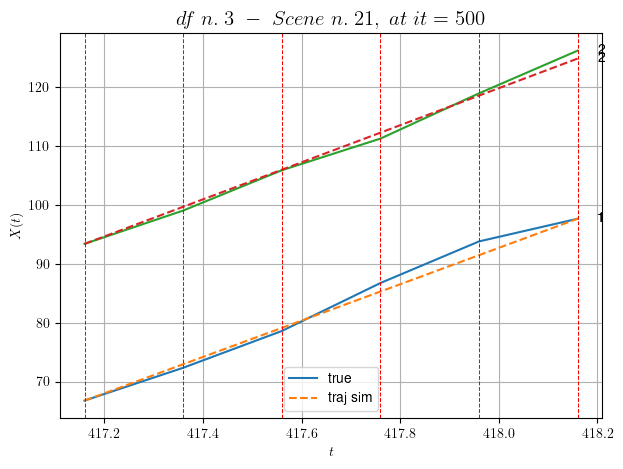

----------------------------------------------------------------------------------------------------
        For scene 5/9:
        * After LR finder: LR_NN=0.0001 with mse=2.5178678986421 at it=24
        * v0 = 31.447990123716654
        * MSE = 0.9606041797955843
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/9
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.36,388.16]


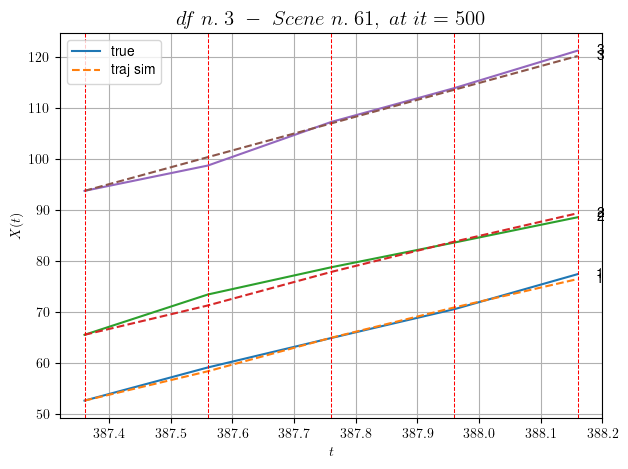

----------------------------------------------------------------------------------------------------
        For scene 6/9:
        * After LR finder: LR_NN=0.01 with mse=1.83285682689346 at it=24
        * v0 = 33.031898088254735
        * MSE = 0.7538863452185574
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/9
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [527.36,528.16]


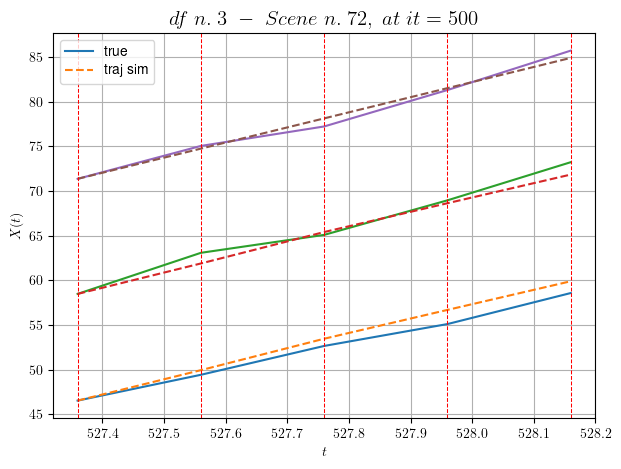

----------------------------------------------------------------------------------------------------
        For scene 7/9:
        * After LR finder: LR_NN=0.01 with mse=14.052226348230379 at it=24
        * v0 = 16.920906022778176
        * MSE = 0.6882442657158166
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/9
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [299.76,300.56]


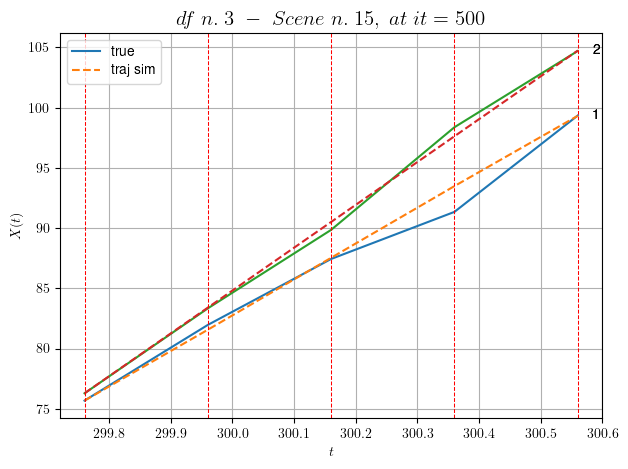

----------------------------------------------------------------------------------------------------
        For scene 8/9:
        * After LR finder: LR_NN=0.001 with mse=4.572736278907918 at it=24
        * v0 = 35.55620181997074
        * MSE = 0.5657102299674801
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/9
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [218.16,219.16]


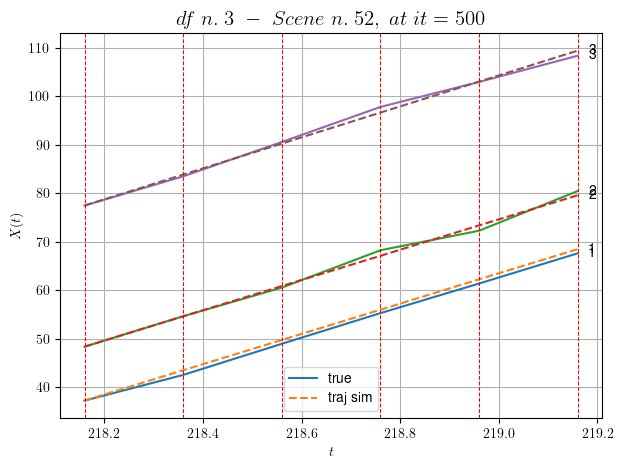

----------------------------------------------------------------------------------------------------
        For scene 9/9:
        * After LR finder: LR_NN=0.001 with mse=0.9306380616988088 at it=24
        * v0 = 31.946925583262825
        * MSE = 0.5314408199237077
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.9165066220863136
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (81 scenes)
DataFrame n.3. Scene n.1/81


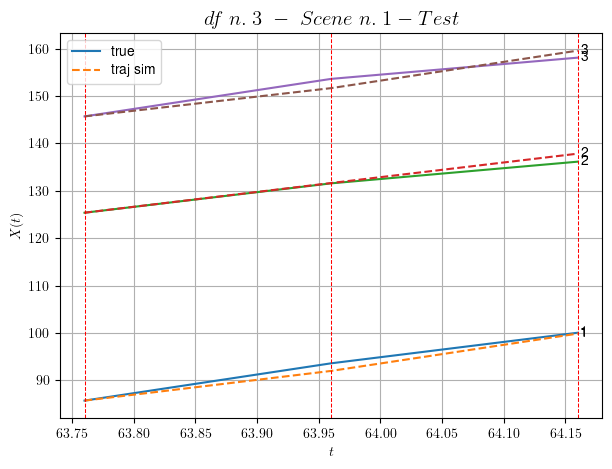

        For scene 1/81:
        * MSE = 1.2755961912342604
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/81


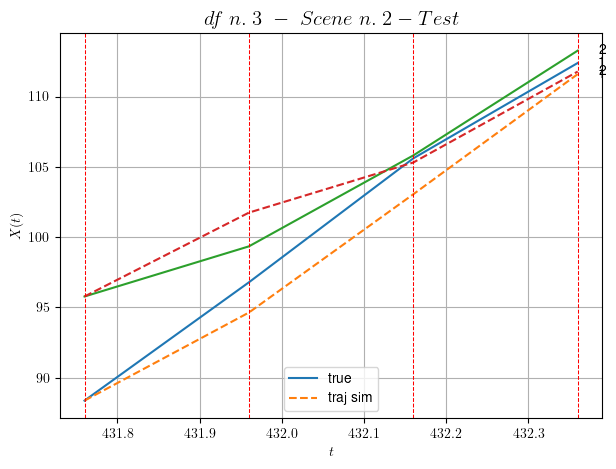

        For scene 2/81:
        * MSE = 2.497293685497485
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/81


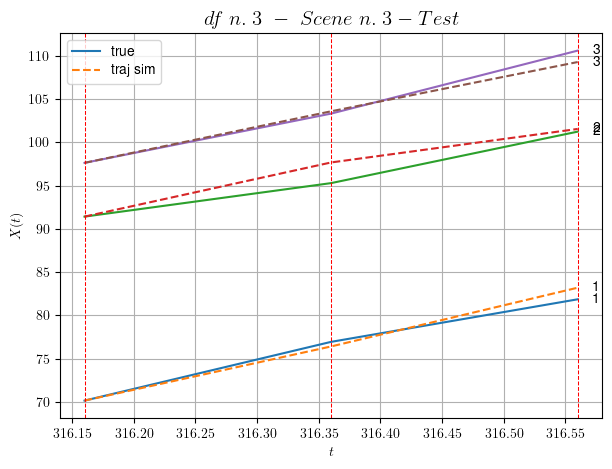

        For scene 3/81:
        * MSE = 1.0765697024498642
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/81


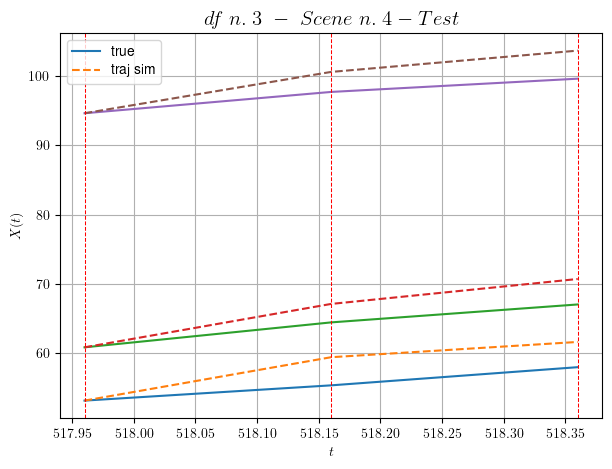

        For scene 4/81:
        * MSE = 8.340447611400768
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/81


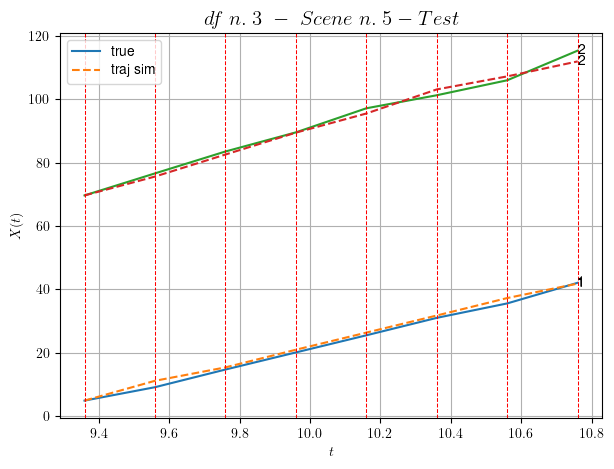

        For scene 5/81:
        * MSE = 1.9165274148915916
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/81


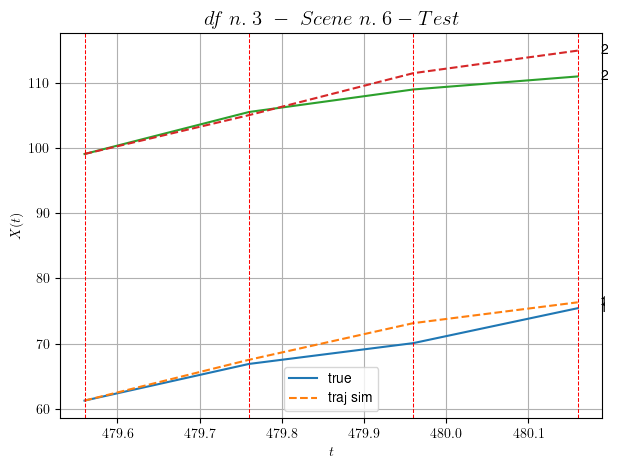

        For scene 6/81:
        * MSE = 4.1004819730444435
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/81


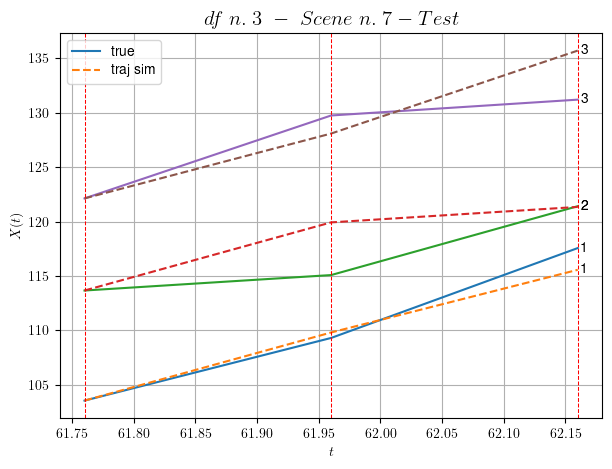

        For scene 7/81:
        * MSE = 5.639257650763447
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/81


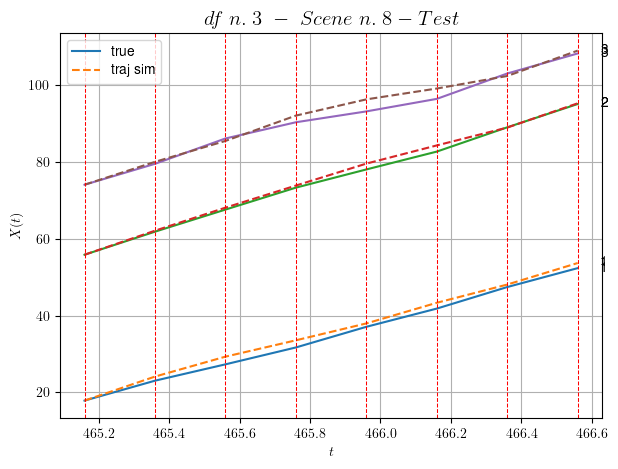

        For scene 8/81:
        * MSE = 1.7170305022724228
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/81


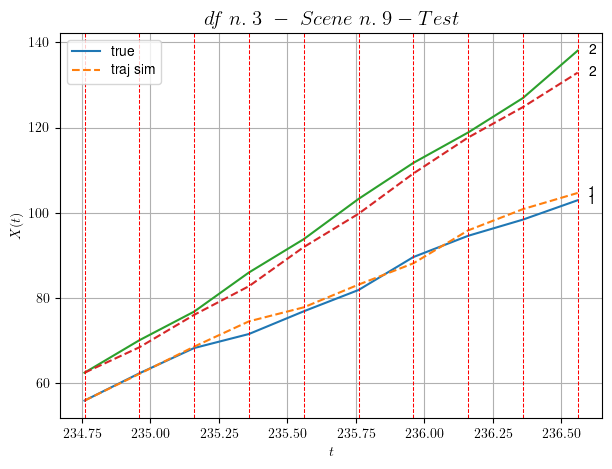

        For scene 9/81:
        * MSE = 4.615585044289168
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/81


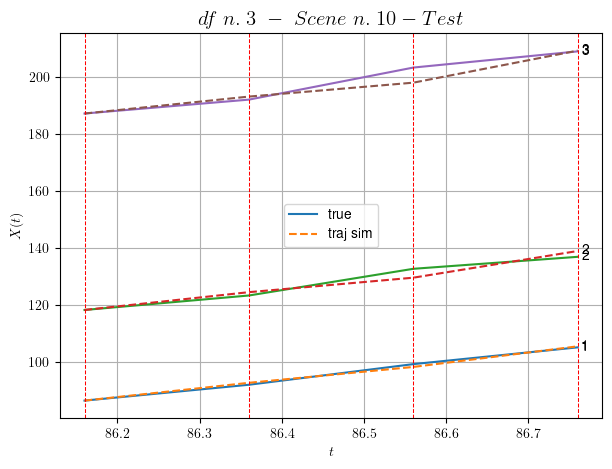

        For scene 10/81:
        * MSE = 3.8584278841714945
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/81


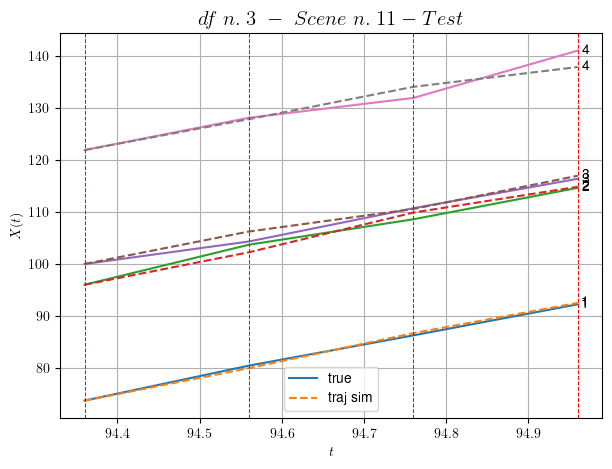

        For scene 11/81:
        * MSE = 1.4383694630491801
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/81


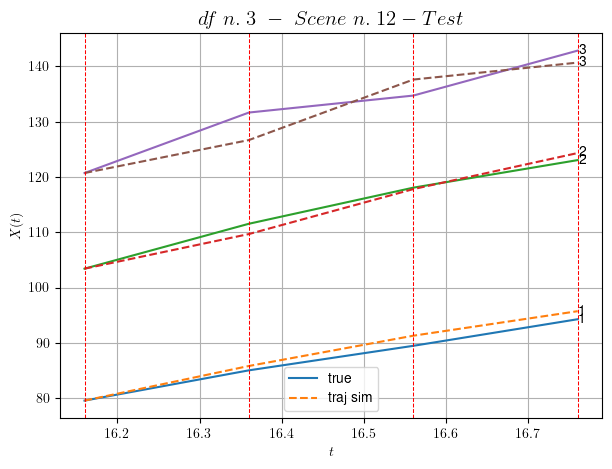

        For scene 12/81:
        * MSE = 4.086899830408262
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/81


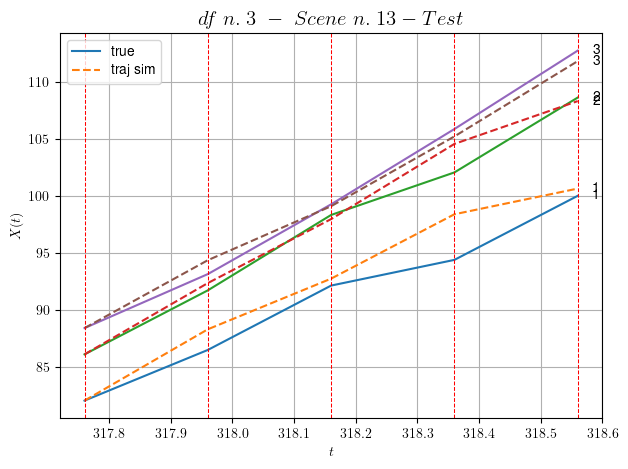

        For scene 13/81:
        * MSE = 1.9870205580651537
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/81


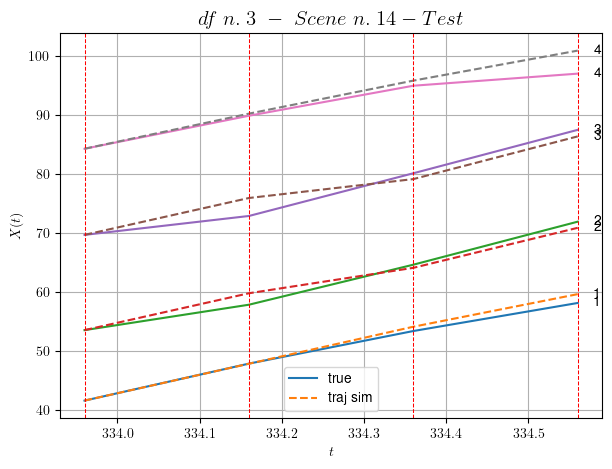

        For scene 14/81:
        * MSE = 2.2263994918442123
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/81


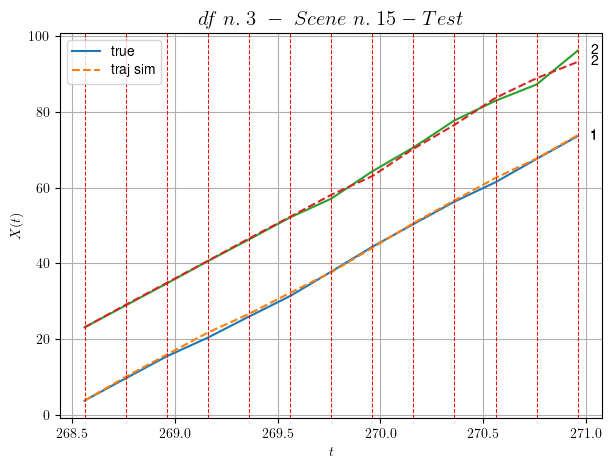

        For scene 15/81:
        * MSE = 0.8255729176249632
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/81


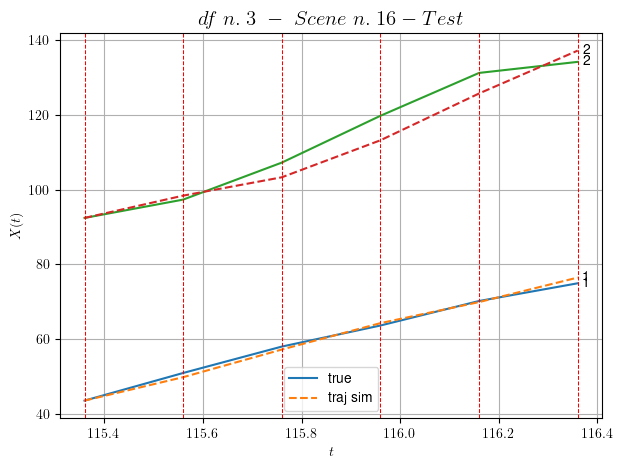

        For scene 16/81:
        * MSE = 8.602075703400137
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/81


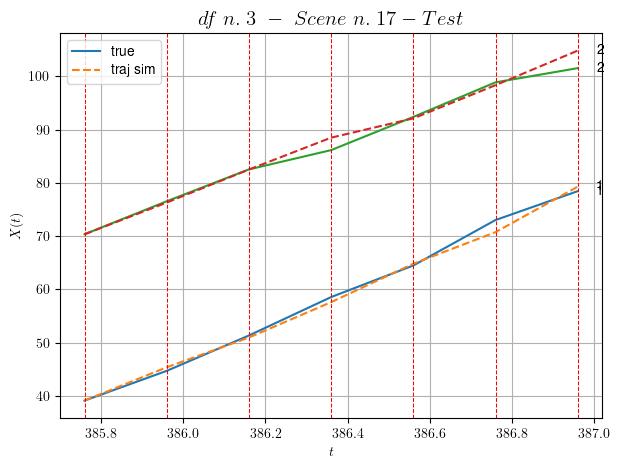

        For scene 17/81:
        * MSE = 1.7336753305027854
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/81


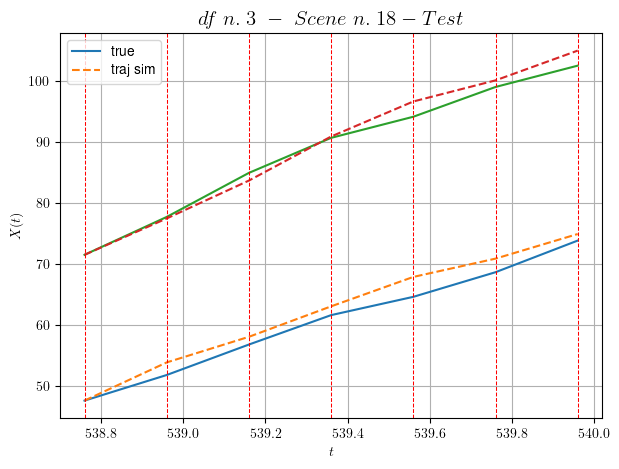

        For scene 18/81:
        * MSE = 2.850814665009479
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/81


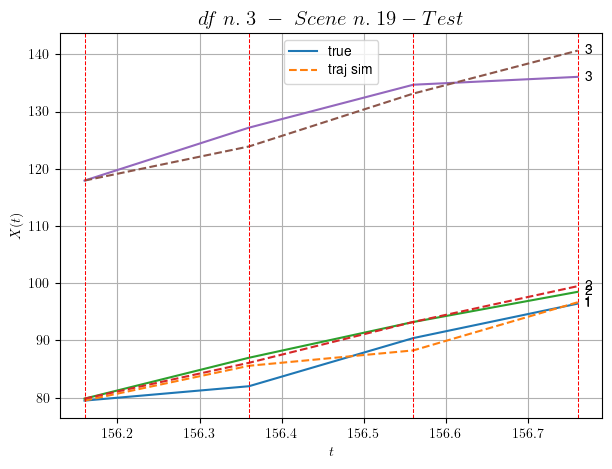

        For scene 19/81:
        * MSE = 4.451844262096789
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/81


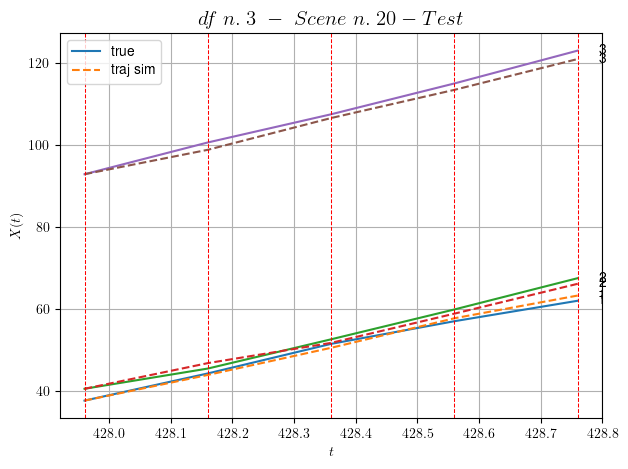

        For scene 20/81:
        * MSE = 1.2882180481420238
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/81


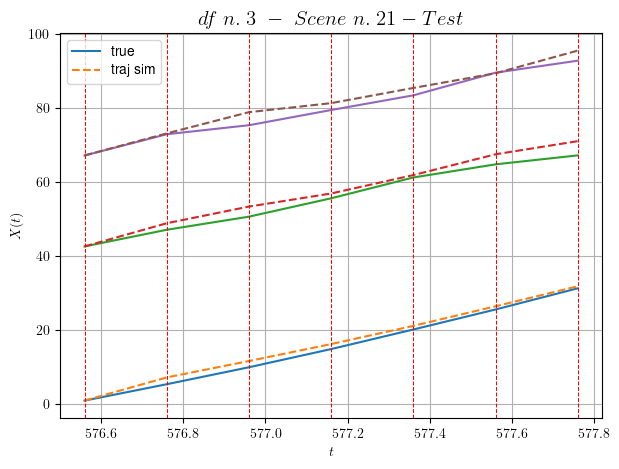

        For scene 21/81:
        * MSE = 3.4307938411976746
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/81


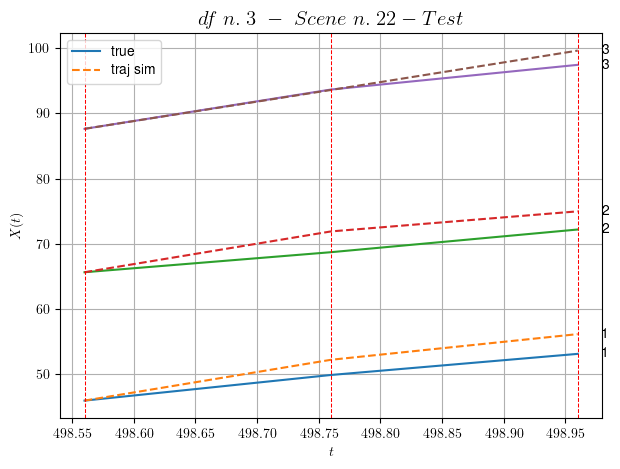

        For scene 22/81:
        * MSE = 4.140971647674481
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/81


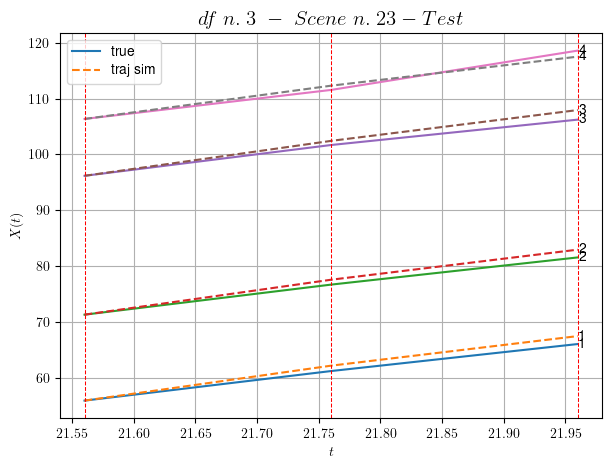

        For scene 23/81:
        * MSE = 0.907890948048605
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/81


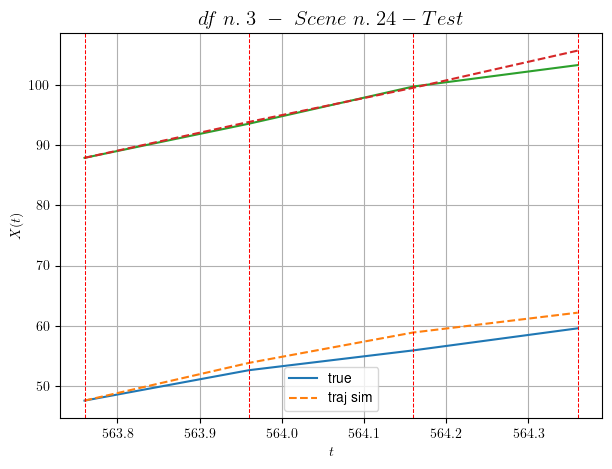

        For scene 24/81:
        * MSE = 2.871959819734934
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/81


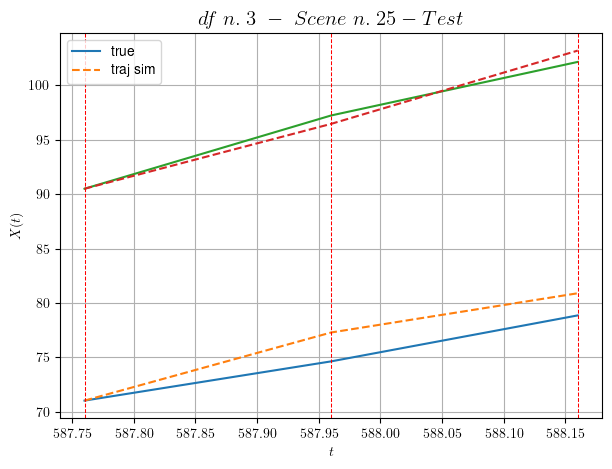

        For scene 25/81:
        * MSE = 2.1455082936240073
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/81


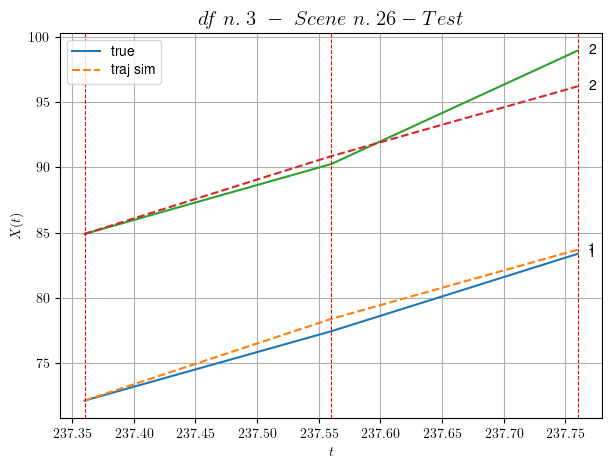

        For scene 26/81:
        * MSE = 1.4769977484416033
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/81


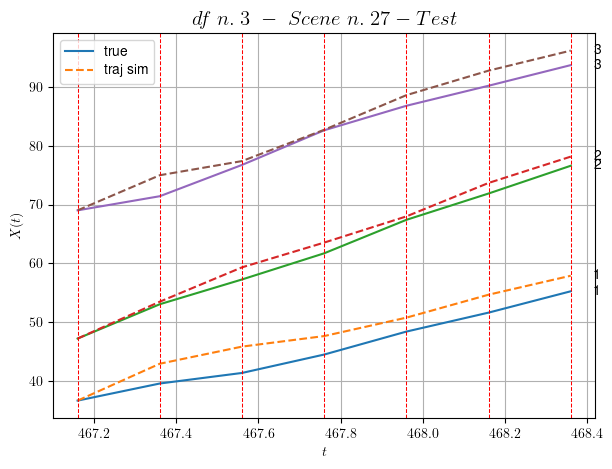

        For scene 27/81:
        * MSE = 5.028076351328166
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/81


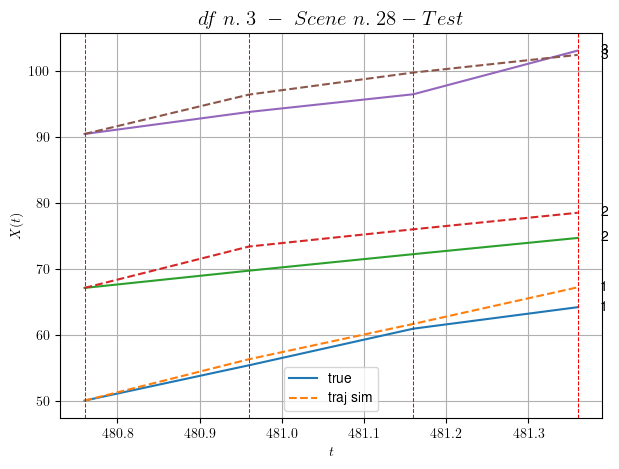

        For scene 28/81:
        * MSE = 5.87821473507826
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/81


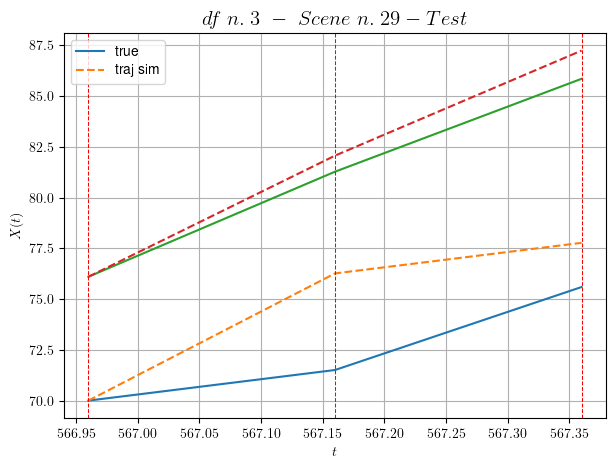

        For scene 29/81:
        * MSE = 4.983413292398605
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/81


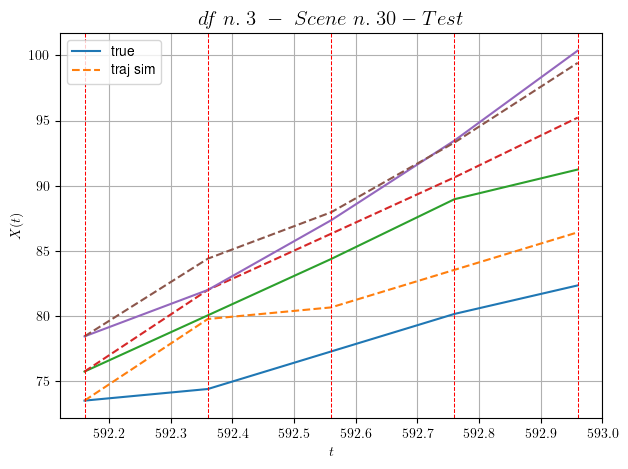

        For scene 30/81:
        * MSE = 6.773561164835037
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.31/81


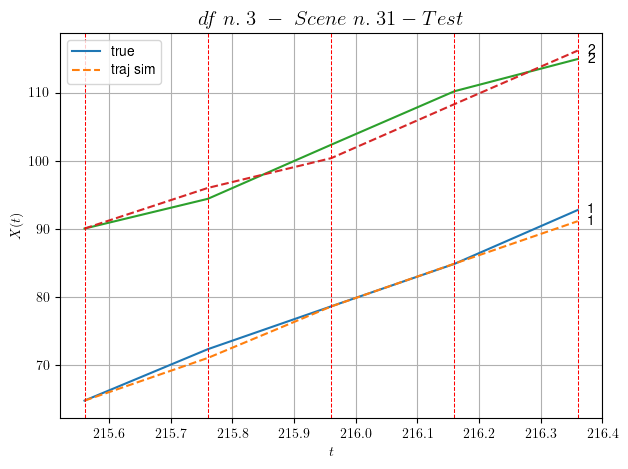

        For scene 31/81:
        * MSE = 1.587145464694165
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.32/81


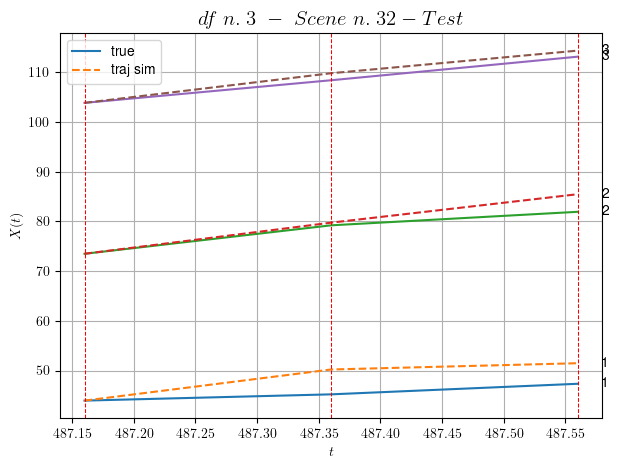

        For scene 32/81:
        * MSE = 6.4933725393968125
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.33/81


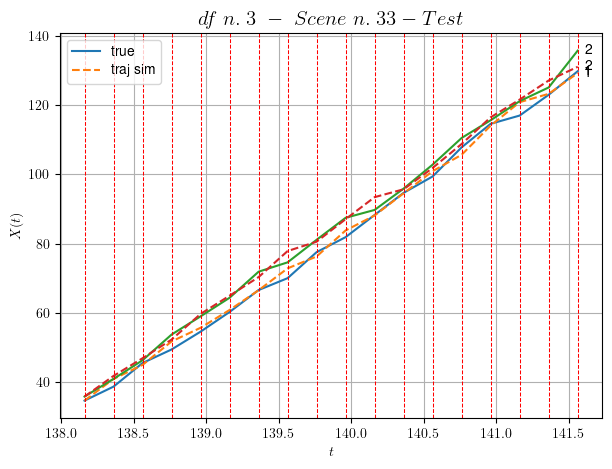

        For scene 33/81:
        * MSE = 3.052528103875395
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.34/81


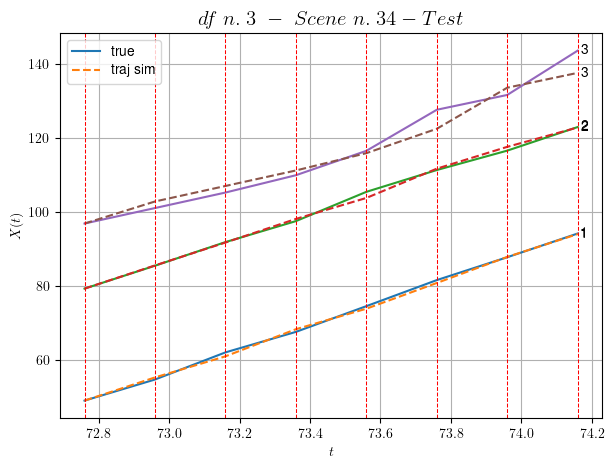

        For scene 34/81:
        * MSE = 3.4214211715429967
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.35/81


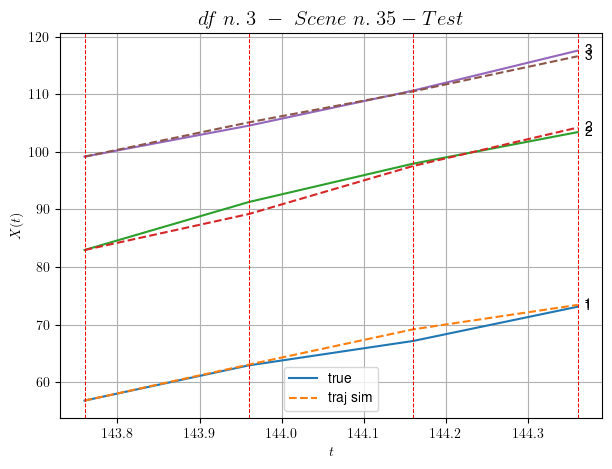

        For scene 35/81:
        * MSE = 0.885332454199502
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.36/81


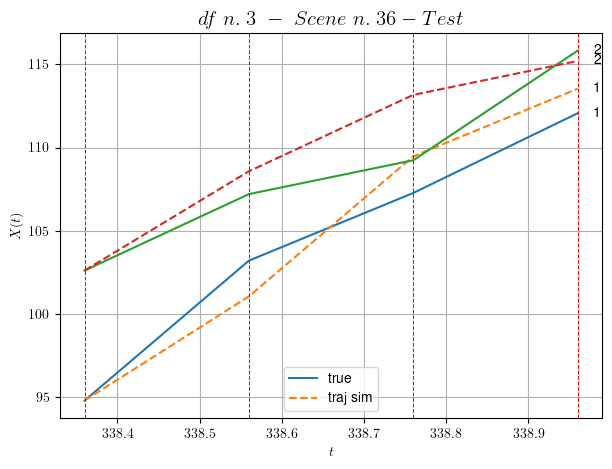

        For scene 36/81:
        * MSE = 3.660652815627947
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.37/81


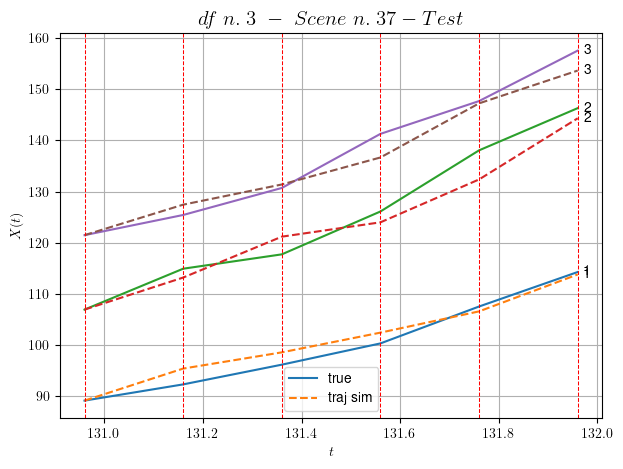

        For scene 37/81:
        * MSE = 6.550290064514279
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.38/81


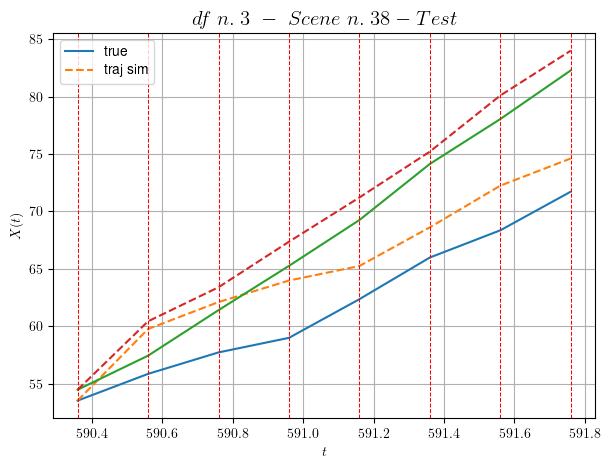

        For scene 38/81:
        * MSE = 7.988377852266712
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.39/81


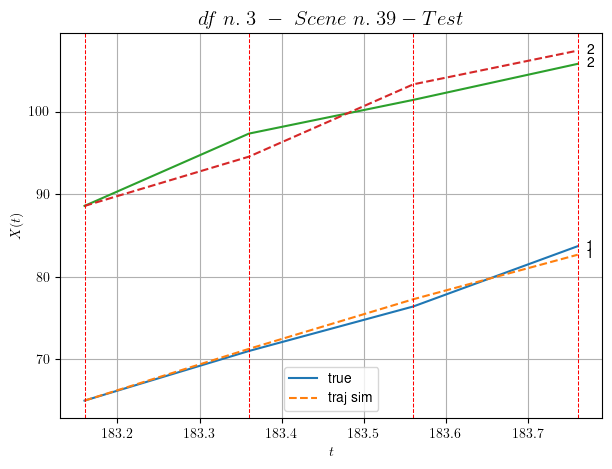

        For scene 39/81:
        * MSE = 1.9725100773134965
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.40/81


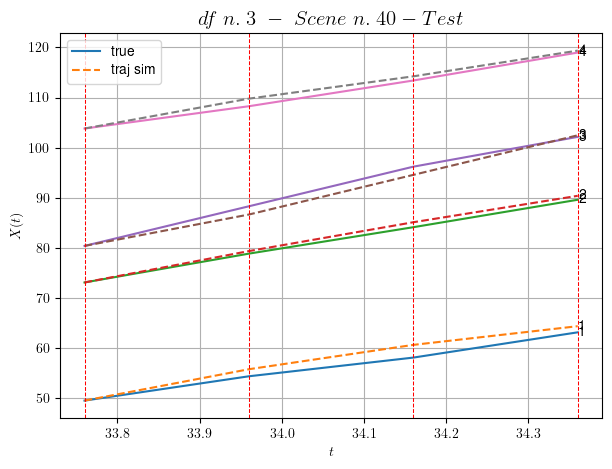

        For scene 40/81:
        * MSE = 1.2732813282715332
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.41/81


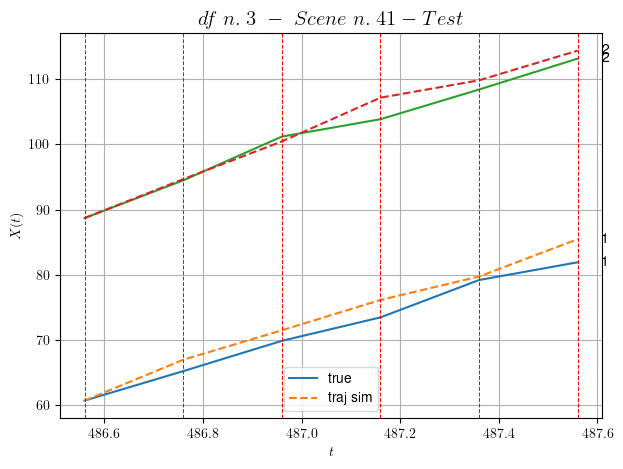

        For scene 41/81:
        * MSE = 3.383395707052027
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.42/81


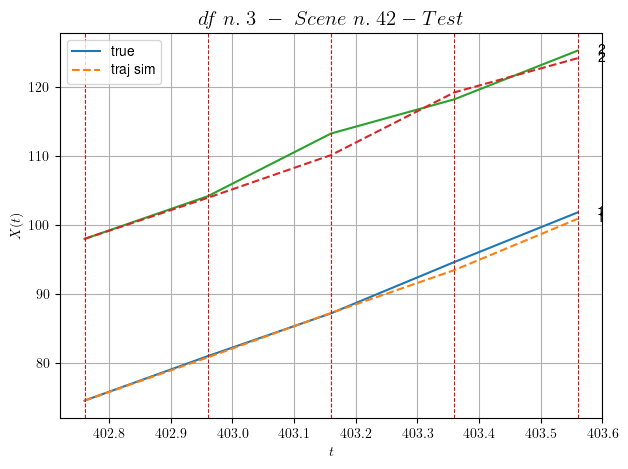

        For scene 42/81:
        * MSE = 1.4348335111823414
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.43/81


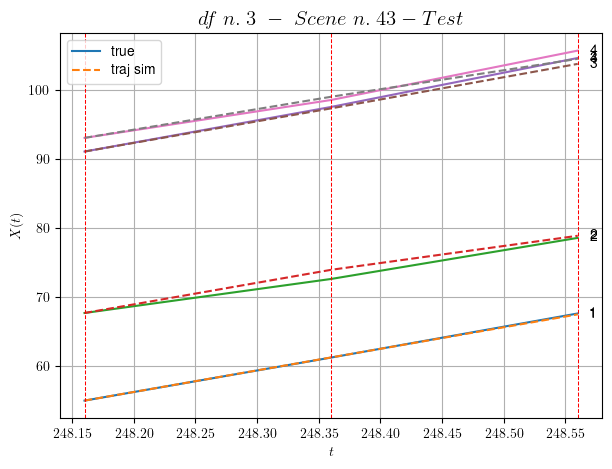

        For scene 43/81:
        * MSE = 0.3577249360015599
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.44/81


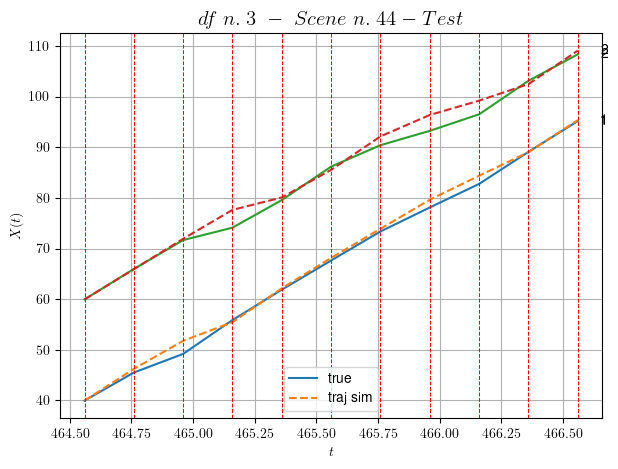

        For scene 44/81:
        * MSE = 2.138048509644282
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.45/81


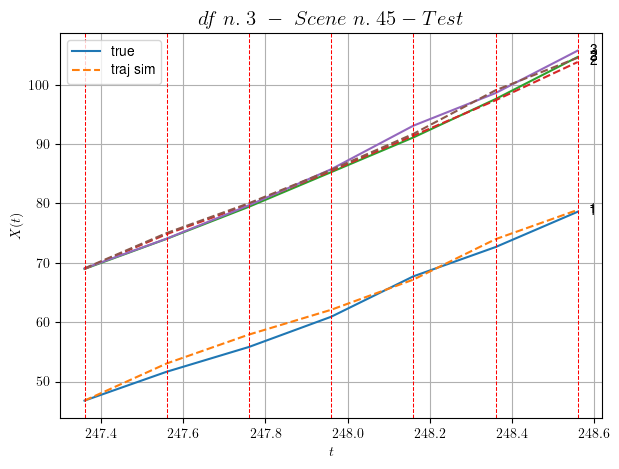

        For scene 45/81:
        * MSE = 0.7674689118887029
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.46/81


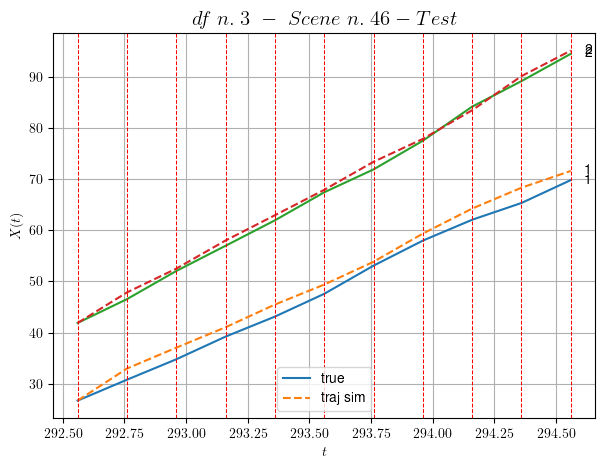

        For scene 46/81:
        * MSE = 2.264881624002266
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.47/81


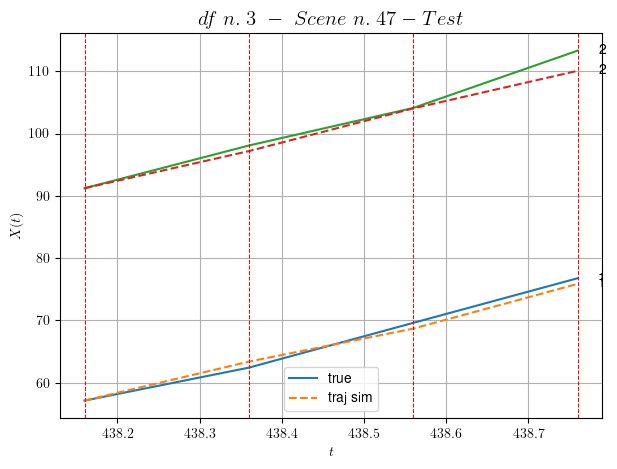

        For scene 47/81:
        * MSE = 1.7401295797901926
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.48/81


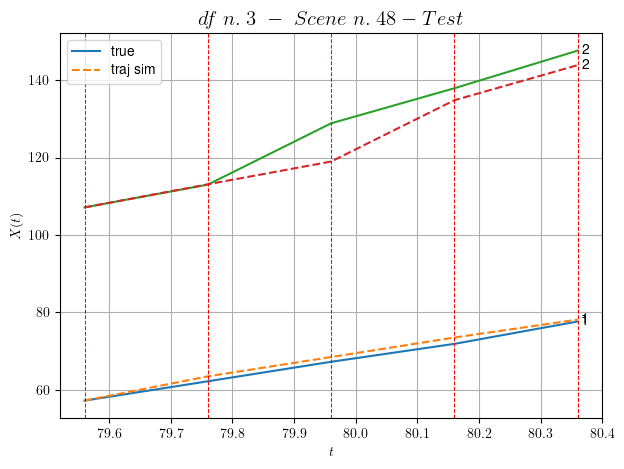

        For scene 48/81:
        * MSE = 12.70358345294577
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.49/81


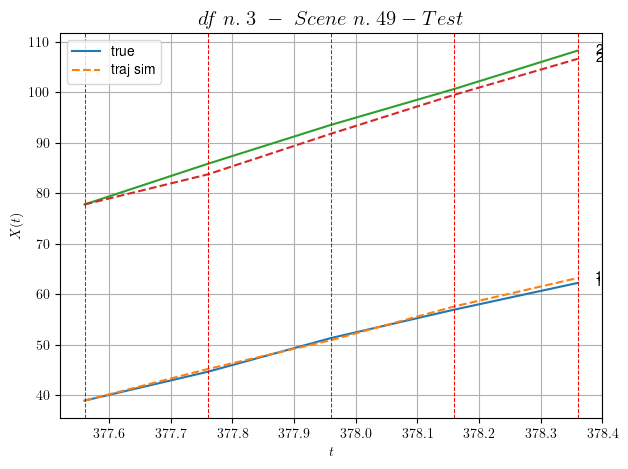

        For scene 49/81:
        * MSE = 1.3285002559841494
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.50/81


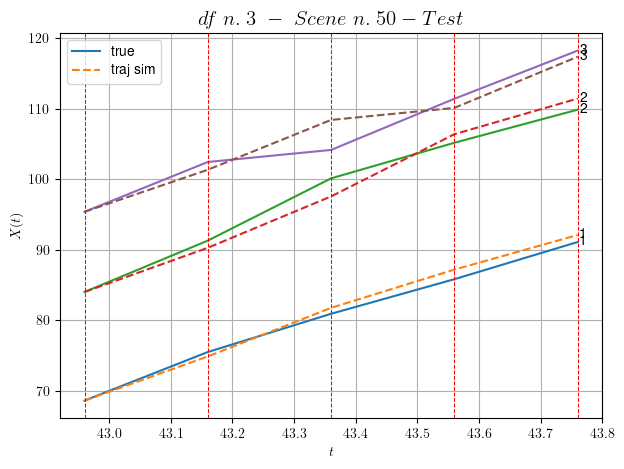

        For scene 50/81:
        * MSE = 2.4809128815194734
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.51/81


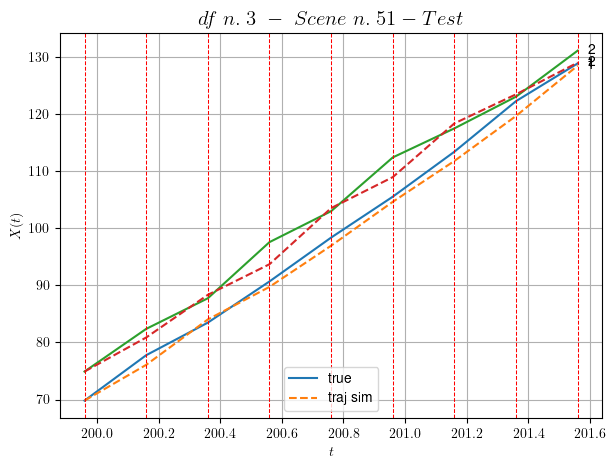

        For scene 51/81:
        * MSE = 2.8632978879445012
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.52/81


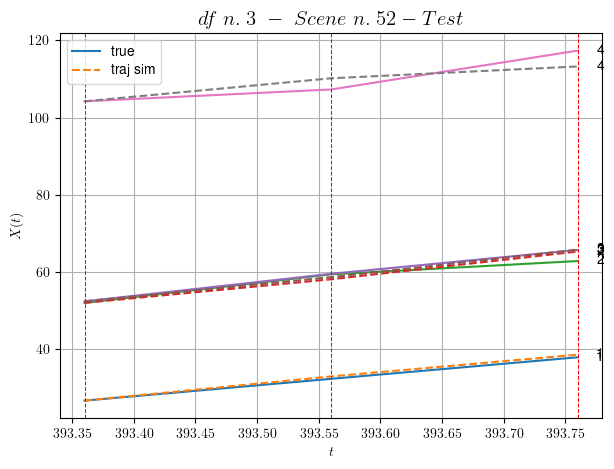

        For scene 52/81:
        * MSE = 2.8776168595106064
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.53/81


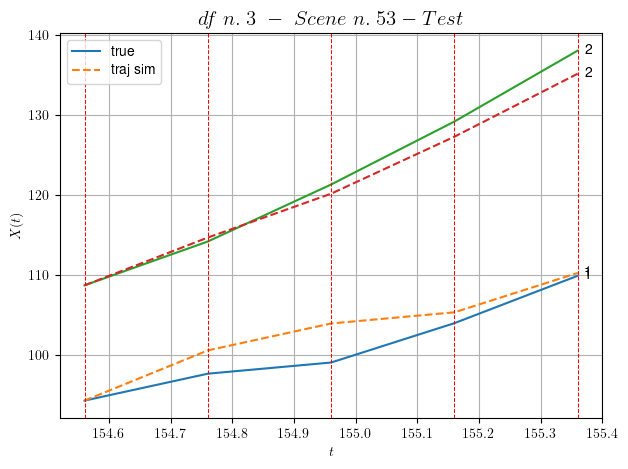

        For scene 53/81:
        * MSE = 4.753738230440555
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.54/81


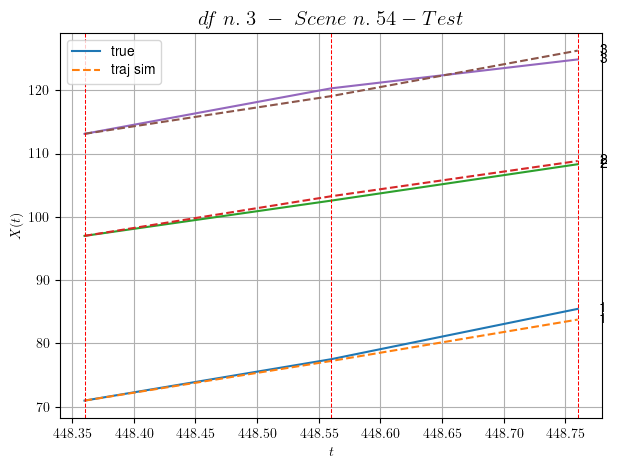

        For scene 54/81:
        * MSE = 0.792596132104888
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.55/81


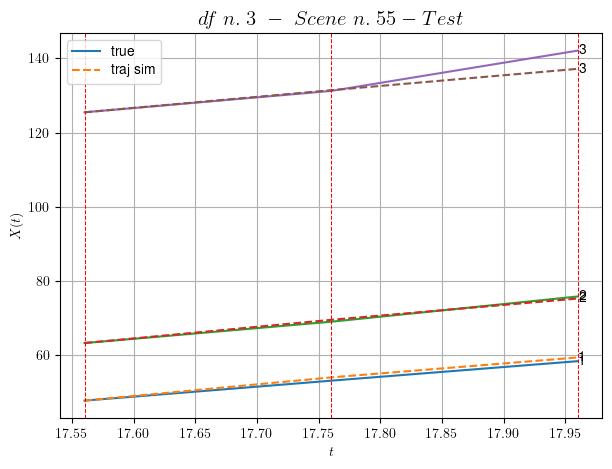

        For scene 55/81:
        * MSE = 2.947699190945642
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.56/81


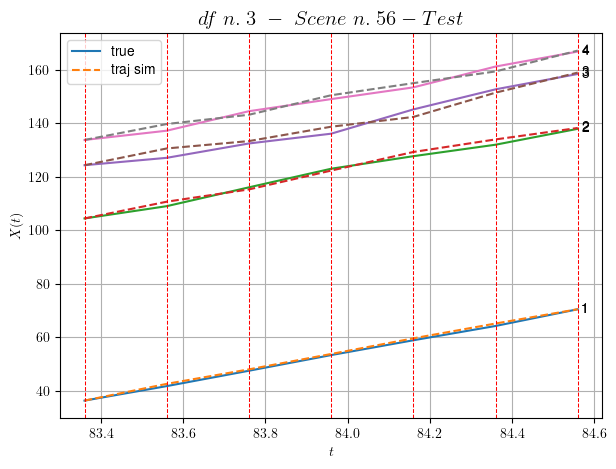

        For scene 56/81:
        * MSE = 2.0870567353661764
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.57/81


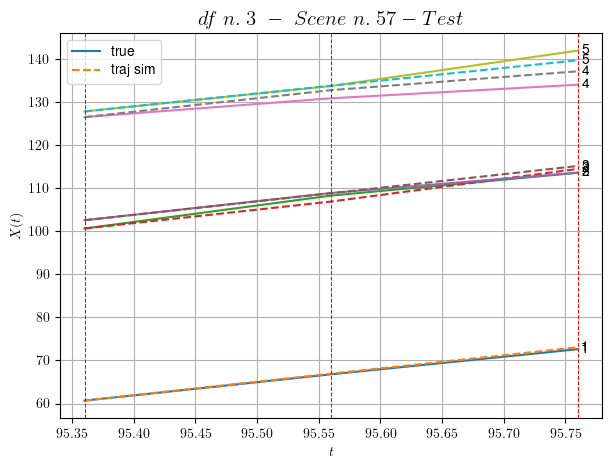

        For scene 57/81:
        * MSE = 1.5778646717096163
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.58/81


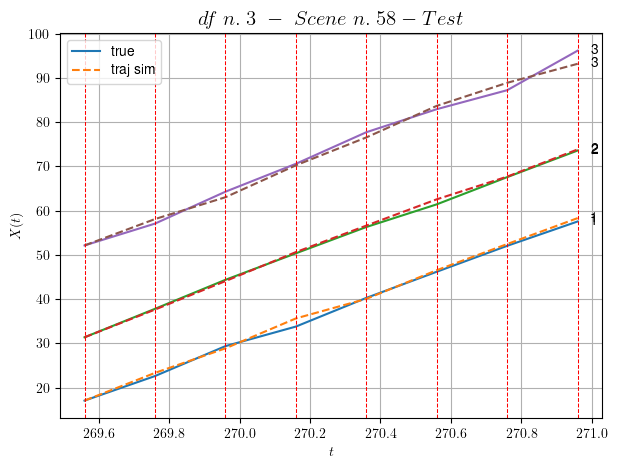

        For scene 58/81:
        * MSE = 0.9596882298860772
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.59/81


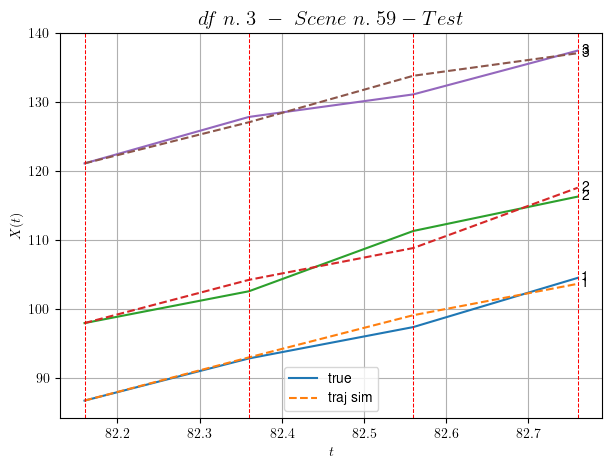

        For scene 59/81:
        * MSE = 1.8510245409570285
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.60/81


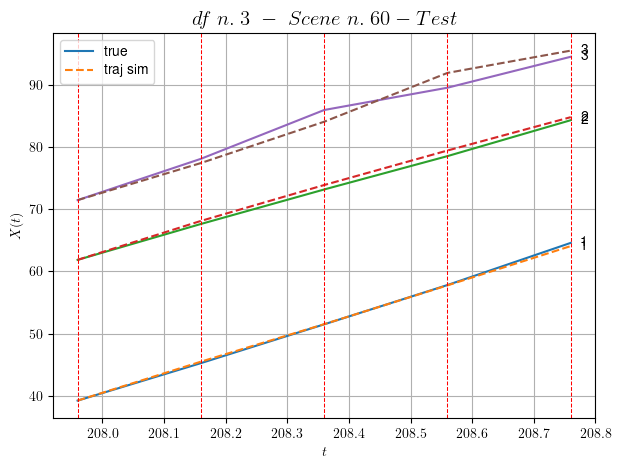

        For scene 60/81:
        * MSE = 0.8507509933261952
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.61/81


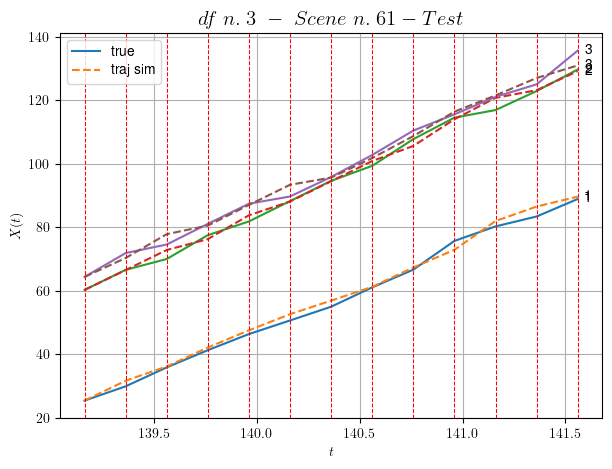

        For scene 61/81:
        * MSE = 3.287667355853612
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.62/81


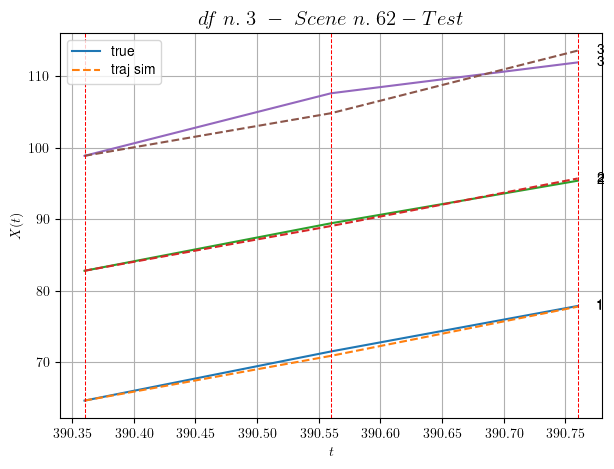

        For scene 62/81:
        * MSE = 1.2354910753584887
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.63/81


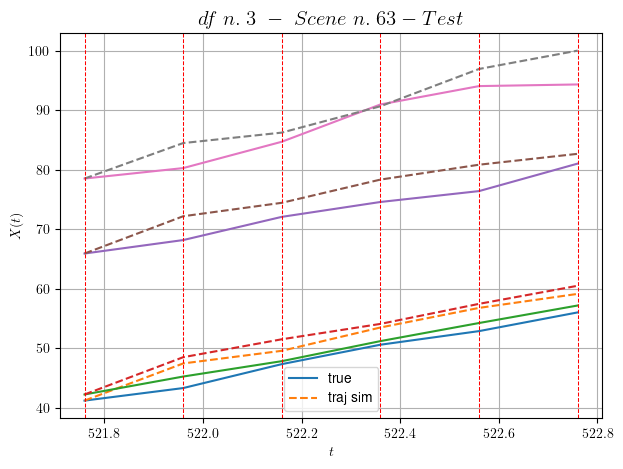

        For scene 63/81:
        * MSE = 9.50230875643555
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.64/81


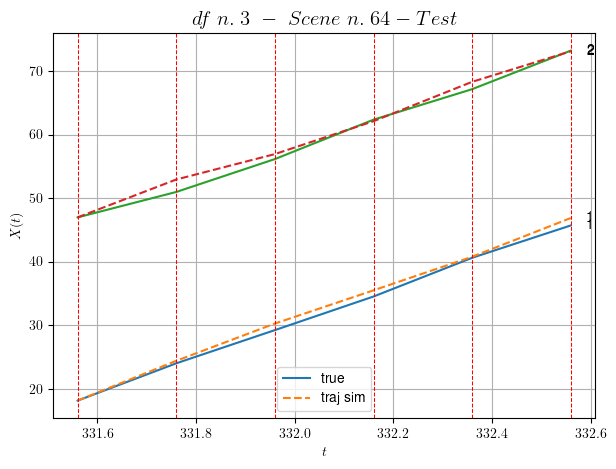

        For scene 64/81:
        * MSE = 0.7855524538570804
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.65/81


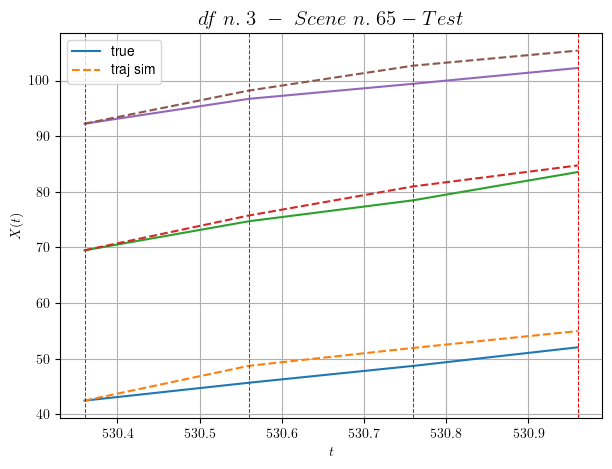

        For scene 65/81:
        * MSE = 4.966046418327552
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.66/81


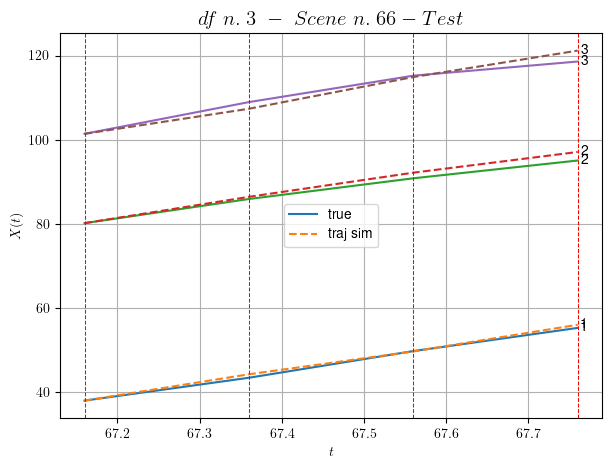

        For scene 66/81:
        * MSE = 1.3961498998595647
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.67/81


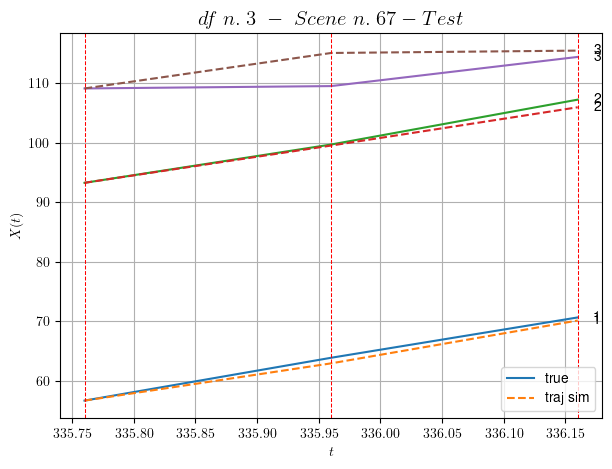

        For scene 67/81:
        * MSE = 3.878711257075708
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.68/81


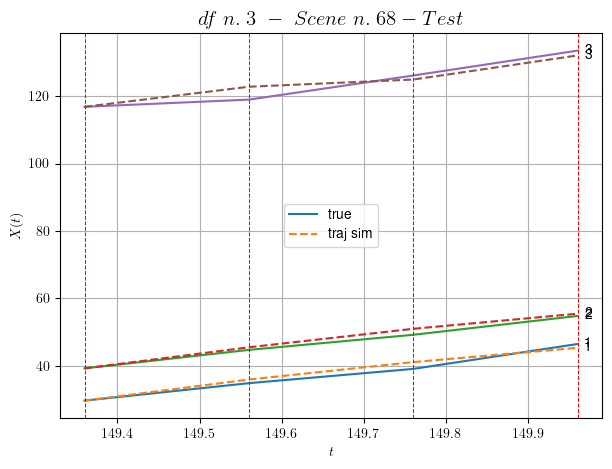

        For scene 68/81:
        * MSE = 2.4048847101684454
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.69/81


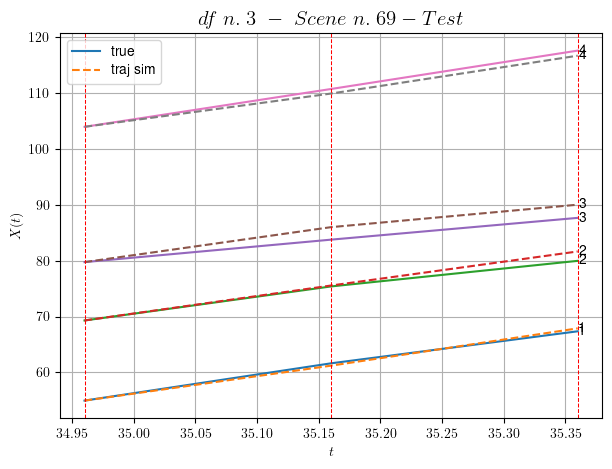

        For scene 69/81:
        * MSE = 1.282623384799404
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.70/81


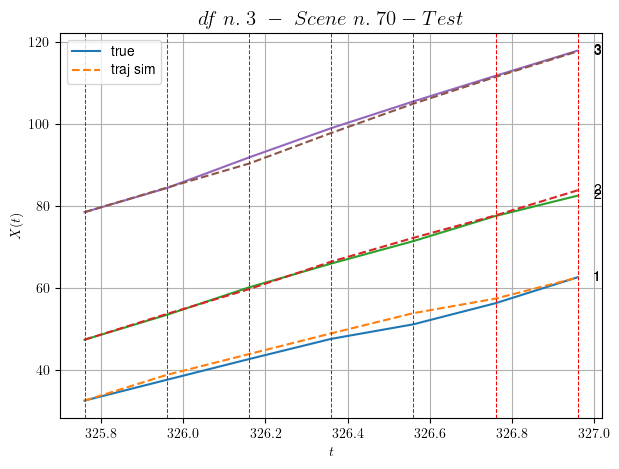

        For scene 70/81:
        * MSE = 0.9608879991183903
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.71/81


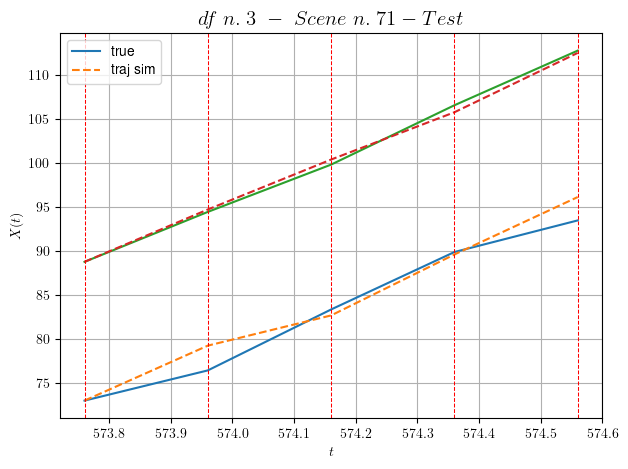

        For scene 71/81:
        * MSE = 1.6692575749282759
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.72/81


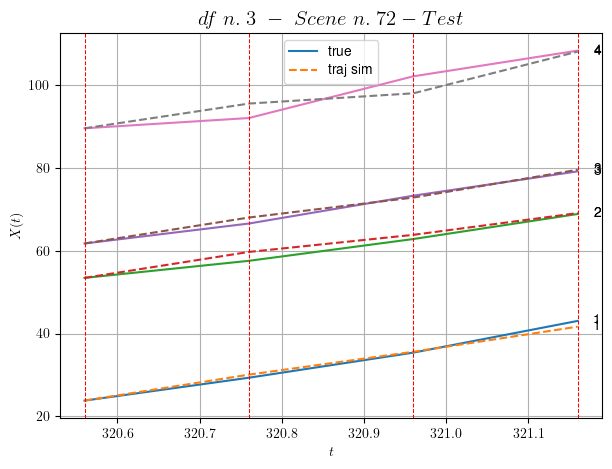

        For scene 72/81:
        * MSE = 2.475838189245872
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.73/81


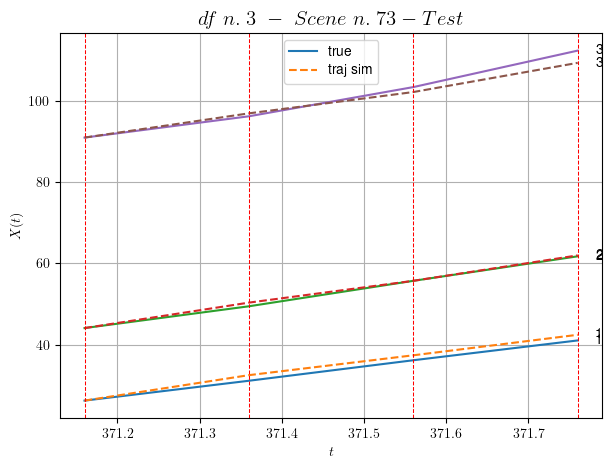

        For scene 73/81:
        * MSE = 1.4373461083538708
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.74/81


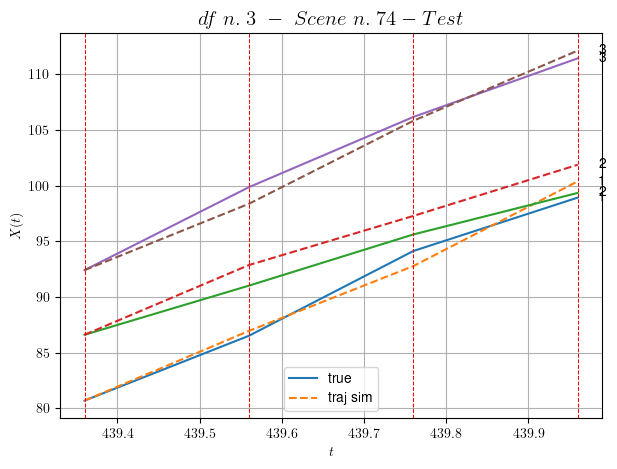

        For scene 74/81:
        * MSE = 1.6312764206213153
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.75/81


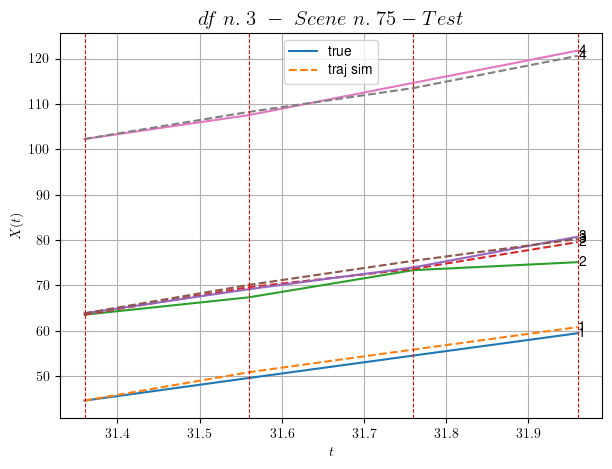

        For scene 75/81:
        * MSE = 2.264955232607104
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.76/81


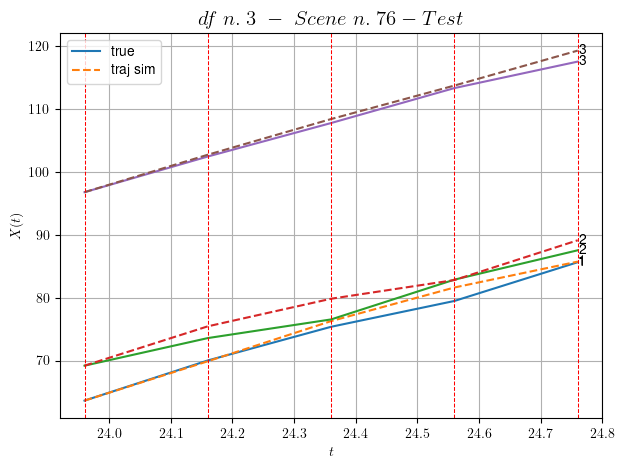

        For scene 76/81:
        * MSE = 1.7336821942463934
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.77/81


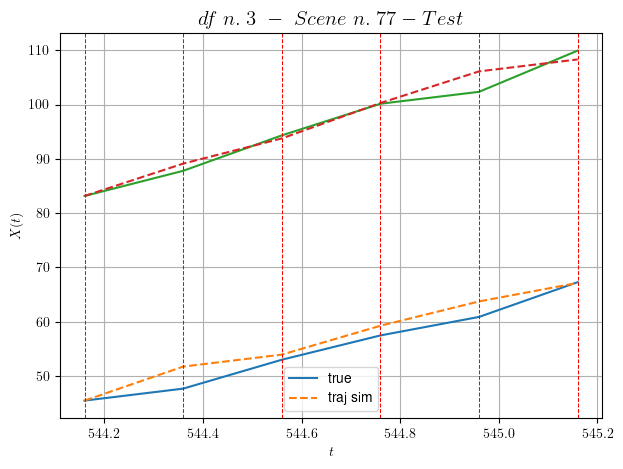

        For scene 77/81:
        * MSE = 3.964966667921621
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.78/81


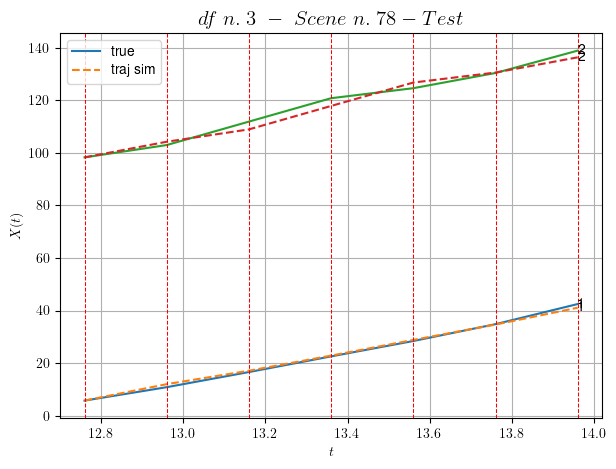

        For scene 78/81:
        * MSE = 2.429004564098108
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.79/81


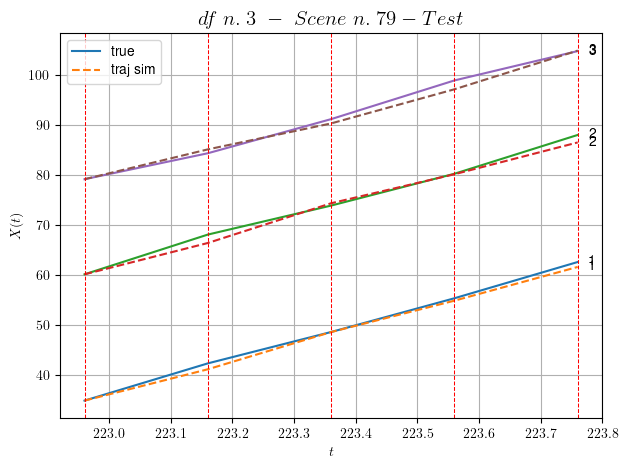

        For scene 79/81:
        * MSE = 0.8236662364830848
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.80/81


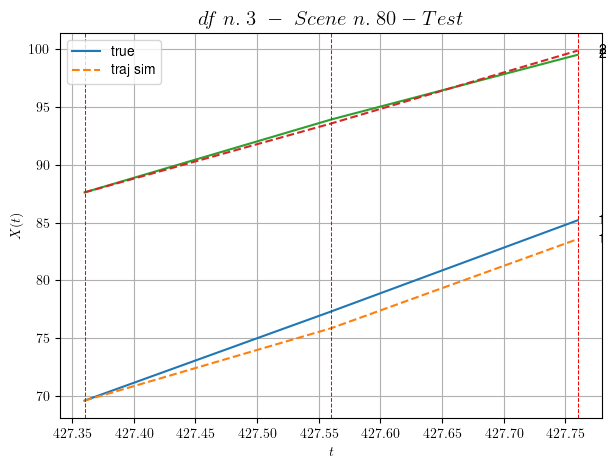

        For scene 80/81:
        * MSE = 0.8333238424980404
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.81/81


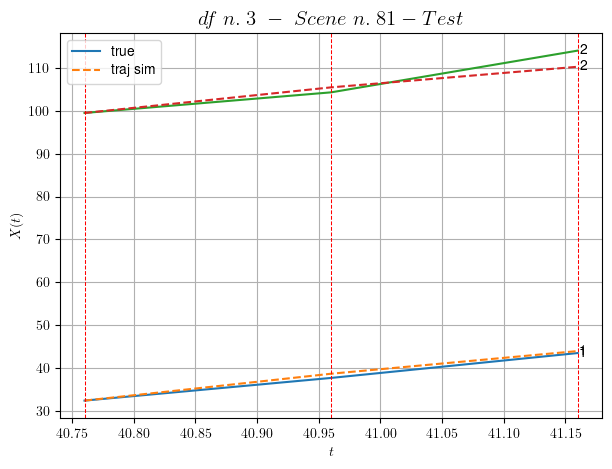

        For scene 81/81:
        * MSE = 2.776621268310541
----------------------------------------------------------------------------------------------------


MSE test: 2.974709655513484

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.9165066220863136
          * MSE test: 2.974709655513484
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 4/10 dfs.
In DataFrame n.4 we have 69 scenes.
    To train the model we use 6 scenes, the remaining 63 to test the model.

Training step. (6 scenes)
DataFrame n.4. Scene n.1/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [65.04,65.64]


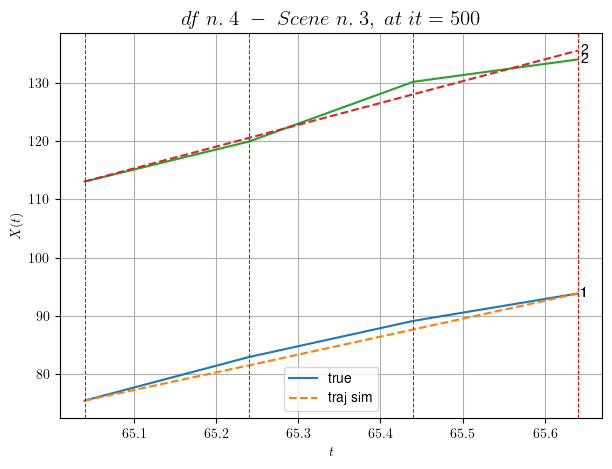

----------------------------------------------------------------------------------------------------
        For scene 1/6:
        * After LR finder: LR_NN=0.001 with mse=7.787142344063174 at it=24
        * v0 = 37.41903742148347
        * MSE = 1.425270592250694
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.44,321.04]


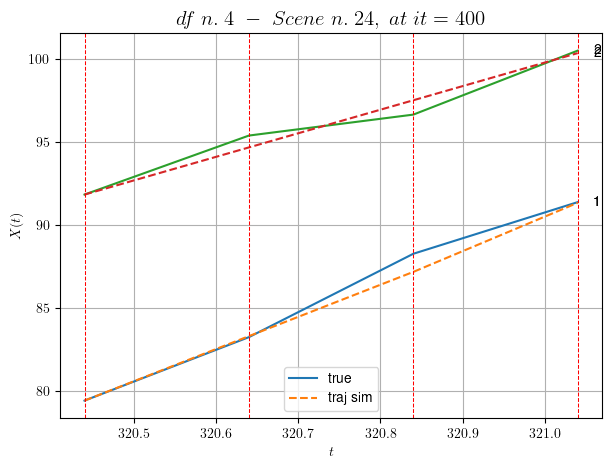

----------------------------------------------------------------------------------------------------
        For scene 2/6:
        * After LR finder: LR_NN=0.005 with mse=18.351196890148273 at it=24
        * v0 = 14.16242666935608
        * MSE = 0.30094346538318156
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/6
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [285.84,287.44]


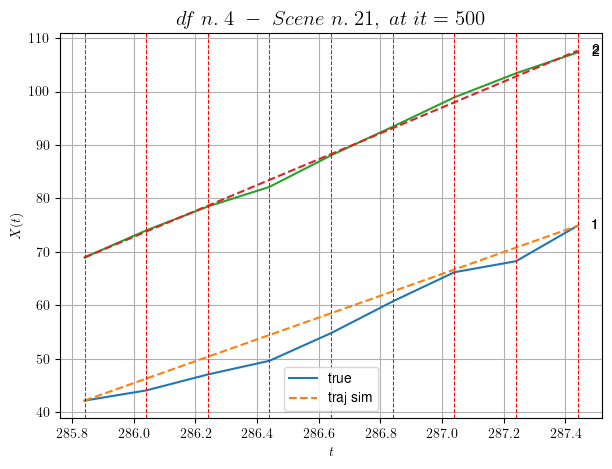

----------------------------------------------------------------------------------------------------
        For scene 3/6:
        * After LR finder: LR_NN=0.0005 with mse=16.622661169141736 at it=24
        * v0 = 24.201830847422606
        * MSE = 3.66352096954298
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/6
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.64,555.04]


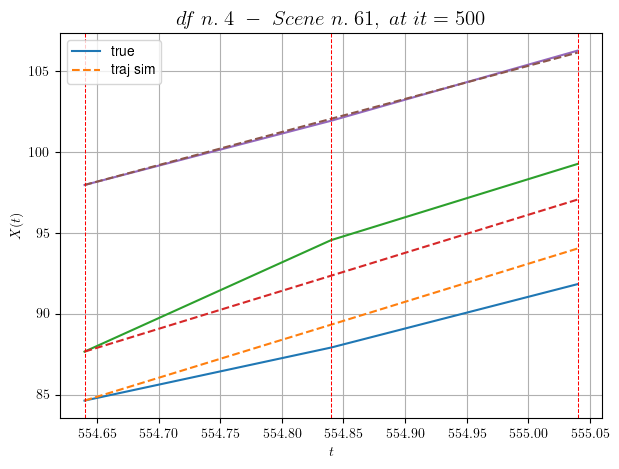

----------------------------------------------------------------------------------------------------
        For scene 4/6:
        * After LR finder: LR_NN=0.0005 with mse=2.4648397354850715 at it=24
        * v0 = 20.440727818765925
        * MSE = 1.8360997535264936
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/6
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [182.04,183.64]


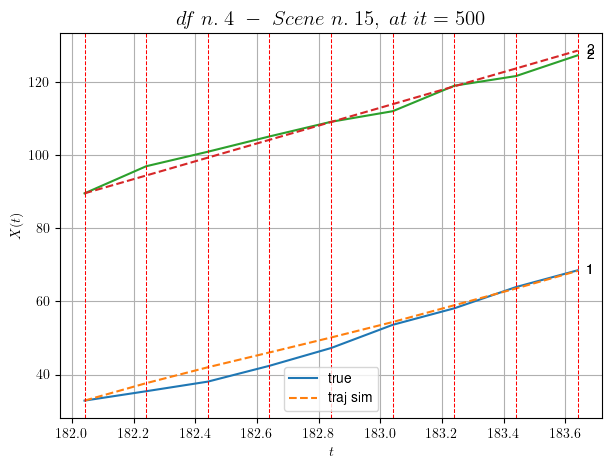

----------------------------------------------------------------------------------------------------
        For scene 5/6:
        * After LR finder: LR_NN=0.01 with mse=19.551506991139235 at it=24
        * v0 = 24.384953428579735
        * MSE = 2.2828612230149172
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/6
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [233.84,235.24]


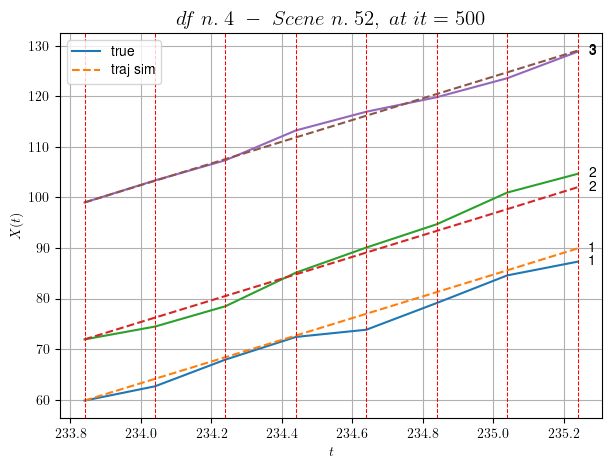

----------------------------------------------------------------------------------------------------
        For scene 6/6:
        * After LR finder: LR_NN=0.001 with mse=20.051662276630537 at it=24
        * v0 = 21.46280647198815
        * MSE = 2.3812879883220663
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.9816639986733888
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (63 scenes)
DataFrame n.4. Scene n.1/63


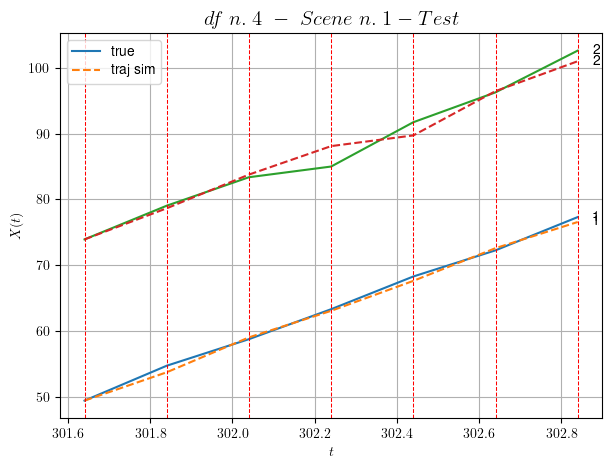

        For scene 1/63:
        * MSE = 1.3503442050566046
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/63


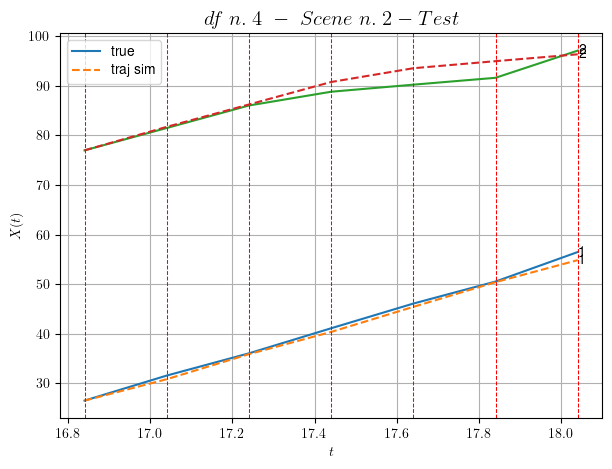

        For scene 2/63:
        * MSE = 2.2100416984815414
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/63


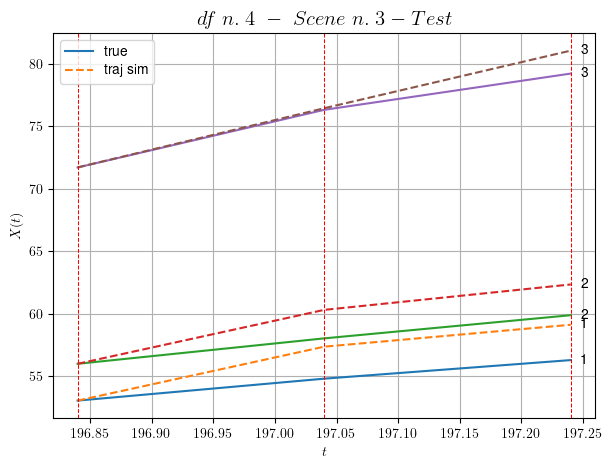

        For scene 3/63:
        * MSE = 3.239105224449054
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/63


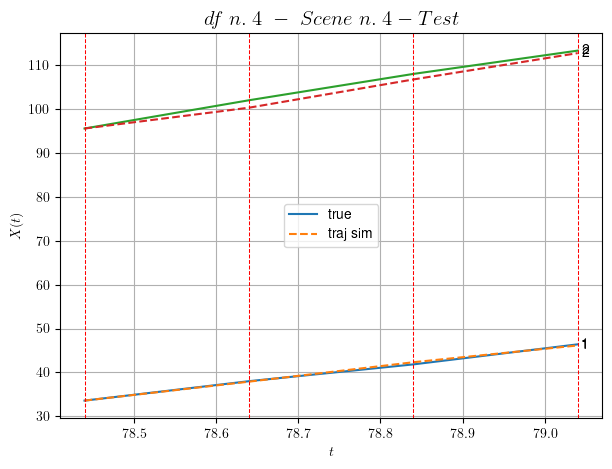

        For scene 4/63:
        * MSE = 0.6371948720042576
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/63


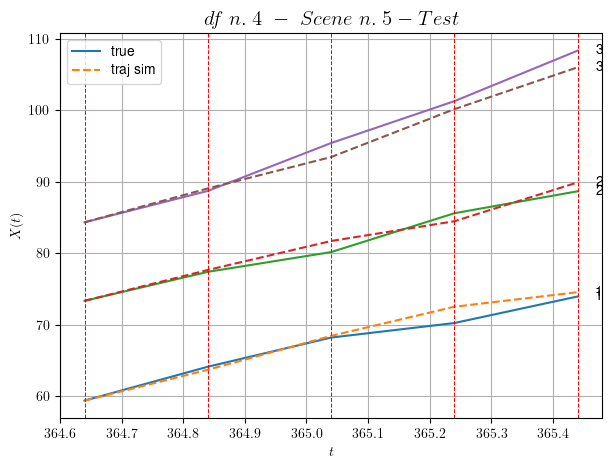

        For scene 5/63:
        * MSE = 1.4454856642877223
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/63


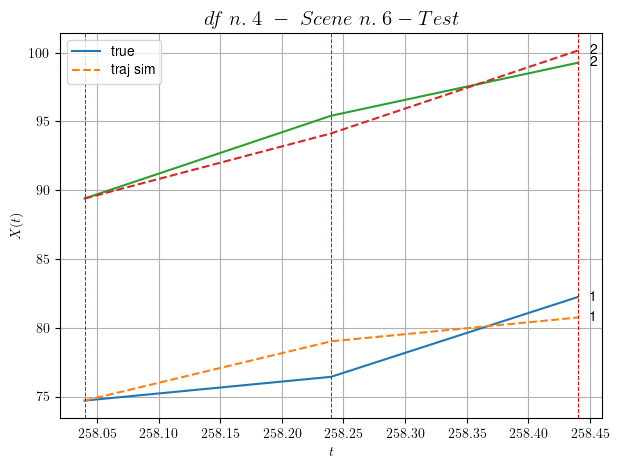

        For scene 6/63:
        * MSE = 1.8861089977567649
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/63


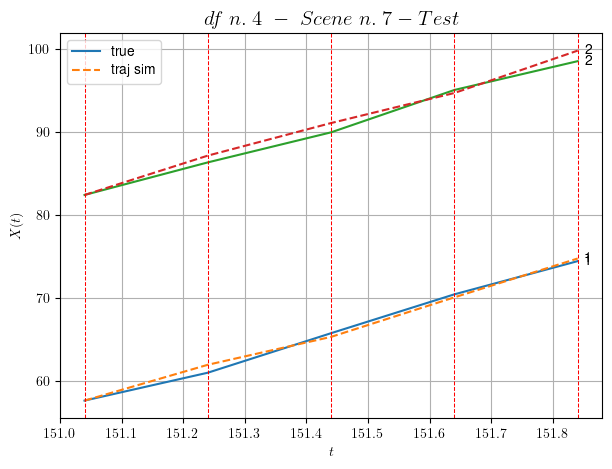

        For scene 7/63:
        * MSE = 0.4997279227723407
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/63


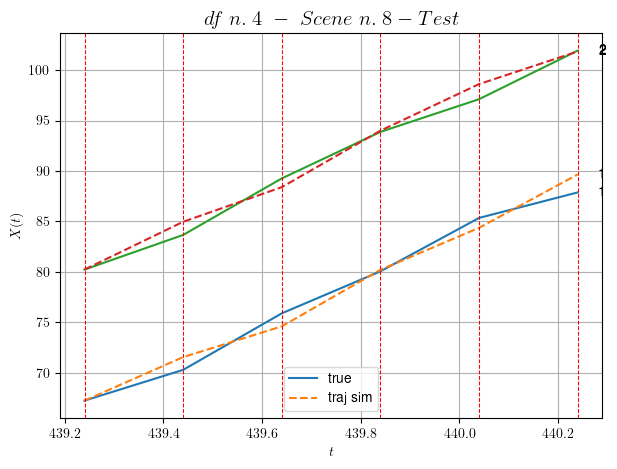

        For scene 8/63:
        * MSE = 1.0106577741633067
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/63


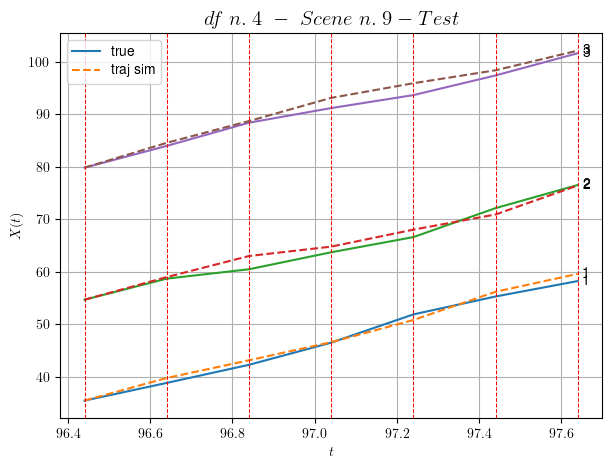

        For scene 9/63:
        * MSE = 1.2935656426423836
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/63


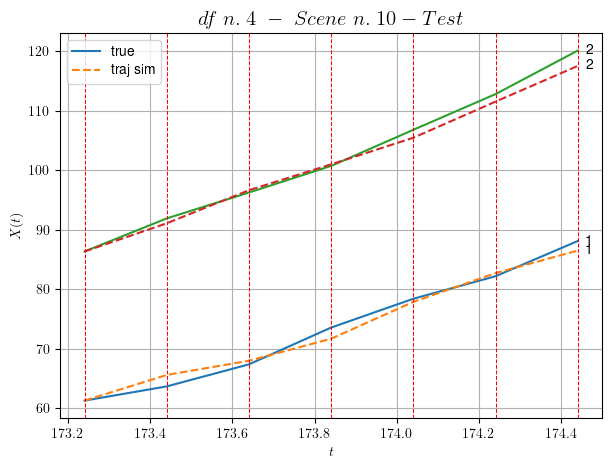

        For scene 10/63:
        * MSE = 1.5446268901955638
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/63


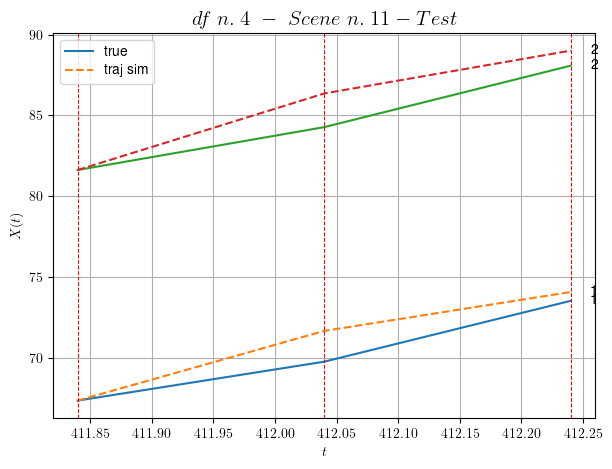

        For scene 11/63:
        * MSE = 1.5214167839491375
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/63


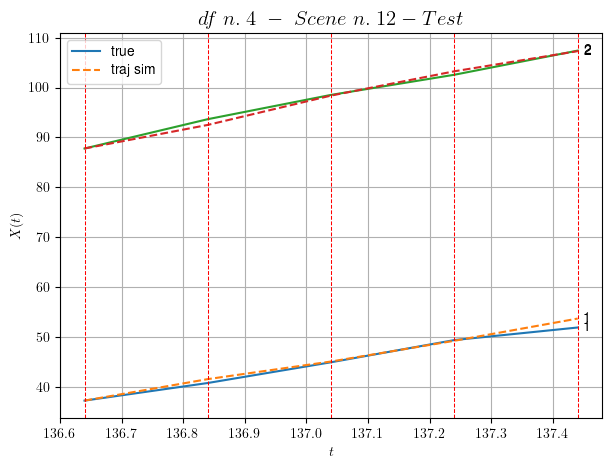

        For scene 12/63:
        * MSE = 0.5691014556447167
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/63


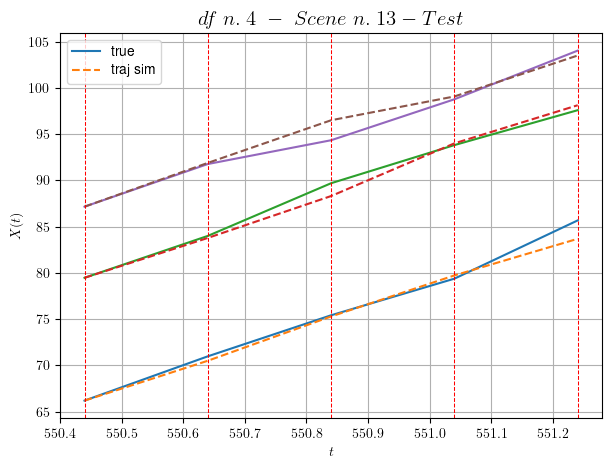

        For scene 13/63:
        * MSE = 0.7787303406169599
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/63


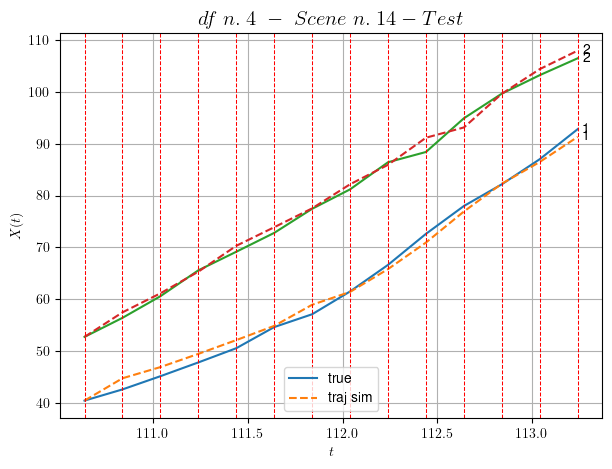

        For scene 14/63:
        * MSE = 1.5343533167326284
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/63


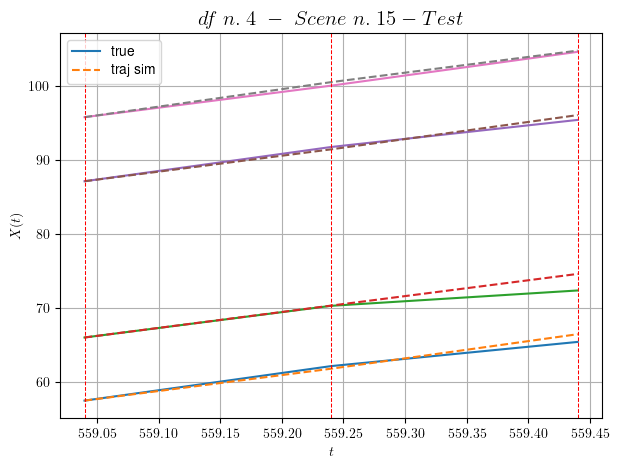

        For scene 15/63:
        * MSE = 0.5825364403405356
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/63


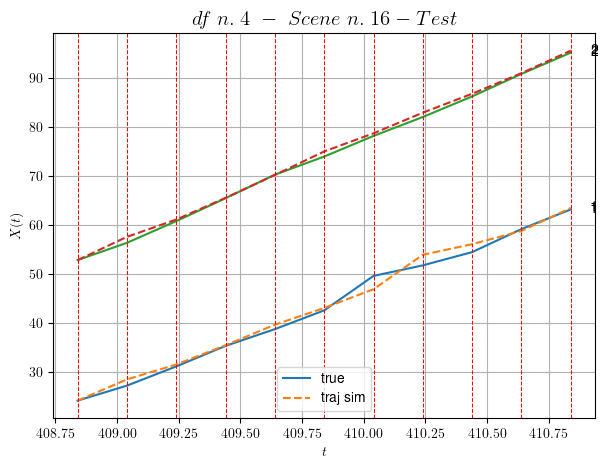

        For scene 16/63:
        * MSE = 0.9939569793403061
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/63


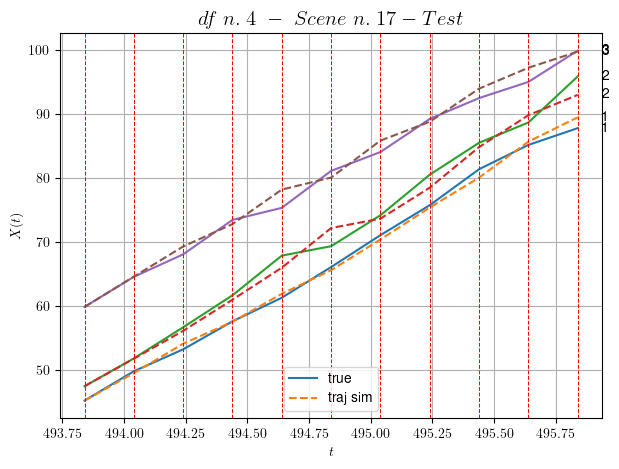

        For scene 17/63:
        * MSE = 1.679810119900919
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/63


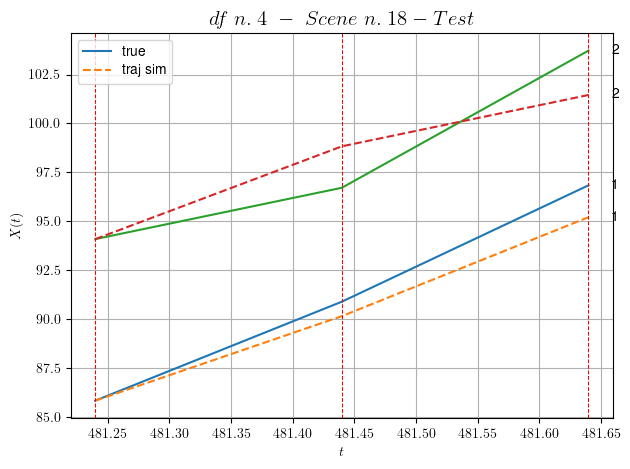

        For scene 18/63:
        * MSE = 2.1335599282198854
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/63


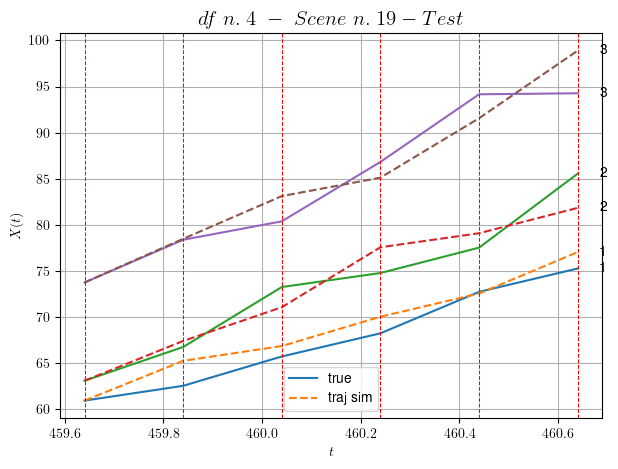

        For scene 19/63:
        * MSE = 4.599373187135899
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/63


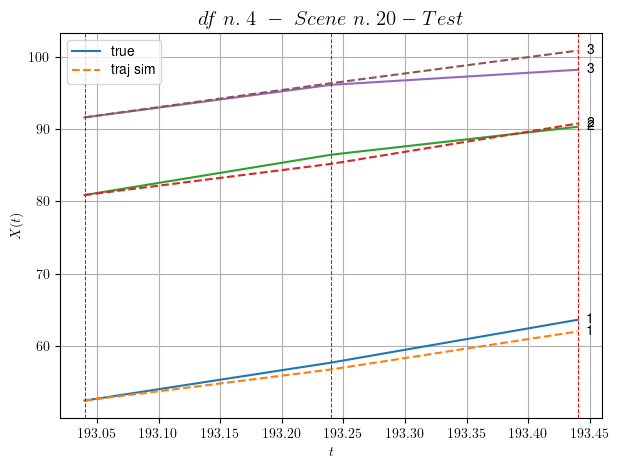

        For scene 20/63:
        * MSE = 1.3759613684129353
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/63


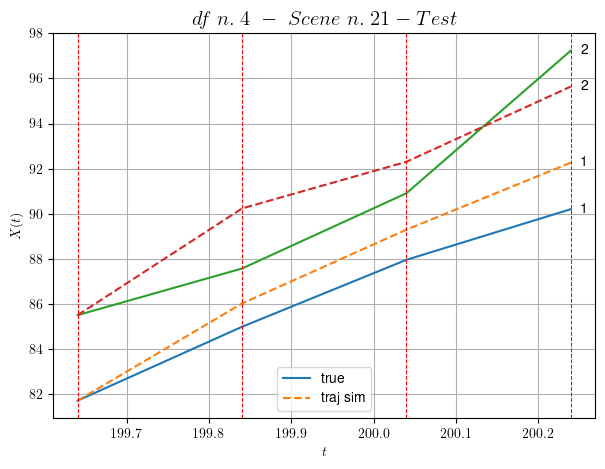

        For scene 21/63:
        * MSE = 2.3399558578247674
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/63


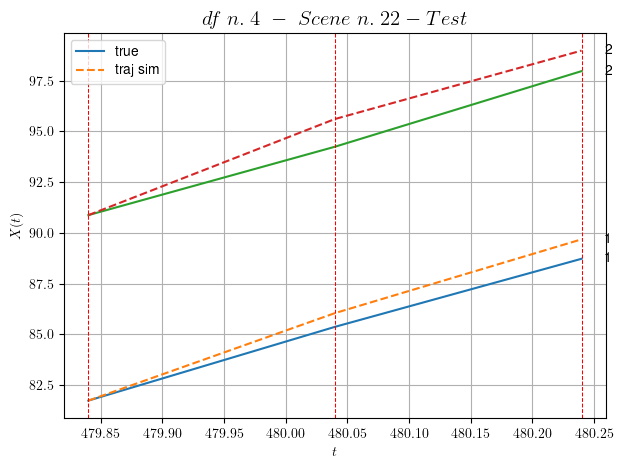

        For scene 22/63:
        * MSE = 0.7101754739686603
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/63


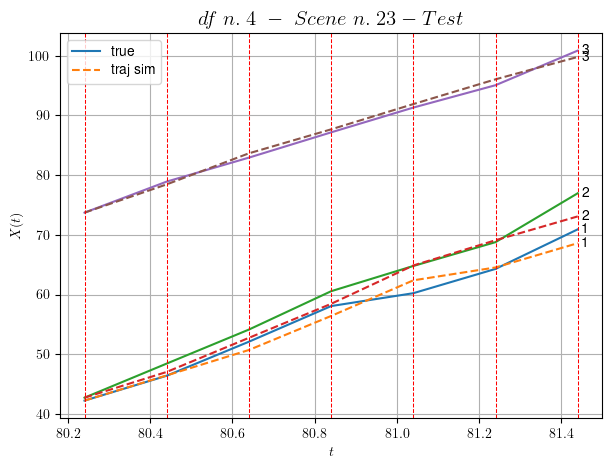

        For scene 23/63:
        * MSE = 1.9829371164633727
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.24/63


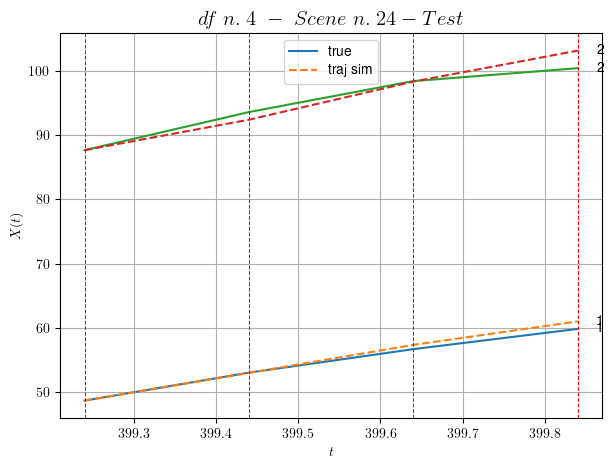

        For scene 24/63:
        * MSE = 1.3365070586325378
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.25/63


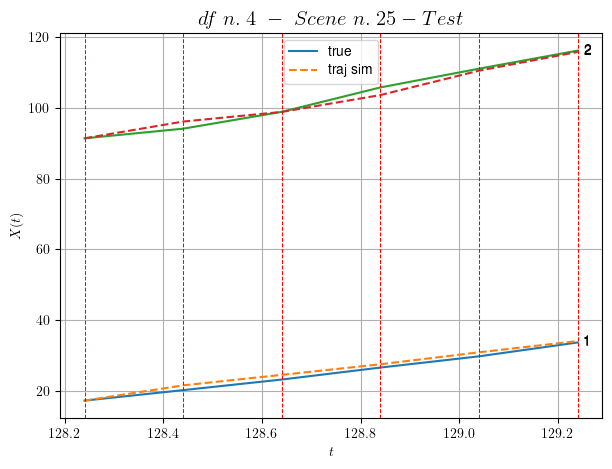

        For scene 25/63:
        * MSE = 1.2535154187412862
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.26/63


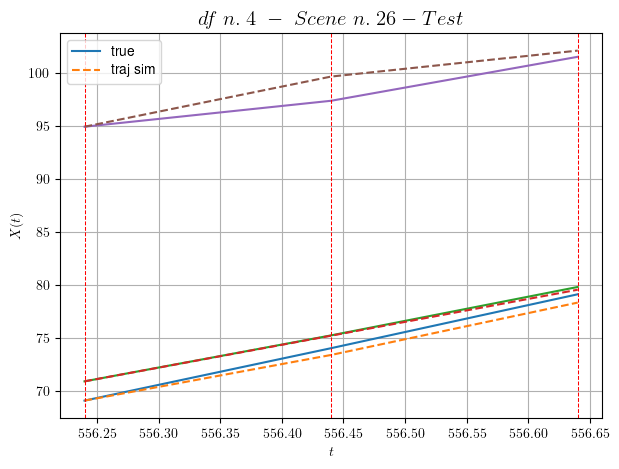

        For scene 26/63:
        * MSE = 0.7396838907973321
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.27/63


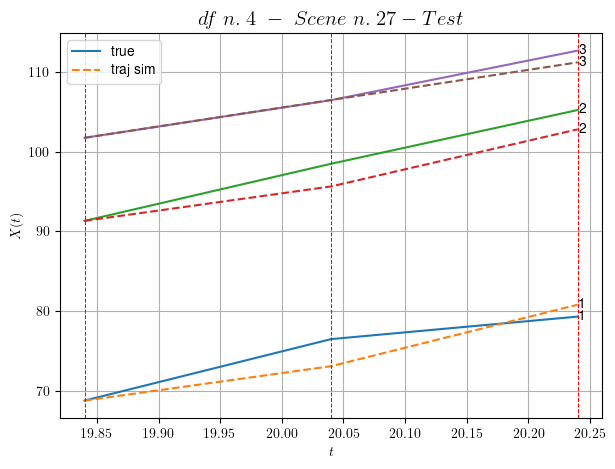

        For scene 27/63:
        * MSE = 3.3088080386154566
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.28/63


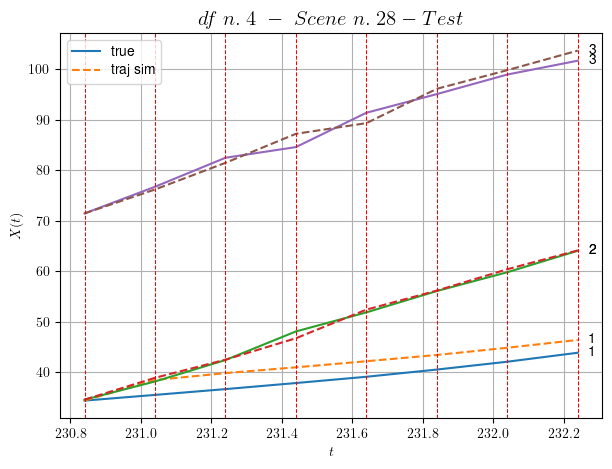

        For scene 28/63:
        * MSE = 3.3906560487536557
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.29/63


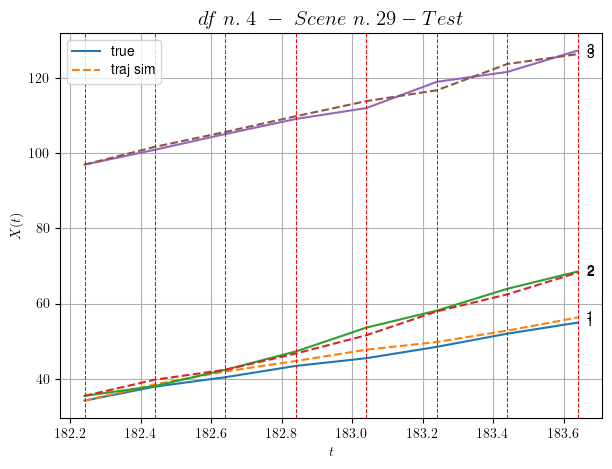

        For scene 29/63:
        * MSE = 1.6013811956627697
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.30/63


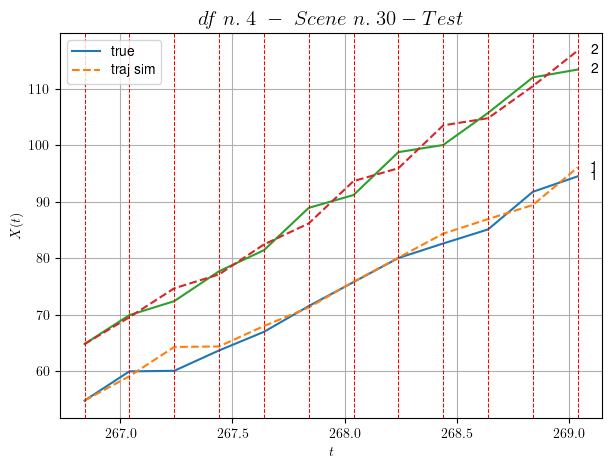

        For scene 30/63:
        * MSE = 3.7232614570131553
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.31/63


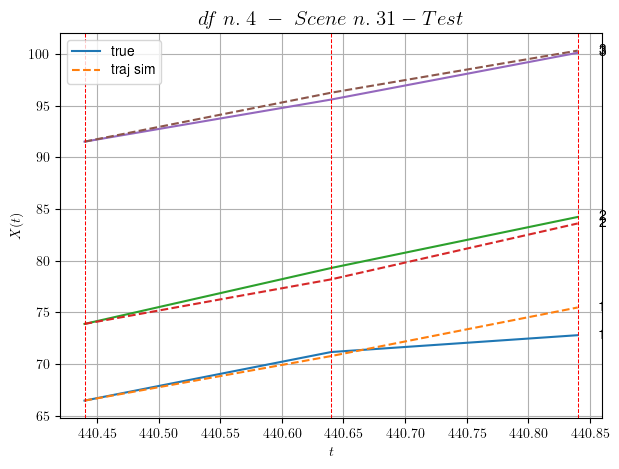

        For scene 31/63:
        * MSE = 1.0472930362199344
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.32/63


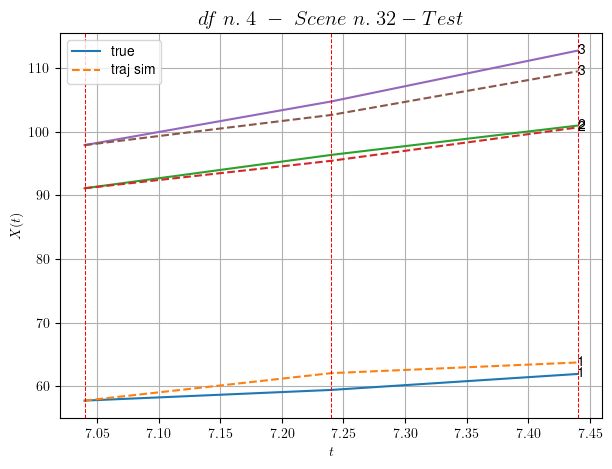

        For scene 32/63:
        * MSE = 2.910574426098478
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.33/63


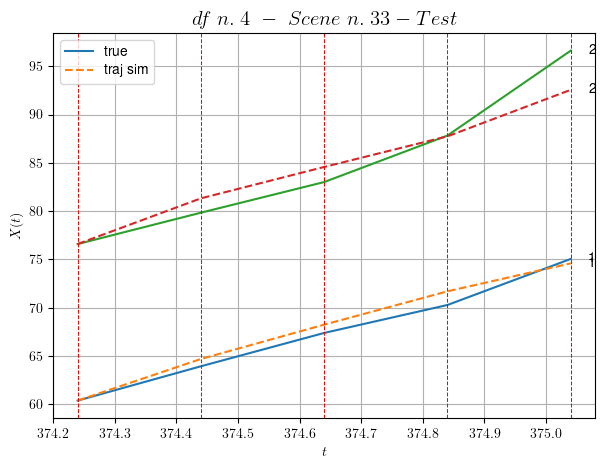

        For scene 33/63:
        * MSE = 2.4674190290370994
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.34/63


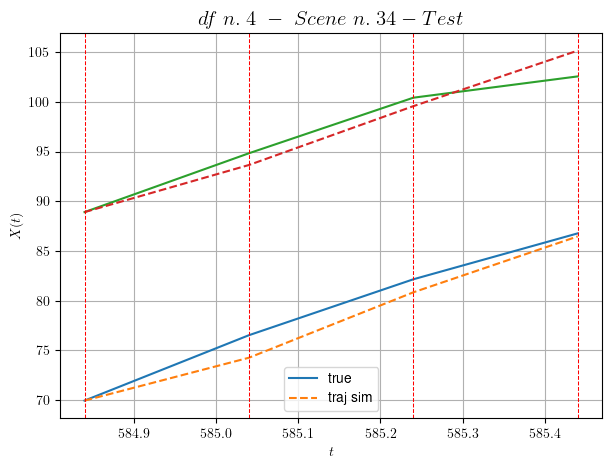

        For scene 34/63:
        * MSE = 1.973464932060934
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.35/63


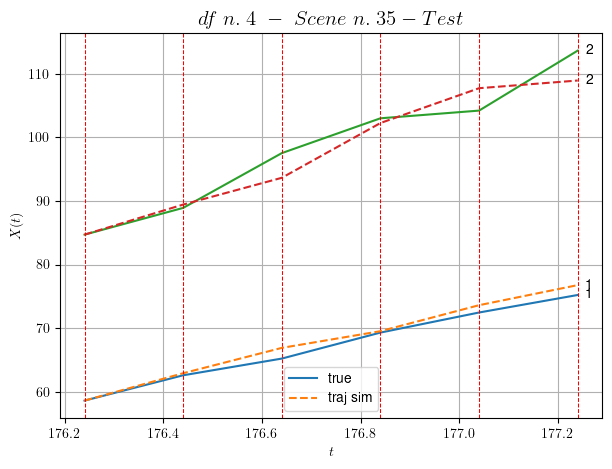

        For scene 35/63:
        * MSE = 4.769272753978019
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.36/63


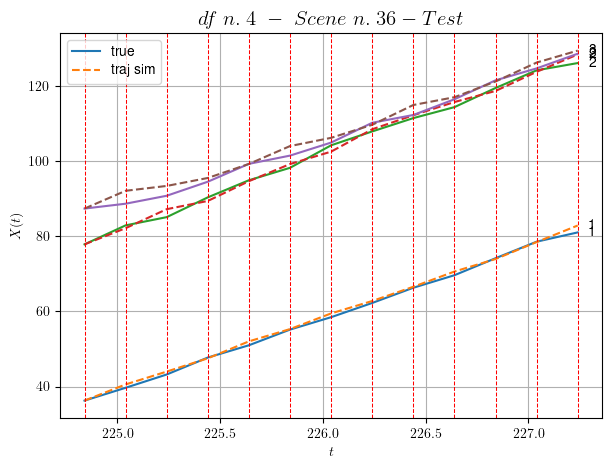

        For scene 36/63:
        * MSE = 1.6807956202468806
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.37/63


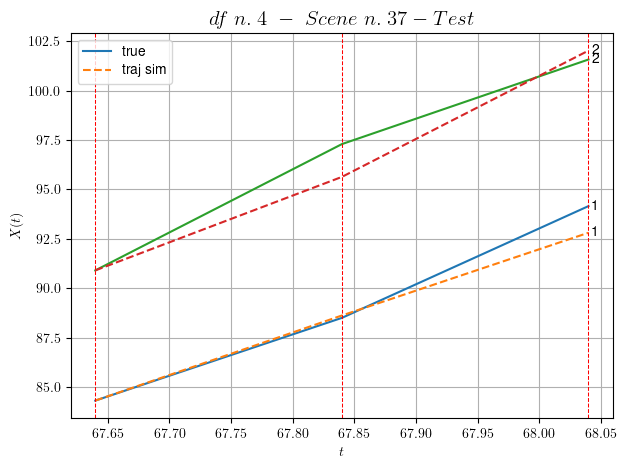

        For scene 37/63:
        * MSE = 0.7997143532330444
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.38/63


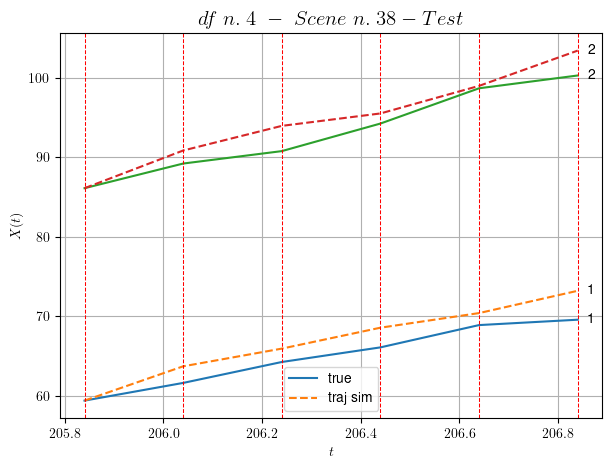

        For scene 38/63:
        * MSE = 4.4197301527046475
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.39/63


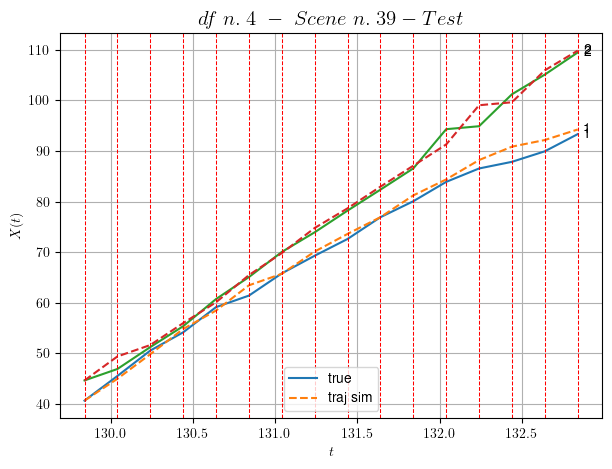

        For scene 39/63:
        * MSE = 2.0355984791924655
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.40/63


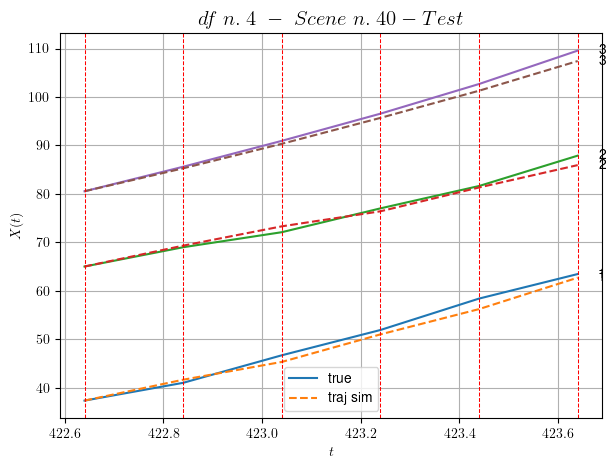

        For scene 40/63:
        * MSE = 1.2226539186221768
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.41/63


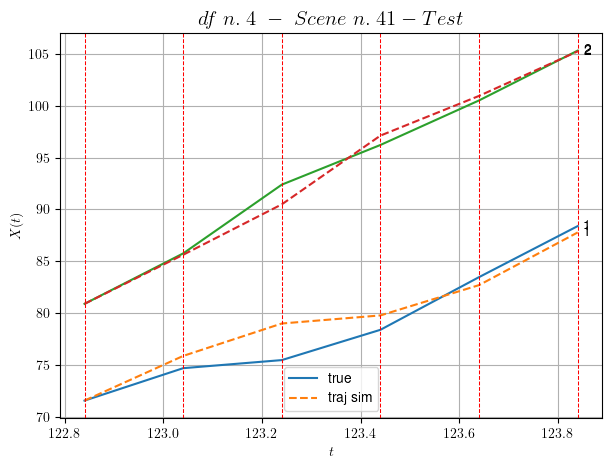

        For scene 41/63:
        * MSE = 1.7844859601682797
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.42/63


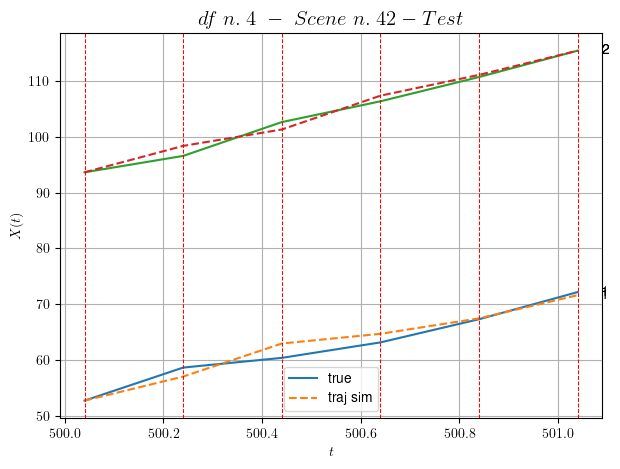

        For scene 42/63:
        * MSE = 1.5042200417444582
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.43/63


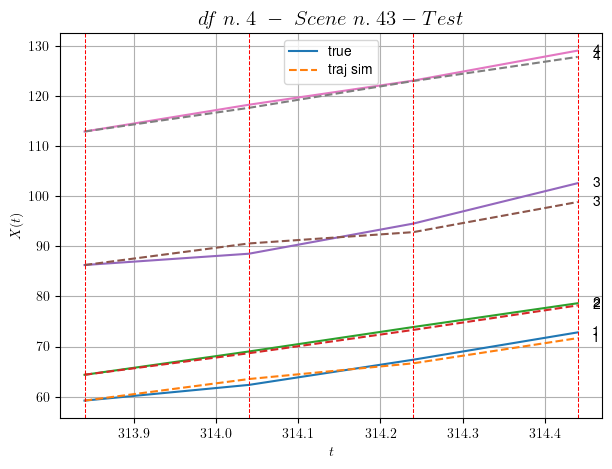

        For scene 43/63:
        * MSE = 1.6925255408106858
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.44/63


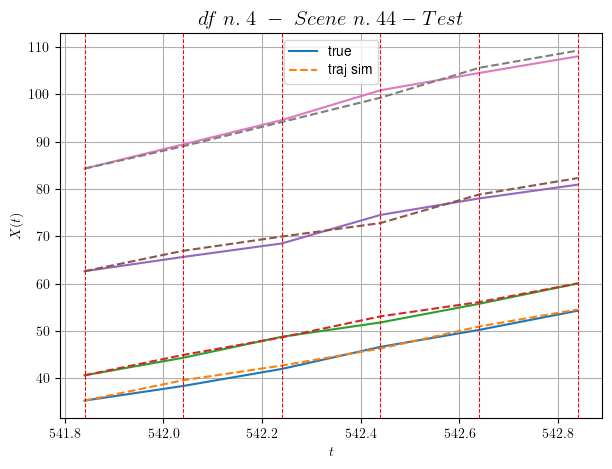

        For scene 44/63:
        * MSE = 0.8217222859231518
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.45/63


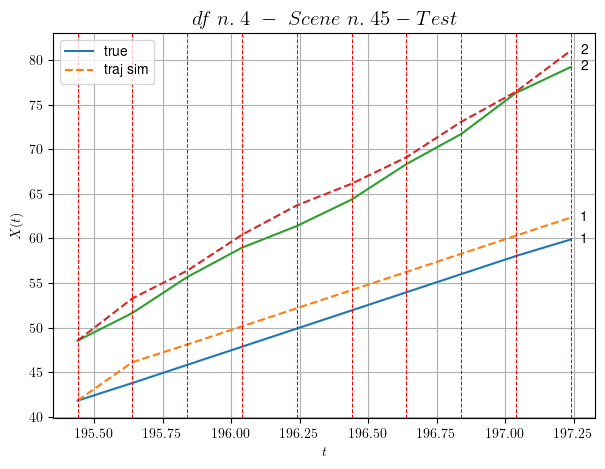

        For scene 45/63:
        * MSE = 3.371721965299296
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.46/63


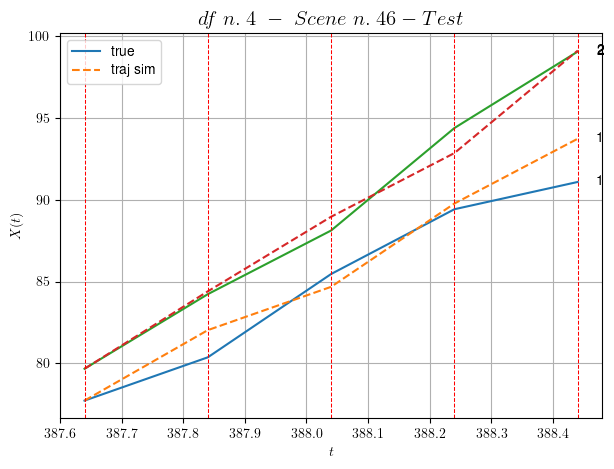

        For scene 46/63:
        * MSE = 1.3573955214276436
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.47/63


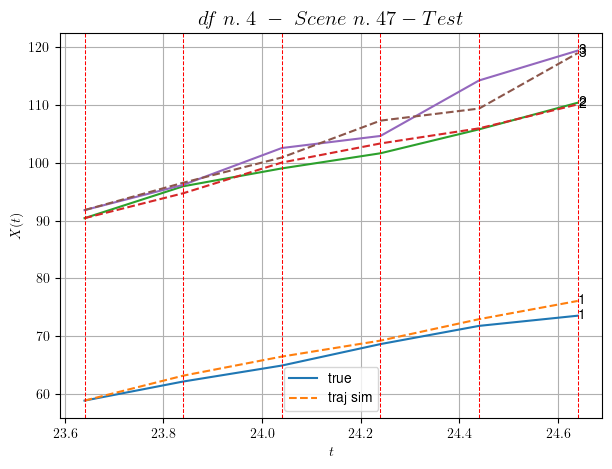

        For scene 47/63:
        * MSE = 2.8186729669789883
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.48/63


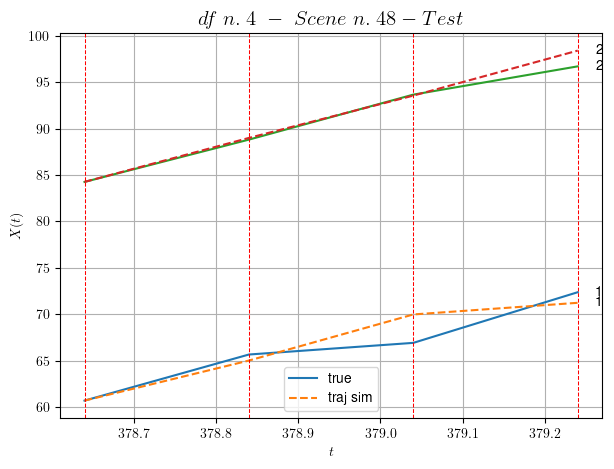

        For scene 48/63:
        * MSE = 1.748185399006408
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.49/63


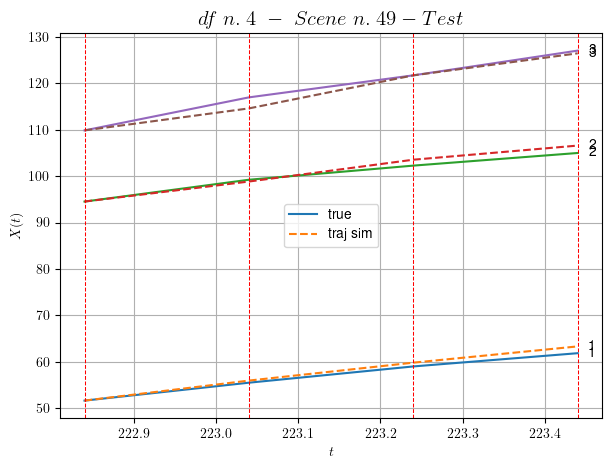

        For scene 49/63:
        * MSE = 1.1061833457687014
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.50/63


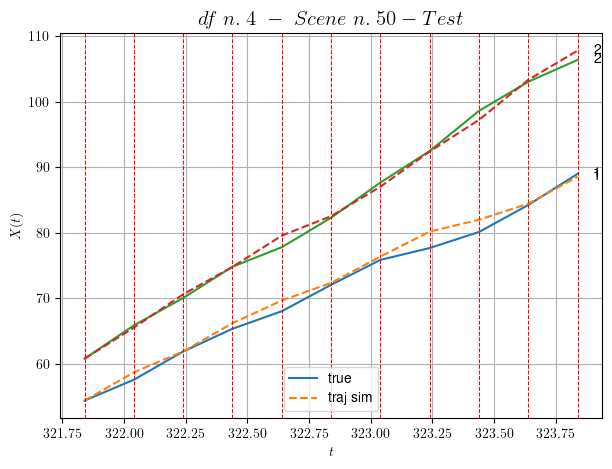

        For scene 50/63:
        * MSE = 1.0446521341151902
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.51/63


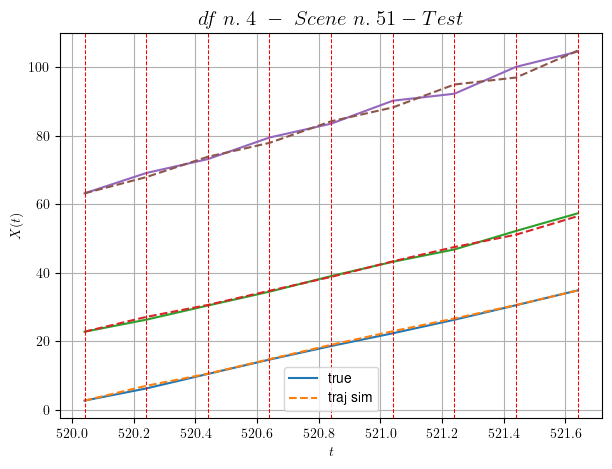

        For scene 51/63:
        * MSE = 1.1174265721522827
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.52/63


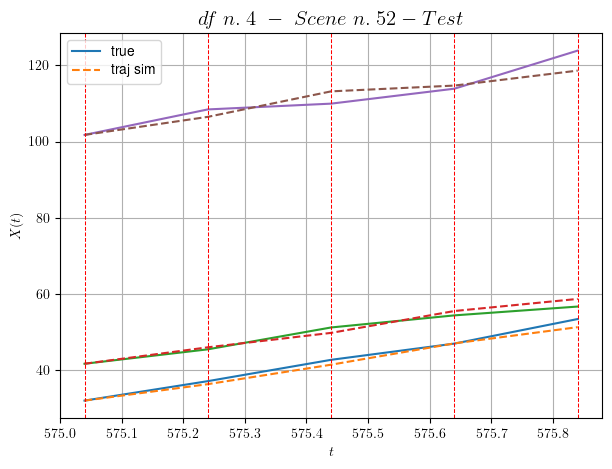

        For scene 52/63:
        * MSE = 3.780080892733085
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.53/63


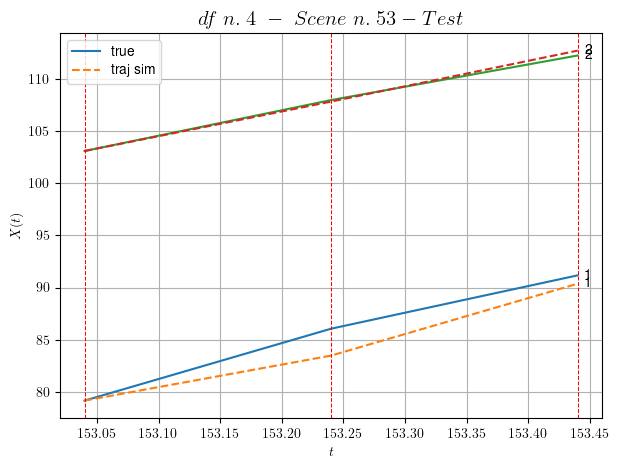

        For scene 53/63:
        * MSE = 1.2514301588809214
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.54/63


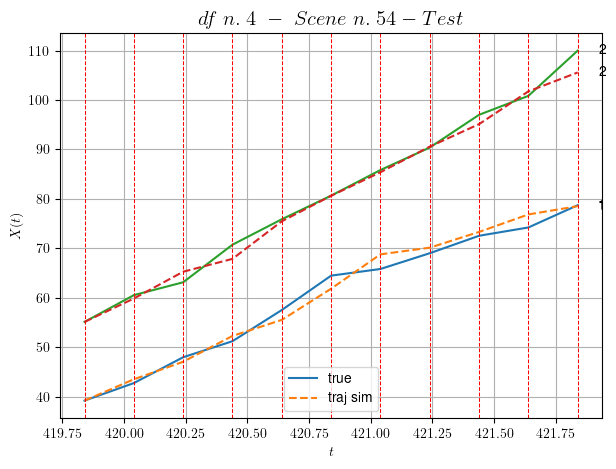

        For scene 54/63:
        * MSE = 3.120967419345636
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.55/63


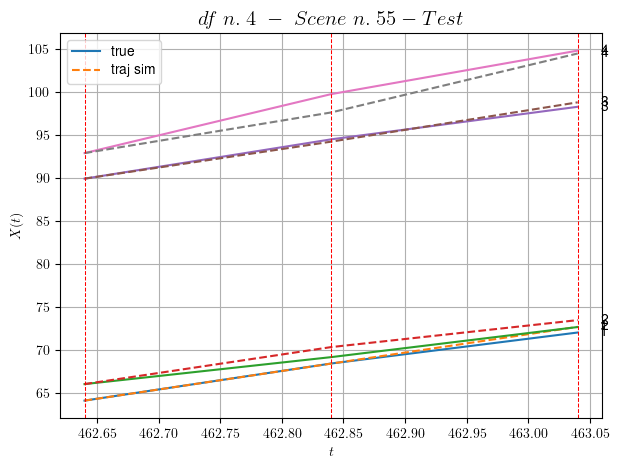

        For scene 55/63:
        * MSE = 0.6221819186708186
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.56/63


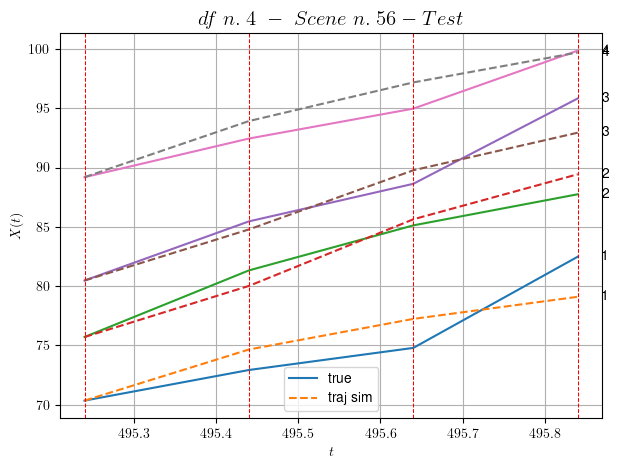

        For scene 56/63:
        * MSE = 2.6525754786137465
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.57/63


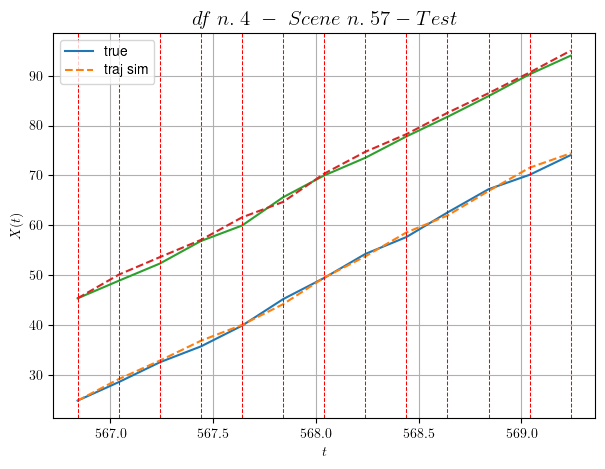

        For scene 57/63:
        * MSE = 0.6615120088742683
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.58/63


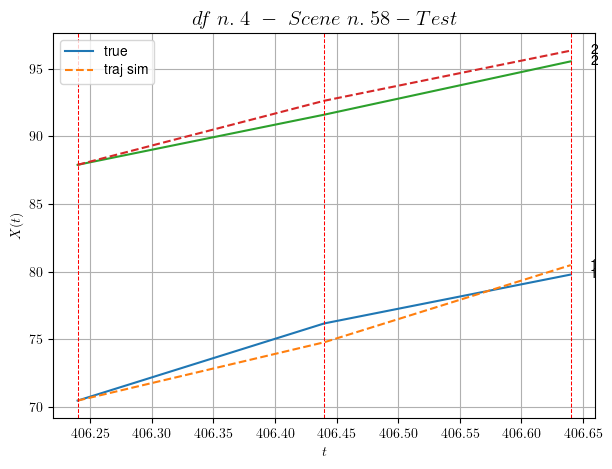

        For scene 58/63:
        * MSE = 0.6857042754006629
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.59/63


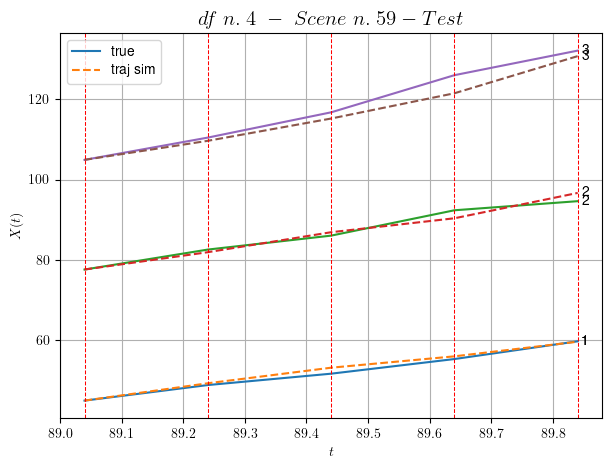

        For scene 59/63:
        * MSE = 2.4864974245075318
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.60/63


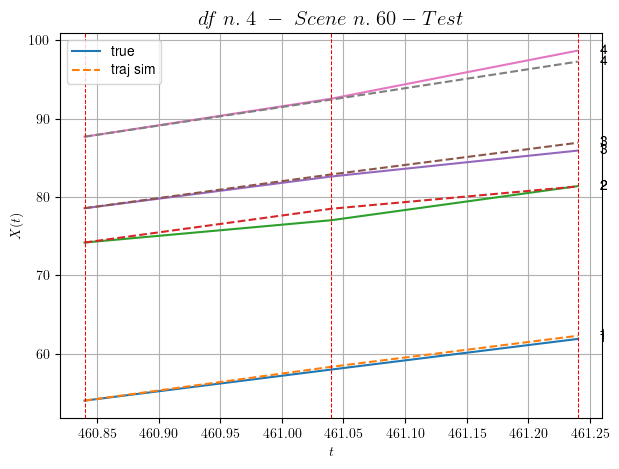

        For scene 60/63:
        * MSE = 0.4578574629791753
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.61/63


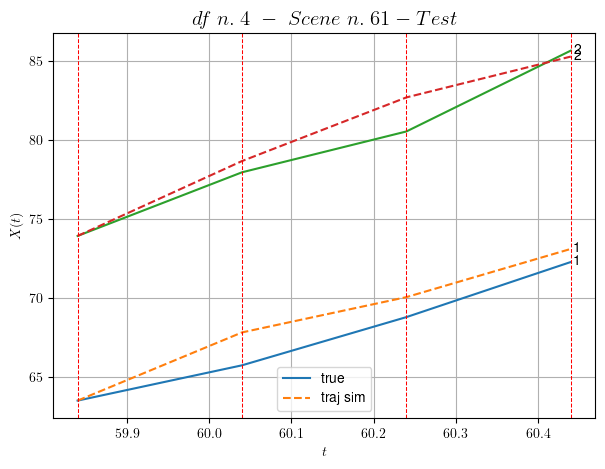

        For scene 61/63:
        * MSE = 1.4863790844837963
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.62/63


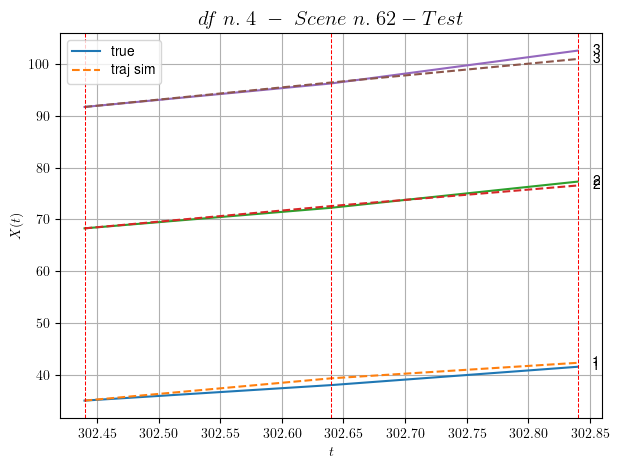

        For scene 62/63:
        * MSE = 0.6256654767968683
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.63/63


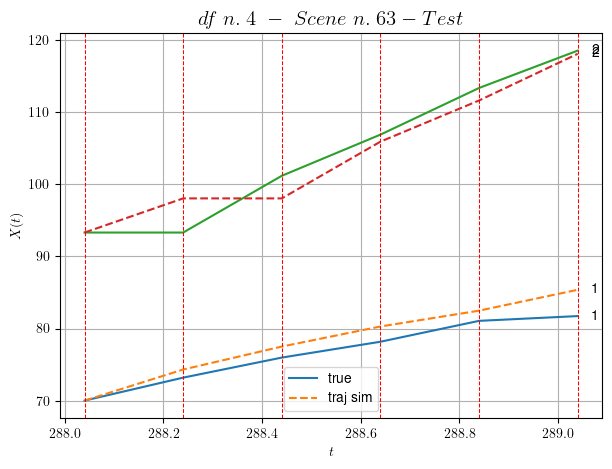

        For scene 63/63:
        * MSE = 4.984951052310637
----------------------------------------------------------------------------------------------------


MSE test: 1.8378103405867043

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.9816639986733888
          * MSE test: 1.8378103405867043
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 5/10 dfs.
In DataFrame n.5 we have 66 scenes.
    To train the model we use 6 scenes, the remaining 60 to test the model.

Training step. (6 scenes)
DataFrame n.5. Scene n.1/6
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [226.72,227.92]


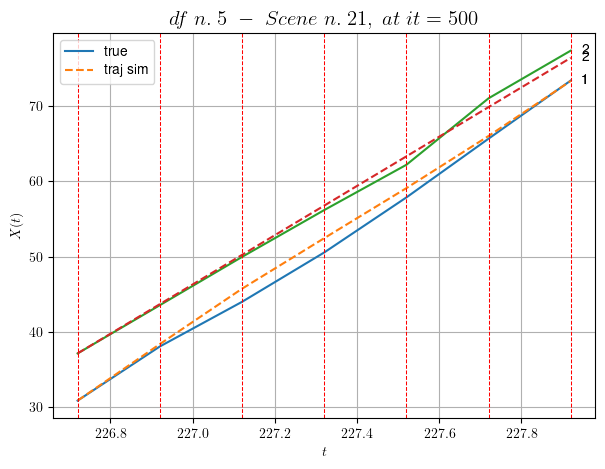

----------------------------------------------------------------------------------------------------
        For scene 1/6:
        * After LR finder: LR_NN=0.01 with mse=2.7226597634610927 at it=24
        * v0 = 32.69366457961318
        * MSE = 0.5224923810473054
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/6
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [330.12,330.52]


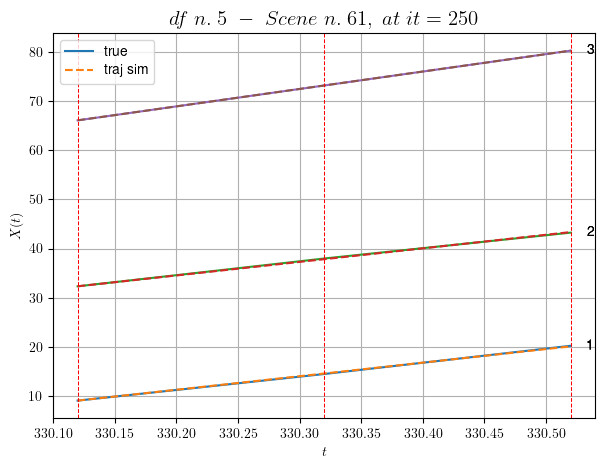

----------------------------------------------------------------------------------------------------
        For scene 2/6:
        * After LR finder: LR_NN=0.005 with mse=0.6736218031990453 at it=24
        * v0 = 35.47750160163307
        * MSE = 0.0065952627605482565
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [78.72,79.32]


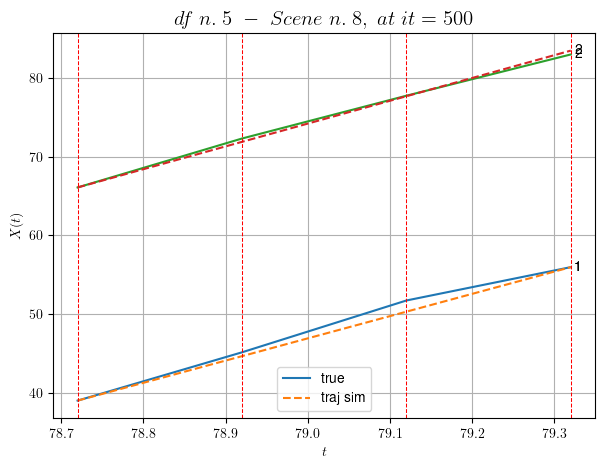

----------------------------------------------------------------------------------------------------
        For scene 3/6:
        * After LR finder: LR_NN=0.0001 with mse=0.6147807198073958 at it=24
        * v0 = 28.965407295611197
        * MSE = 0.3342236609444014
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/6
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [449.12,450.12]


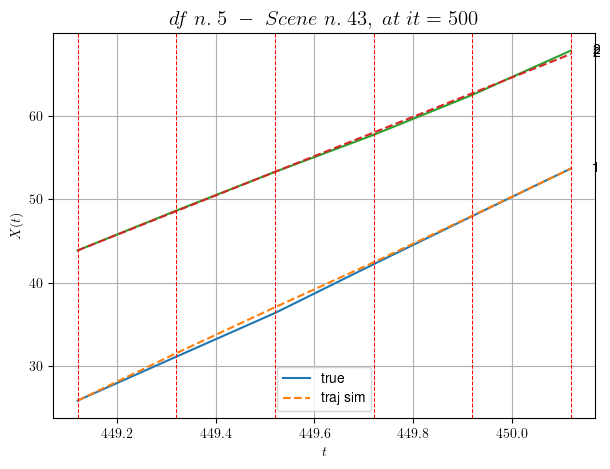

----------------------------------------------------------------------------------------------------
        For scene 4/6:
        * After LR finder: LR_NN=0.01 with mse=7.630762314131638 at it=24
        * v0 = 23.5276042757319
        * MSE = 0.060903460642494425
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [149.92,150.72]


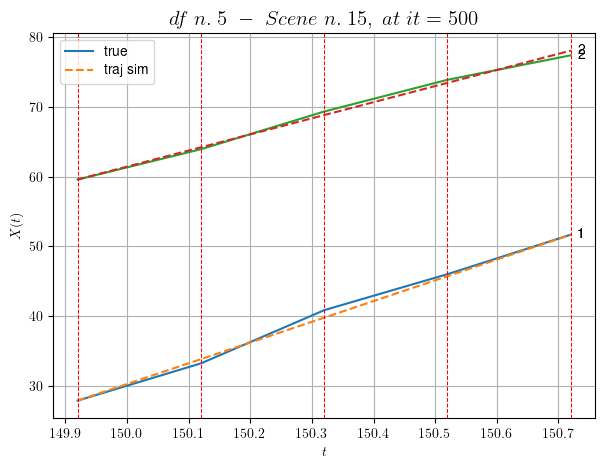

----------------------------------------------------------------------------------------------------
        For scene 5/6:
        * After LR finder: LR_NN=5e-05 with mse=6.140236532665061 at it=24
        * v0 = 23.102993584361492
        * MSE = 0.25898965741465874
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [535.32,535.92]


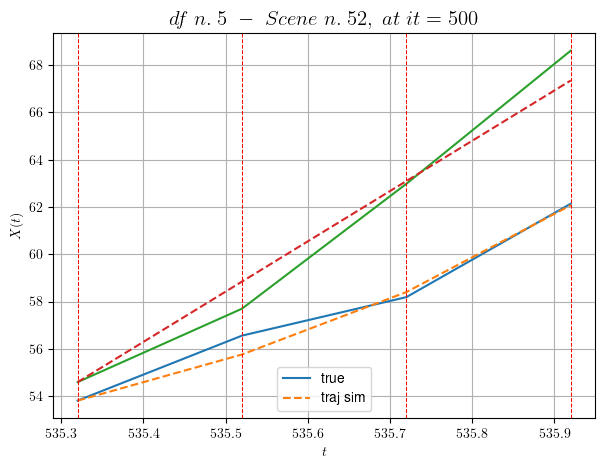

----------------------------------------------------------------------------------------------------
        For scene 6/6:
        * After LR finder: LR_NN=0.005 with mse=5.197536129672164 at it=24
        * v0 = 21.278077520483933
        * MSE = 0.449541752975108
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.27212436263075274
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (60 scenes)
DataFrame n.5. Scene n.1/60


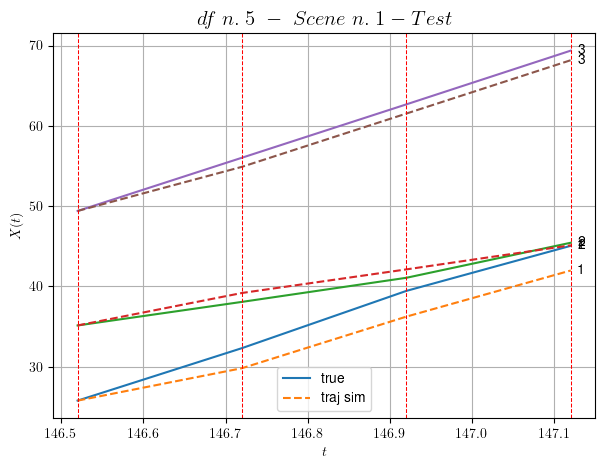

        For scene 1/60:
        * MSE = 2.7043064977710234
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/60


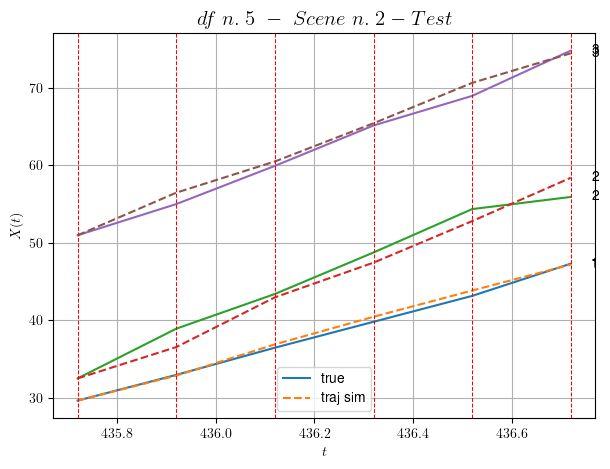

        For scene 2/60:
        * MSE = 1.2622204095473533
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/60


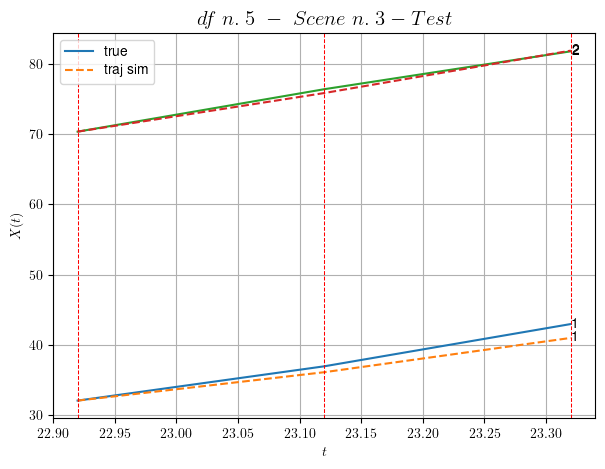

        For scene 3/60:
        * MSE = 0.8209835496107457
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/60


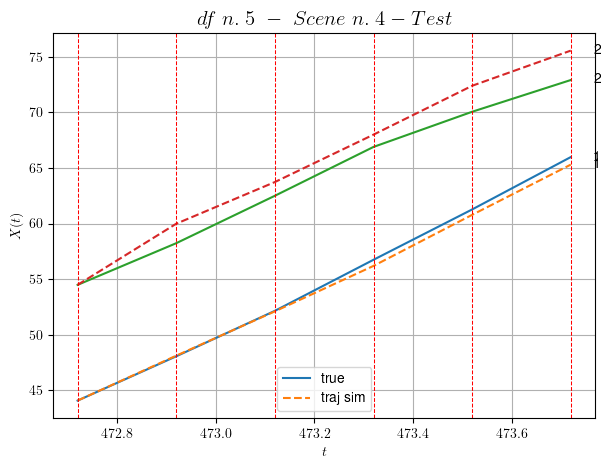

        For scene 4/60:
        * MSE = 1.6076004228331964
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/60


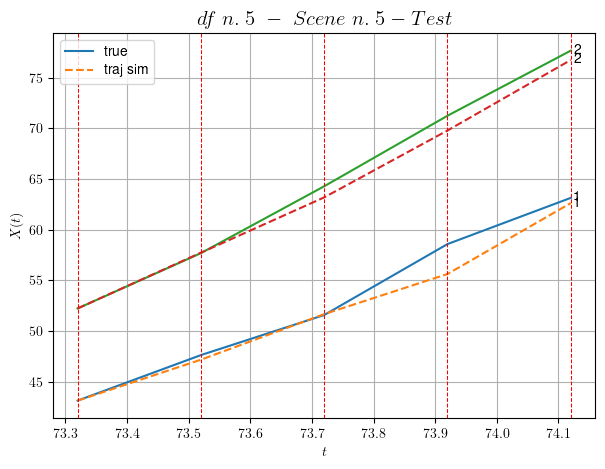

        For scene 5/60:
        * MSE = 1.3382734267254772
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/60


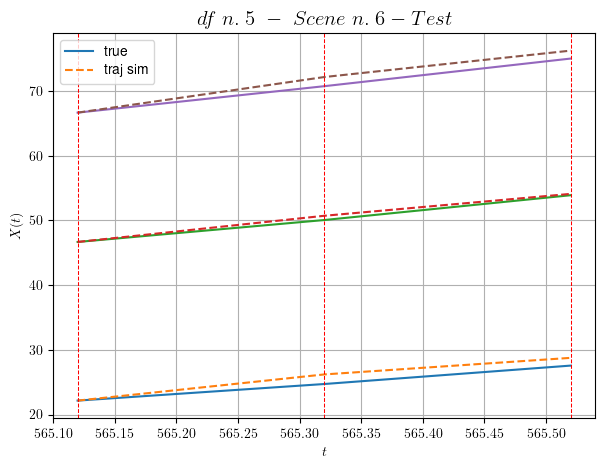

        For scene 6/60:
        * MSE = 0.8452346056650839
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/60


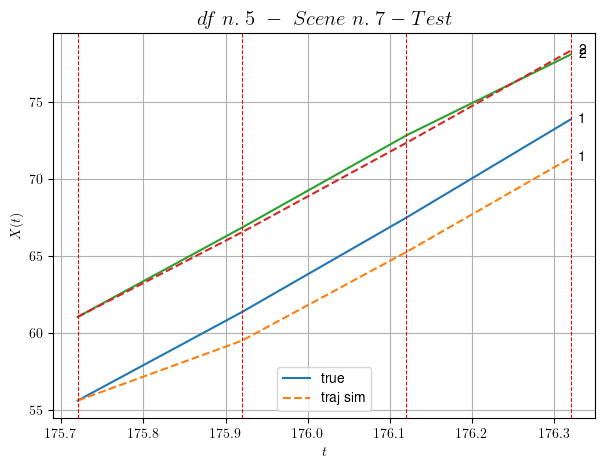

        For scene 7/60:
        * MSE = 1.8836493473995237
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/60


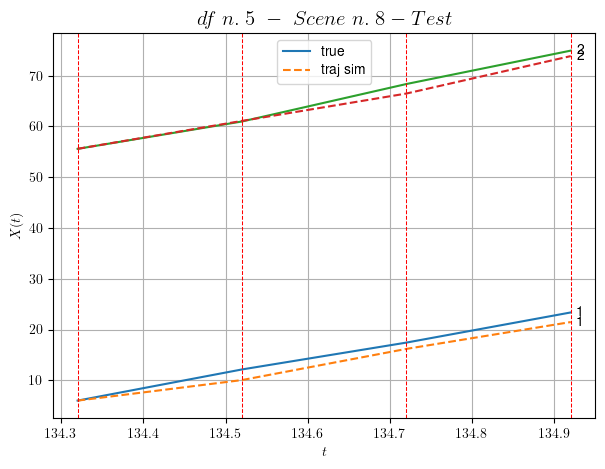

        For scene 8/60:
        * MSE = 1.7704796115841652
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/60


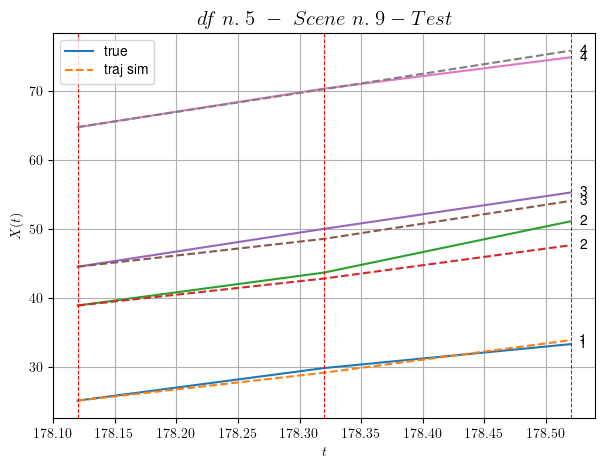

        For scene 9/60:
        * MSE = 1.5084013956330389
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/60


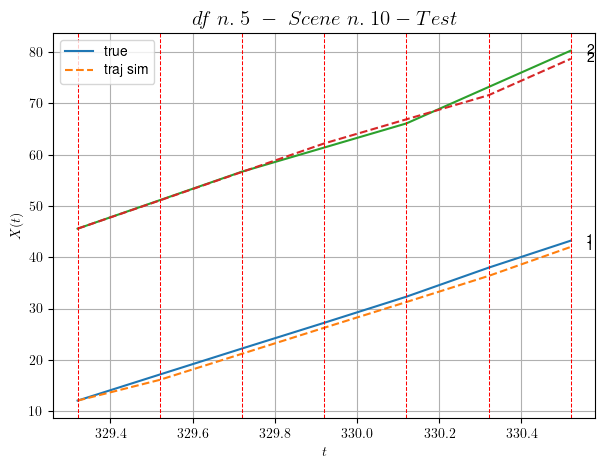

        For scene 10/60:
        * MSE = 1.0415711846320435
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/60


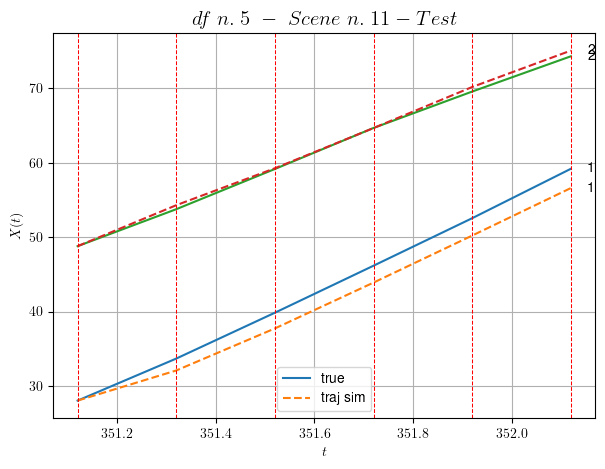

        For scene 11/60:
        * MSE = 2.130182010922765
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/60


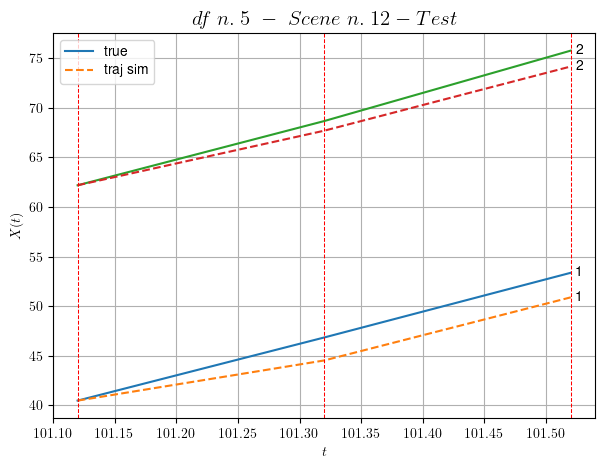

        For scene 12/60:
        * MSE = 2.4978733740119963
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/60


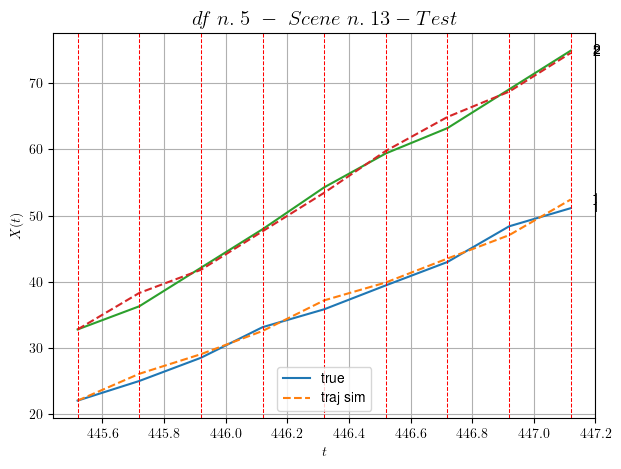

        For scene 13/60:
        * MSE = 0.8711328036498966
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/60


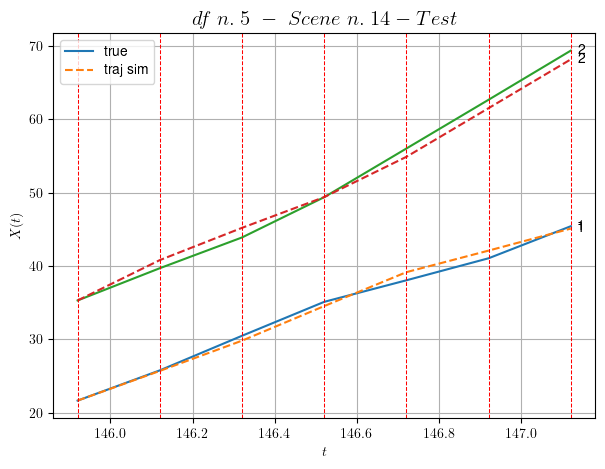

        For scene 14/60:
        * MSE = 0.7263738029323066
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/60


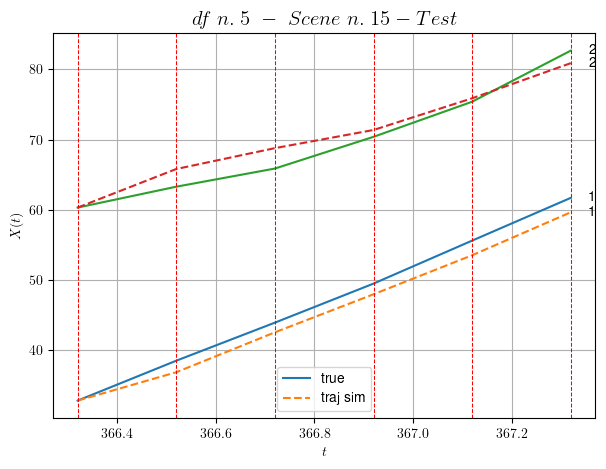

        For scene 15/60:
        * MSE = 2.8961819905008195
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/60


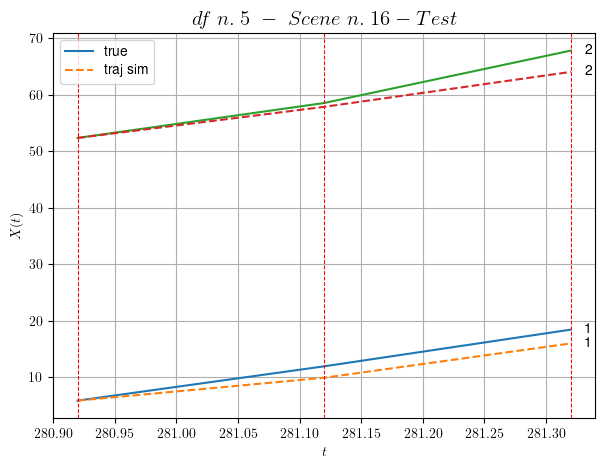

        For scene 16/60:
        * MSE = 4.112699903218697
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/60


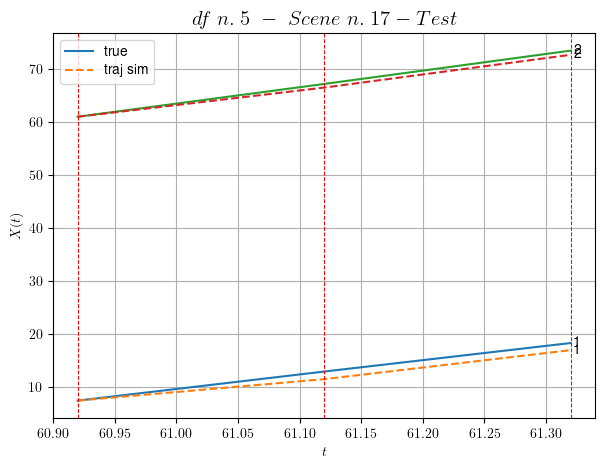

        For scene 17/60:
        * MSE = 0.8228377621513586
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/60


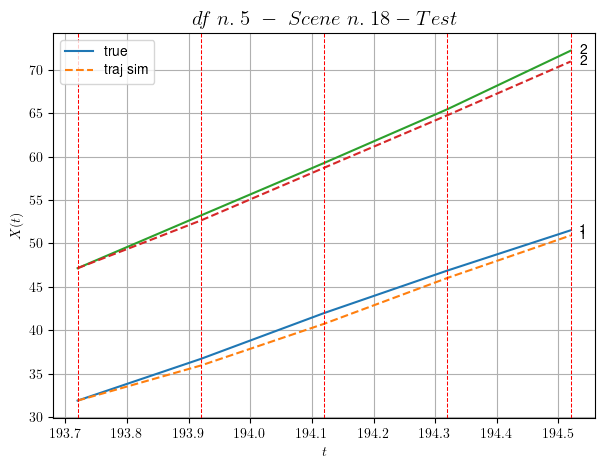

        For scene 18/60:
        * MSE = 0.5874306134151215
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/60


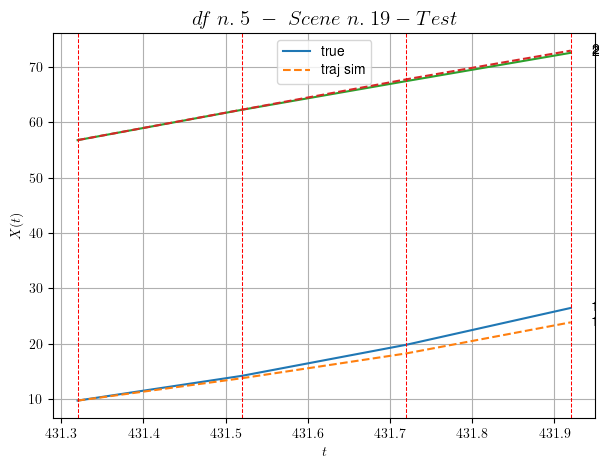

        For scene 19/60:
        * MSE = 1.2044797325464671
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/60


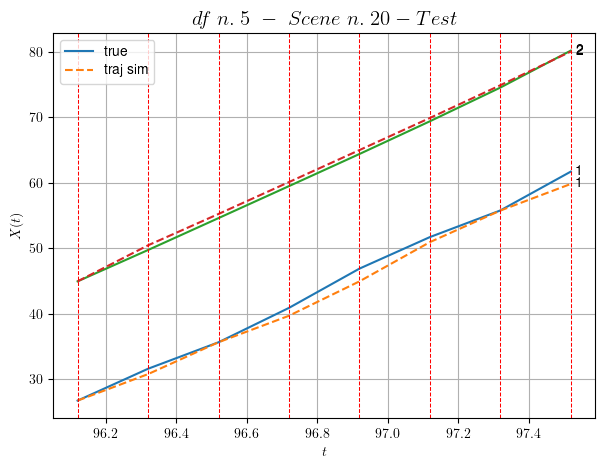

        For scene 20/60:
        * MSE = 0.7557829805476852
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/60


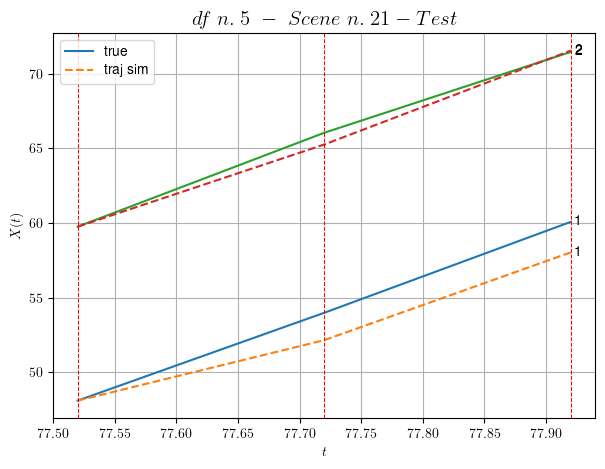

        For scene 21/60:
        * MSE = 1.3589947917833491
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/60


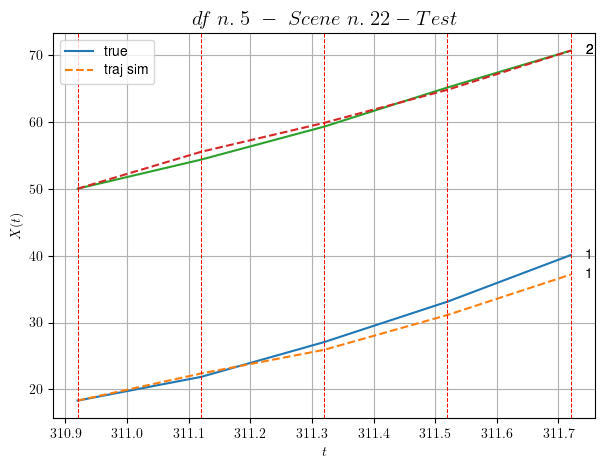

        For scene 22/60:
        * MSE = 1.5850652536846983
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.23/60


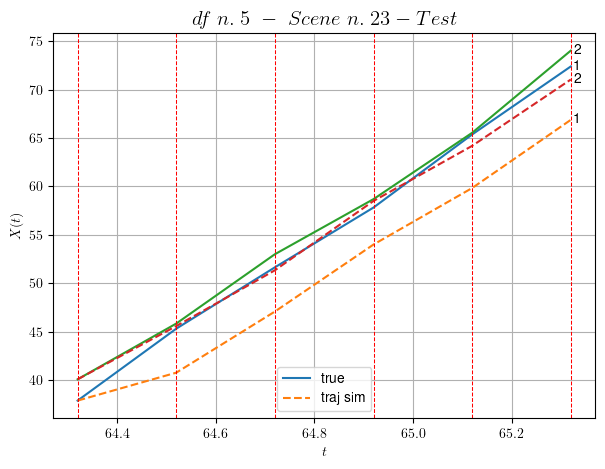

        For scene 23/60:
        * MSE = 10.88996014770825
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.24/60


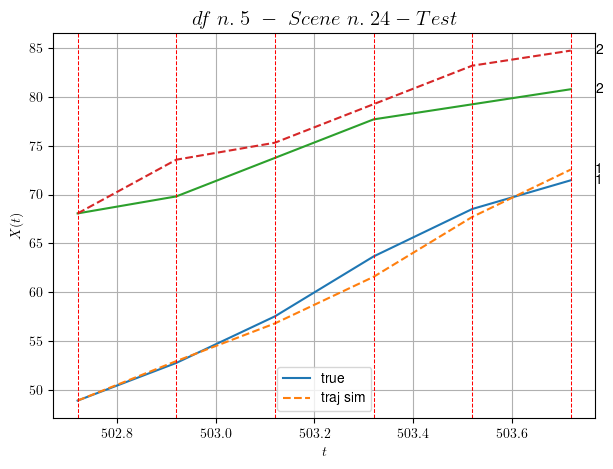

        For scene 24/60:
        * MSE = 4.7568982142003655
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.25/60


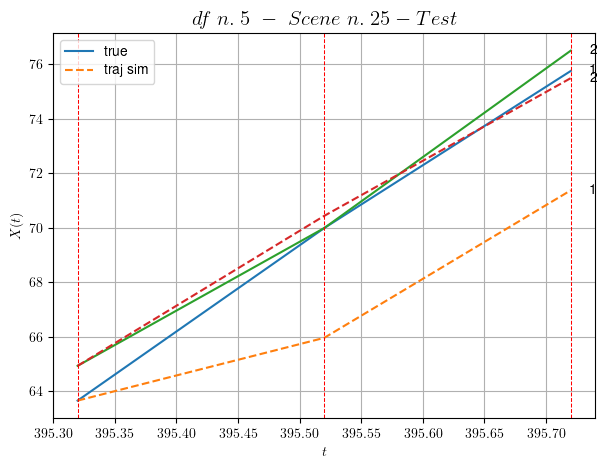

        For scene 25/60:
        * MSE = 6.103215019523727
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.26/60


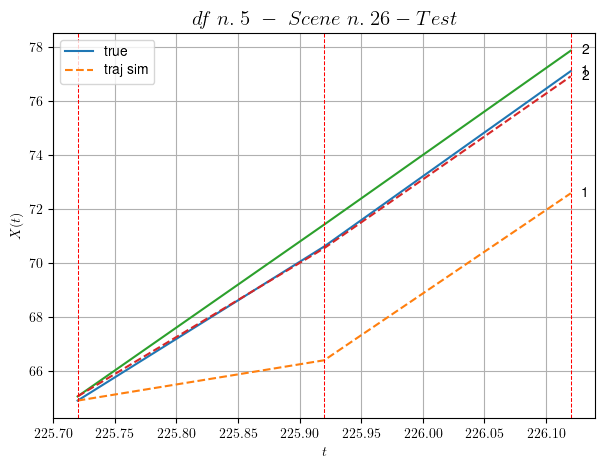

        For scene 26/60:
        * MSE = 6.680352255127227
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.27/60


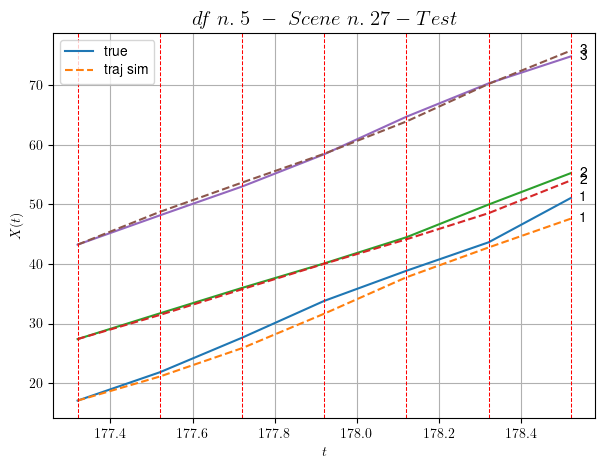

        For scene 27/60:
        * MSE = 1.3528145512444771
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.28/60


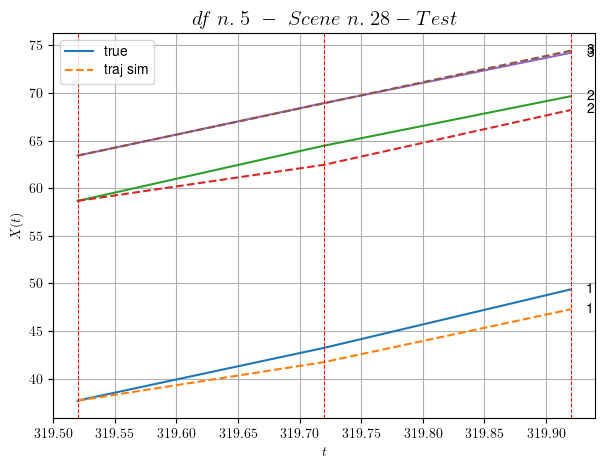

        For scene 28/60:
        * MSE = 1.4221328214033049
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.29/60


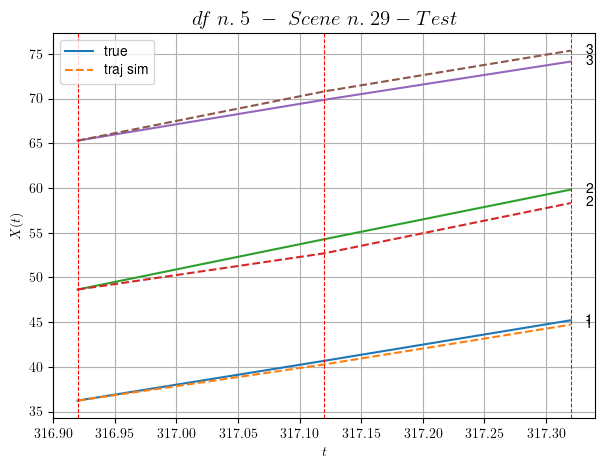

        For scene 29/60:
        * MSE = 0.835577757778696
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.30/60


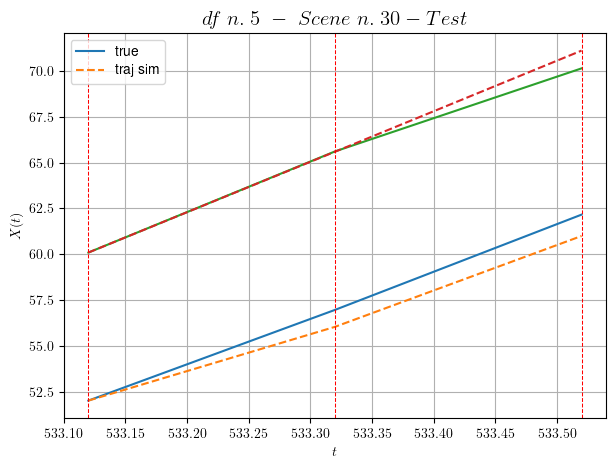

        For scene 30/60:
        * MSE = 0.5256635969967884
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.31/60


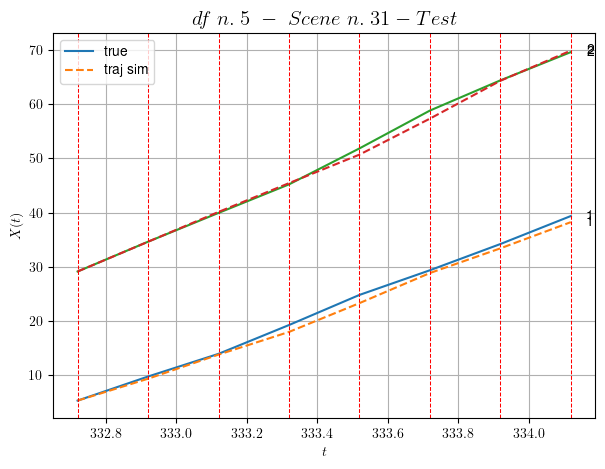

        For scene 31/60:
        * MSE = 0.6256118522670597
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.32/60


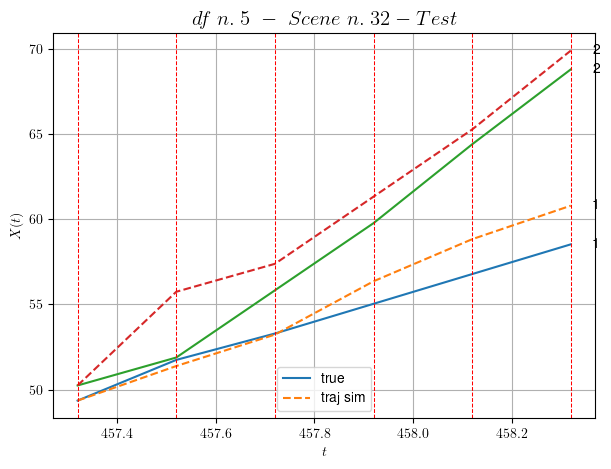

        For scene 32/60:
        * MSE = 2.746342952828007
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.33/60


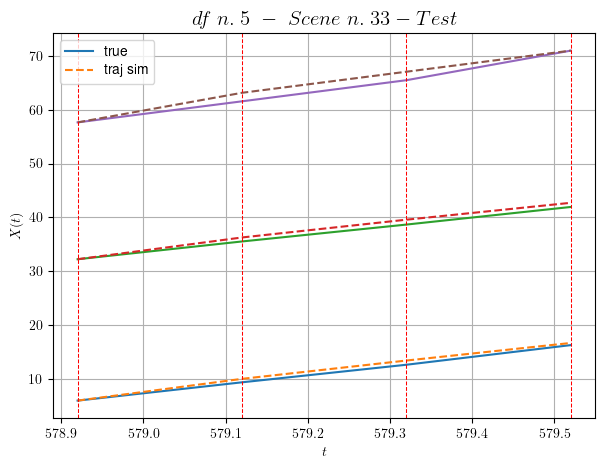

        For scene 33/60:
        * MSE = 0.6793132558804071
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.34/60


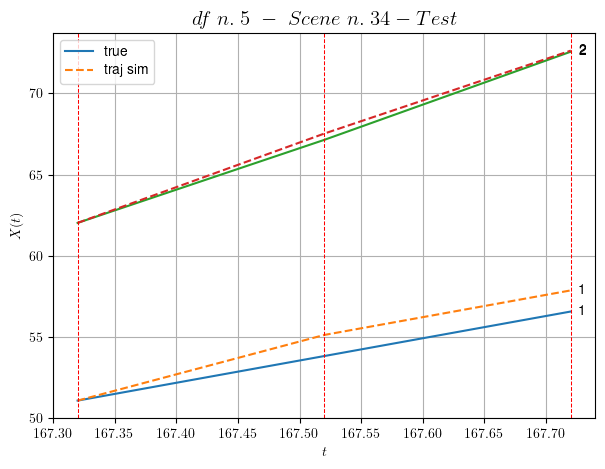

        For scene 34/60:
        * MSE = 0.5894332723726076
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.35/60


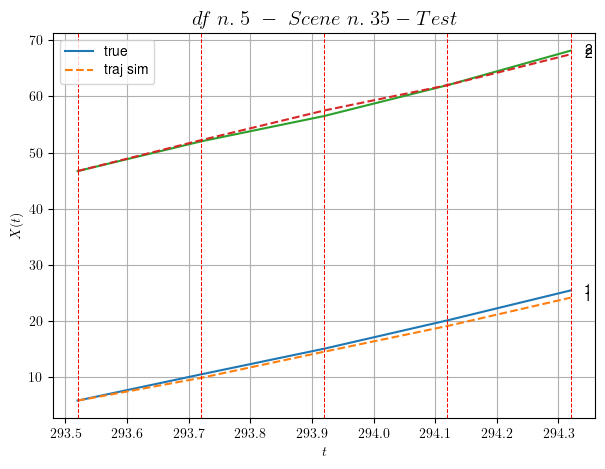

        For scene 35/60:
        * MSE = 0.4765220831877268
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.36/60


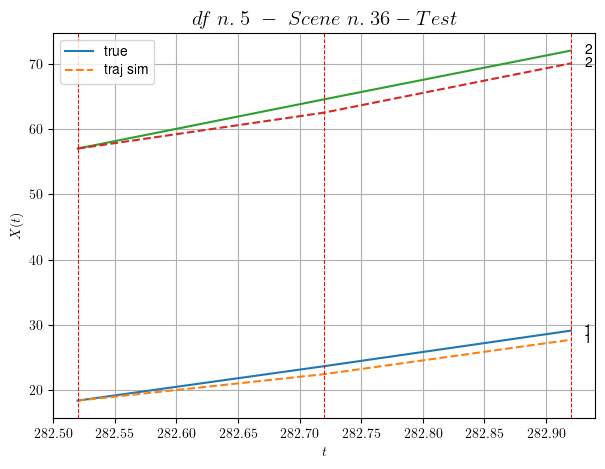

        For scene 36/60:
        * MSE = 1.8951705264528516
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.37/60


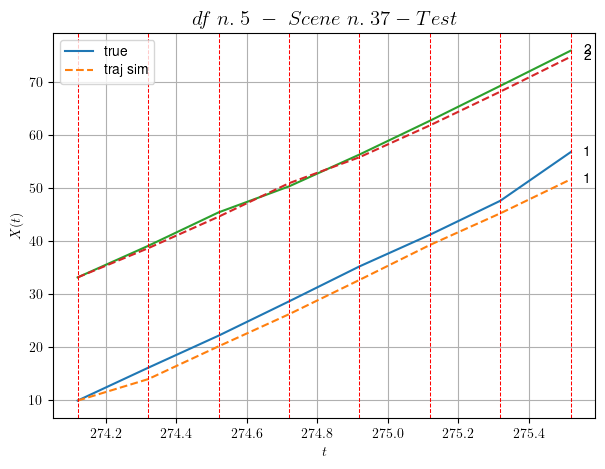

        For scene 37/60:
        * MSE = 3.847640173689478
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.38/60


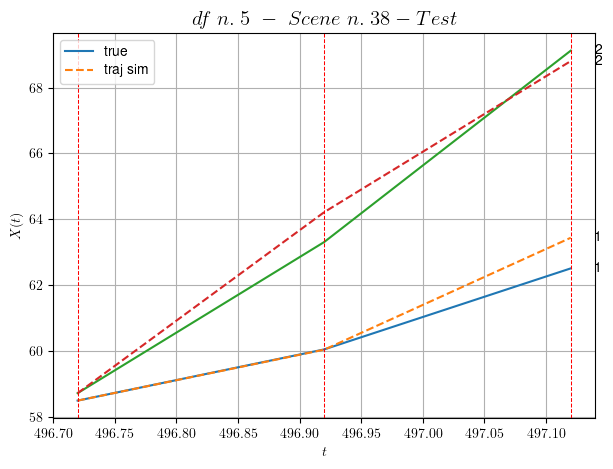

        For scene 38/60:
        * MSE = 0.29836914729056113
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.39/60


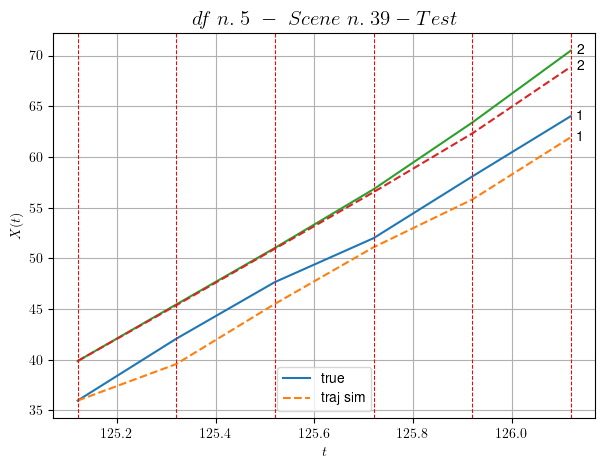

        For scene 39/60:
        * MSE = 2.0765997928584747
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.40/60


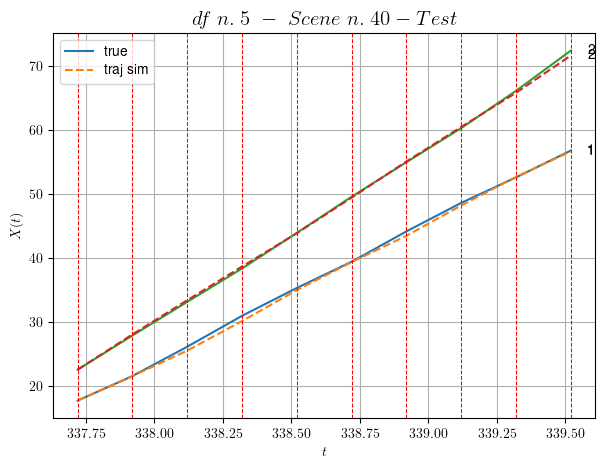

        For scene 40/60:
        * MSE = 0.13757749060705257
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.41/60


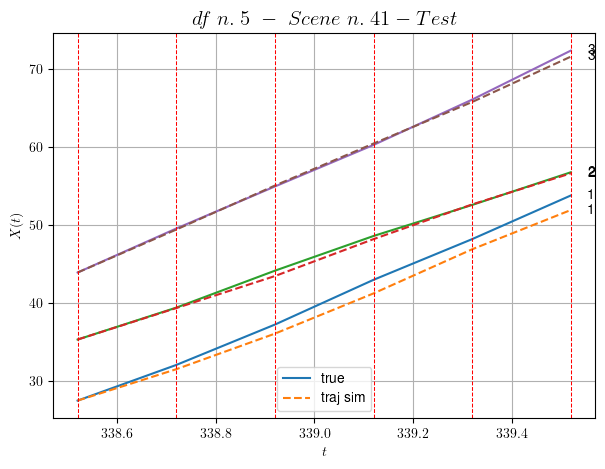

        For scene 41/60:
        * MSE = 0.62561366770252
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.42/60


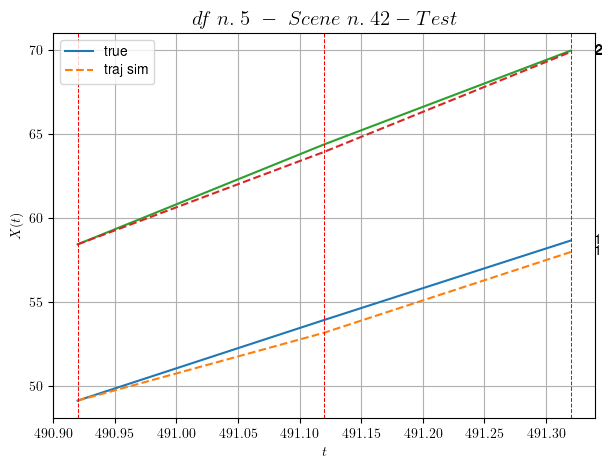

        For scene 42/60:
        * MSE = 0.20691798711511422
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.43/60


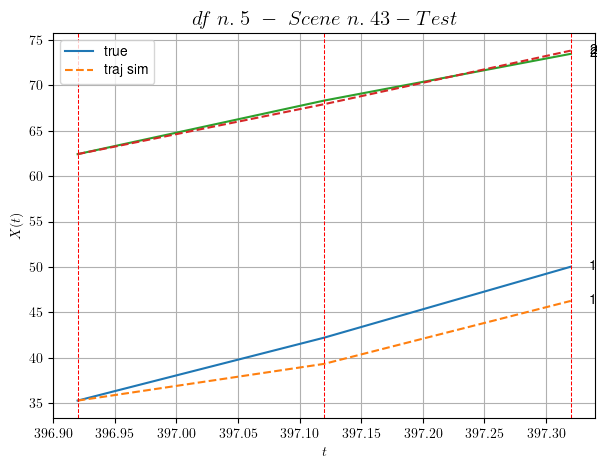

        For scene 43/60:
        * MSE = 3.797476989102508
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.44/60


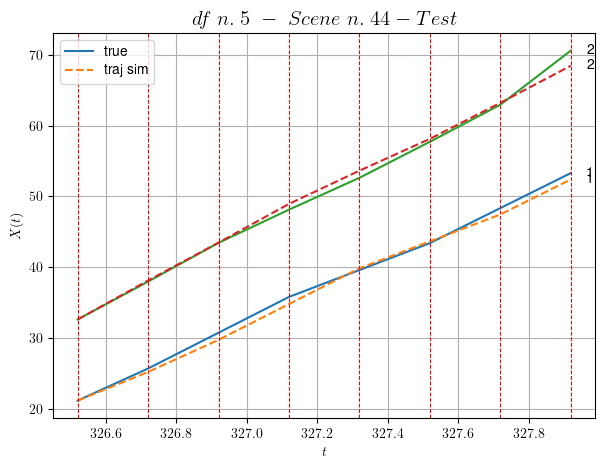

        For scene 44/60:
        * MSE = 0.6571276986516827
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.45/60


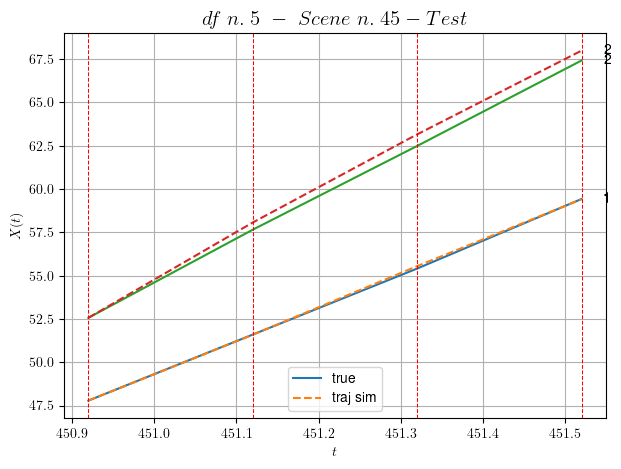

        For scene 45/60:
        * MSE = 0.12052088611642169
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.46/60


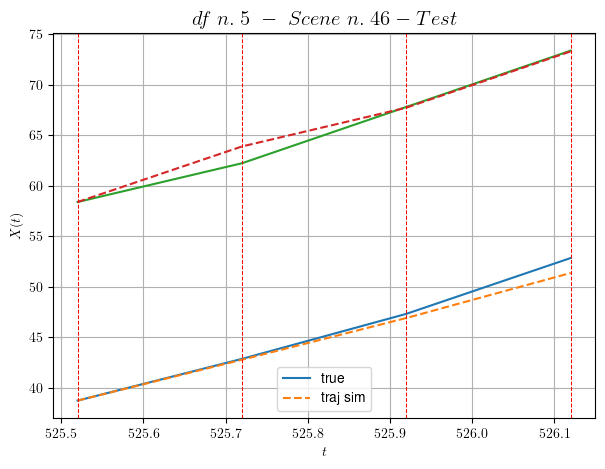

        For scene 46/60:
        * MSE = 0.6434089476604289
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.47/60


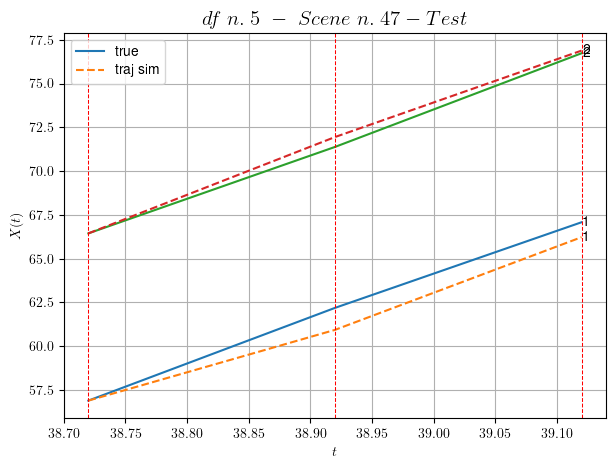

        For scene 47/60:
        * MSE = 0.4409367095662383
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.48/60


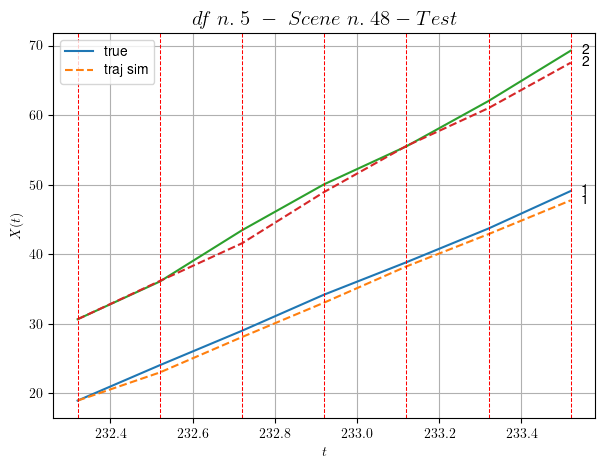

        For scene 48/60:
        * MSE = 1.0605428931705516
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.49/60


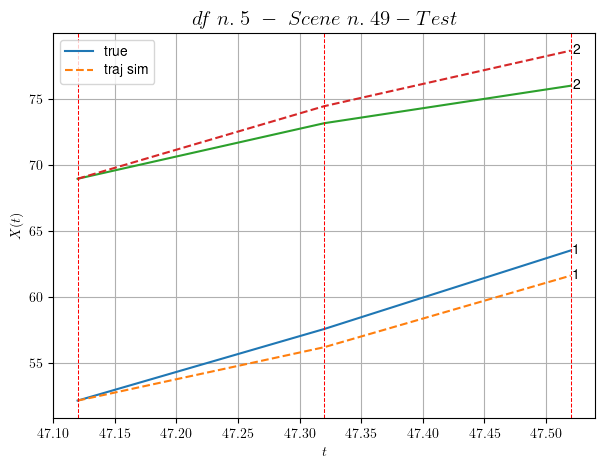

        For scene 49/60:
        * MSE = 2.382453175451584
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.50/60


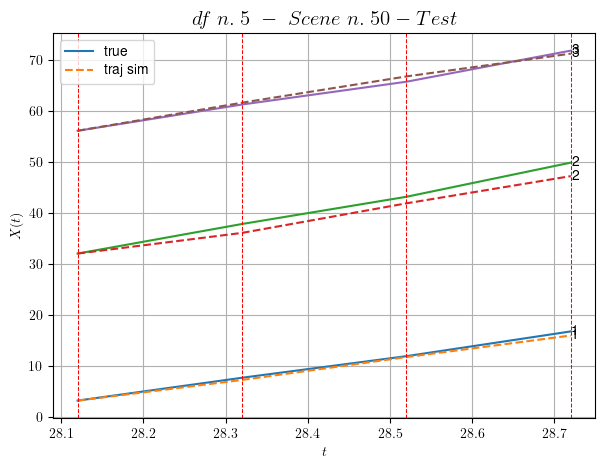

        For scene 50/60:
        * MSE = 1.173468256729172
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.51/60


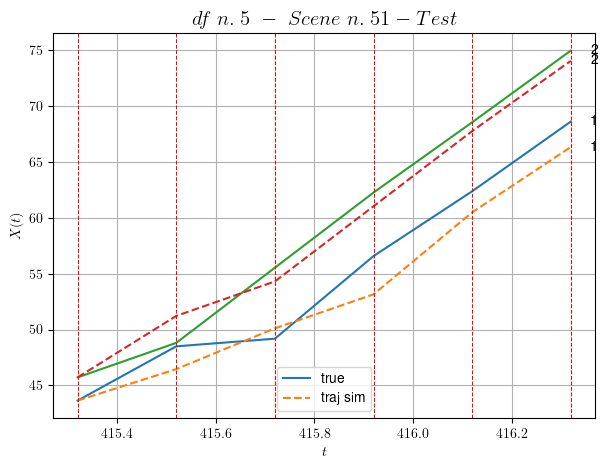

        For scene 51/60:
        * MSE = 2.9878673462574605
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.52/60


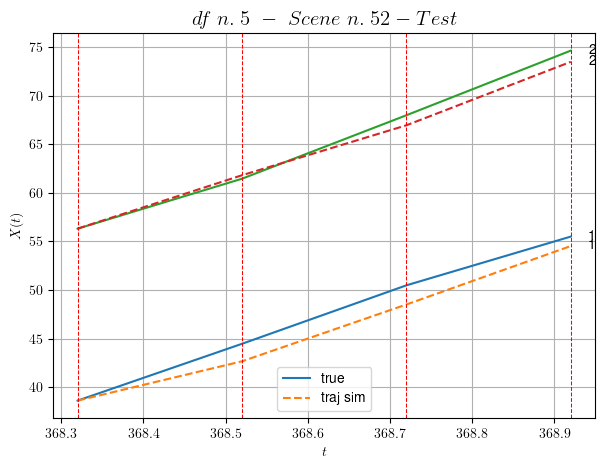

        For scene 52/60:
        * MSE = 1.3279956738493093
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.53/60


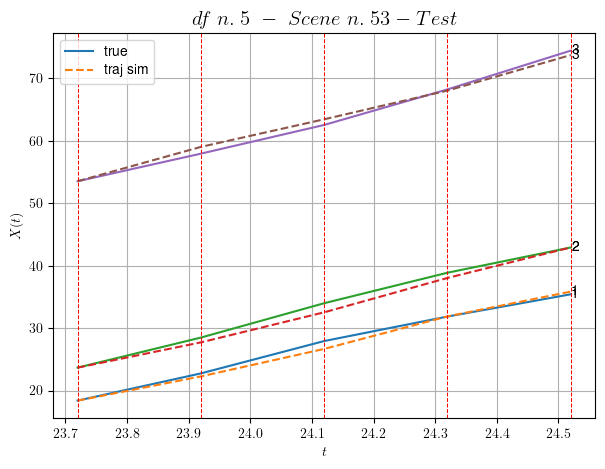

        For scene 53/60:
        * MSE = 0.5299462419924016
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.54/60


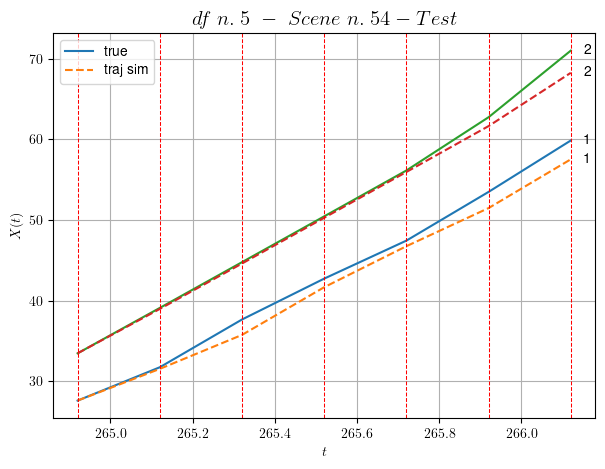

        For scene 54/60:
        * MSE = 1.6891965982437651
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.55/60


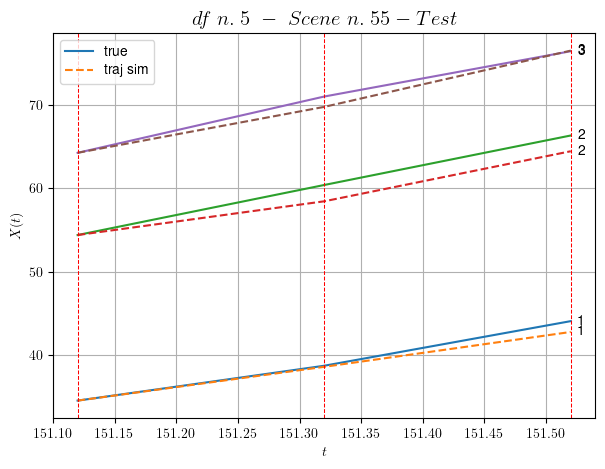

        For scene 55/60:
        * MSE = 1.179306003104262
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.56/60


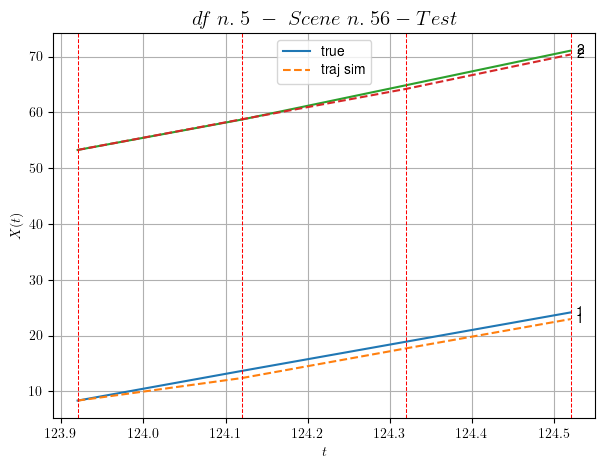

        For scene 56/60:
        * MSE = 0.675966017106892
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.57/60


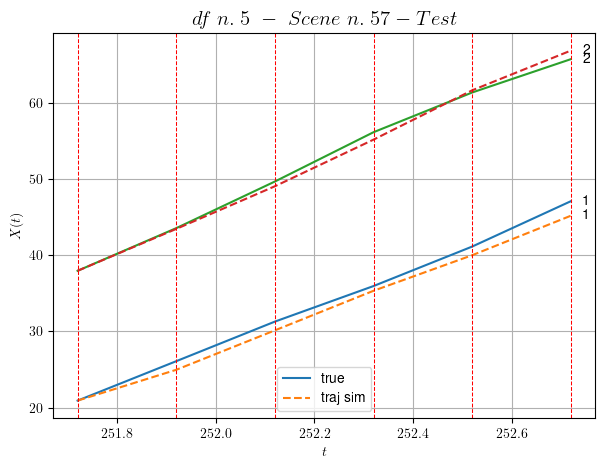

        For scene 57/60:
        * MSE = 0.8853033141378154
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.58/60


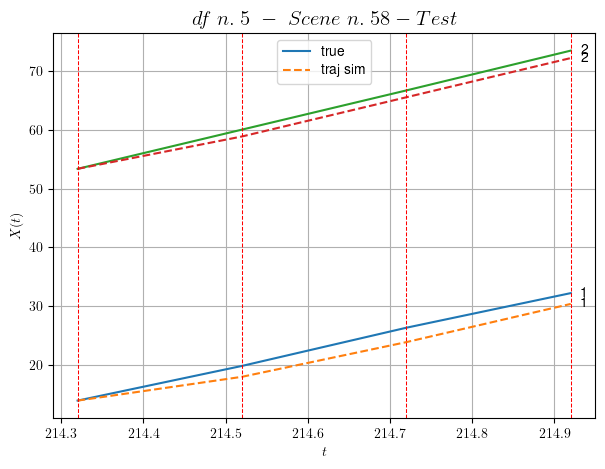

        For scene 58/60:
        * MSE = 2.137608714839925
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.59/60


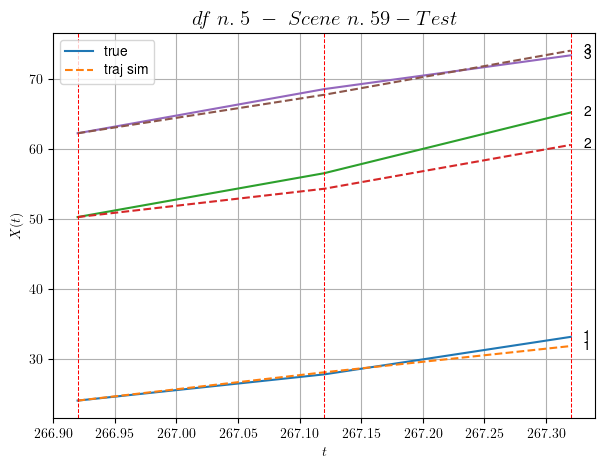

        For scene 59/60:
        * MSE = 3.2595999576474486
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.60/60


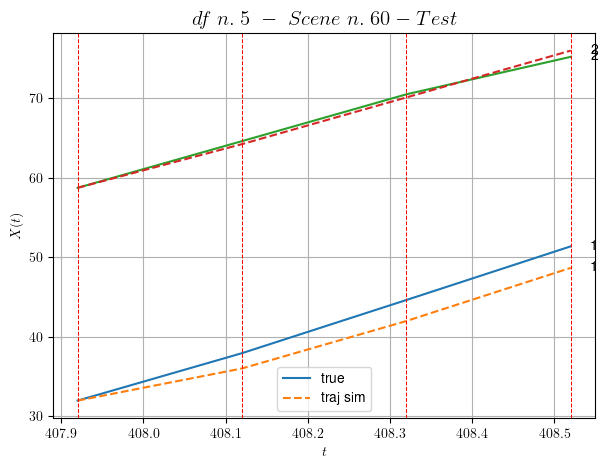

        For scene 60/60:
        * MSE = 2.368428620431319
----------------------------------------------------------------------------------------------------


MSE test: 1.8070106013510114

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.27212436263075274
          * MSE test: 1.8070106013510114
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 6/10 dfs.
In DataFrame n.6 we have 52 scenes.
    To train the model we use 5 scenes, the remaining 47 to test the model.

Training step. (5 scenes)
DataFrame n.6. Scene n.1/5
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.60,87.40]


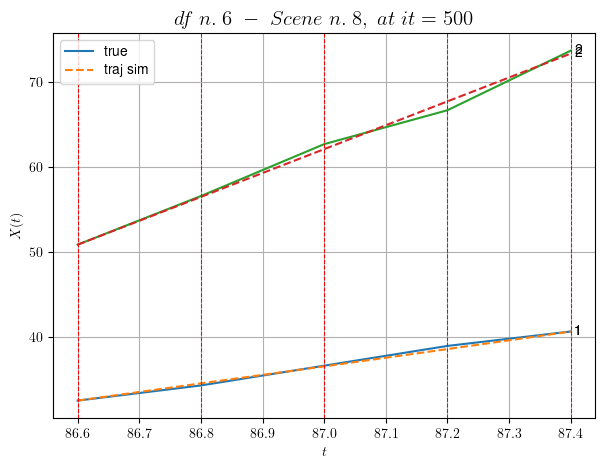

----------------------------------------------------------------------------------------------------
        For scene 1/5:
        * After LR finder: LR_NN=0.005 with mse=0.6125434380013287 at it=24
        * v0 = 28.176915163685493
        * MSE = 0.17774365376297752
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/5
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [493.80,494.40]


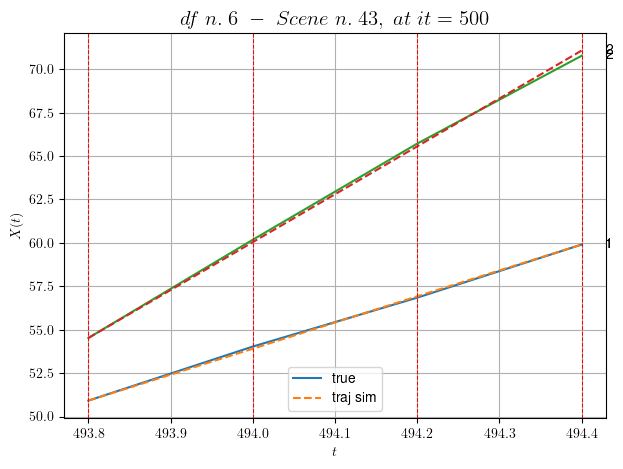

----------------------------------------------------------------------------------------------------
        For scene 2/5:
        * After LR finder: LR_NN=0.005 with mse=0.4840455664728701 at it=24
        * v0 = 27.57702754451529
        * MSE = 0.019559418218698037
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/5
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [162.20,163.60]


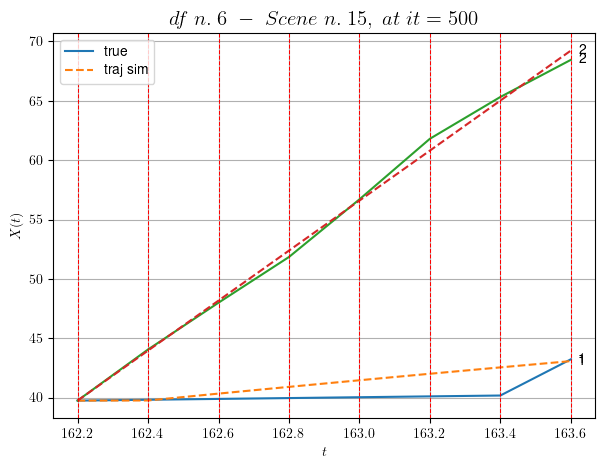

----------------------------------------------------------------------------------------------------
        For scene 3/5:
        * After LR finder: LR_NN=0.01 with mse=28.493079508537978 at it=24
        * v0 = 21.059787487615633
        * MSE = 0.6023951522496839
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/5
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [368.20,369.20]


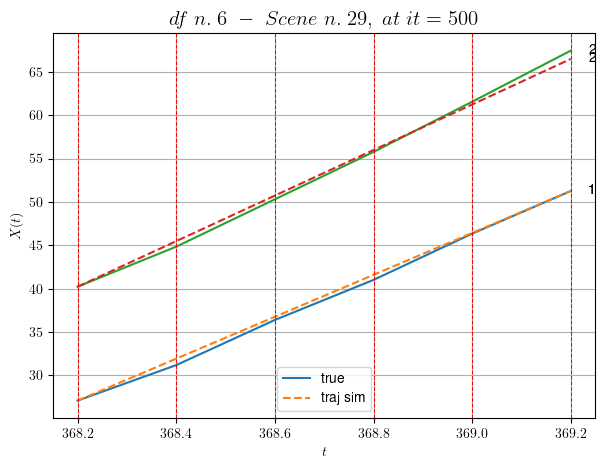

----------------------------------------------------------------------------------------------------
        For scene 4/5:
        * After LR finder: LR_NN=0.0001 with mse=2.230607044098772 at it=24
        * v0 = 26.269654614172815
        * MSE = 0.20472523908923923
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/5
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [465.20,466.40]


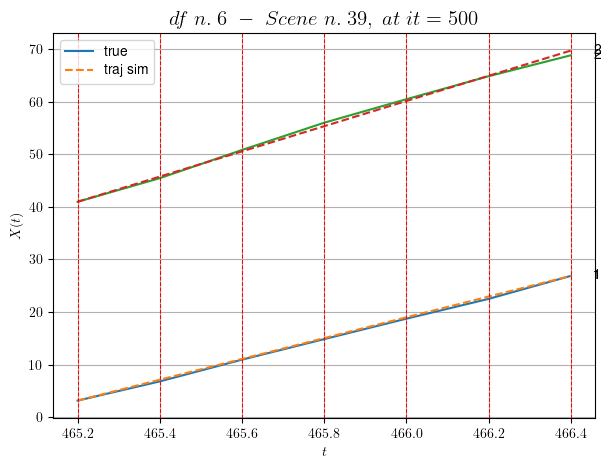

----------------------------------------------------------------------------------------------------
        For scene 5/5:
        * After LR finder: LR_NN=0.005 with mse=10.019663718866964 at it=24
        * v0 = 23.956962458800266
        * MSE = 0.1376290572760478
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.22841050411932926
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (47 scenes)
DataFrame n.6. Scene n.1/47


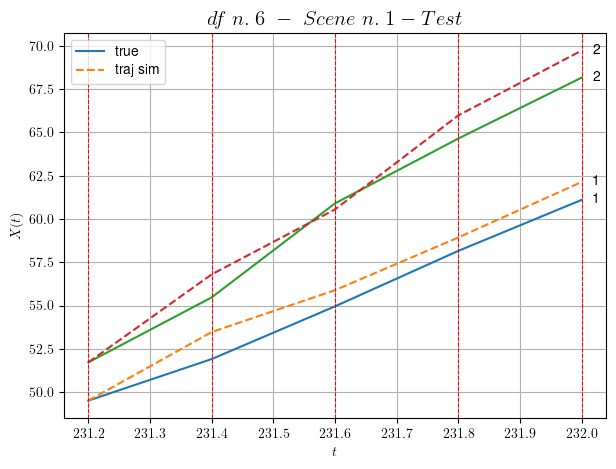

        For scene 1/47:
        * MSE = 1.109891473240605
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/47


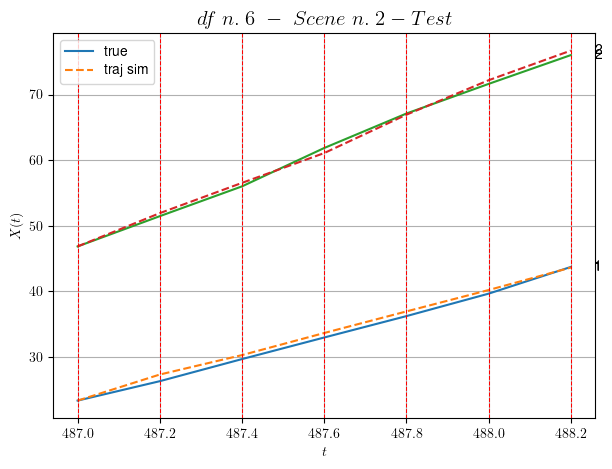

        For scene 2/47:
        * MSE = 0.32894649273429444
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/47


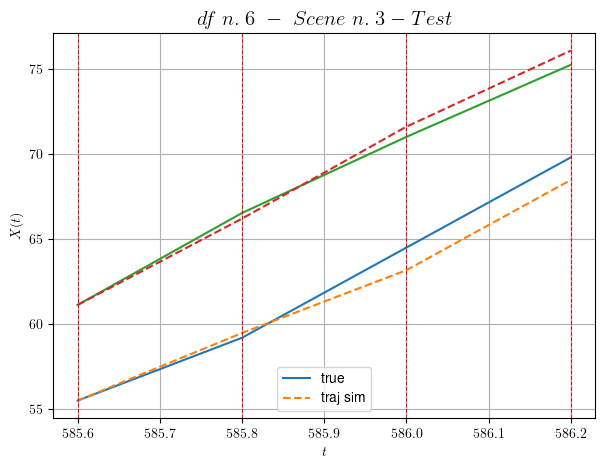

        For scene 3/47:
        * MSE = 0.5989754613147086
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/47


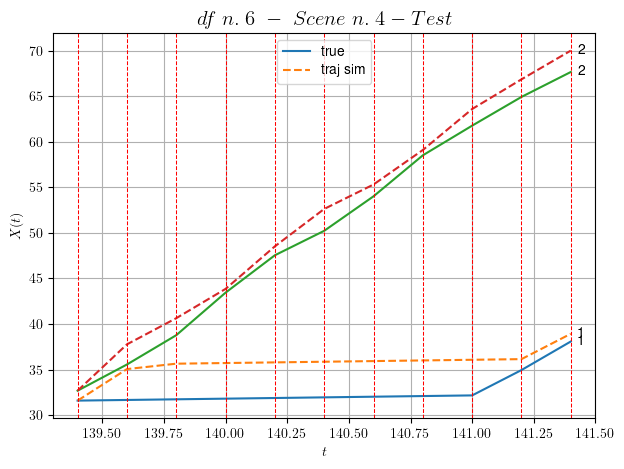

        For scene 4/47:
        * MSE = 6.836609423795295
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/47


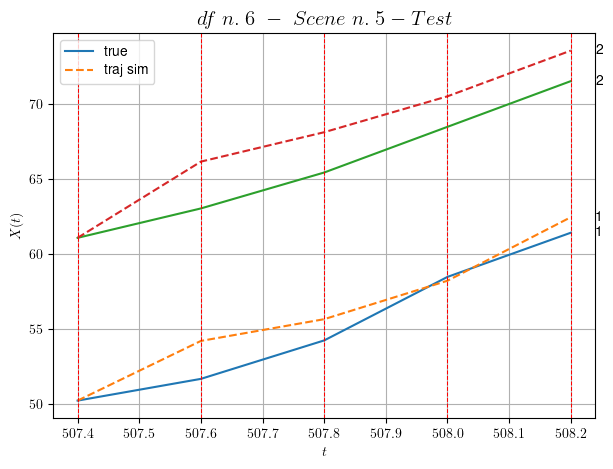

        For scene 5/47:
        * MSE = 3.4782695436414652
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/47


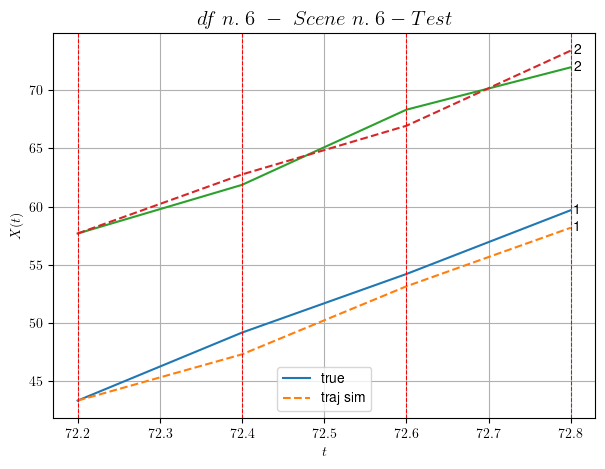

        For scene 6/47:
        * MSE = 1.4596296439583127
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/47


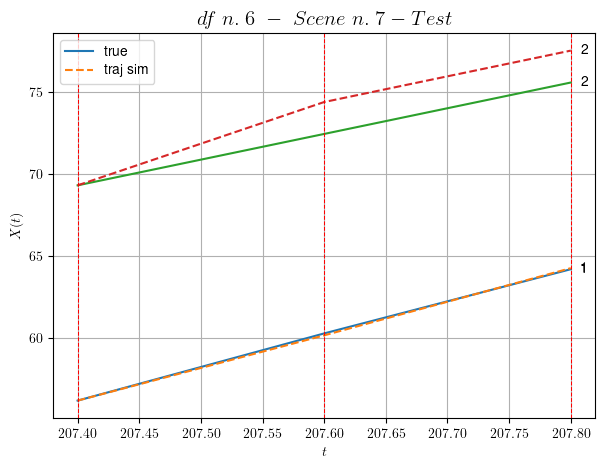

        For scene 7/47:
        * MSE = 1.265726895475587
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/47


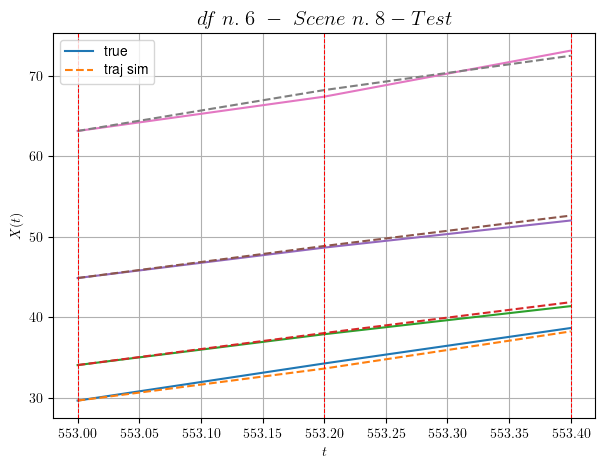

        For scene 8/47:
        * MSE = 0.19447539498551378
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/47


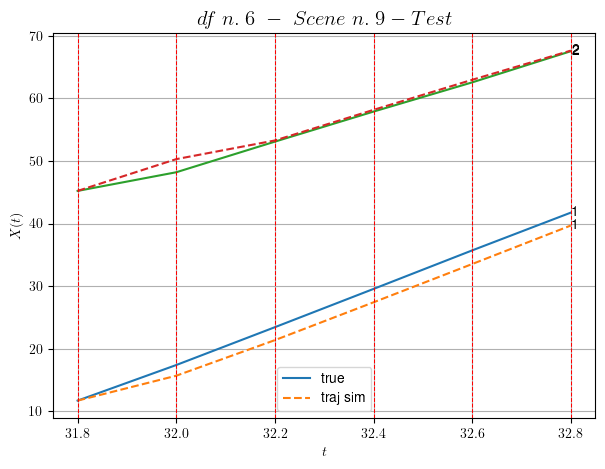

        For scene 9/47:
        * MSE = 2.1230777273987345
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/47


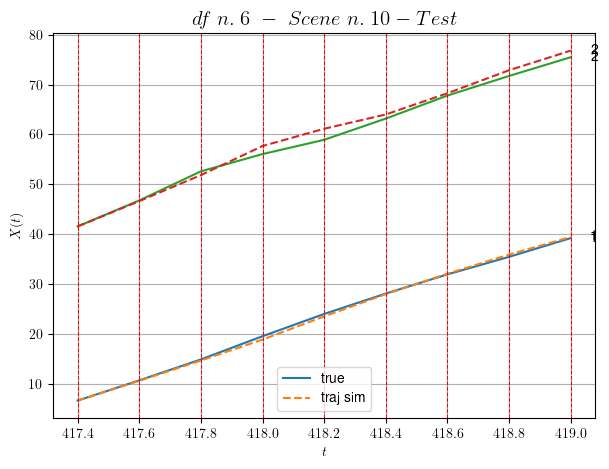

        For scene 10/47:
        * MSE = 0.7294703380093382
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/47


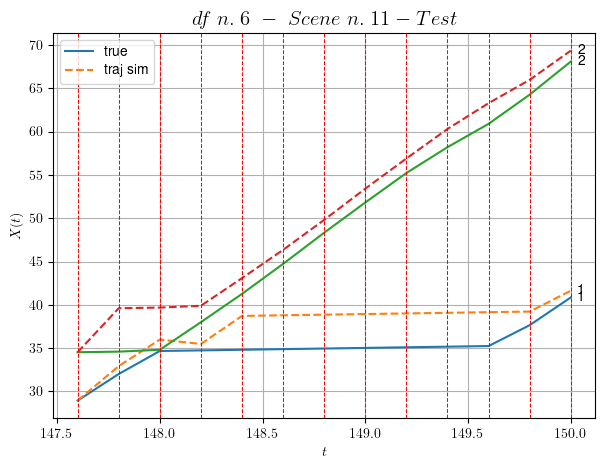

        For scene 11/47:
        * MSE = 7.447154733817783
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/47


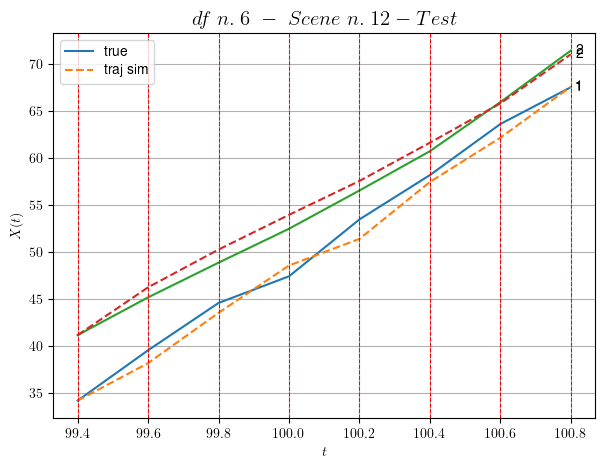

        For scene 12/47:
        * MSE = 1.1582000079416805
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/47


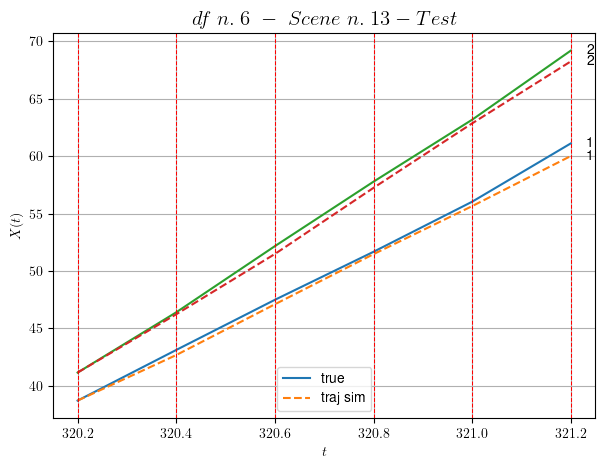

        For scene 13/47:
        * MSE = 0.2932426369142455
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/47


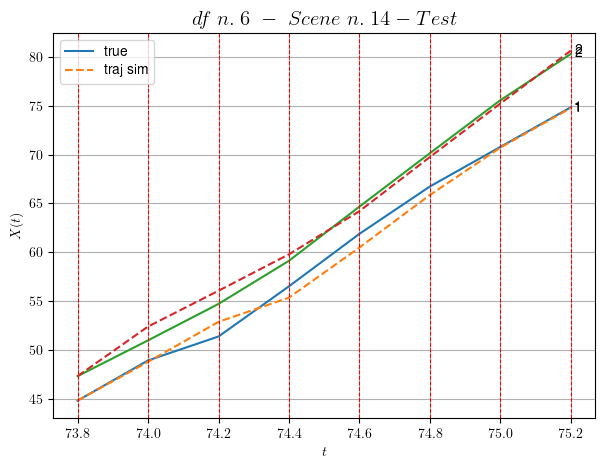

        For scene 14/47:
        * MSE = 0.7010363133773467
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/47


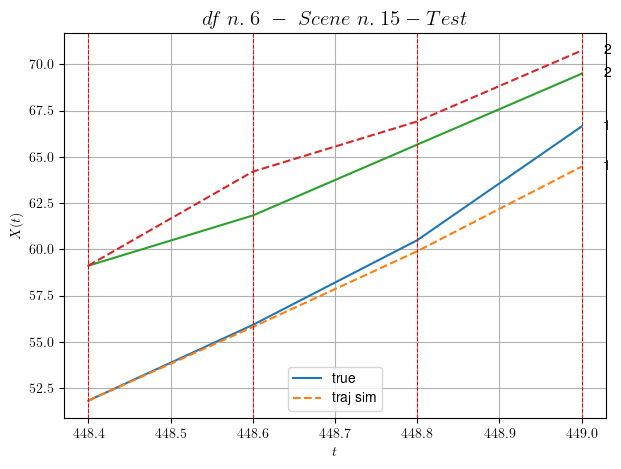

        For scene 15/47:
        * MSE = 1.7270914490391043
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/47


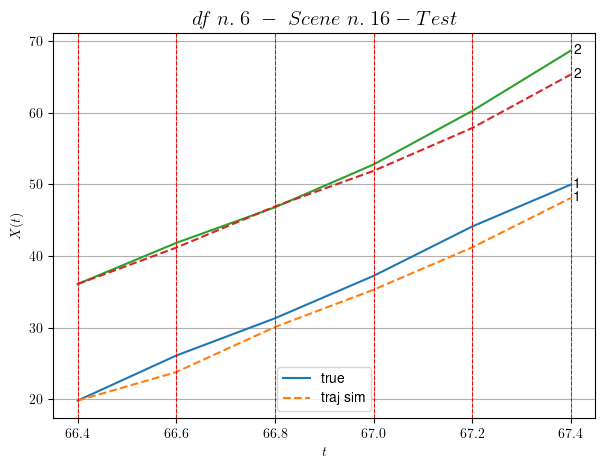

        For scene 16/47:
        * MSE = 3.380291744179782
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/47


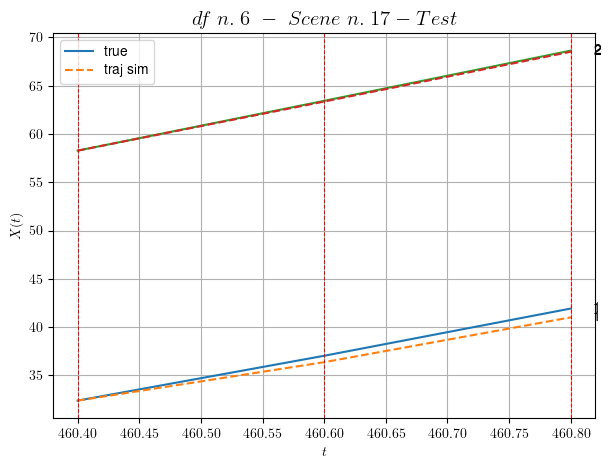

        For scene 17/47:
        * MSE = 0.21558382009663232
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/47


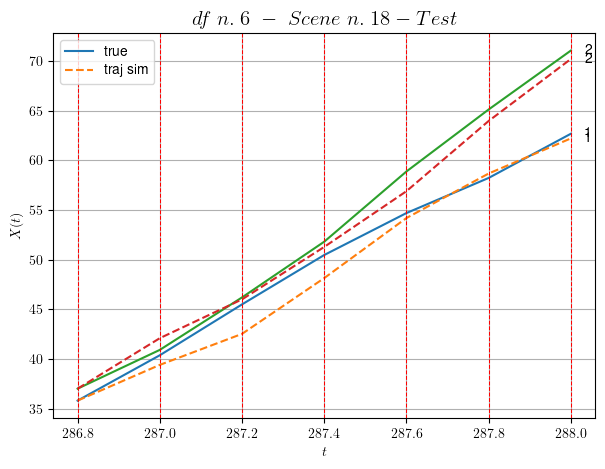

        For scene 18/47:
        * MSE = 1.6789270108663774
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.19/47


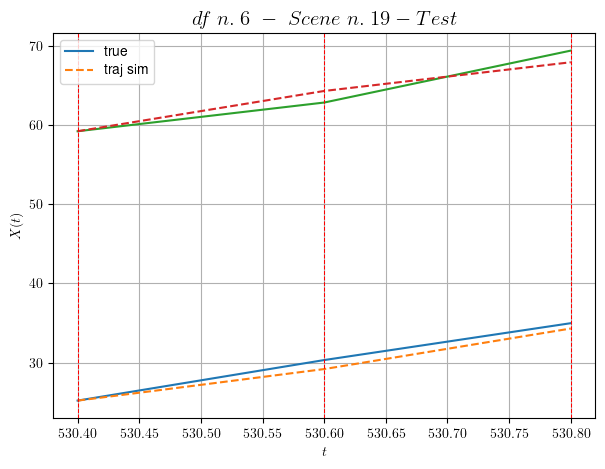

        For scene 19/47:
        * MSE = 1.0049955456293485
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.20/47


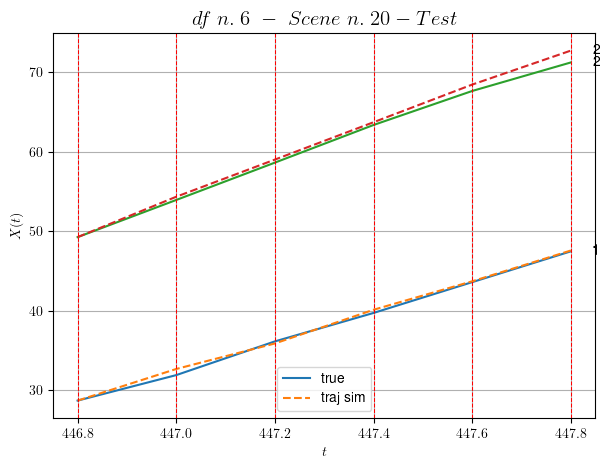

        For scene 20/47:
        * MSE = 0.345353758589407
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.21/47


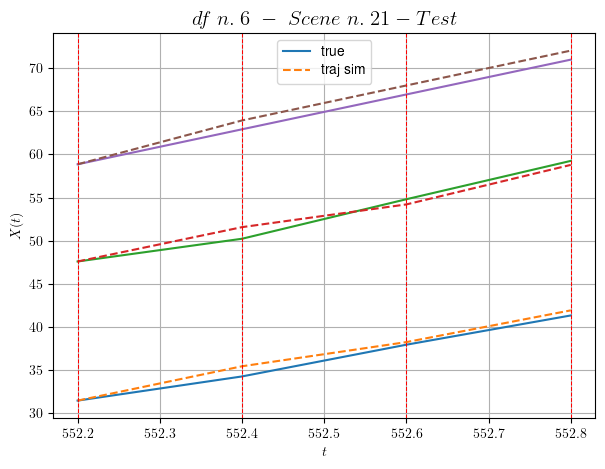

        For scene 21/47:
        * MSE = 0.6202259145613722
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.22/47


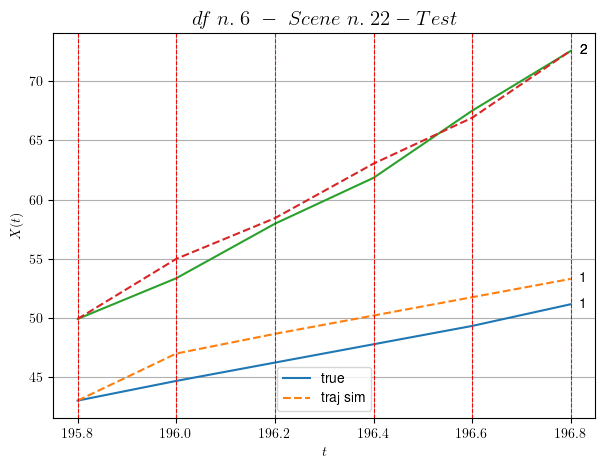

        For scene 22/47:
        * MSE = 2.6981365481250097
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.23/47


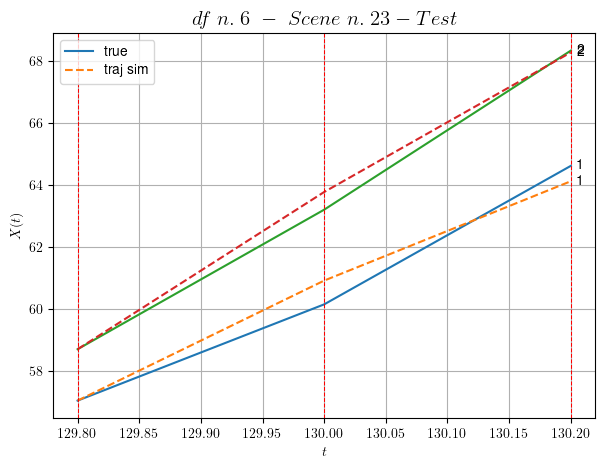

        For scene 23/47:
        * MSE = 0.19439595561722856
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.24/47


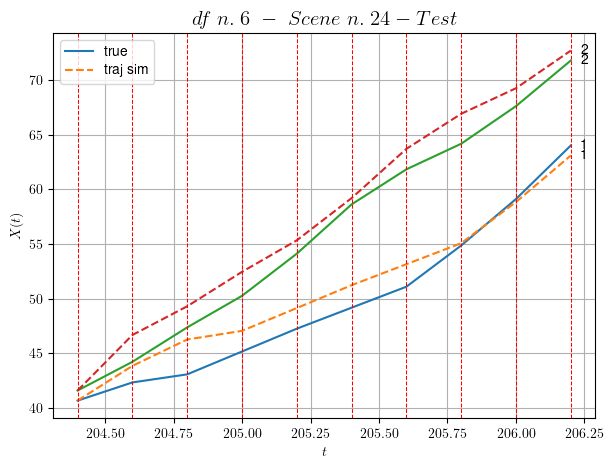

        For scene 24/47:
        * MSE = 2.999219334952997
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.25/47


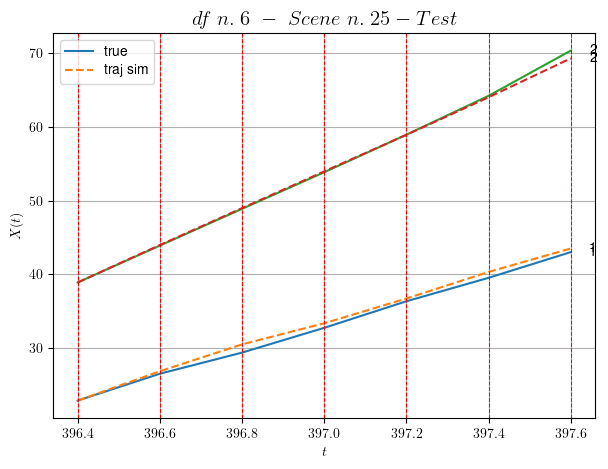

        For scene 25/47:
        * MSE = 0.28034742026547566
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.26/47


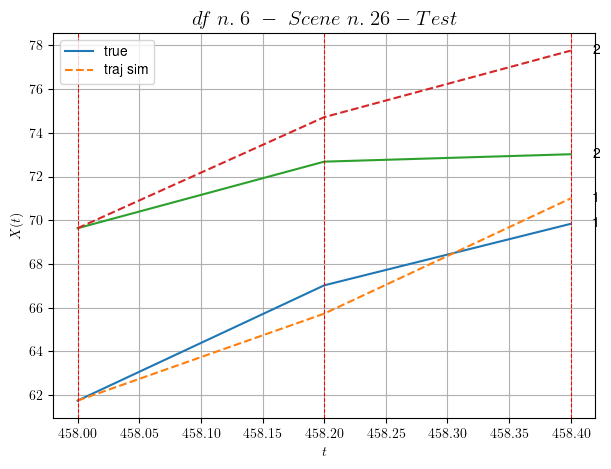

        For scene 26/47:
        * MSE = 4.945027572210363
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.27/47


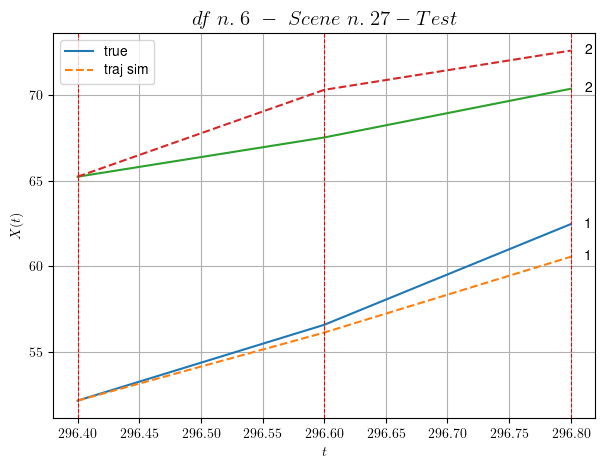

        For scene 27/47:
        * MSE = 2.7685573433580055
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.28/47


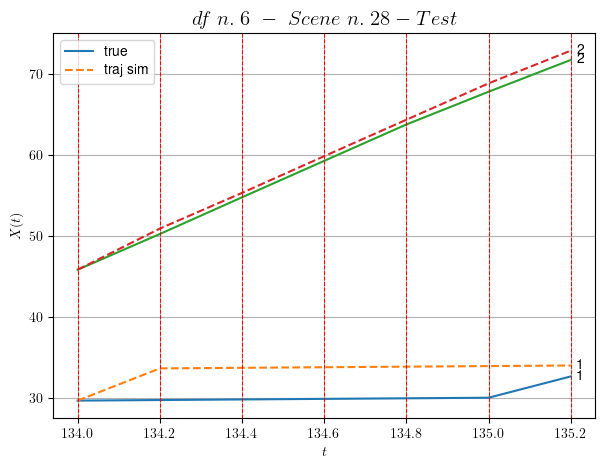

        For scene 28/47:
        * MSE = 5.8590729310888054
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.29/47


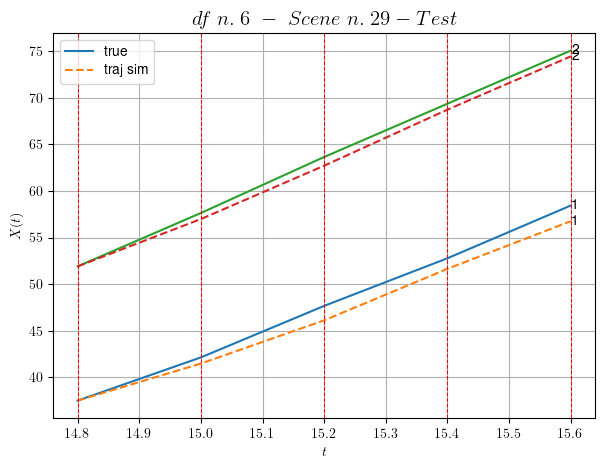

        For scene 29/47:
        * MSE = 0.9040448957793779
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.30/47


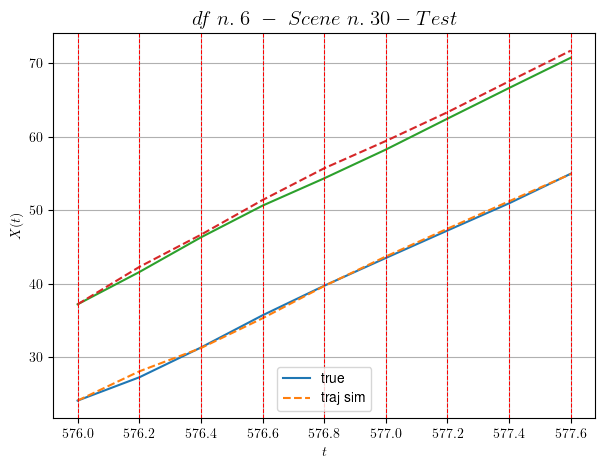

        For scene 30/47:
        * MSE = 0.441973343930661
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.31/47


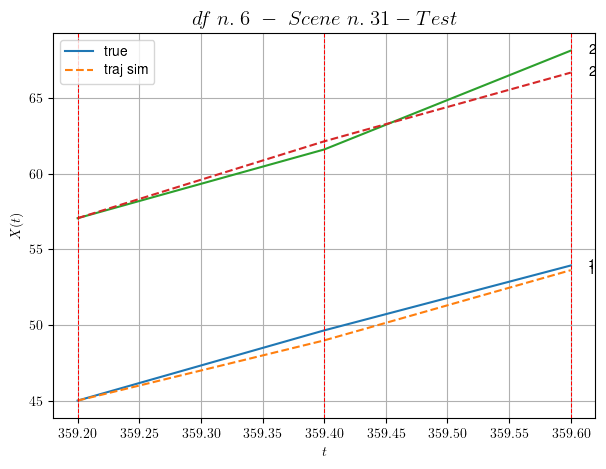

        For scene 31/47:
        * MSE = 0.4897597136892764
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.32/47


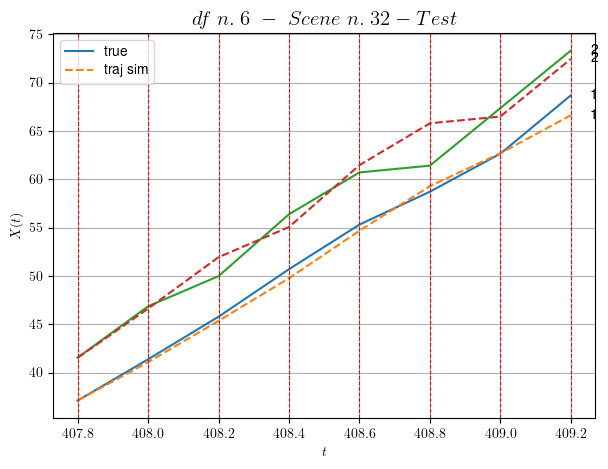

        For scene 32/47:
        * MSE = 2.0622031029855696
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.33/47


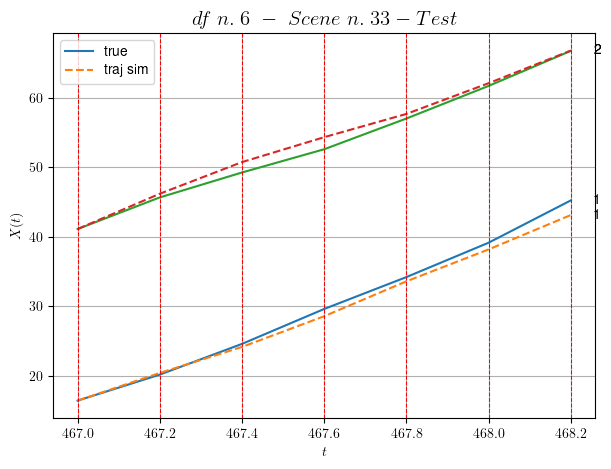

        For scene 33/47:
        * MSE = 0.9430075757934374
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.34/47


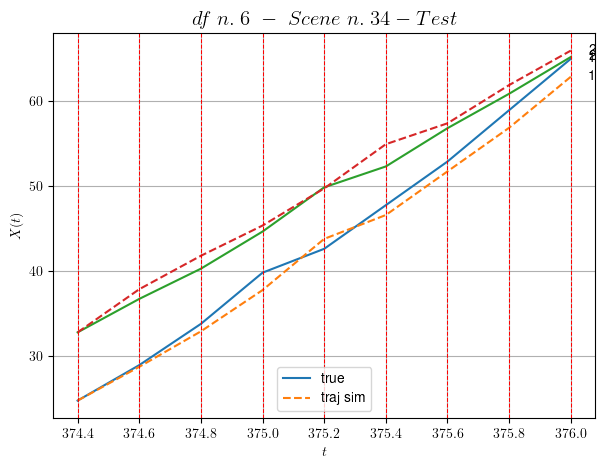

        For scene 34/47:
        * MSE = 1.7106523894941104
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.35/47


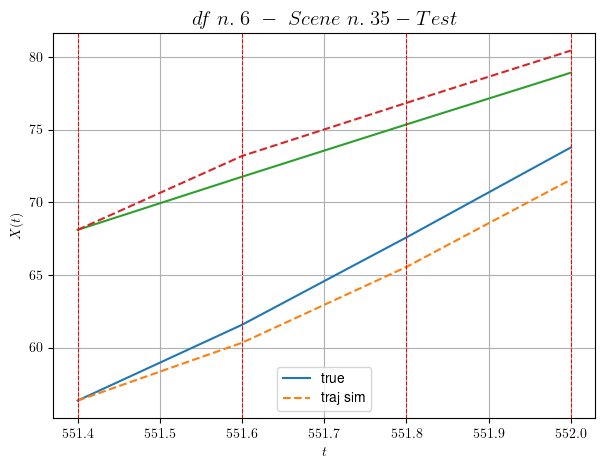

        For scene 35/47:
        * MSE = 2.1371946794760923
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.36/47


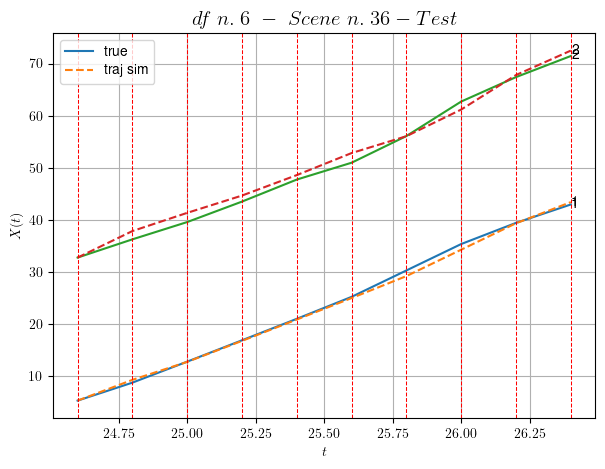

        For scene 36/47:
        * MSE = 0.8830257760970279
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.37/47


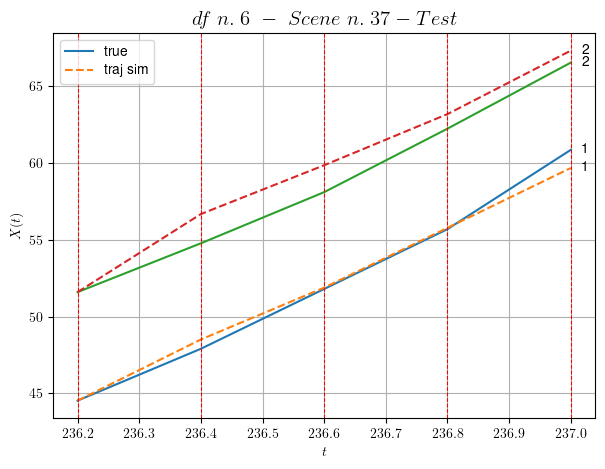

        For scene 37/47:
        * MSE = 0.9975650783435948
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.38/47


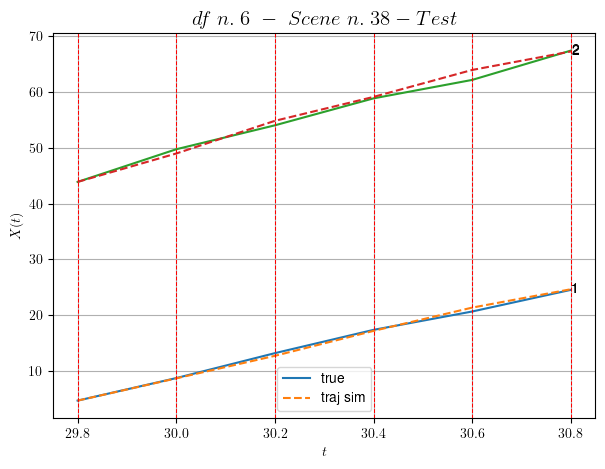

        For scene 38/47:
        * MSE = 0.437429815138671
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.39/47


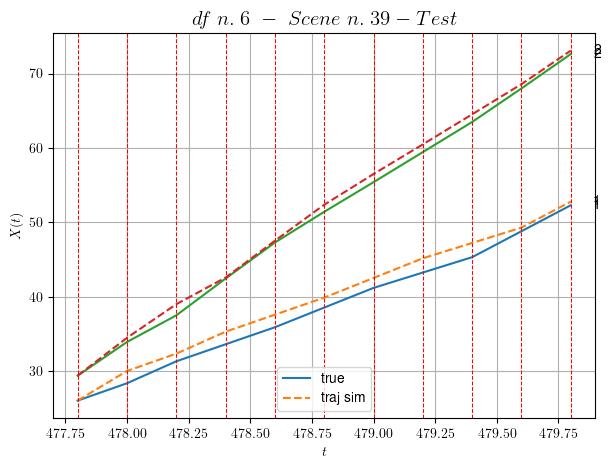

        For scene 39/47:
        * MSE = 1.2861812830878434
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.40/47


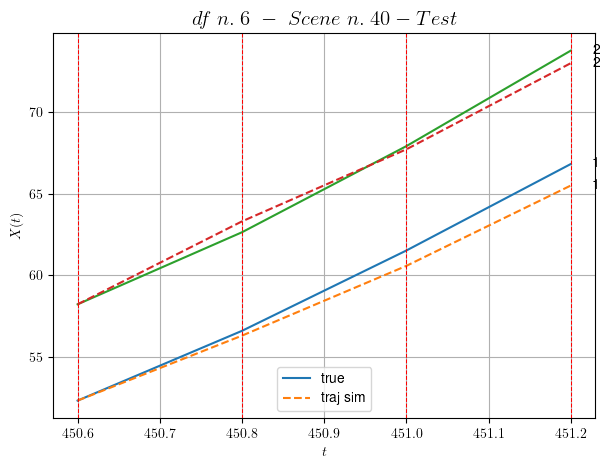

        For scene 40/47:
        * MSE = 0.4731124261144724
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.41/47


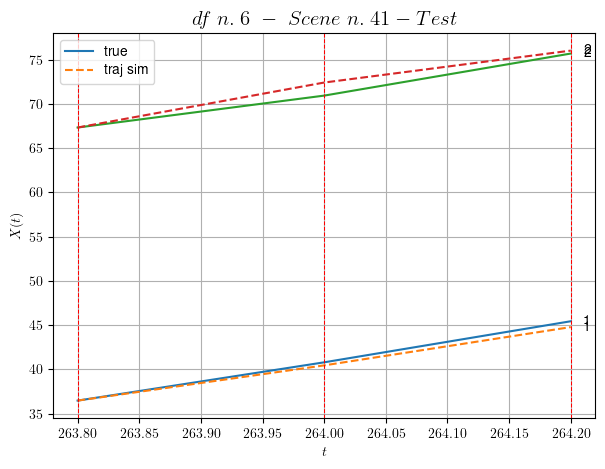

        For scene 41/47:
        * MSE = 0.47329782242167623
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.42/47


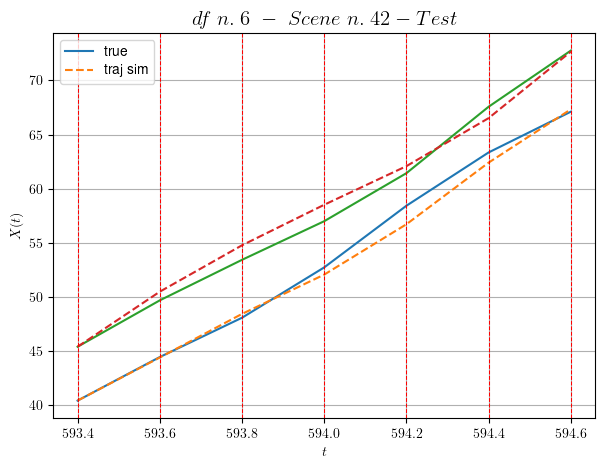

        For scene 42/47:
        * MSE = 0.764595928642597
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.43/47


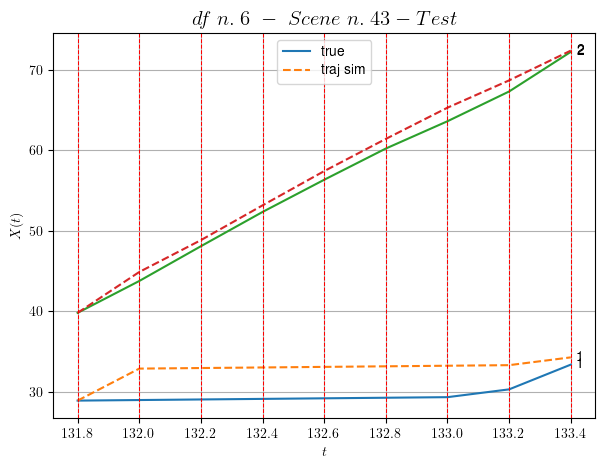

        For scene 43/47:
        * MSE = 6.188817718381419
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.44/47


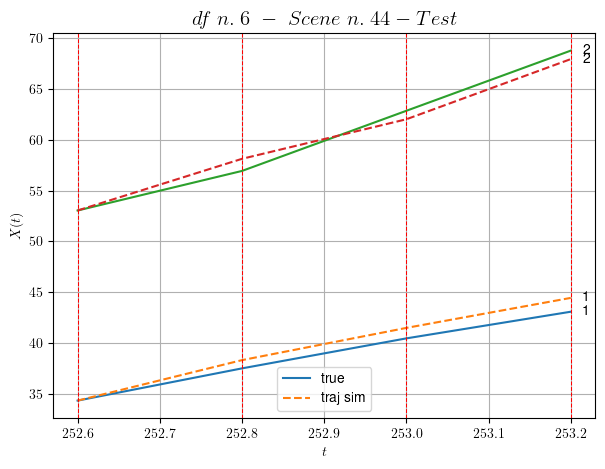

        For scene 44/47:
        * MSE = 0.7969723224459069
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.45/47


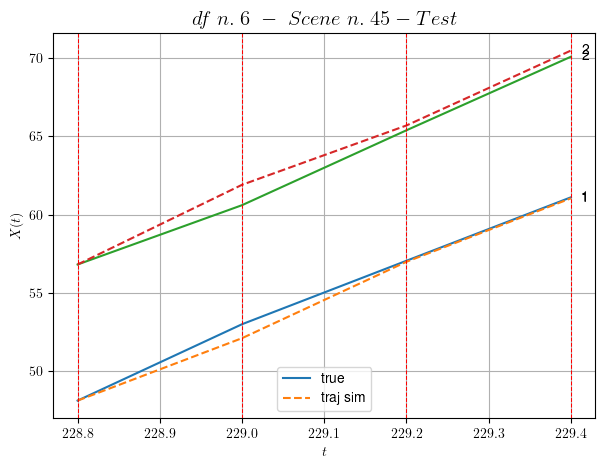

        For scene 45/47:
        * MSE = 0.3423053348834854
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.46/47


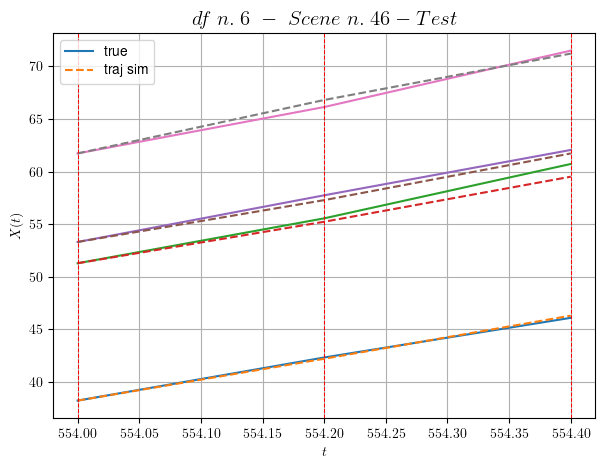

        For scene 46/47:
        * MSE = 0.20664067841652217
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.47/47


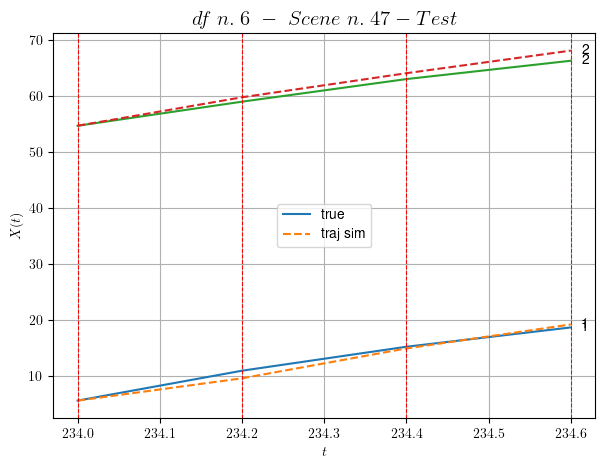

        For scene 47/47:
        * MSE = 0.8993908075382779
----------------------------------------------------------------------------------------------------


MSE test: 1.6783000665498902

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.22841050411932926
          * MSE test: 1.6783000665498902
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 7/10 dfs.
In DataFrame n.7 we have 30 scenes.
    To train the model we use 3 scenes, the remaining 27 to test the model.

Training step. (3 scenes)
DataFrame n.7. Scene n.1/3
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [162.36,163.16]


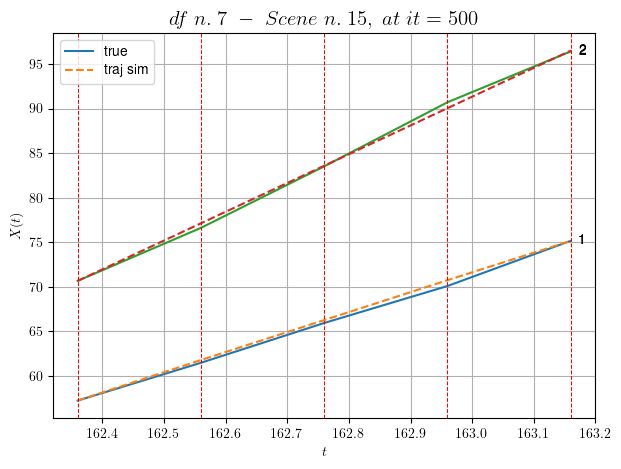

----------------------------------------------------------------------------------------------------
        For scene 1/3:
        * After LR finder: LR_NN=0.005 with mse=0.8992368499821635 at it=24
        * v0 = 32.323787690864414
        * MSE = 0.13433974528390455
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/3
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [206.96,207.56]


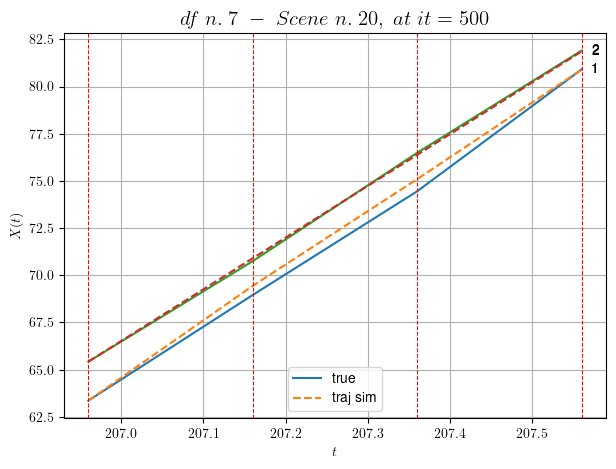

----------------------------------------------------------------------------------------------------
        For scene 2/3:
        * After LR finder: LR_NN=0.005 with mse=0.5682972398971834 at it=24
        * v0 = 27.39925633880063
        * MSE = 0.08412001171557242
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/3
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


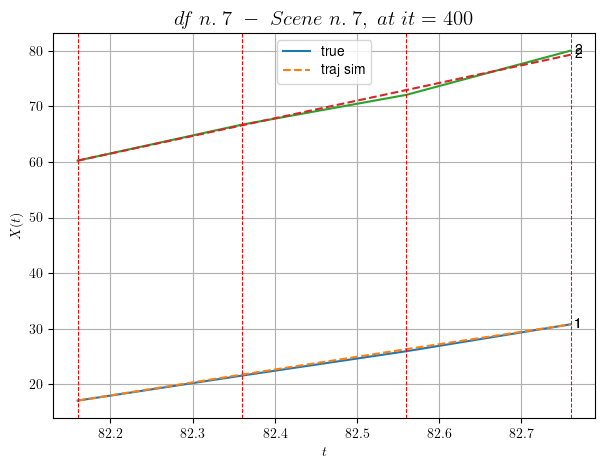

----------------------------------------------------------------------------------------------------
        For scene 3/3:
        * After LR finder: LR_NN=0.01 with mse=0.46297999187951355 at it=24
        * v0 = 31.745431021111784
        * MSE = 0.18397867849899022
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 0.13414614516615572
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (27 scenes)
DataFrame n.7. Scene n.1/27


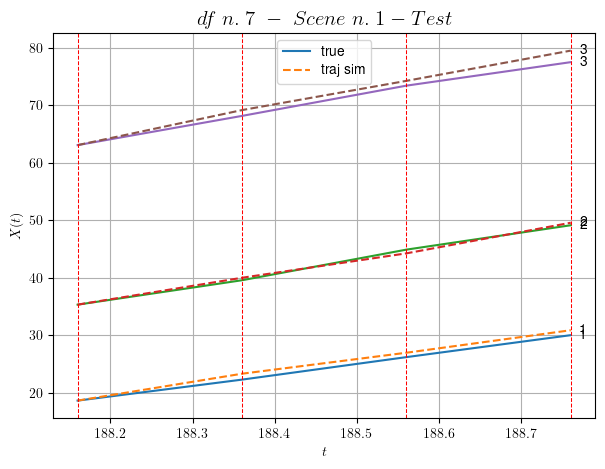

        For scene 1/27:
        * MSE = 0.7435418764152598
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/27


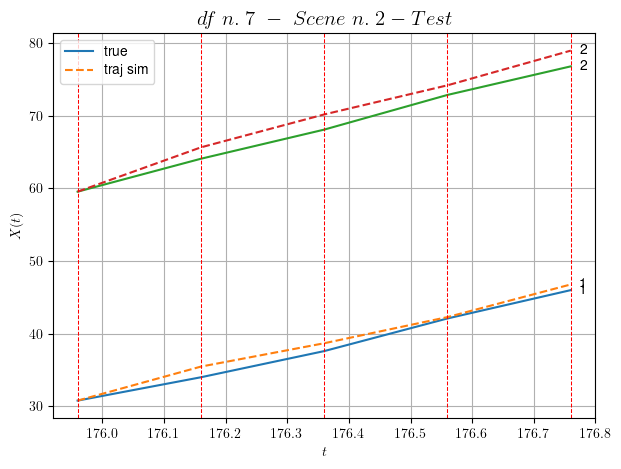

        For scene 2/27:
        * MSE = 1.722988573084905
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/27


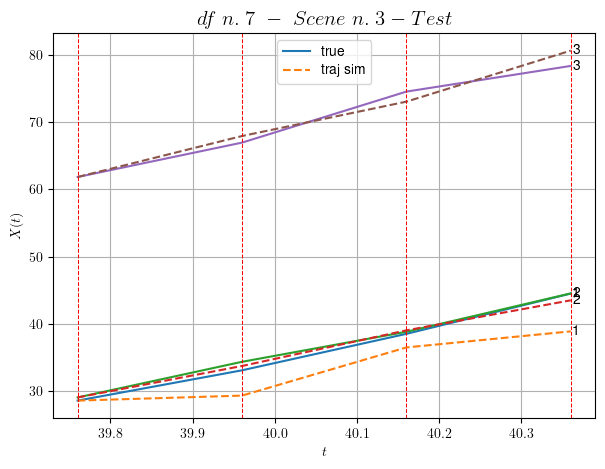

        For scene 3/27:
        * MSE = 4.981416761833553
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/27


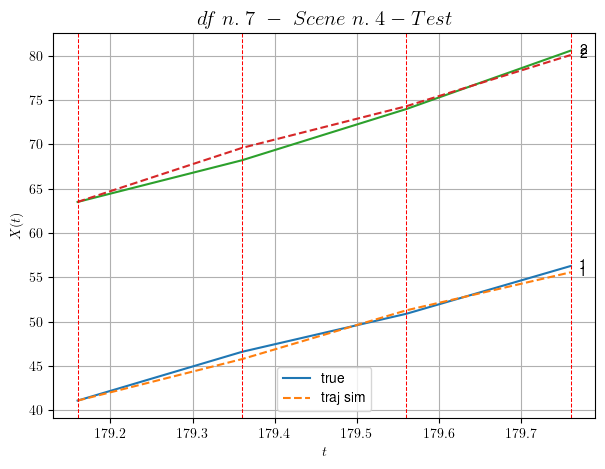

        For scene 4/27:
        * MSE = 0.45288989426170834
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/27


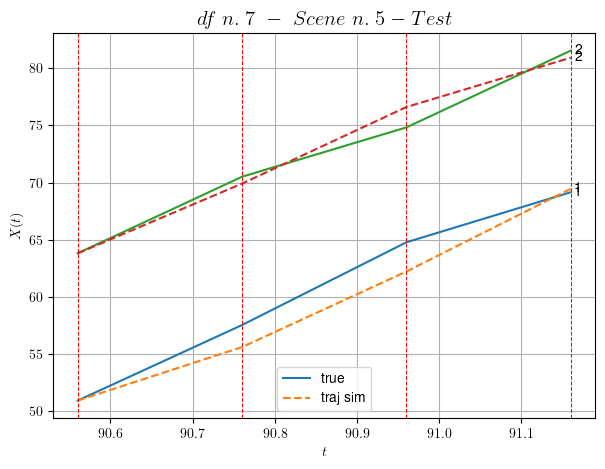

        For scene 5/27:
        * MSE = 1.7830032843548695
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/27


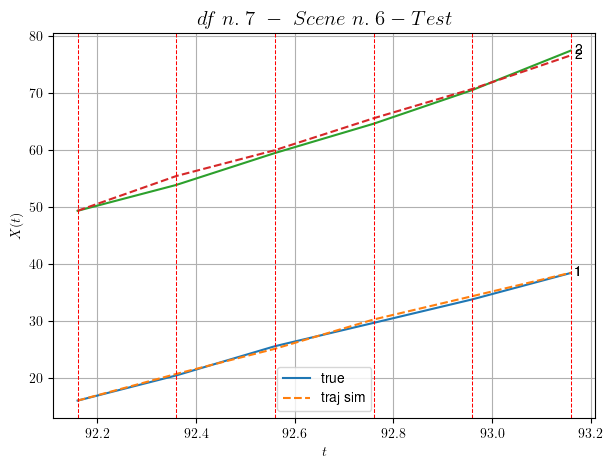

        For scene 6/27:
        * MSE = 0.4399697037410215
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/27


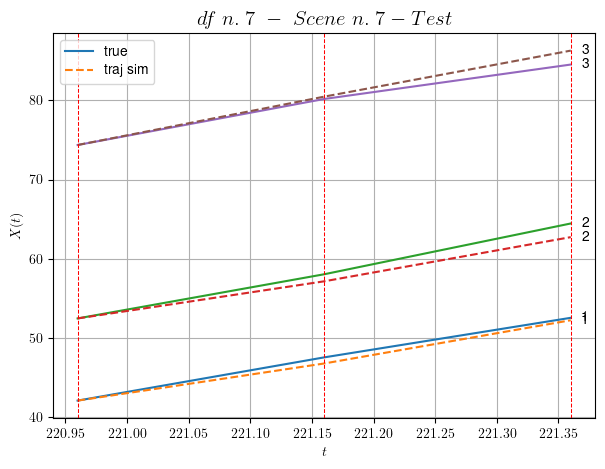

        For scene 7/27:
        * MSE = 0.8461556020359865
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/27


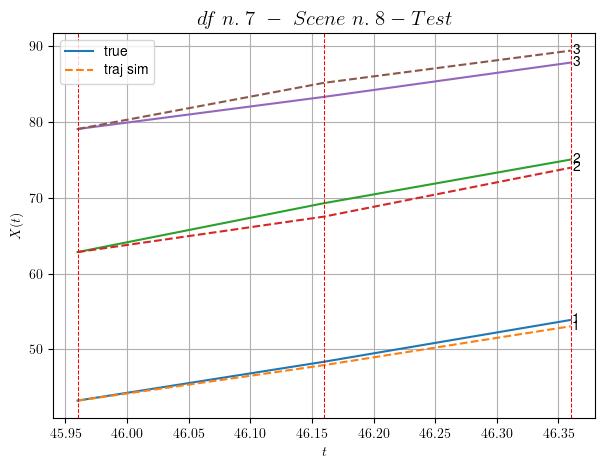

        For scene 8/27:
        * MSE = 1.2327080329016276
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/27


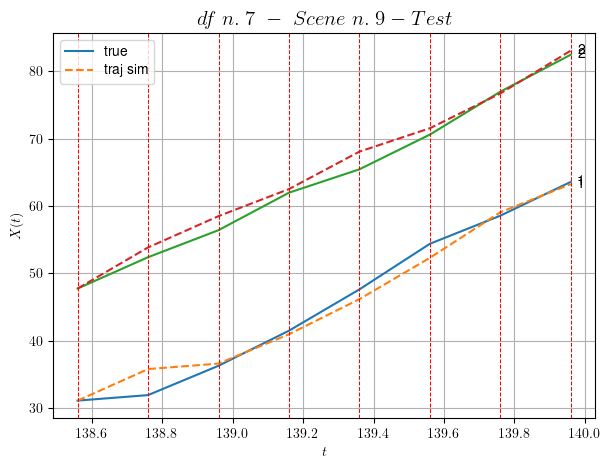

        For scene 9/27:
        * MSE = 2.3177367998698912
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/27


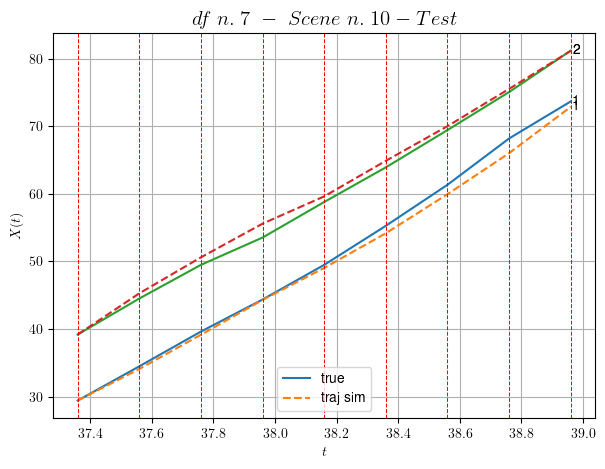

        For scene 10/27:
        * MSE = 0.9642597765641161
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.11/27


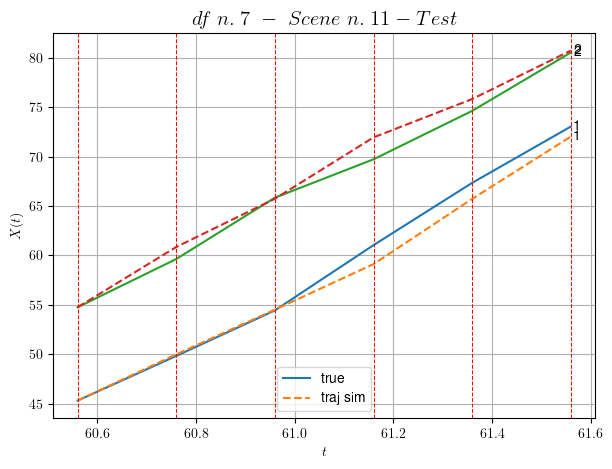

        For scene 11/27:
        * MSE = 1.2717075906189717
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.12/27


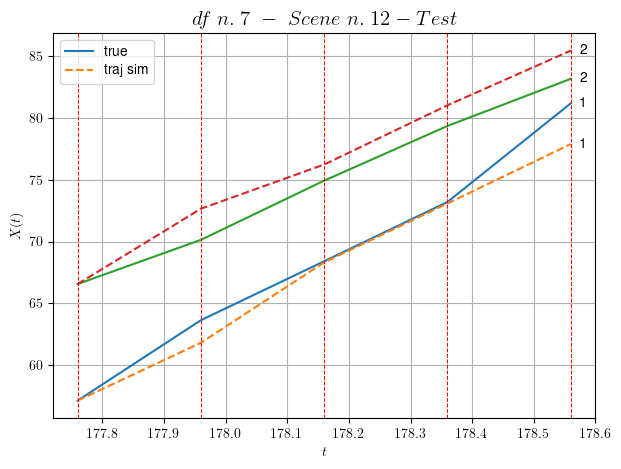

        For scene 12/27:
        * MSE = 3.0302140843910994
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.13/27


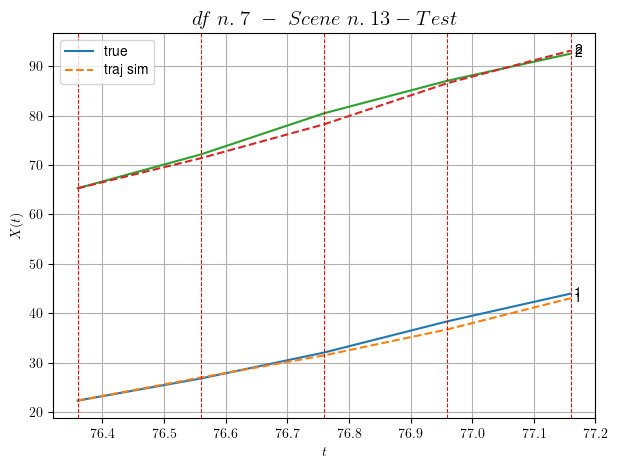

        For scene 13/27:
        * MSE = 1.008190113204893
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.14/27


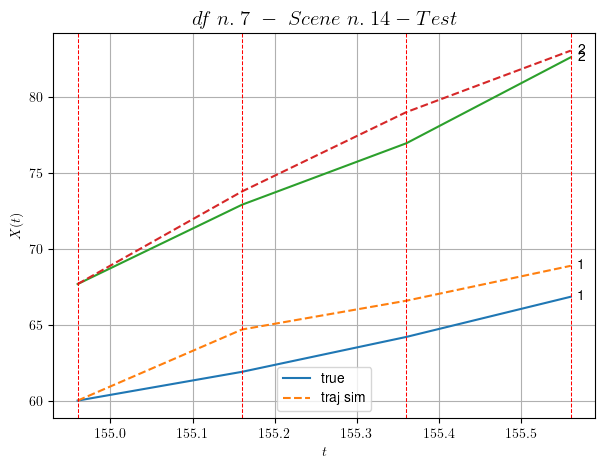

        For scene 14/27:
        * MSE = 2.84261025919158
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.15/27


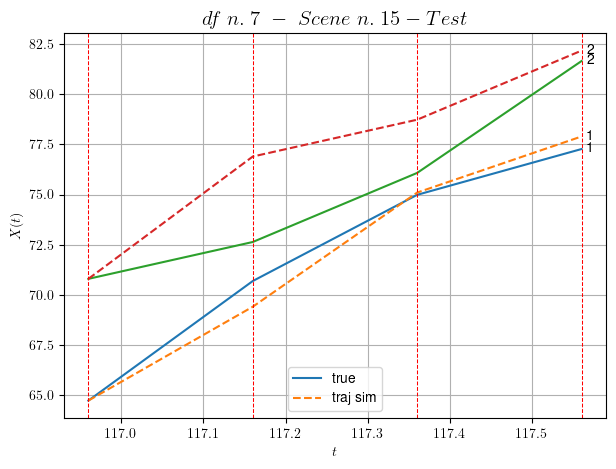

        For scene 15/27:
        * MSE = 3.4389323250957458
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.16/27


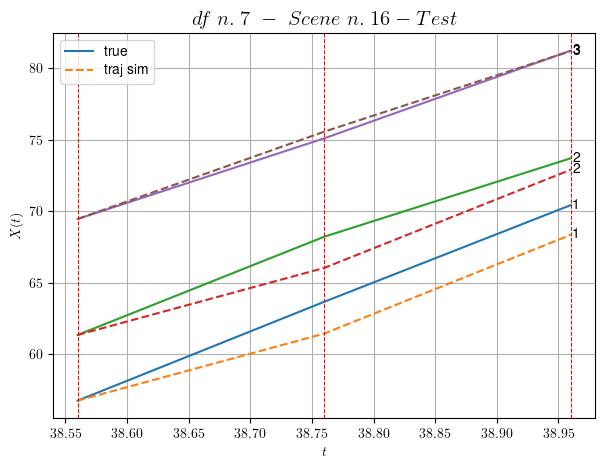

        For scene 16/27:
        * MSE = 1.6484403891153707
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.17/27


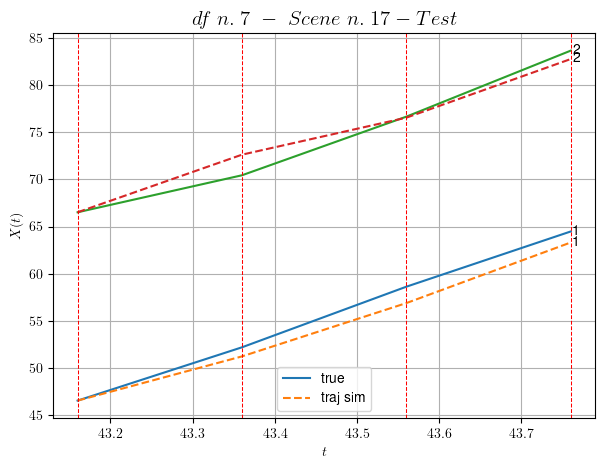

        For scene 17/27:
        * MSE = 1.3557297415603817
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.18/27


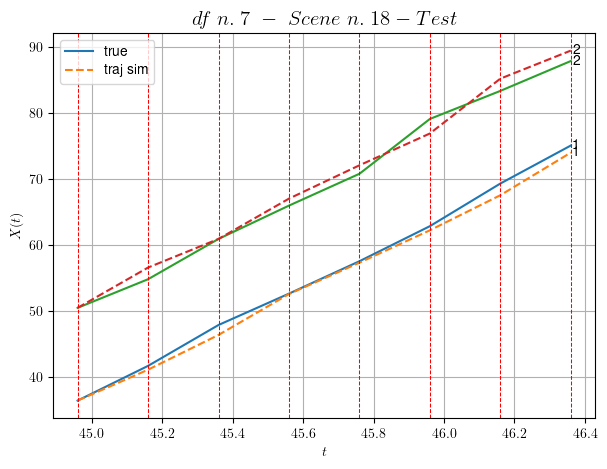

        For scene 18/27:
        * MSE = 1.4981806127463613
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.19/27


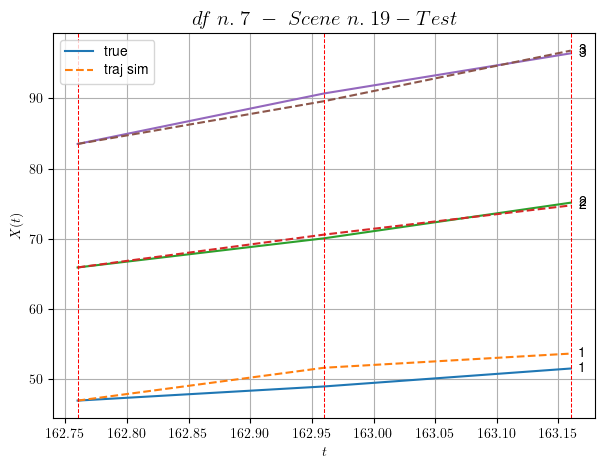

        For scene 19/27:
        * MSE = 1.489603262584904
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.20/27


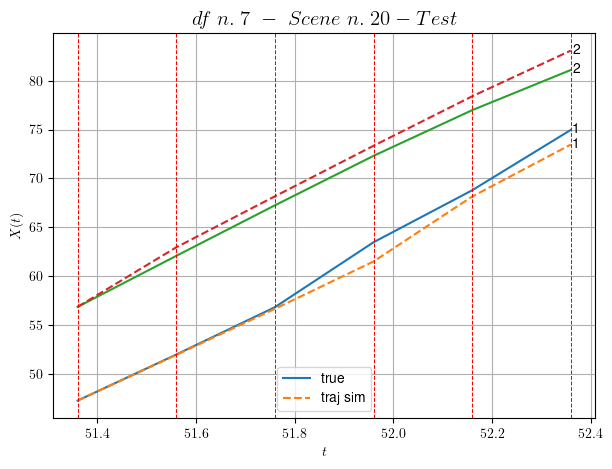

        For scene 20/27:
        * MSE = 1.2671495969491537
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.21/27


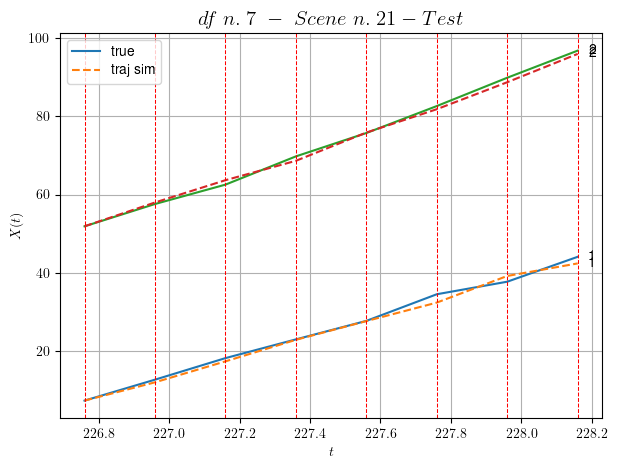

        For scene 21/27:
        * MSE = 1.0100939484785707
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.22/27


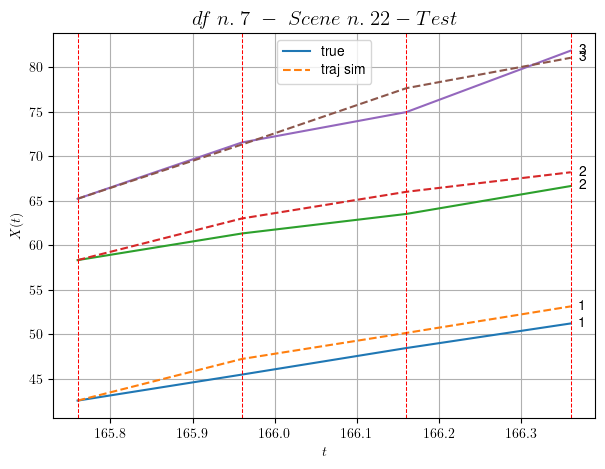

        For scene 22/27:
        * MSE = 2.4142754284337955
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.23/27


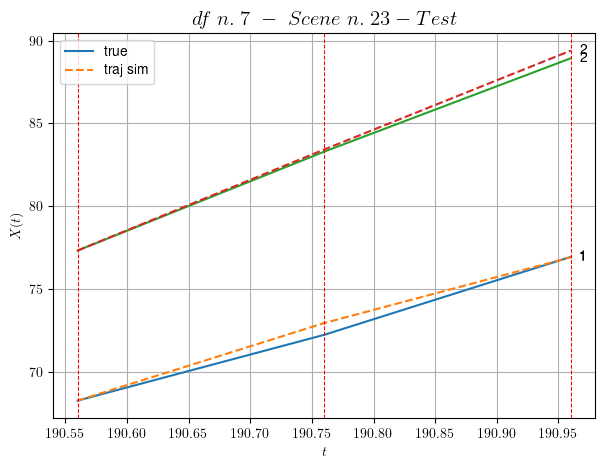

        For scene 23/27:
        * MSE = 0.12263466368334107
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.24/27


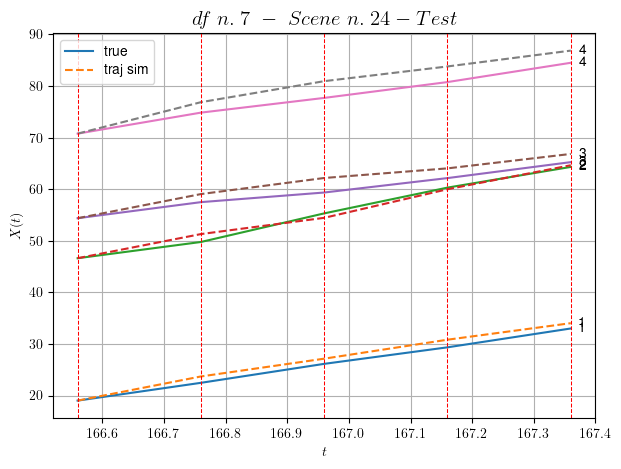

        For scene 24/27:
        * MSE = 2.743500908422361
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.25/27


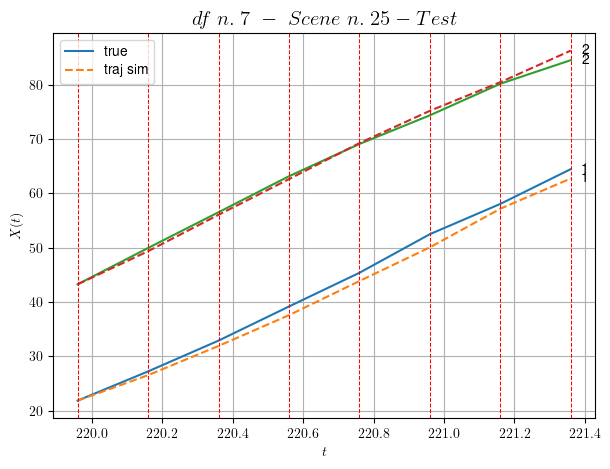

        For scene 25/27:
        * MSE = 1.2897267813458793
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.26/27


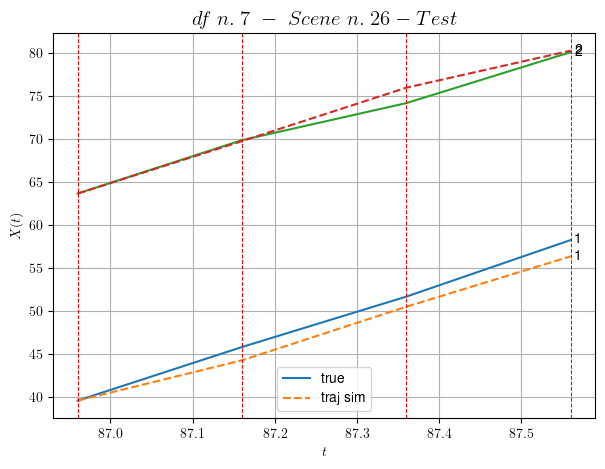

        For scene 26/27:
        * MSE = 1.3284260559305783
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.27/27


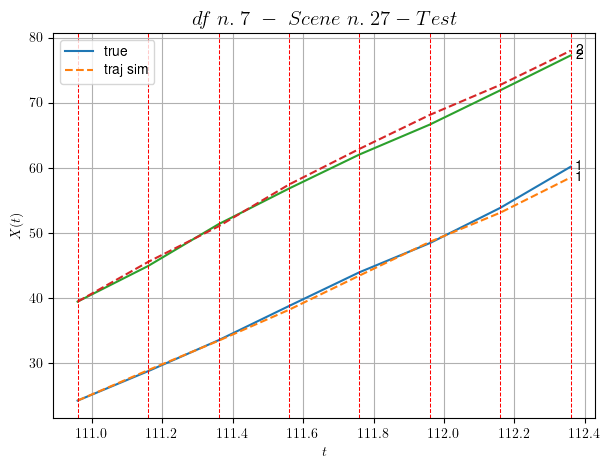

        For scene 27/27:
        * MSE = 0.5622152690078931
----------------------------------------------------------------------------------------------------


MSE test: 1.6224556050305117

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.13414614516615572
          * MSE test: 1.6224556050305117
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 8/10 dfs.
In DataFrame n.8 we have 79 scenes.
    To train the model we use 7 scenes, the remaining 72 to test the model.

Training step. (7 scenes)
DataFrame n.8. Scene n.1/7
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [48.04,48.84]


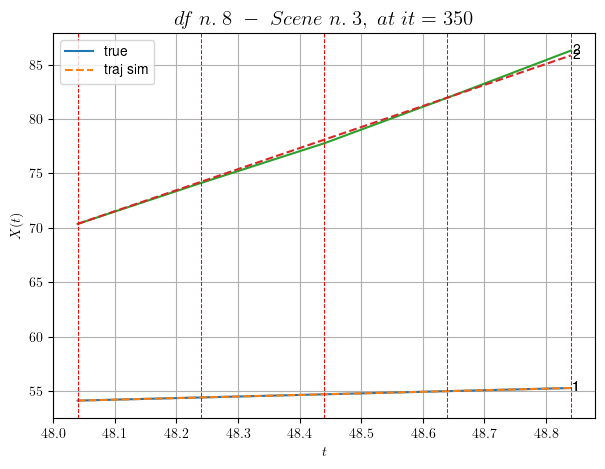

----------------------------------------------------------------------------------------------------
        For scene 1/7:
        * After LR finder: LR_NN=0.01 with mse=13.178657582797873 at it=24
        * v0 = 19.366199429857964
        * MSE = 0.028877281333050252
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/7
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [283.84,285.04]


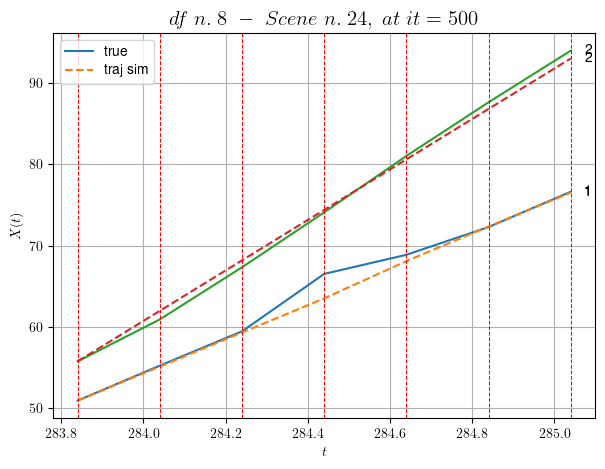

----------------------------------------------------------------------------------------------------
        For scene 2/7:
        * After LR finder: LR_NN=0.005 with mse=1.6512816803147041 at it=24
        * v0 = 31.024373752742626
        * MSE = 0.945085624680473
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/7
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [276.64,277.64]


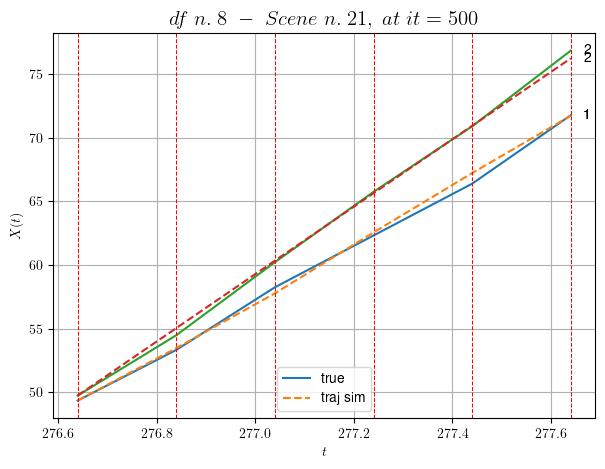

----------------------------------------------------------------------------------------------------
        For scene 3/7:
        * After LR finder: LR_NN=0.01 with mse=2.2213845774669645 at it=24
        * v0 = 26.490508846064337
        * MSE = 0.1372466172972055
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/7
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [102.24,103.04]


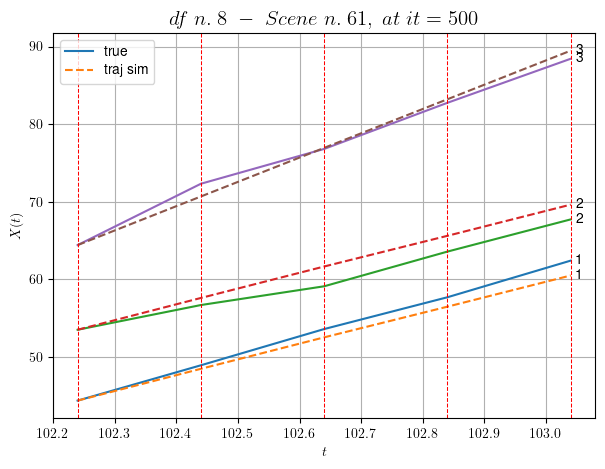

----------------------------------------------------------------------------------------------------
        For scene 4/7:
        * After LR finder: LR_NN=0.005 with mse=1.7243981445062753 at it=24
        * v0 = 31.34829198332158
        * MSE = 1.704106829066139
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/7
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [290.84,291.44]


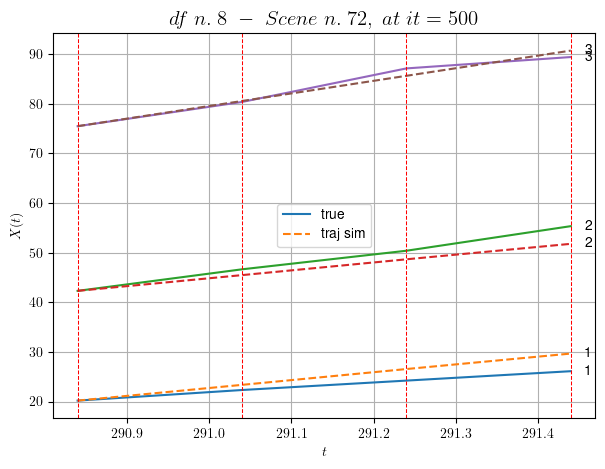

----------------------------------------------------------------------------------------------------
        For scene 5/7:
        * After LR finder: LR_NN=0.005 with mse=4.508380619871666 at it=24
        * v0 = 25.3782442797746
        * MSE = 3.3387562896590346
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/7
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [178.44,179.24]


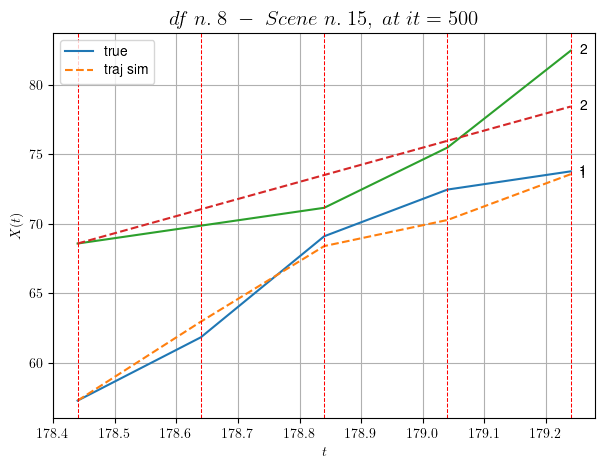

----------------------------------------------------------------------------------------------------
        For scene 6/7:
        * After LR finder: LR_NN=0.001 with mse=37.779976068642725 at it=24
        * v0 = 12.308982889931846
        * MSE = 2.9898226856473986
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/7
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [536.64,537.24]


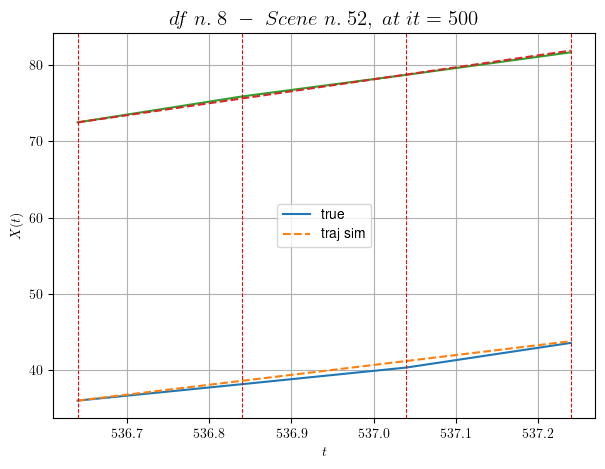

----------------------------------------------------------------------------------------------------
        For scene 7/7:
        * After LR finder: LR_NN=5e-05 with mse=14.770507401601265 at it=24
        * v0 = 15.68335488341726
        * MSE = 0.1370744894685422
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.3258528310216917
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (72 scenes)
DataFrame n.8. Scene n.1/72


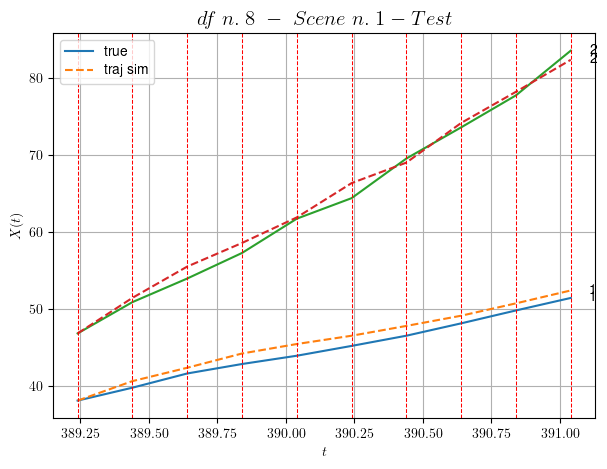

        For scene 1/72:
        * MSE = 1.1036508469962225
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/72


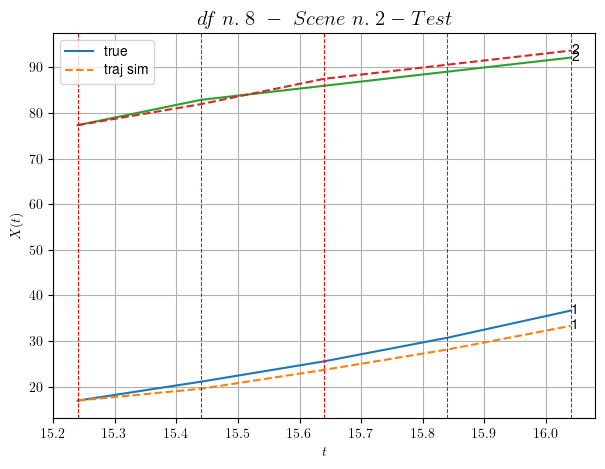

        For scene 2/72:
        * MSE = 3.1637934566122197
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/72


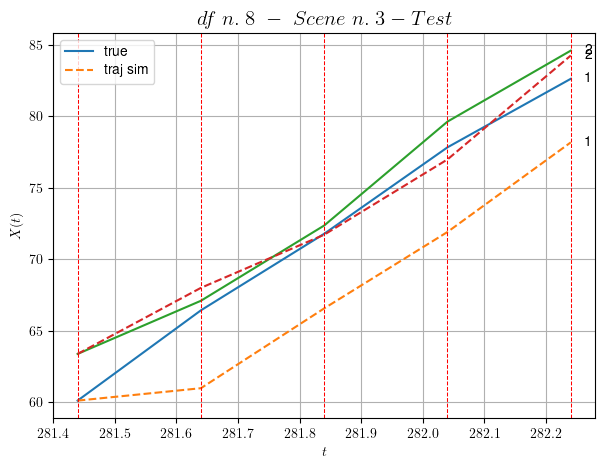

        For scene 3/72:
        * MSE = 11.98400481334595
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/72


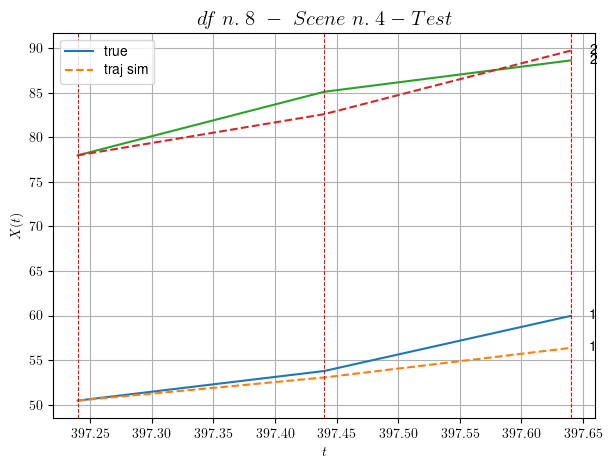

        For scene 4/72:
        * MSE = 3.4848961547926702
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/72


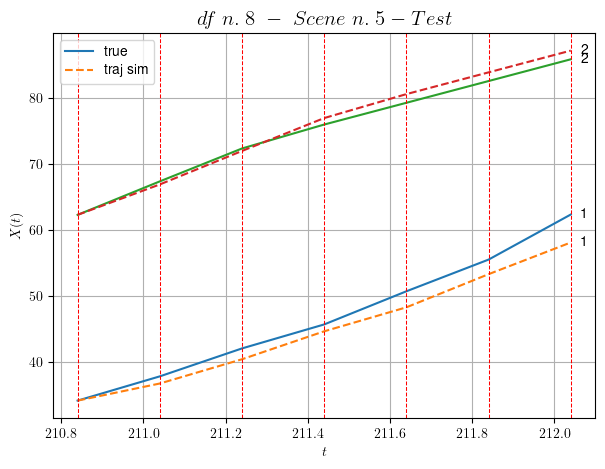

        For scene 5/72:
        * MSE = 2.881309284329815
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/72


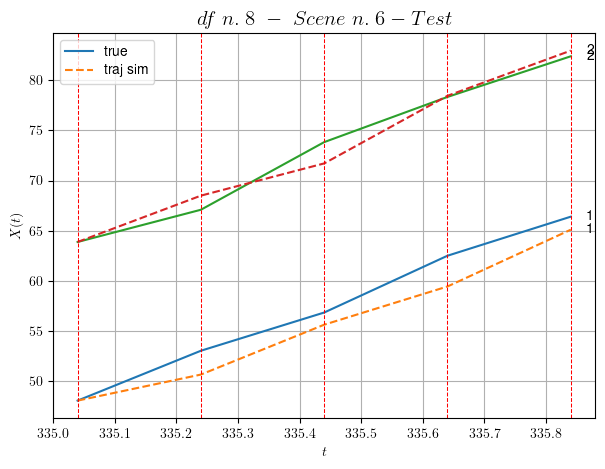

        For scene 6/72:
        * MSE = 2.4988327524292986
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/72


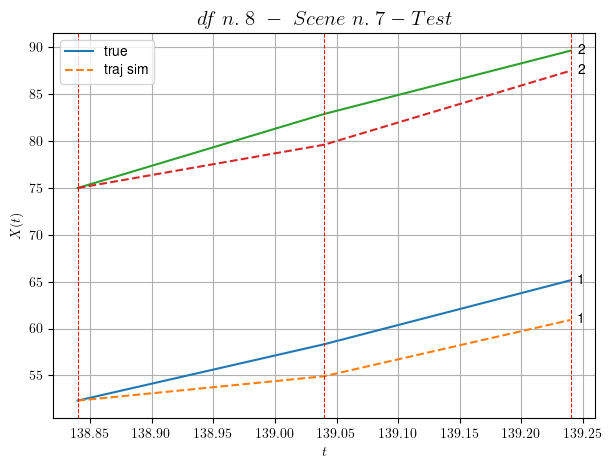

        For scene 7/72:
        * MSE = 7.456395172951487
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/72


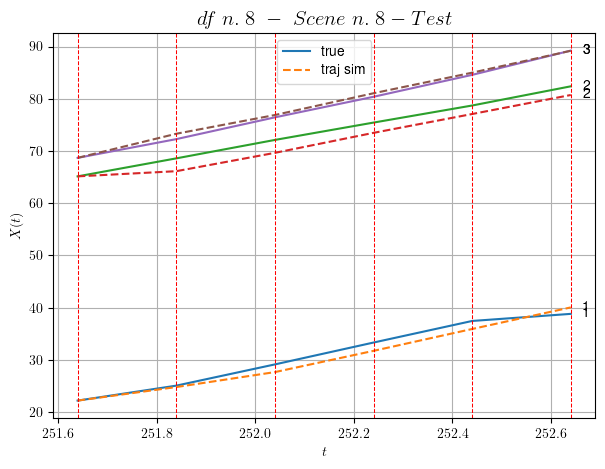

        For scene 8/72:
        * MSE = 1.776296294198392
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/72


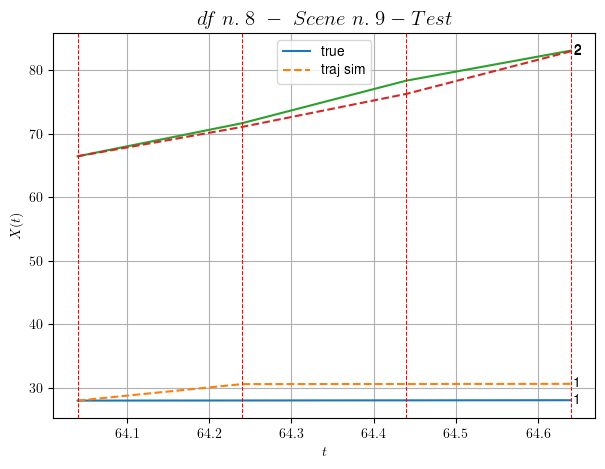

        For scene 9/72:
        * MSE = 3.073609942542517
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/72


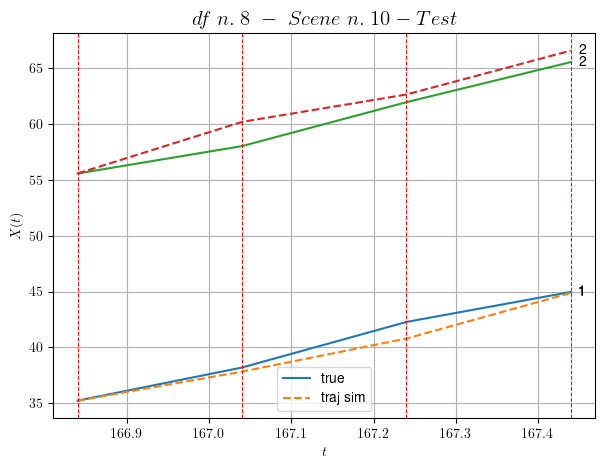

        For scene 10/72:
        * MSE = 1.0706966789244539
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/72


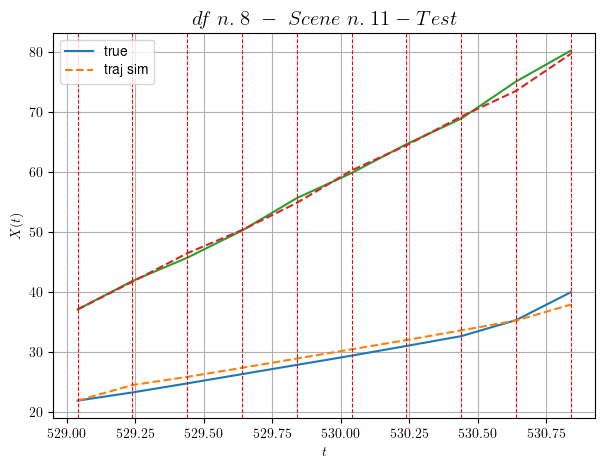

        For scene 11/72:
        * MSE = 0.8220400535108315
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/72


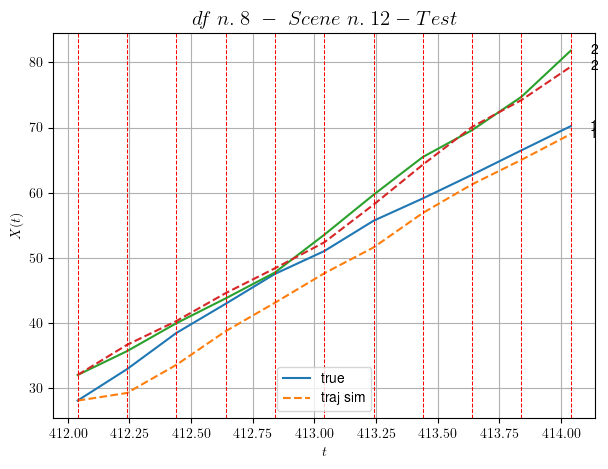

        For scene 12/72:
        * MSE = 5.783907575215818
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/72


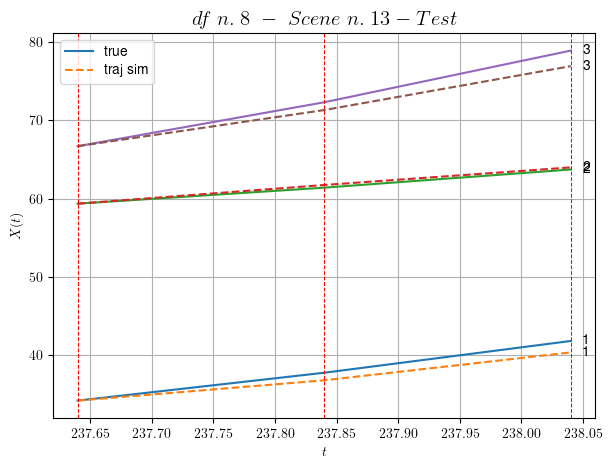

        For scene 13/72:
        * MSE = 0.9085128920031758
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/72


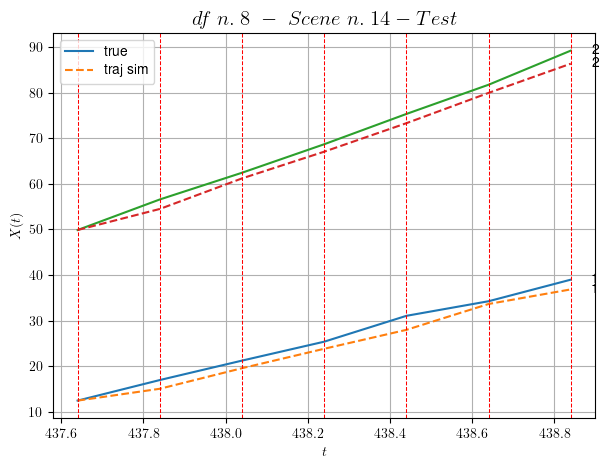

        For scene 14/72:
        * MSE = 3.376680719963698
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/72


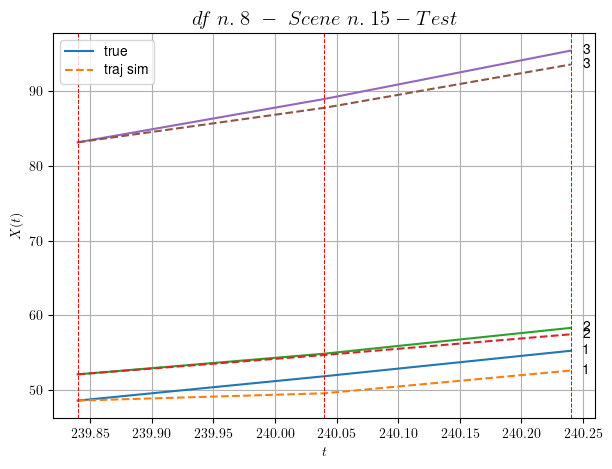

        For scene 15/72:
        * MSE = 1.9841745500274215
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/72


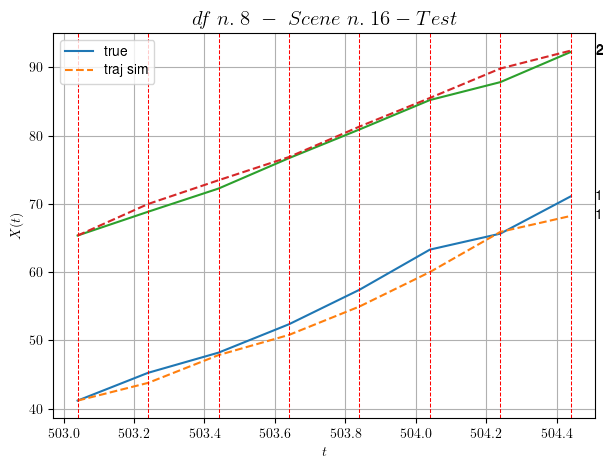

        For scene 16/72:
        * MSE = 2.3100619611252635
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/72


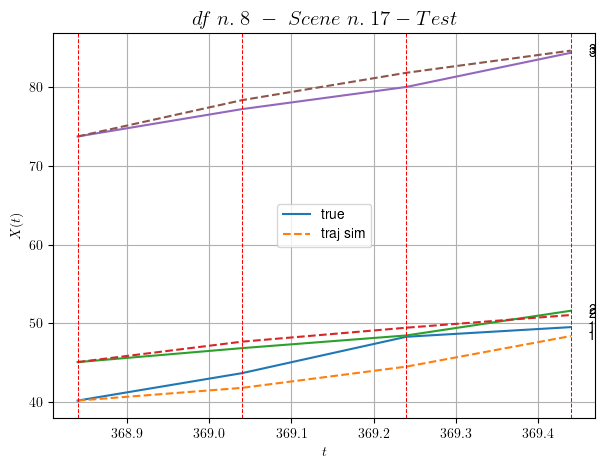

        For scene 17/72:
        * MSE = 2.1440518397816297
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/72


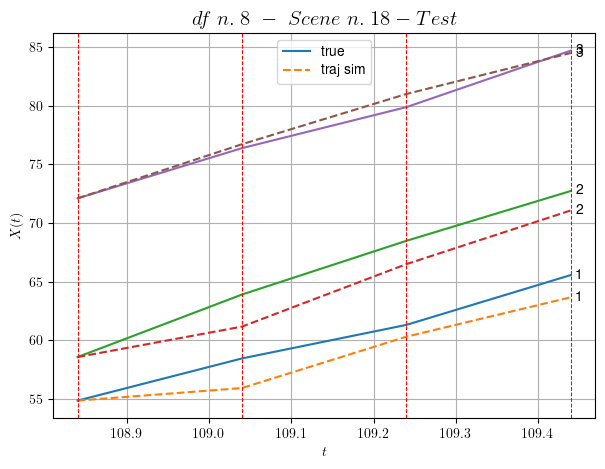

        For scene 18/72:
        * MSE = 2.213448392474785
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/72


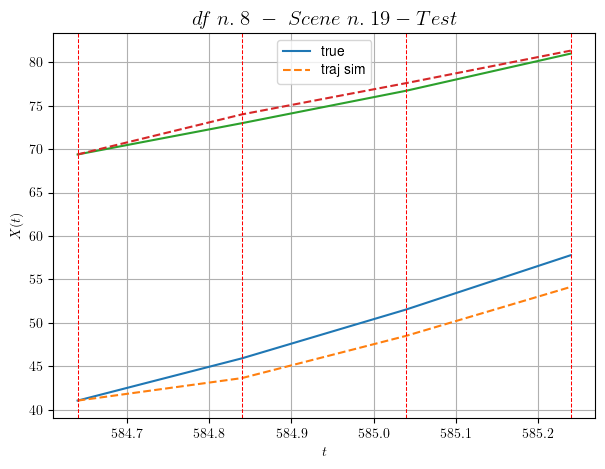

        For scene 19/72:
        * MSE = 3.7069175085782886
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/72


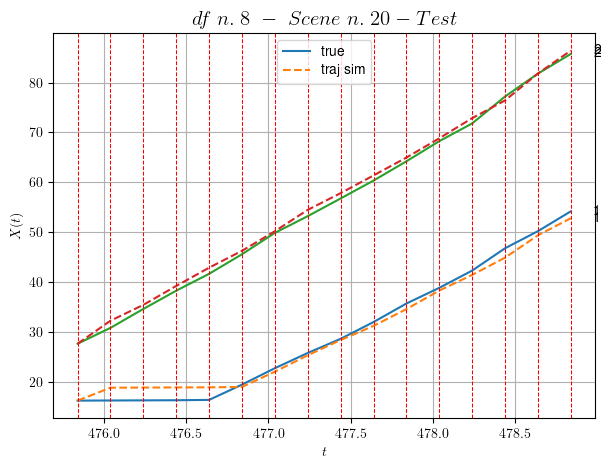

        For scene 20/72:
        * MSE = 1.5258649860558013
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/72


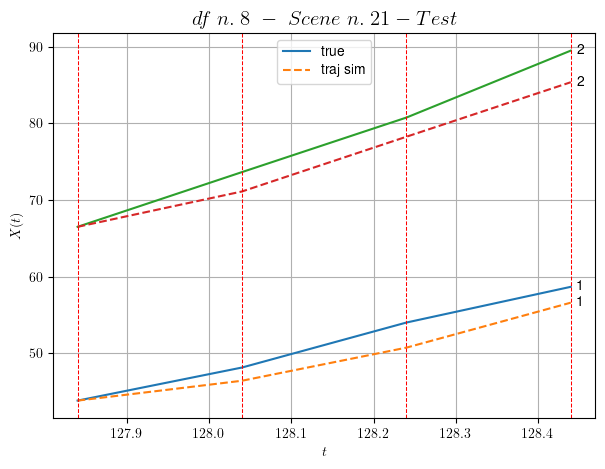

        For scene 21/72:
        * MSE = 5.966591401596681
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/72


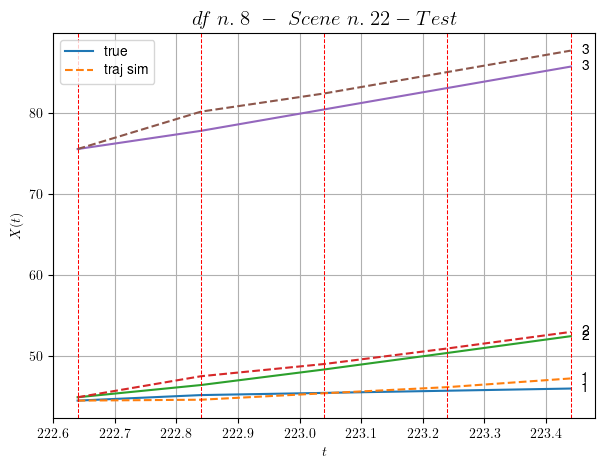

        For scene 22/72:
        * MSE = 1.4390800959837353
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/72


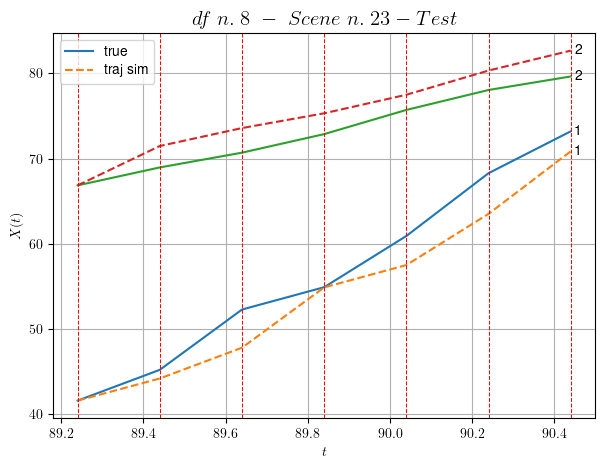

        For scene 23/72:
        * MSE = 7.074235662547222
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/72


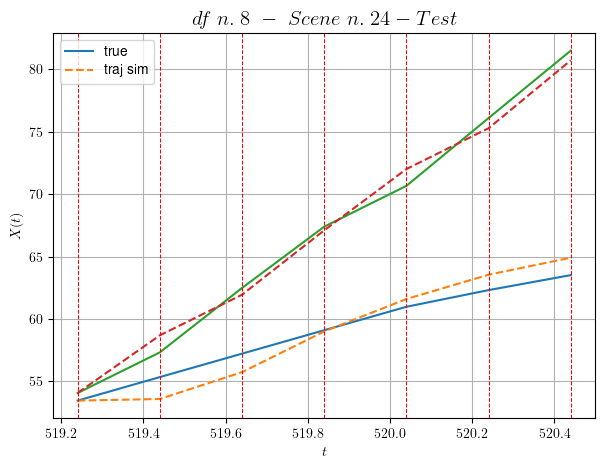

        For scene 24/72:
        * MSE = 1.0325641200748272
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/72


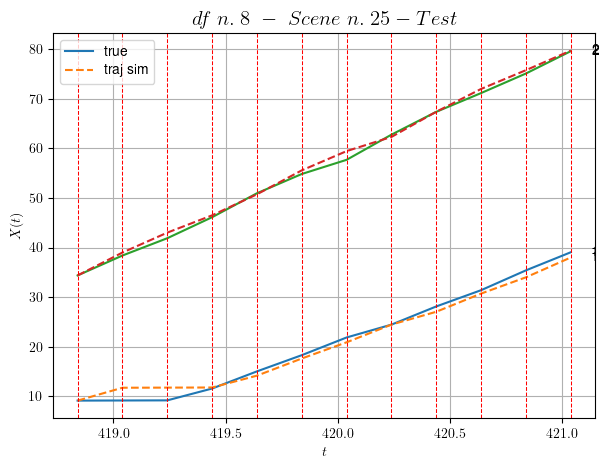

        For scene 25/72:
        * MSE = 1.12213134349842
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/72


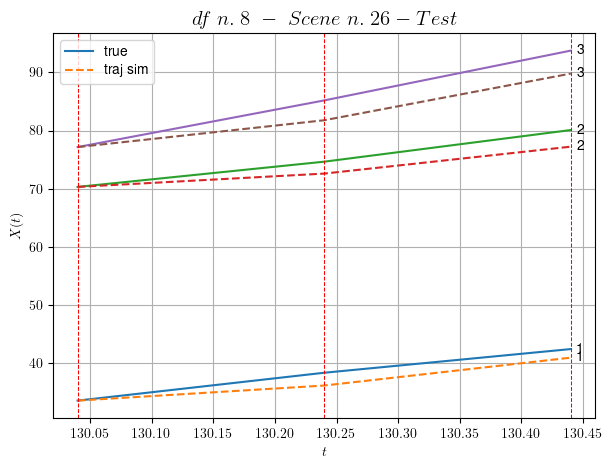

        For scene 26/72:
        * MSE = 5.190956445781319
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/72


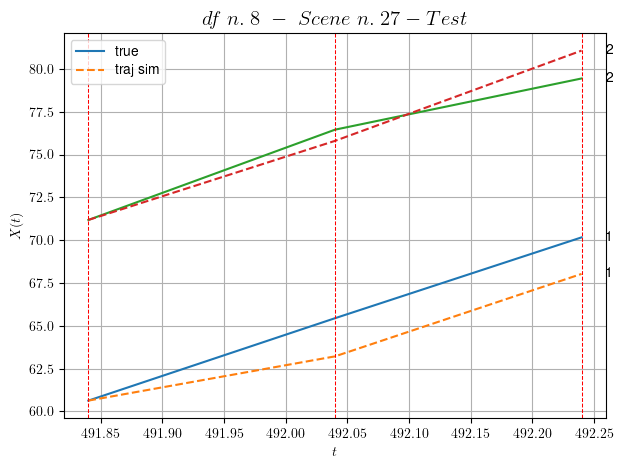

        For scene 27/72:
        * MSE = 2.0979368246276175
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.28/72


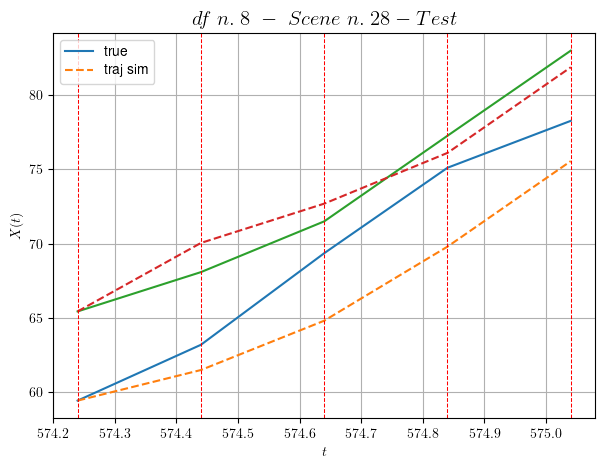

        For scene 28/72:
        * MSE = 6.7165043236299375
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.29/72


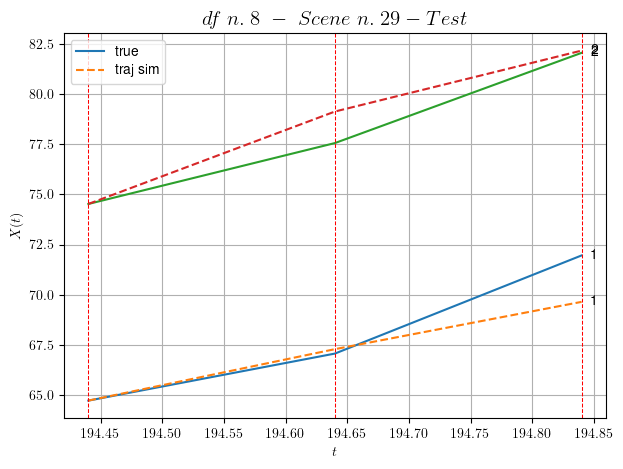

        For scene 29/72:
        * MSE = 1.319275765180656
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.30/72


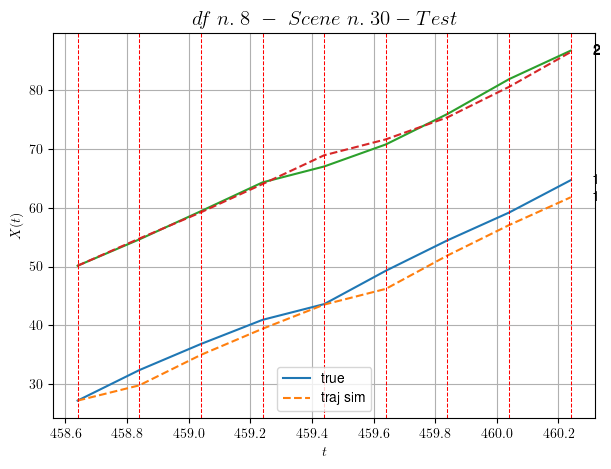

        For scene 30/72:
        * MSE = 2.686124190027482
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.31/72


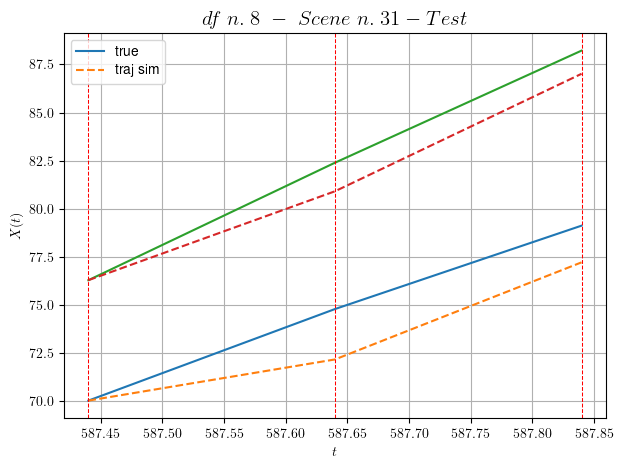

        For scene 31/72:
        * MSE = 2.355051429472097
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.32/72


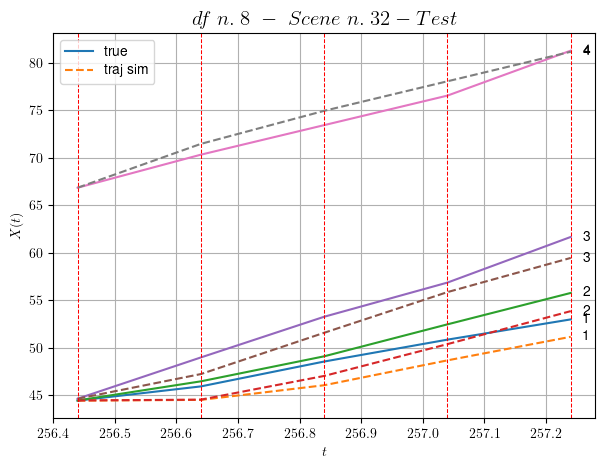

        For scene 32/72:
        * MSE = 2.5003568684195745
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.33/72


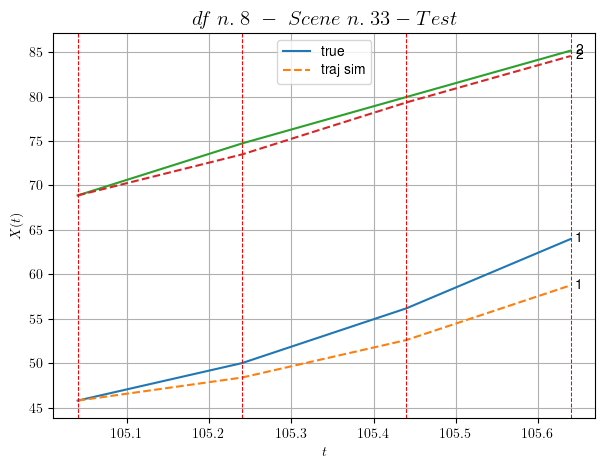

        For scene 33/72:
        * MSE = 5.597590342241455
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.34/72


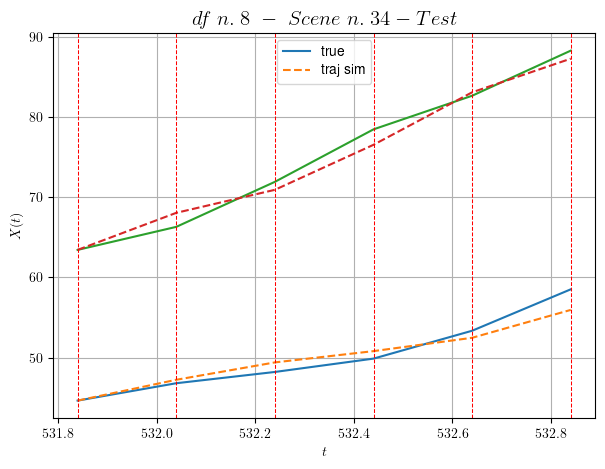

        For scene 34/72:
        * MSE = 1.563333297110542
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.35/72


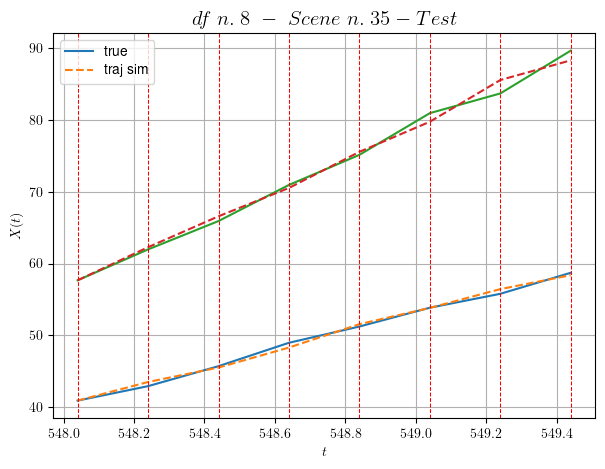

        For scene 35/72:
        * MSE = 0.570786993829521
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.36/72


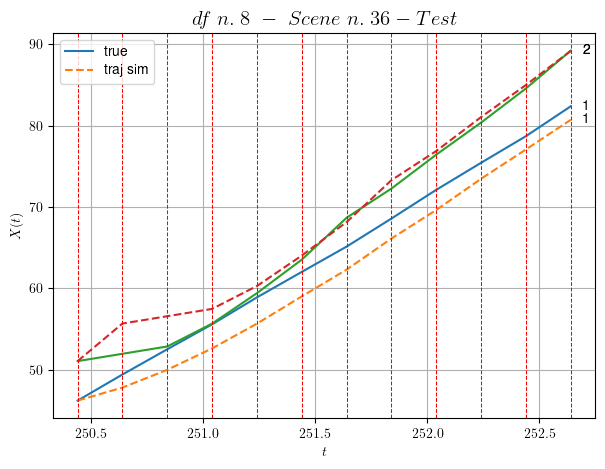

        For scene 36/72:
        * MSE = 4.1980816655345095
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.37/72


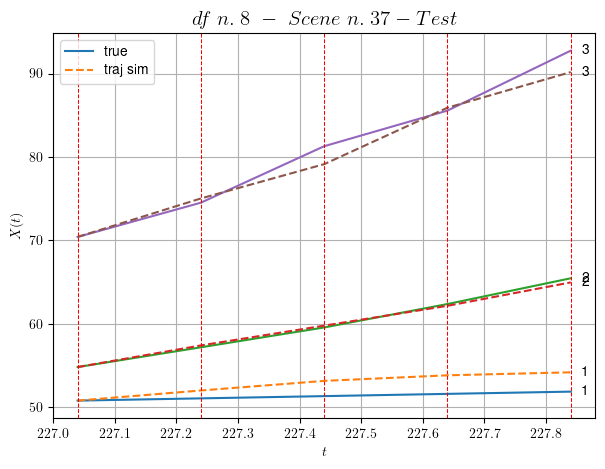

        For scene 37/72:
        * MSE = 1.7718296845617096
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.38/72


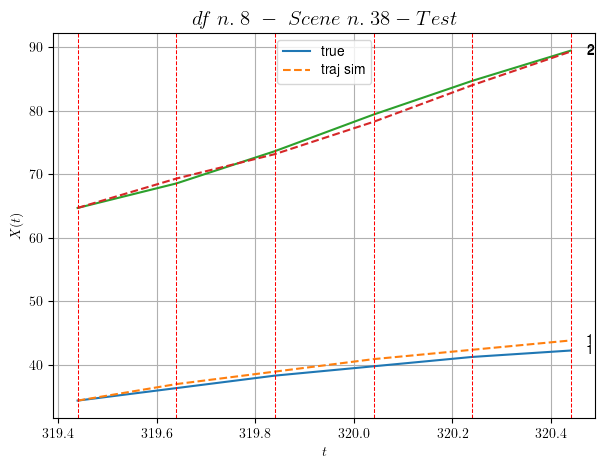

        For scene 38/72:
        * MSE = 0.7036533069636461
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.39/72


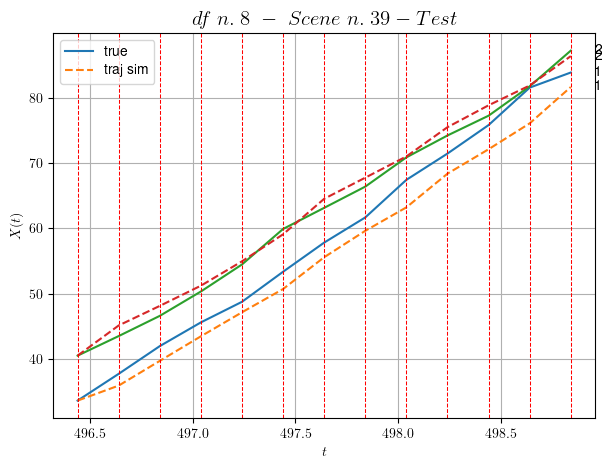

        For scene 39/72:
        * MSE = 4.719122723945065
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.40/72


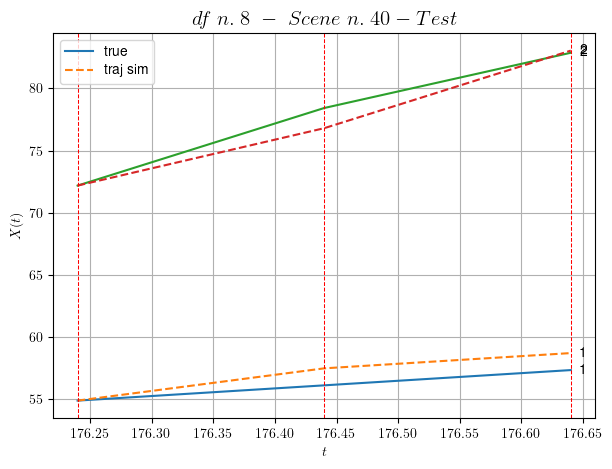

        For scene 40/72:
        * MSE = 1.0678701051159878
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.41/72


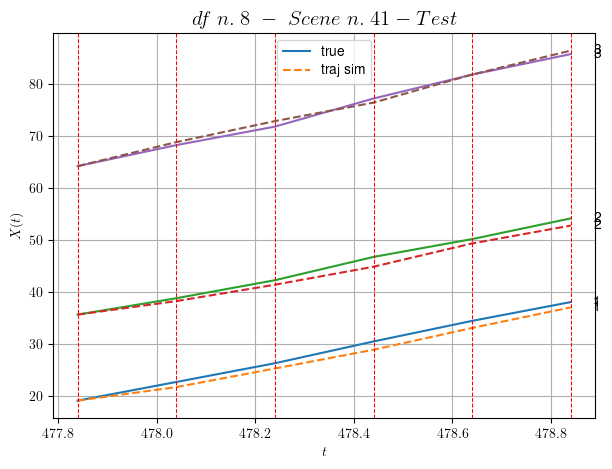

        For scene 41/72:
        * MSE = 0.953285034644401
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.42/72


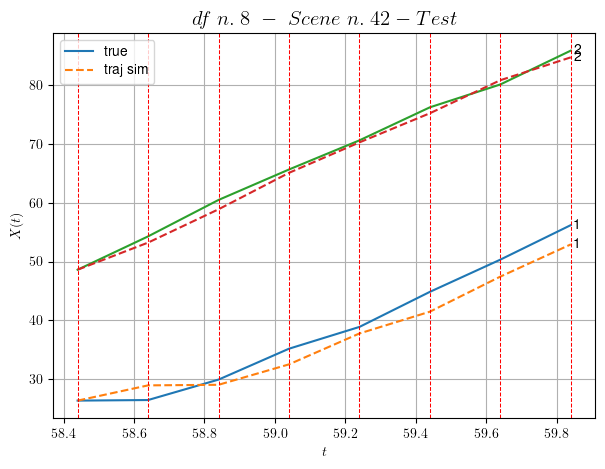

        For scene 42/72:
        * MSE = 3.305030026576257
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.43/72


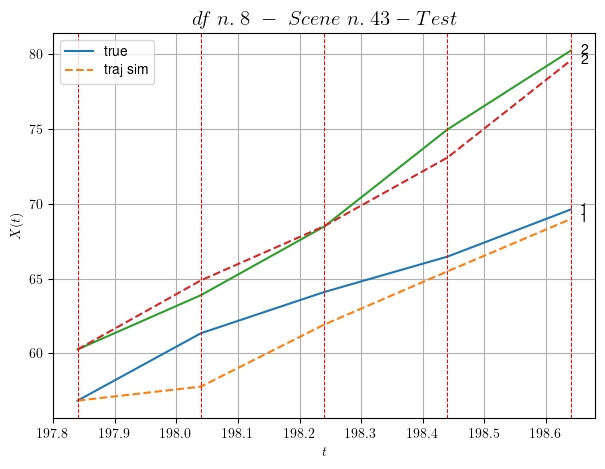

        For scene 43/72:
        * MSE = 2.3792666969214826
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.44/72


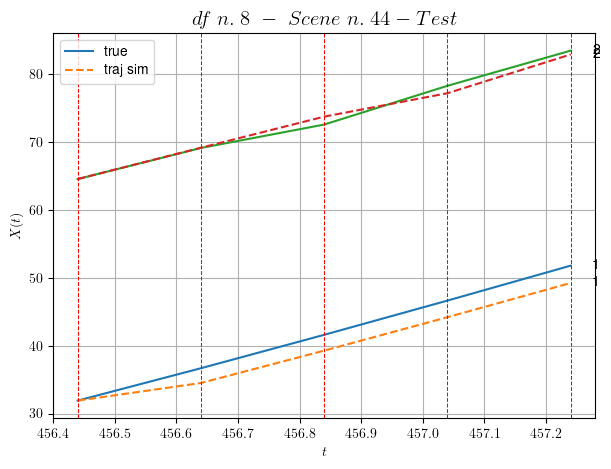

        For scene 44/72:
        * MSE = 2.5515080597478113
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.45/72


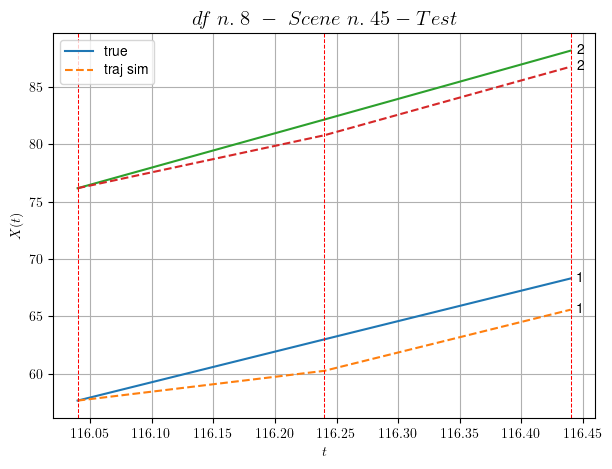

        For scene 45/72:
        * MSE = 3.1326908415204486
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.46/72


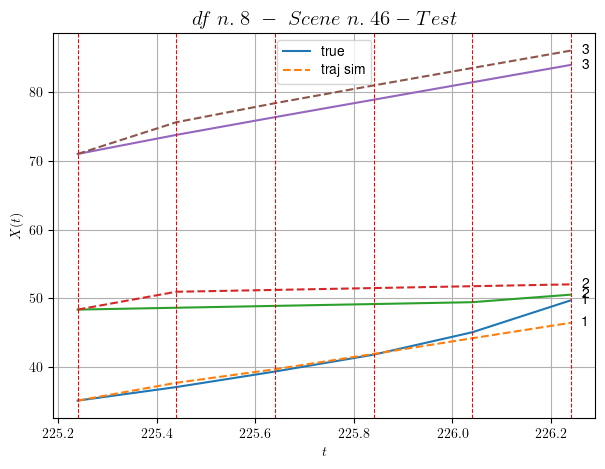

        For scene 46/72:
        * MSE = 3.130420422114327
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.47/72


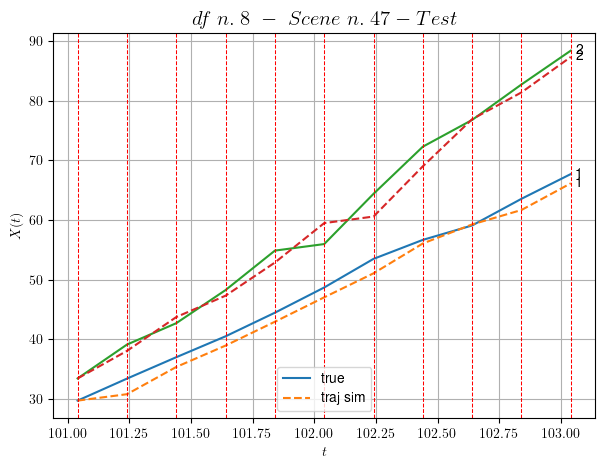

        For scene 47/72:
        * MSE = 3.497002241565685
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.48/72


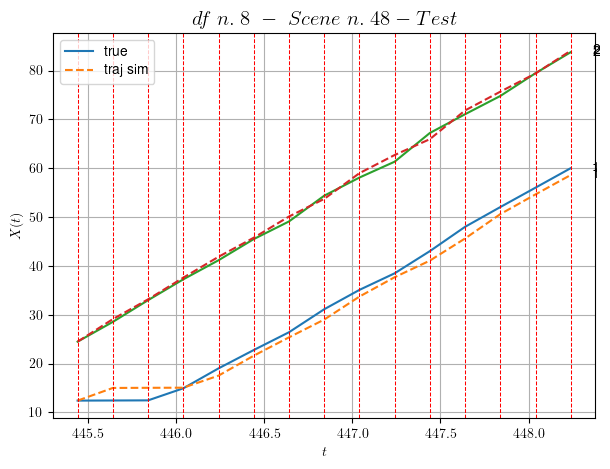

        For scene 48/72:
        * MSE = 1.6178283064377466
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.49/72


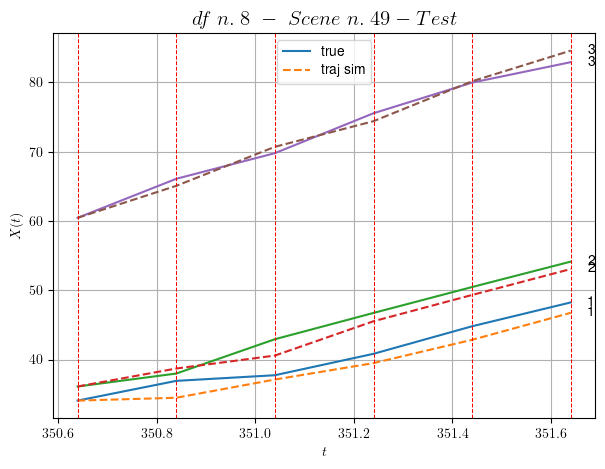

        For scene 49/72:
        * MSE = 1.677737599839671
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.50/72


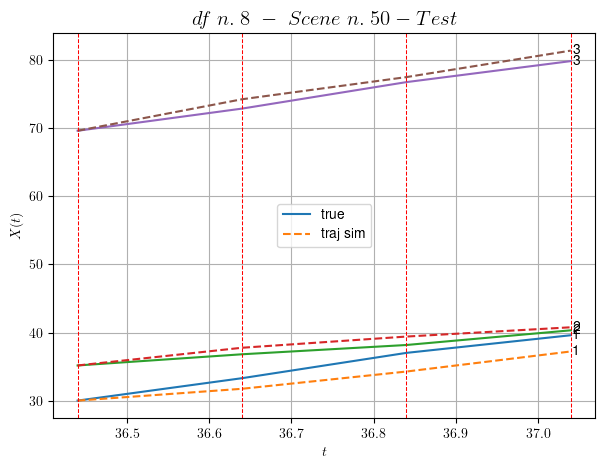

        For scene 50/72:
        * MSE = 1.913672040980205
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.51/72


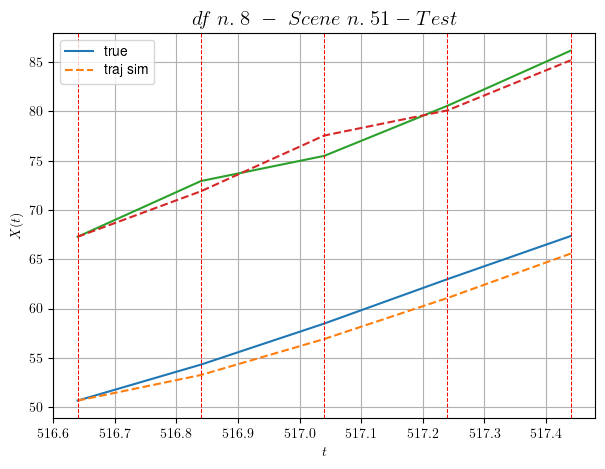

        For scene 51/72:
        * MSE = 1.6904409977780515
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.52/72


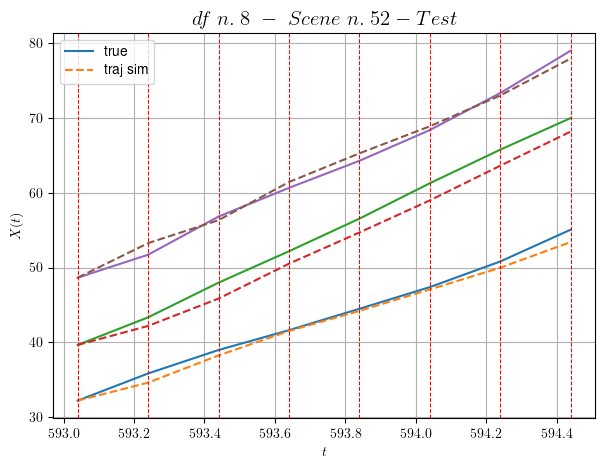

        For scene 52/72:
        * MSE = 1.5204111228526875
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.53/72


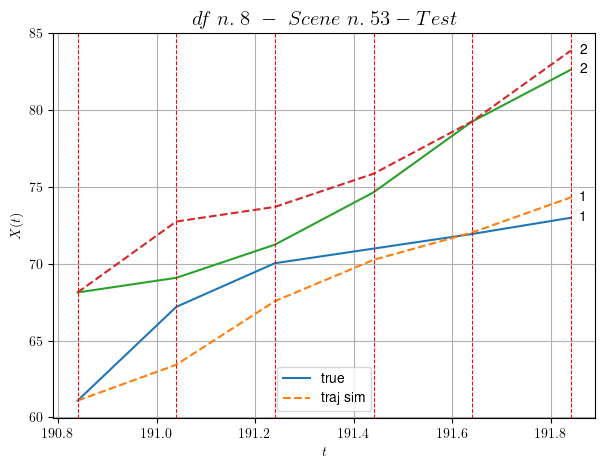

        For scene 53/72:
        * MSE = 3.7601643402981395
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.54/72


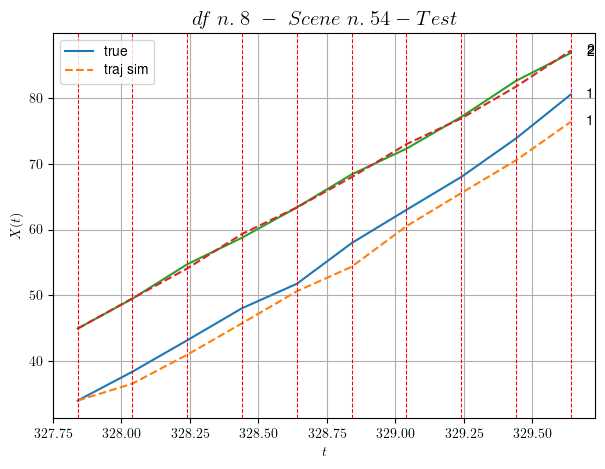

        For scene 54/72:
        * MSE = 3.5474707239983934
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.55/72


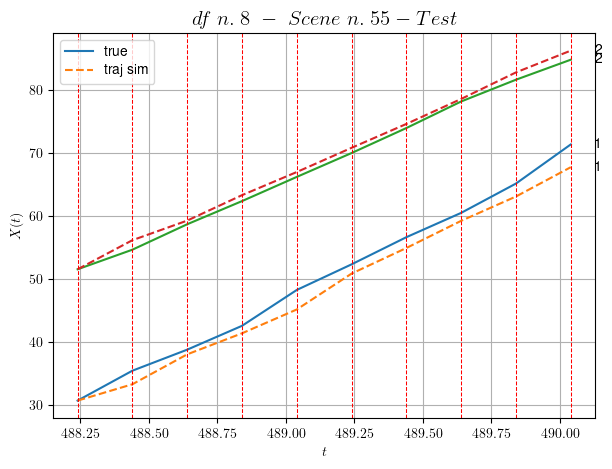

        For scene 55/72:
        * MSE = 2.449273069382689
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.56/72


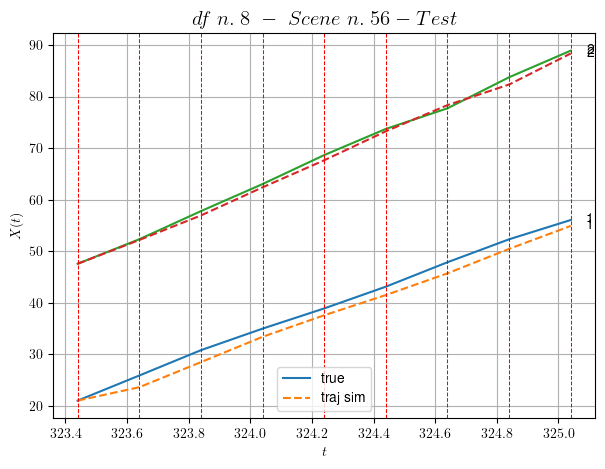

        For scene 56/72:
        * MSE = 1.7703202686761363
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.57/72


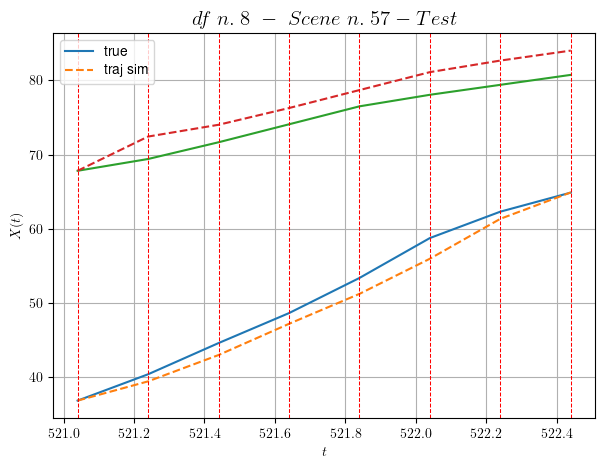

        For scene 57/72:
        * MSE = 4.629728783778595
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.58/72


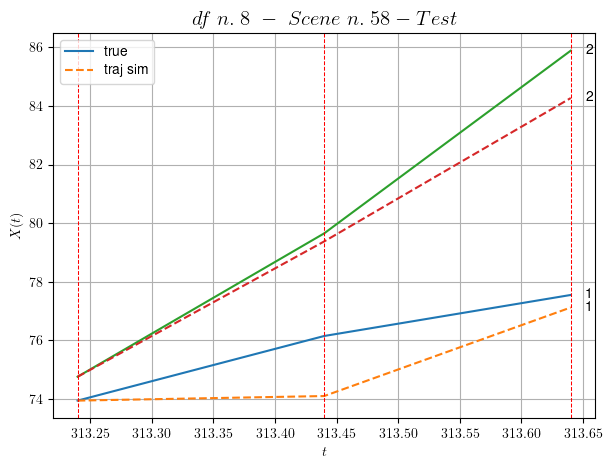

        For scene 58/72:
        * MSE = 1.178595015683876
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.59/72


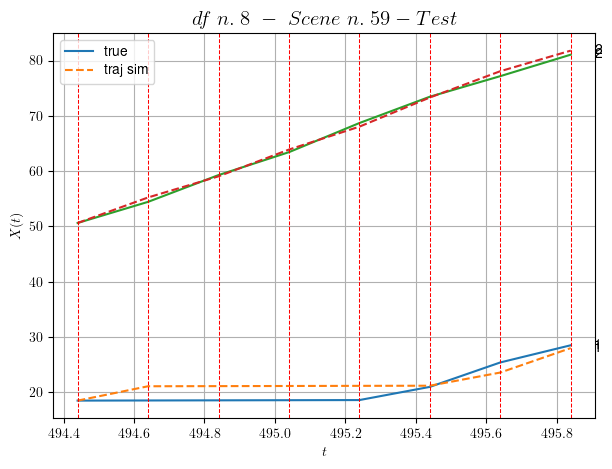

        For scene 59/72:
        * MSE = 2.0482979162915638
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.60/72


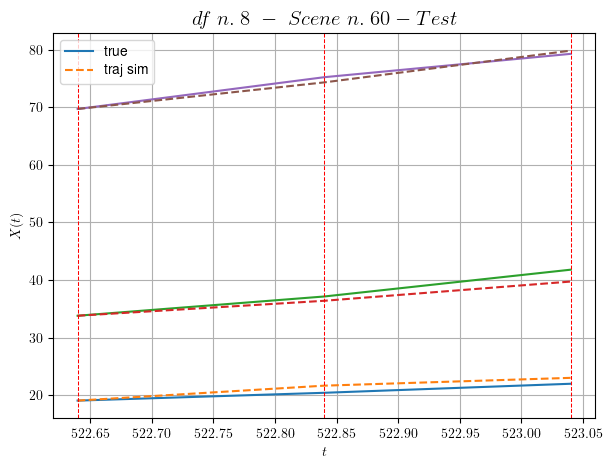

        For scene 60/72:
        * MSE = 0.9460853607082979
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.61/72


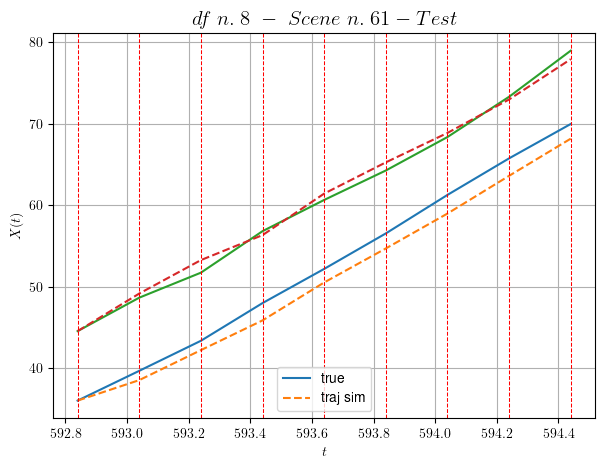

        For scene 61/72:
        * MSE = 1.7992821246681316
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.62/72


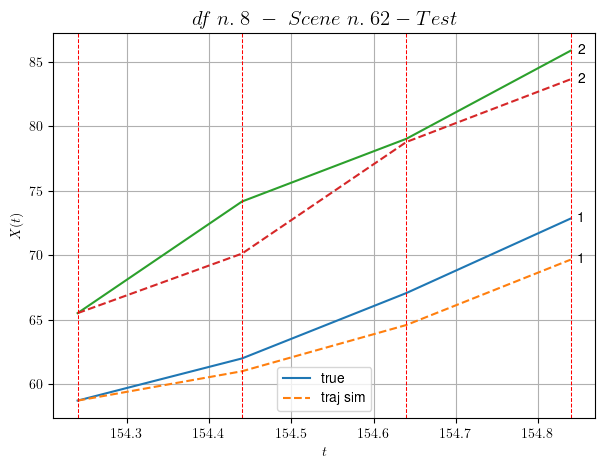

        For scene 62/72:
        * MSE = 4.821727965835935
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.63/72


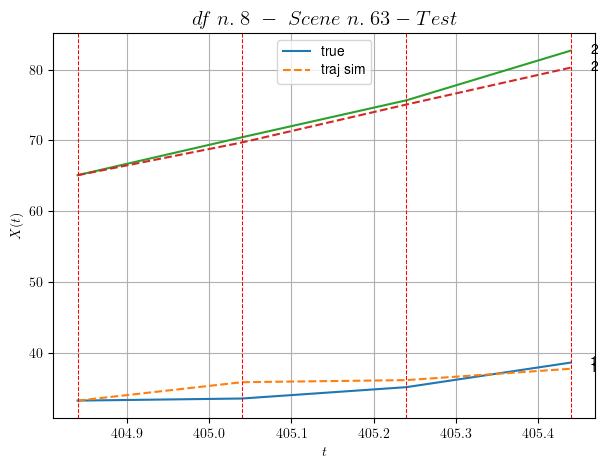

        For scene 63/72:
        * MSE = 1.7069437371806
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.64/72


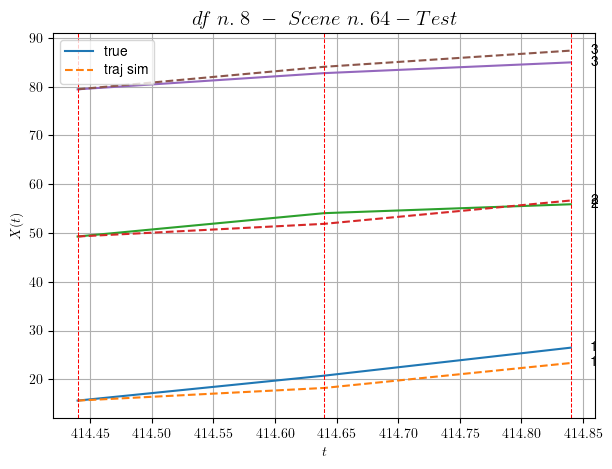

        For scene 64/72:
        * MSE = 3.2382501547559692
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.65/72


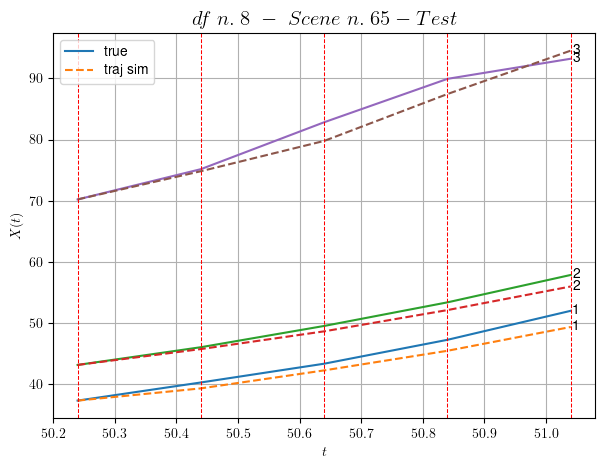

        For scene 65/72:
        * MSE = 2.381123200012285
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.66/72


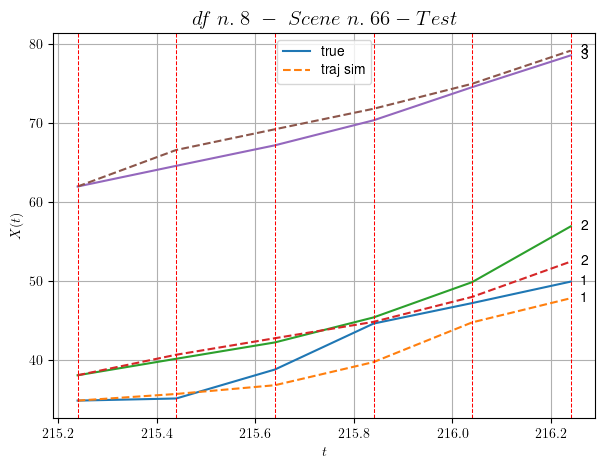

        For scene 66/72:
        * MSE = 4.069620564150138
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.67/72


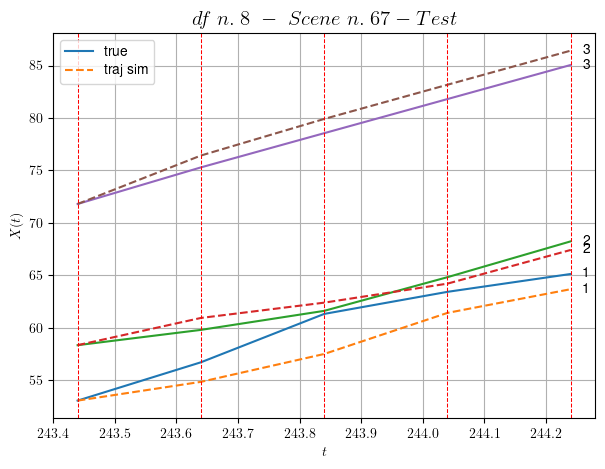

        For scene 67/72:
        * MSE = 2.2659169246316346
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.68/72


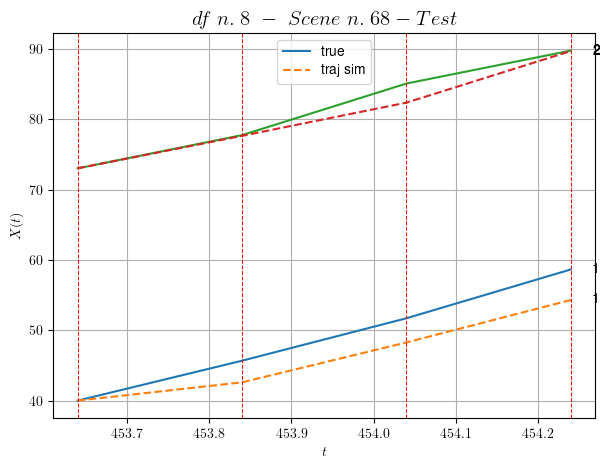

        For scene 68/72:
        * MSE = 5.935225306313035
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.69/72


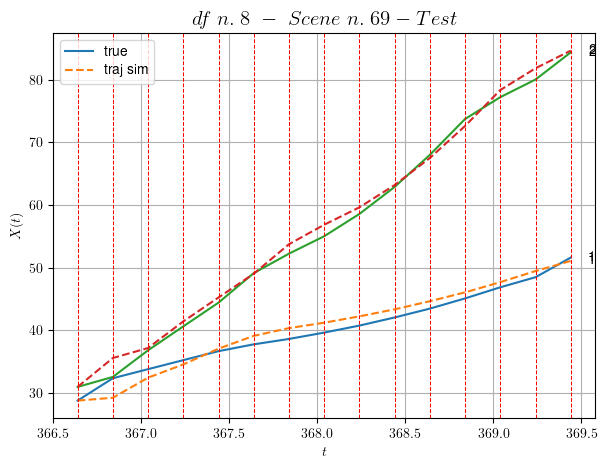

        For scene 69/72:
        * MSE = 1.705211958337223
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.70/72


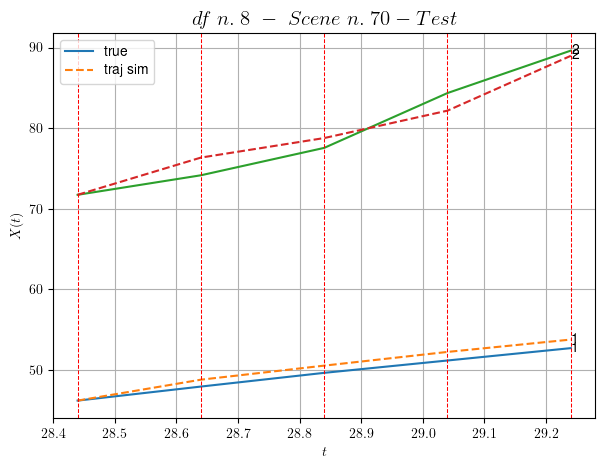

        For scene 70/72:
        * MSE = 1.5281594076431018
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.71/72


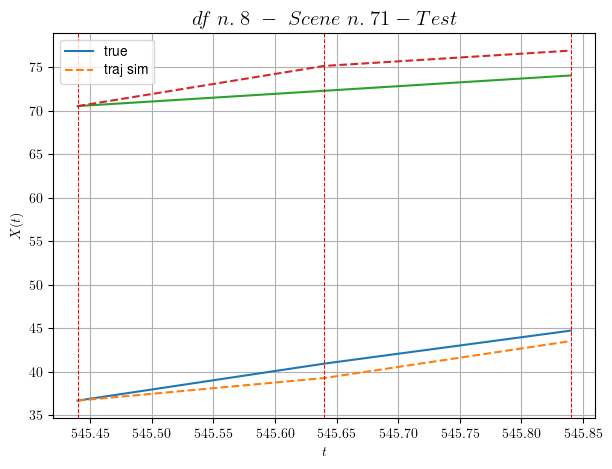

        For scene 71/72:
        * MSE = 3.415844072096357
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.72/72


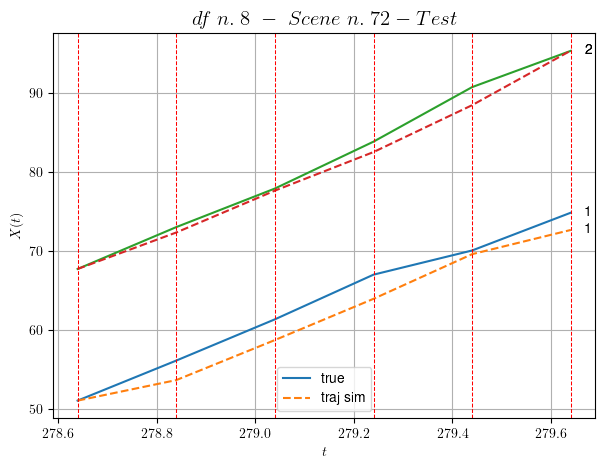

        For scene 72/72:
        * MSE = 2.902628833126175
----------------------------------------------------------------------------------------------------


MSE test: 2.8671025775631778

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.3258528310216917
          * MSE test: 2.8671025775631778
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 9/10 dfs.
In DataFrame n.9 we have 33 scenes.
    To train the model we use 3 scenes, the remaining 30 to test the model.

Training step. (3 scenes)
DataFrame n.9. Scene n.1/3
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [140.00,140.40]


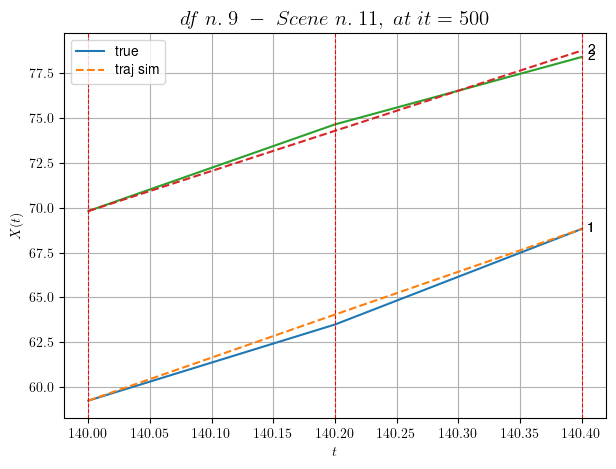

----------------------------------------------------------------------------------------------------
        For scene 1/3:
        * After LR finder: LR_NN=0.001 with mse=14.365787123554616 at it=24
        * v0 = 22.365188336411812
        * MSE = 0.09247206269973236
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/3
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [161.60,162.80]


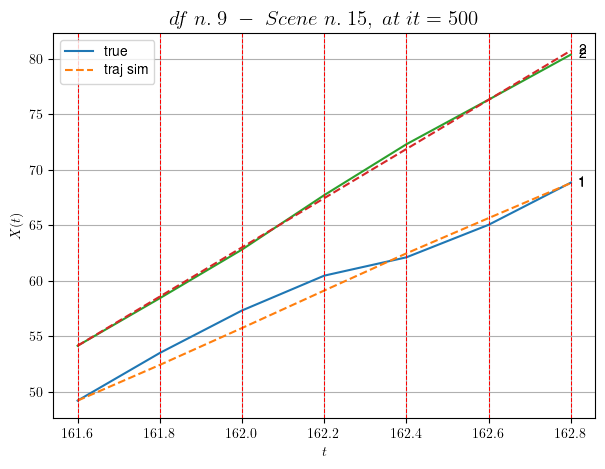

----------------------------------------------------------------------------------------------------
        For scene 2/3:
        * After LR finder: LR_NN=0.005 with mse=16.43418134126677 at it=24
        * v0 = 22.164023913692947
        * MSE = 0.44578258903743107
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/3
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [117.80,118.40]


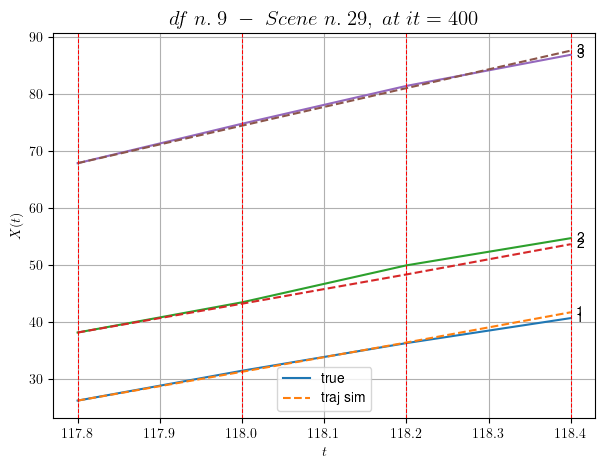

----------------------------------------------------------------------------------------------------
        For scene 3/3:
        * After LR finder: LR_NN=0.005 with mse=0.8030989296820957 at it=24
        * v0 = 32.94782183132021
        * MSE = 0.46189720838991377
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 0.33338395337569243
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (30 scenes)
DataFrame n.9. Scene n.1/30


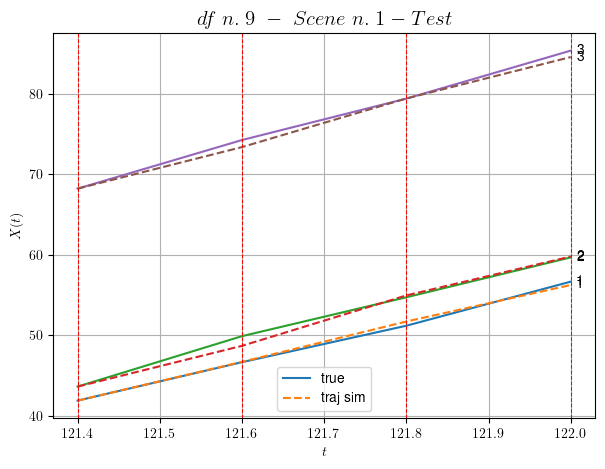

        For scene 1/30:
        * MSE = 0.2812836238596647
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/30


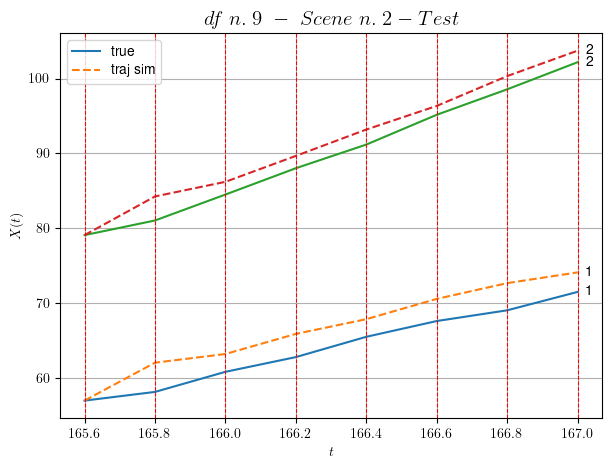

        For scene 2/30:
        * MSE = 5.724607398921493
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/30


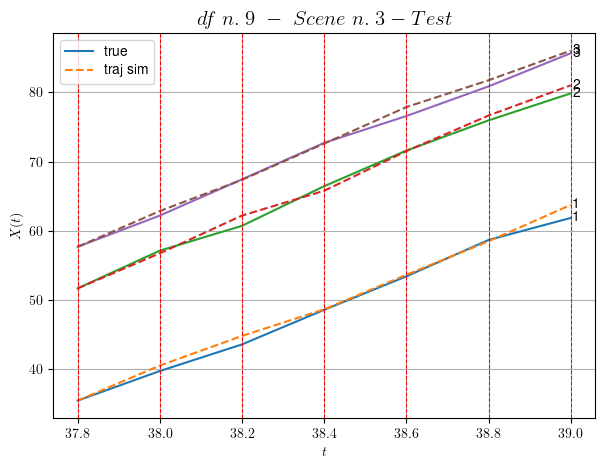

        For scene 3/30:
        * MSE = 0.6384916458531182
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/30


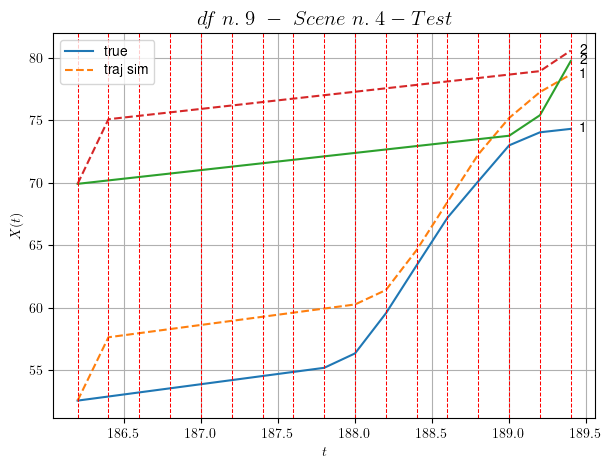

        For scene 4/30:
        * MSE = 17.2955061123041
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/30


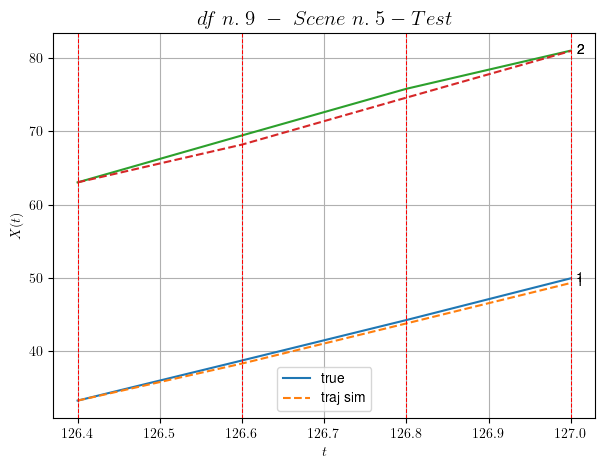

        For scene 5/30:
        * MSE = 0.47803343405126264
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/30


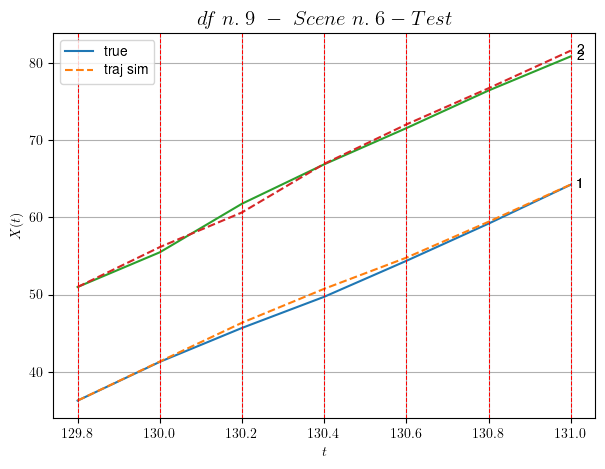

        For scene 6/30:
        * MSE = 0.3097185247414556
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/30


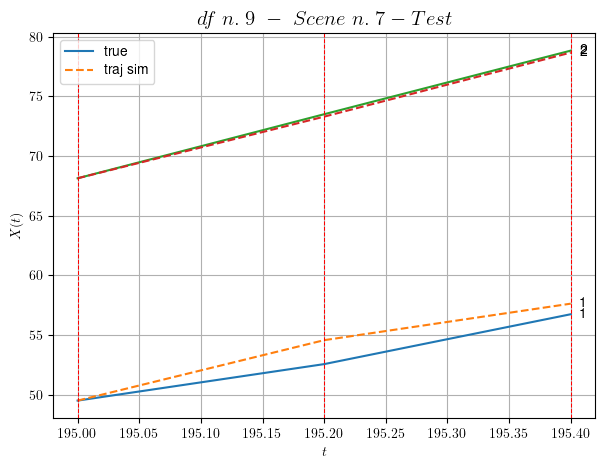

        For scene 7/30:
        * MSE = 0.8127015645448767
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/30


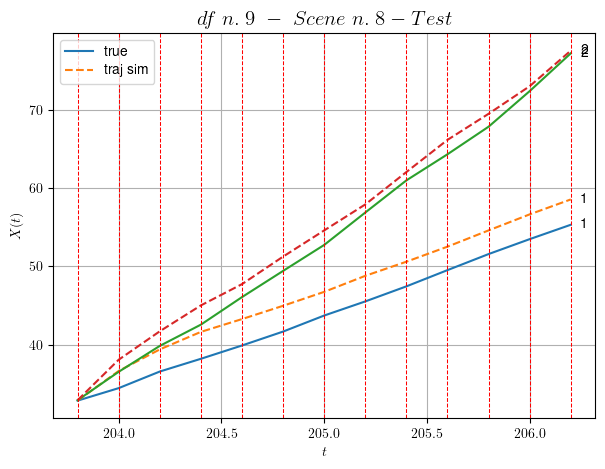

        For scene 8/30:
        * MSE = 5.577432396579612
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/30


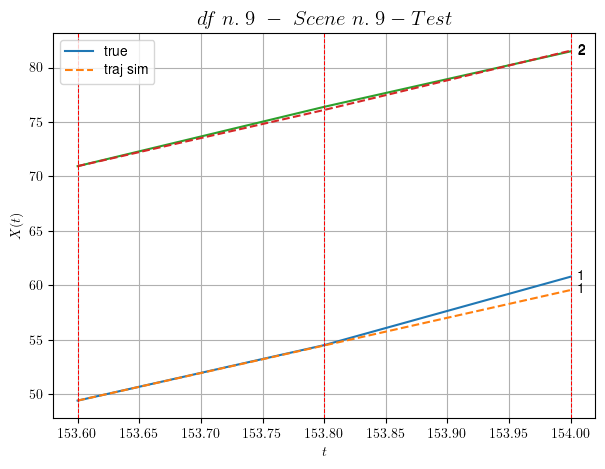

        For scene 9/30:
        * MSE = 0.2651376728064698
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/30


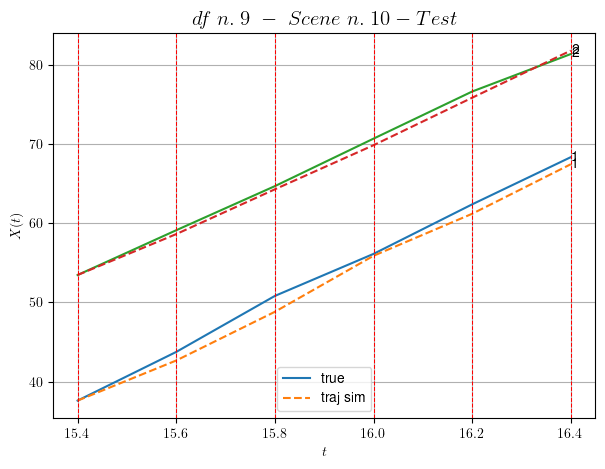

        For scene 10/30:
        * MSE = 0.7775116677730122
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/30


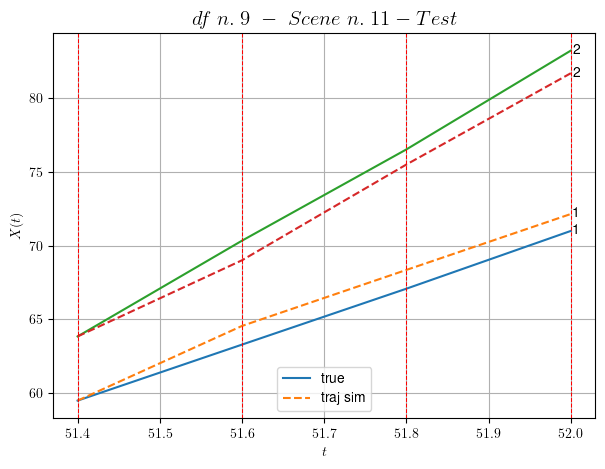

        For scene 11/30:
        * MSE = 1.213755820790592
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.12/30


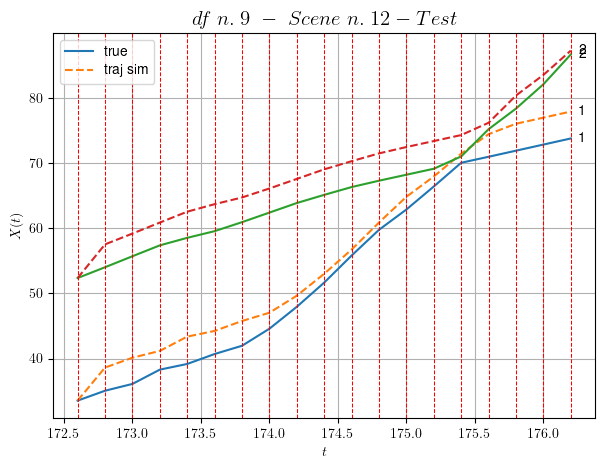

        For scene 12/30:
        * MSE = 10.00197920466915
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.13/30


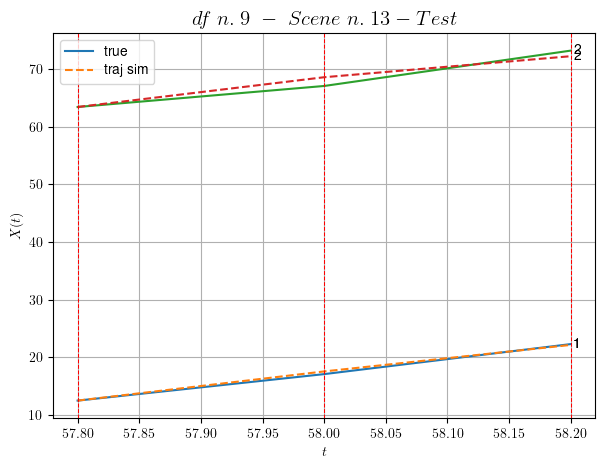

        For scene 13/30:
        * MSE = 0.5799941978290205
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.14/30


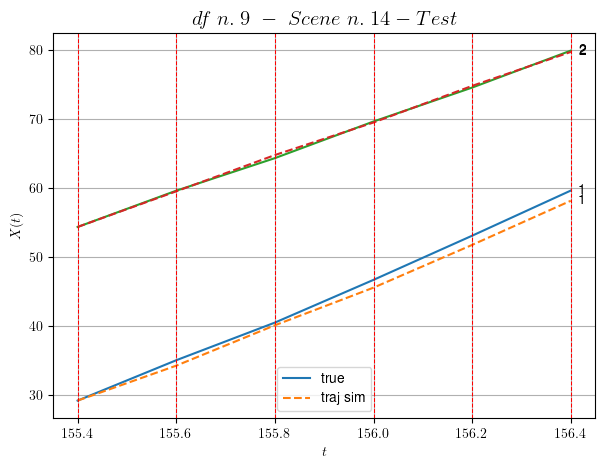

        For scene 14/30:
        * MSE = 0.5276293605984899
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.15/30


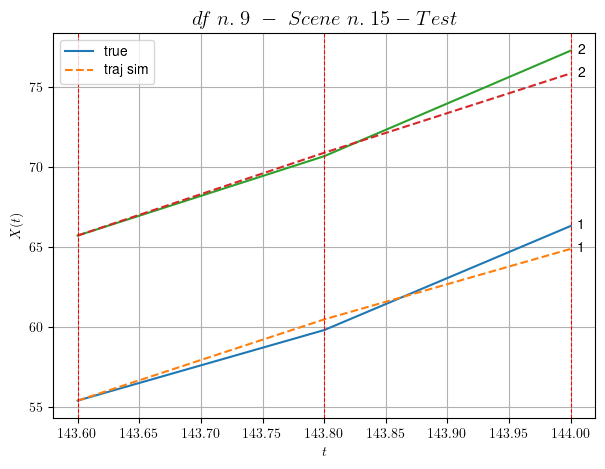

        For scene 15/30:
        * MSE = 0.7580919062212637
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.16/30


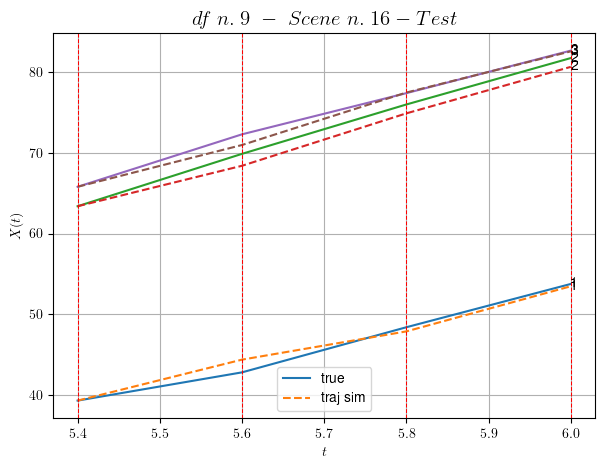

        For scene 16/30:
        * MSE = 0.7614705572930962
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.17/30


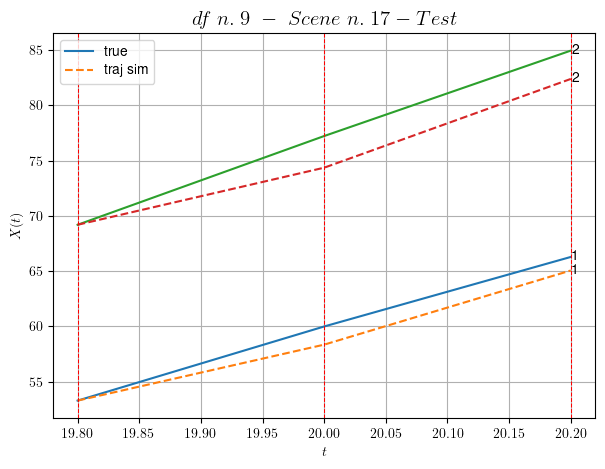

        For scene 17/30:
        * MSE = 3.162724093502157
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.18/30


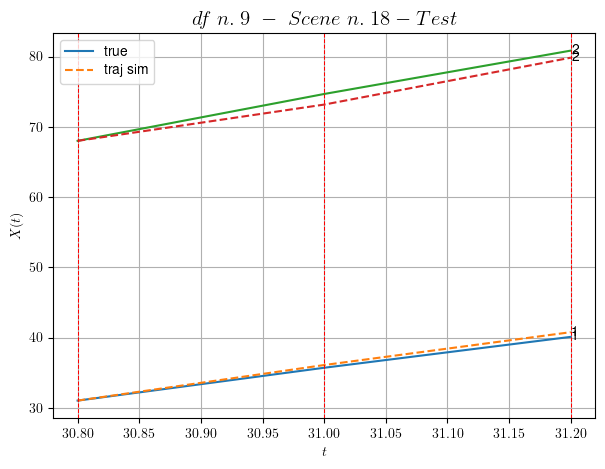

        For scene 18/30:
        * MSE = 0.647943569370318
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.19/30


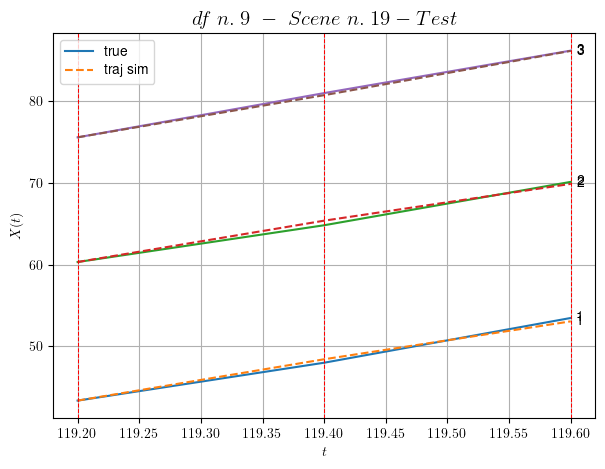

        For scene 19/30:
        * MSE = 0.08804808485153136
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.20/30


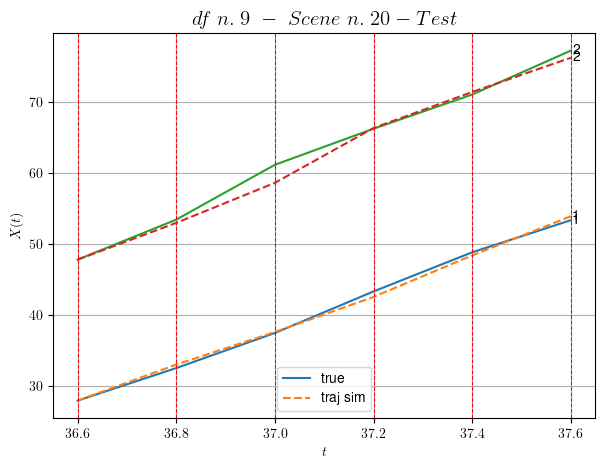

        For scene 20/30:
        * MSE = 0.7634221772785058
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.21/30


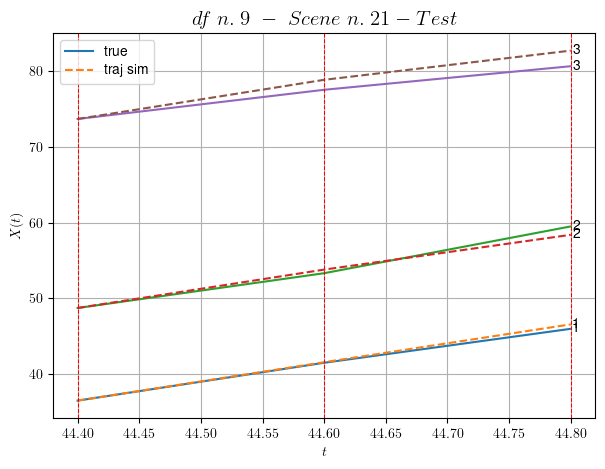

        For scene 21/30:
        * MSE = 0.861722178481017
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.22/30


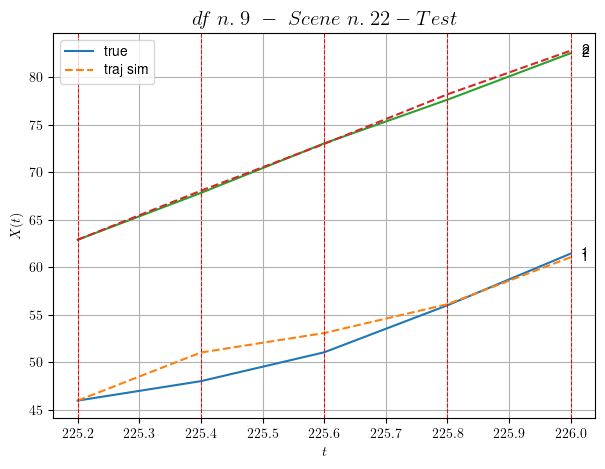

        For scene 22/30:
        * MSE = 1.3820071537117251
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.23/30


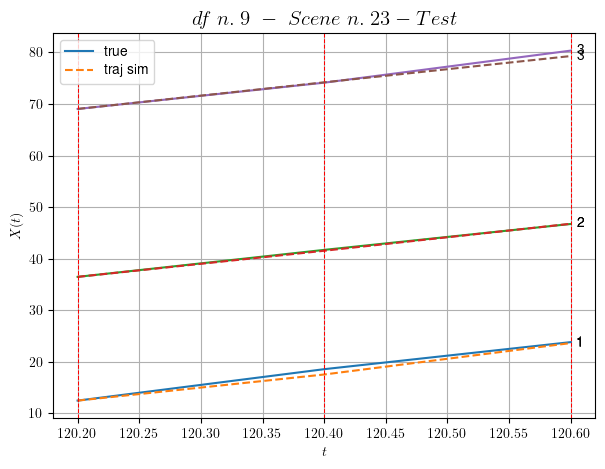

        For scene 23/30:
        * MSE = 0.24937608041915046
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.24/30


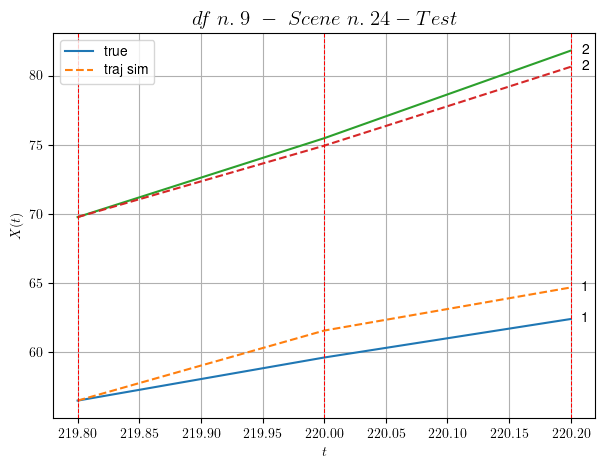

        For scene 24/30:
        * MSE = 1.7751307319512404
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.25/30


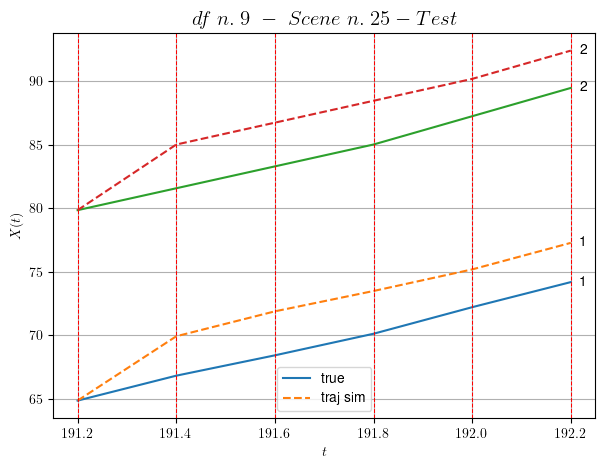

        For scene 25/30:
        * MSE = 8.679480721633656
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.26/30


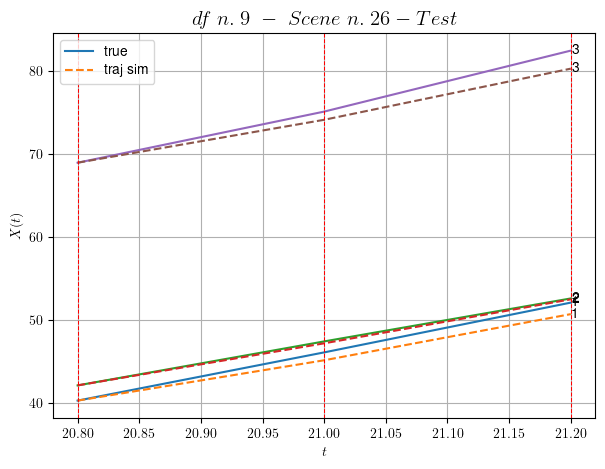

        For scene 26/30:
        * MSE = 0.951721369534201
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.27/30


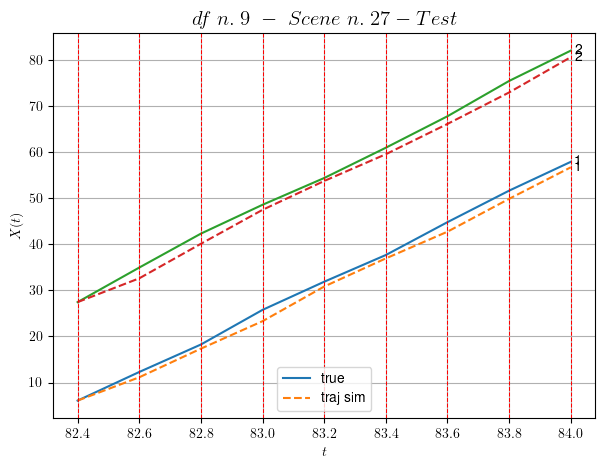

        For scene 27/30:
        * MSE = 2.421245245202204
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.28/30


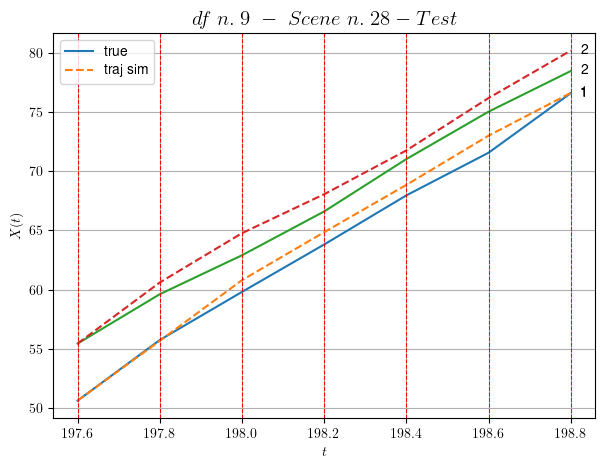

        For scene 28/30:
        * MSE = 1.1724313589863389
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.29/30


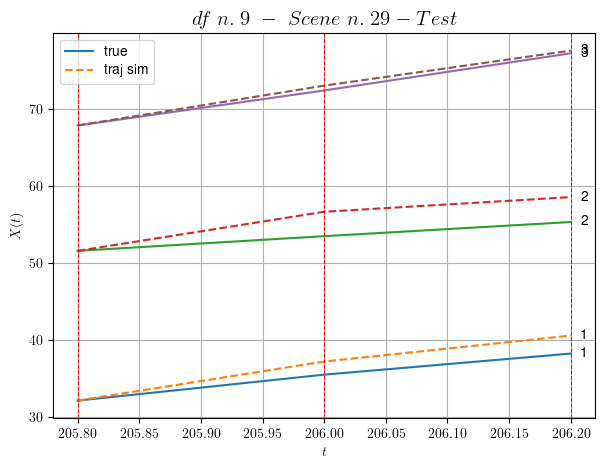

        For scene 29/30:
        * MSE = 3.2528114081473247
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.30/30


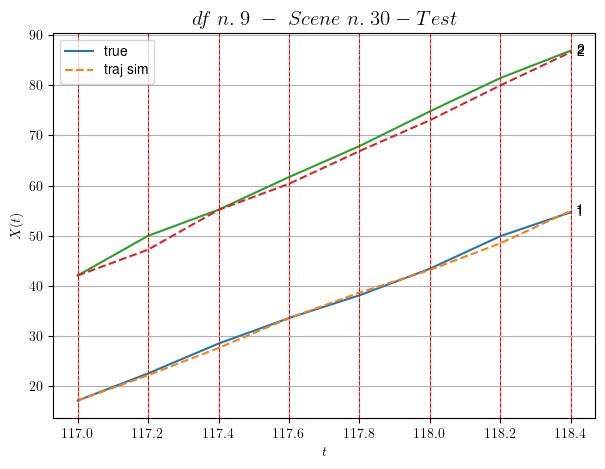

        For scene 30/30:
        * MSE = 1.1975779626047292
----------------------------------------------------------------------------------------------------


MSE test: 2.420299574150359

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.33338395337569243
          * MSE test: 2.420299574150359
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 10/10 dfs.
In DataFrame n.10 we have 74 scenes.
    To train the model we use 7 scenes, the remaining 67 to test the model.

Training step. (7 scenes)
DataFrame n.10. Scene n.1/7
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [34.92,36.32]


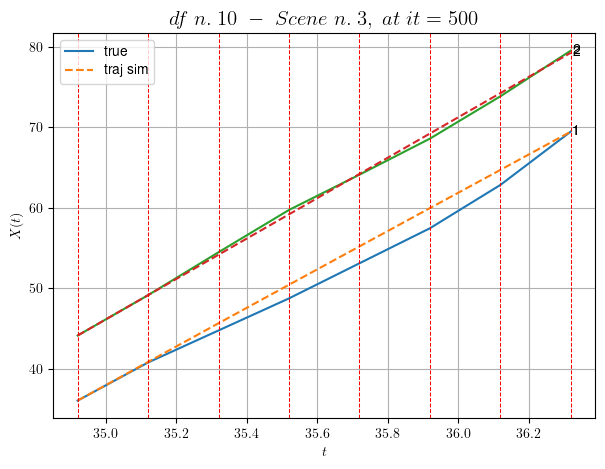

----------------------------------------------------------------------------------------------------
        For scene 1/7:
        * After LR finder: LR_NN=0.001 with mse=9.938843173296924 at it=24
        * v0 = 25.10228996222771
        * MSE = 1.1799517408694271
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/7
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [235.52,235.92]


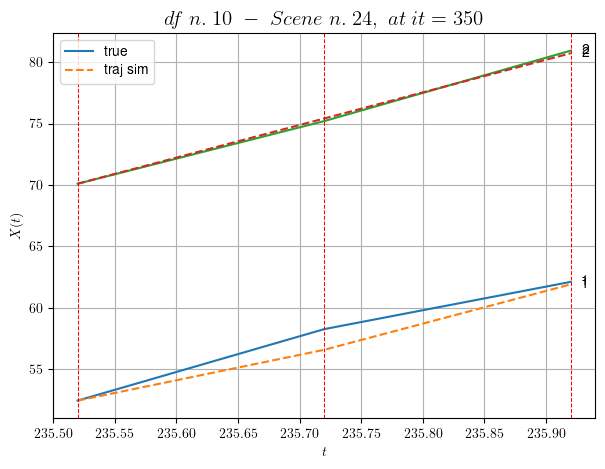

----------------------------------------------------------------------------------------------------
        For scene 2/7:
        * After LR finder: LR_NN=0.01 with mse=1.0263317408376789 at it=24
        * v0 = 26.56953143155173
        * MSE = 0.49447842421142885
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/7
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [209.32,210.52]


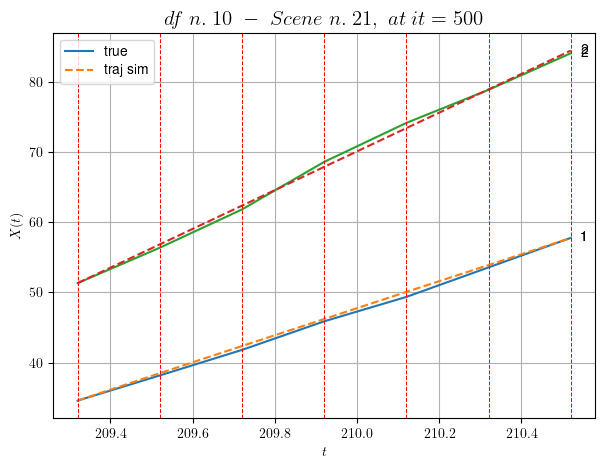

----------------------------------------------------------------------------------------------------
        For scene 3/7:
        * After LR finder: LR_NN=0.005 with mse=1.6587703213525586 at it=24
        * v0 = 27.594562747146796
        * MSE = 0.20394567089834342
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/7
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [237.72,238.12]


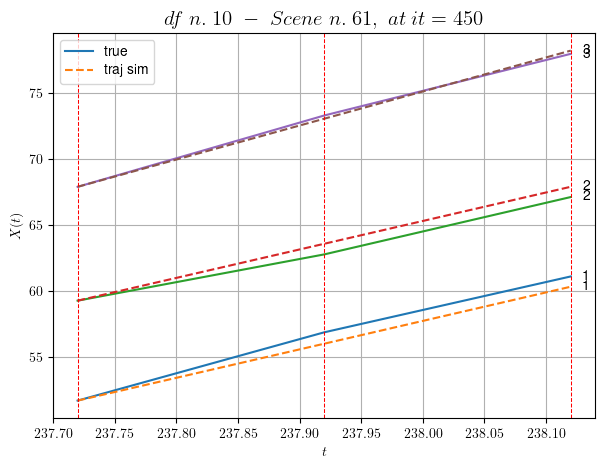

----------------------------------------------------------------------------------------------------
        For scene 4/7:
        * After LR finder: LR_NN=0.005 with mse=0.7335081120090766 at it=24
        * v0 = 25.832593273221804
        * MSE = 0.30320737316015195
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/7
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [202.52,203.12]


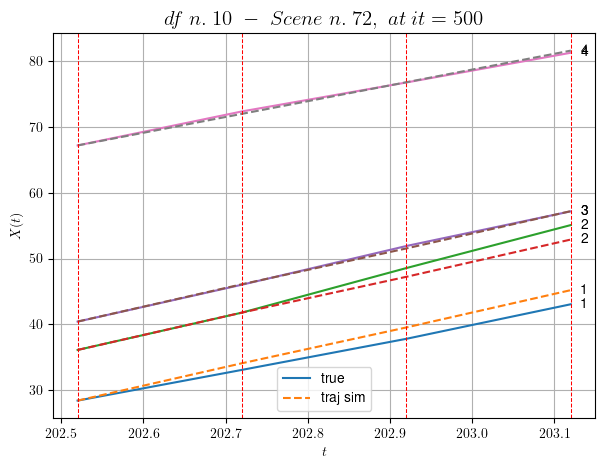

----------------------------------------------------------------------------------------------------
        For scene 5/7:
        * After LR finder: LR_NN=0.01 with mse=2.3315931981927935 at it=24
        * v0 = 24.014144704149366
        * MSE = 0.9736639669321259
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/7
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [118.92,119.32]


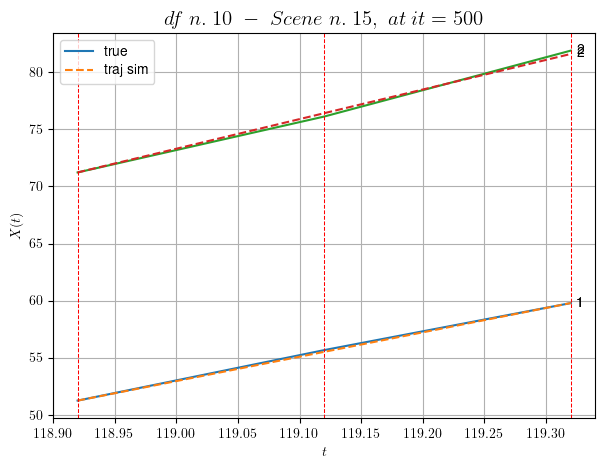

----------------------------------------------------------------------------------------------------
        For scene 6/7:
        * After LR finder: LR_NN=0.0001 with mse=15.351257657877879 at it=24
        * v0 = 25.969534414508043
        * MSE = 0.03178286528504187
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/7
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [578.92,580.52]


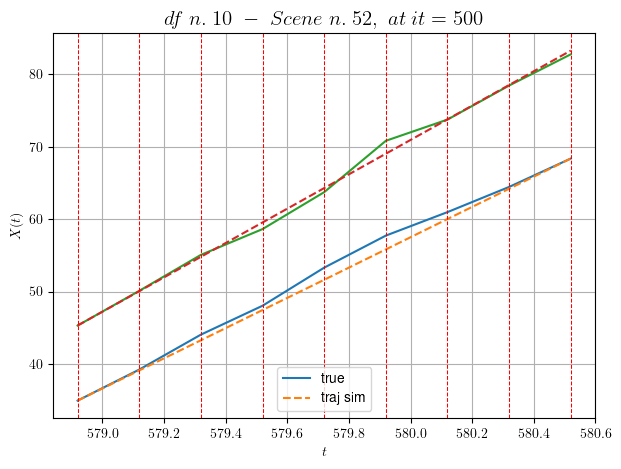

----------------------------------------------------------------------------------------------------
        For scene 7/7:
        * After LR finder: LR_NN=0.001 with mse=19.065744885274157 at it=24
        * v0 = 23.728017954300082
        * MSE = 0.720901820748766
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.5582759803007551
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (67 scenes)
DataFrame n.10. Scene n.1/67


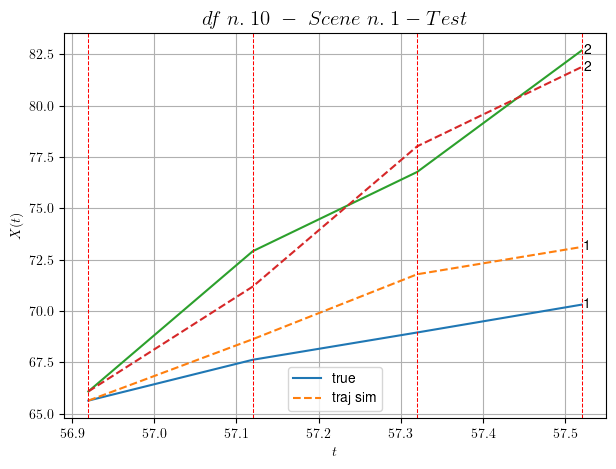

        For scene 1/67:
        * MSE = 2.7629728802877325
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/67


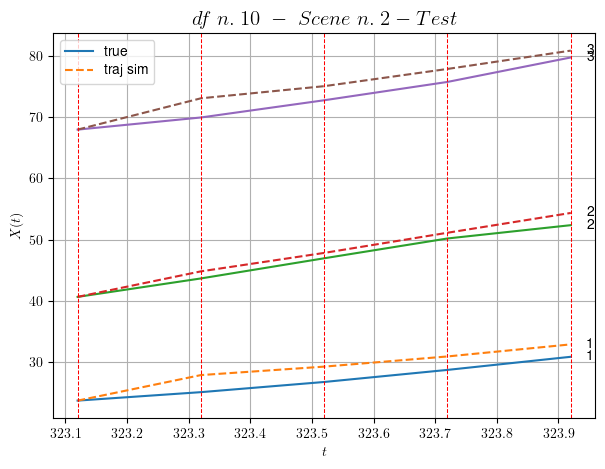

        For scene 2/67:
        * MSE = 3.380425460919261
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/67


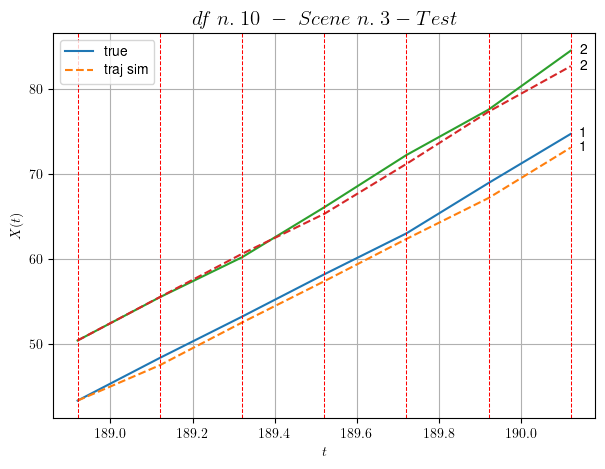

        For scene 3/67:
        * MSE = 0.9501635131875774
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/67


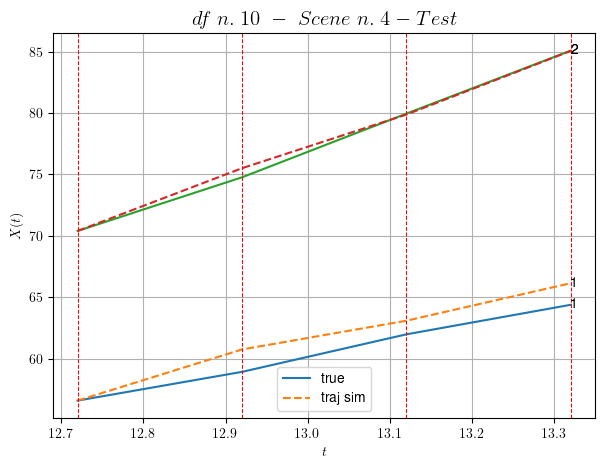

        For scene 4/67:
        * MSE = 1.0256262837618546
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/67


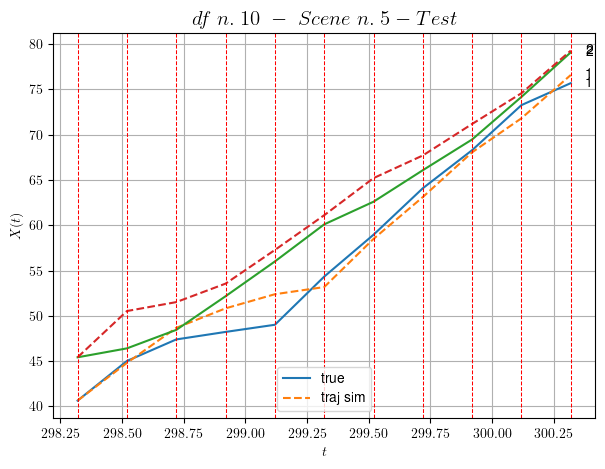

        For scene 5/67:
        * MSE = 3.1308603700284494
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/67


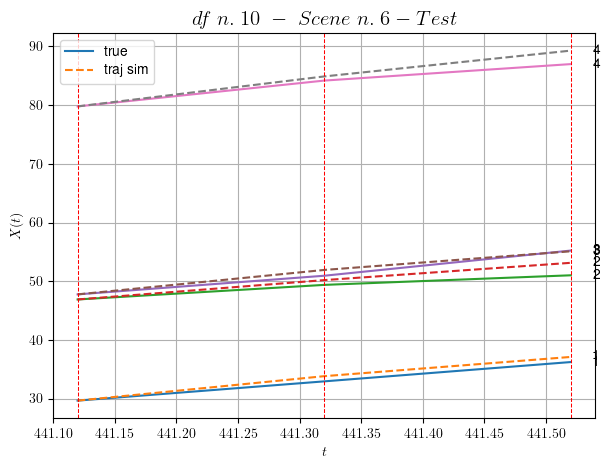

        For scene 6/67:
        * MSE = 1.1250728357276052
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/67


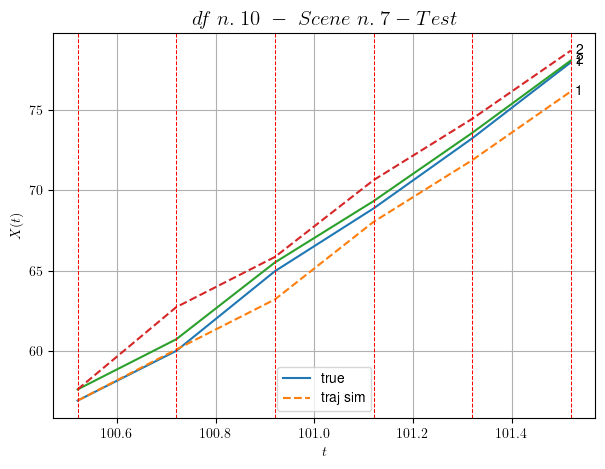

        For scene 7/67:
        * MSE = 1.317050115640853
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.8/67


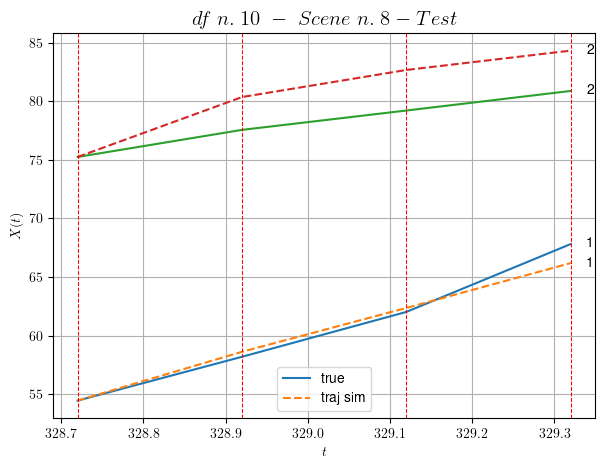

        For scene 8/67:
        * MSE = 4.3190183022691615
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.9/67


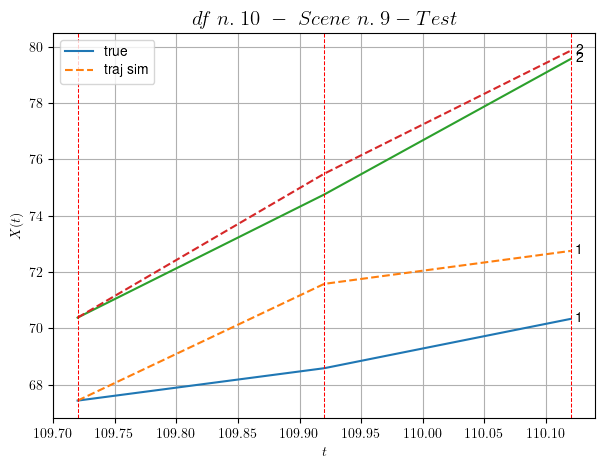

        For scene 9/67:
        * MSE = 2.5694850929210435
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.10/67


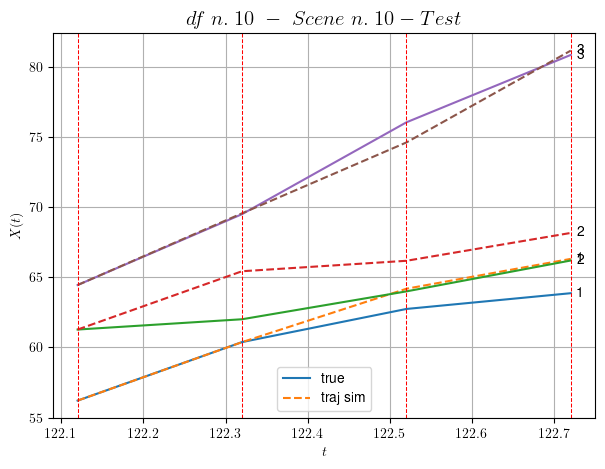

        For scene 10/67:
        * MSE = 2.5427243899857483
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.11/67


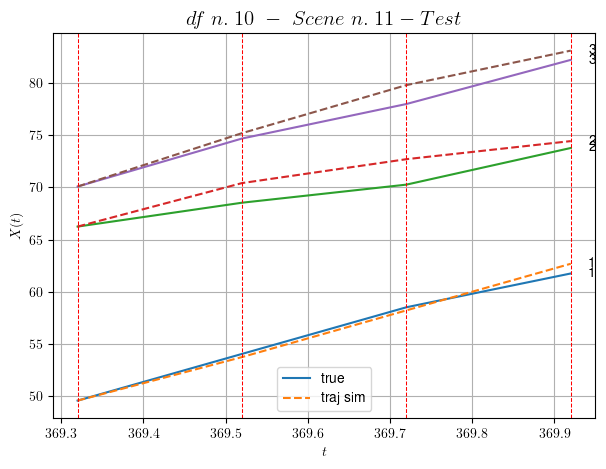

        For scene 11/67:
        * MSE = 1.2708329888203405
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.12/67


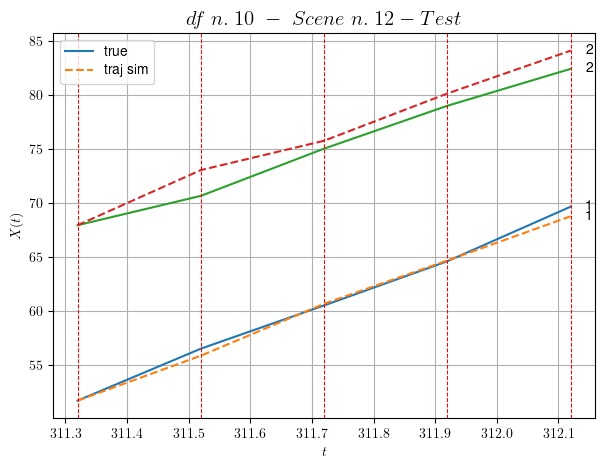

        For scene 12/67:
        * MSE = 1.1635322118097045
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.13/67


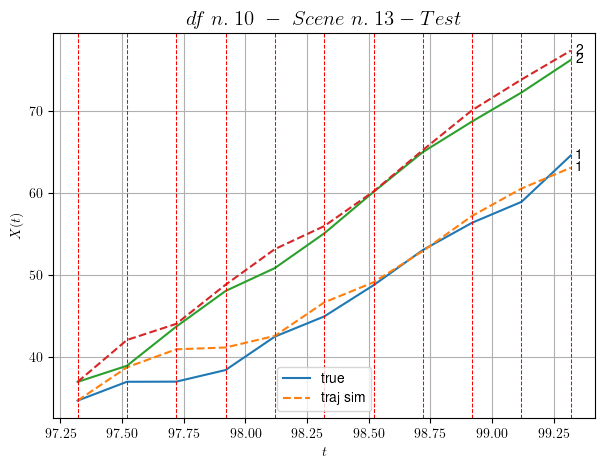

        For scene 13/67:
        * MSE = 2.6058667676683918
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.14/67


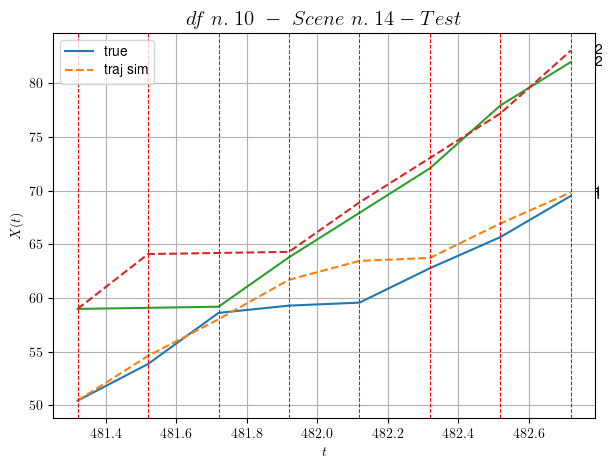

        For scene 14/67:
        * MSE = 4.900041569315411
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.15/67


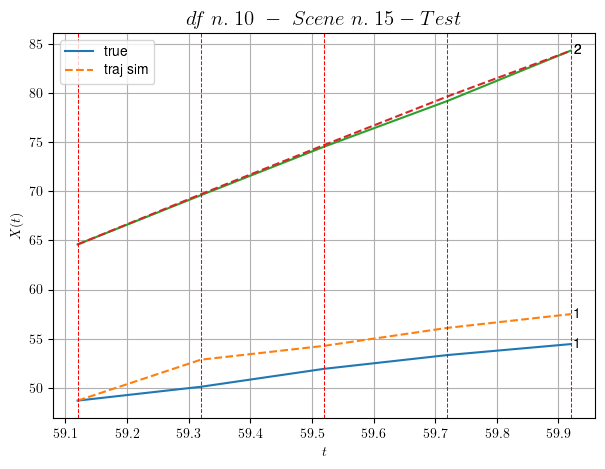

        For scene 15/67:
        * MSE = 3.025211180669393
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.16/67


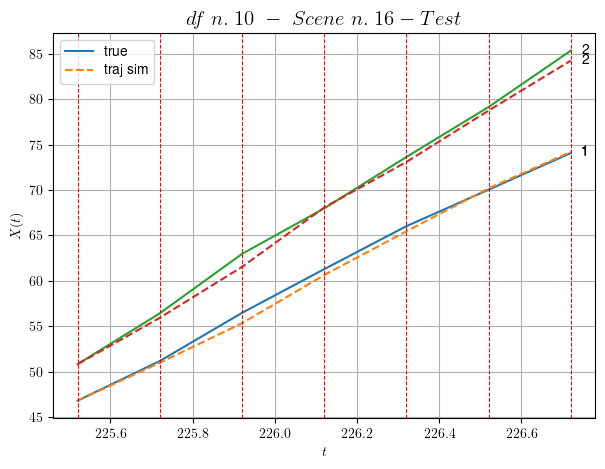

        For scene 16/67:
        * MSE = 0.4349807657597197
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.17/67


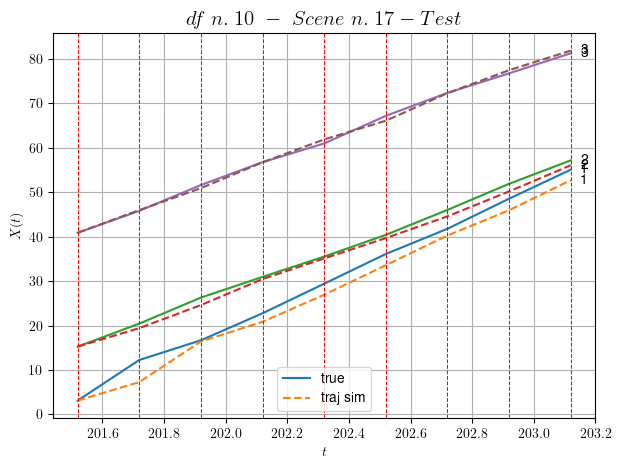

        For scene 17/67:
        * MSE = 2.5986052884783986
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.18/67


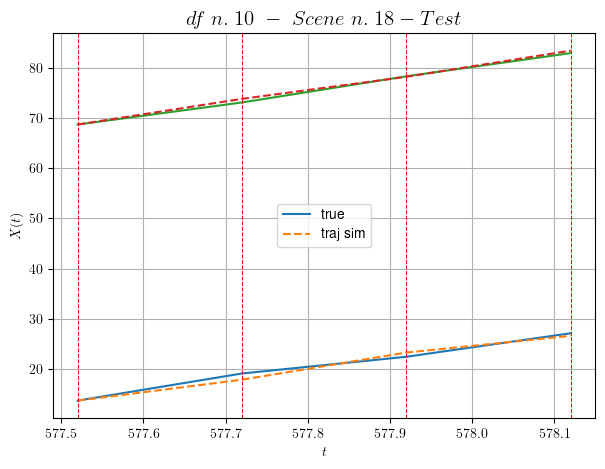

        For scene 18/67:
        * MSE = 0.4068259040679834
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.19/67


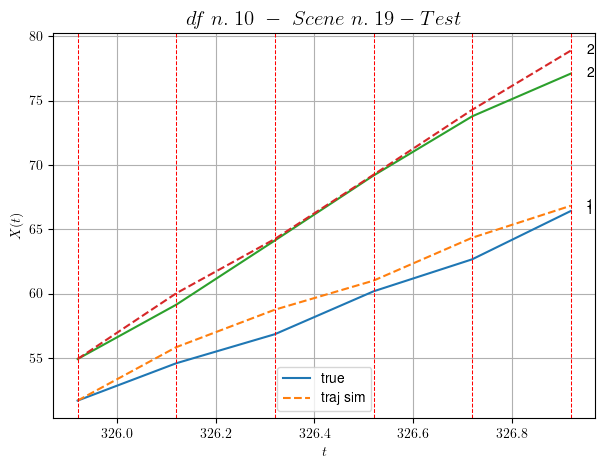

        For scene 19/67:
        * MSE = 1.093454085594638
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.20/67


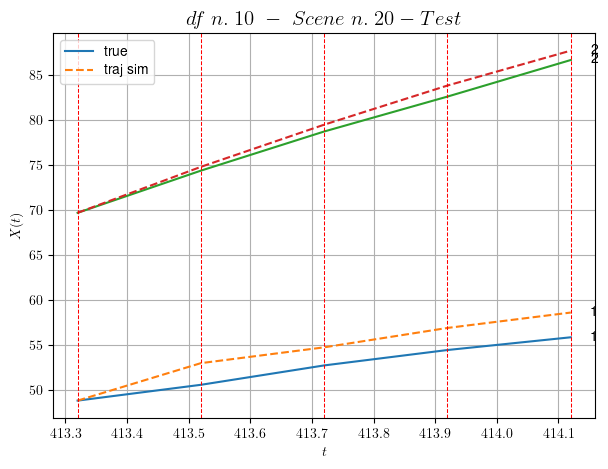

        For scene 20/67:
        * MSE = 2.676973088552258
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.21/67


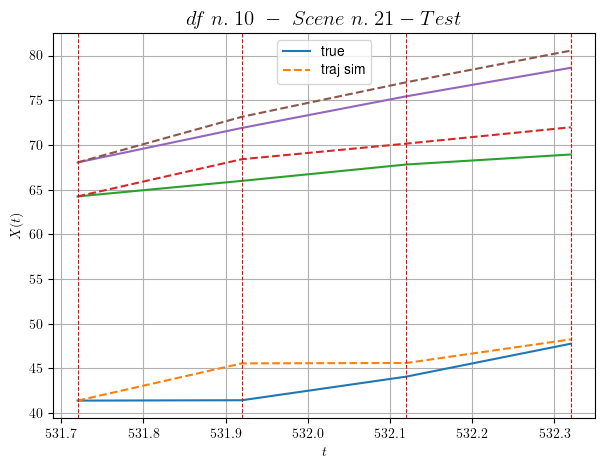

        For scene 21/67:
        * MSE = 3.987667584159293
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.22/67


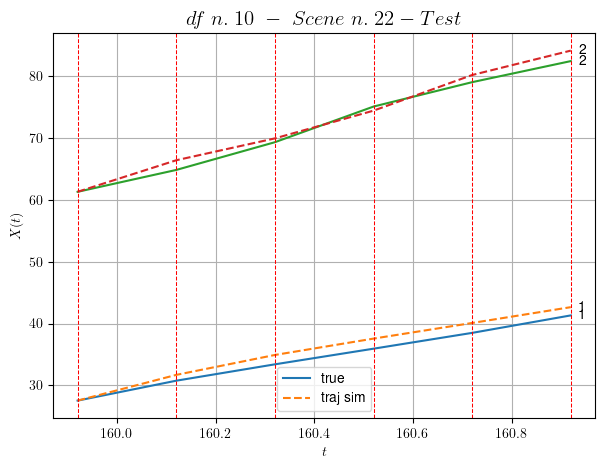

        For scene 22/67:
        * MSE = 1.4757320314694407
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.23/67


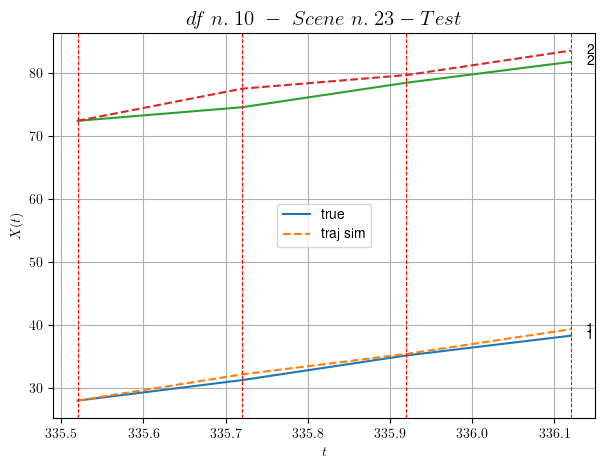

        For scene 23/67:
        * MSE = 1.914954368693814
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.24/67


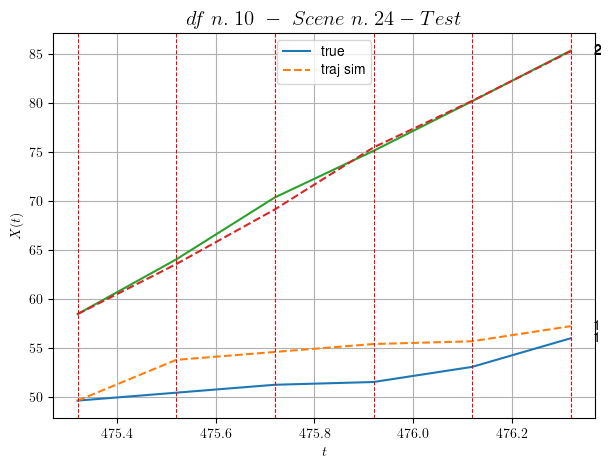

        For scene 24/67:
        * MSE = 3.9870780790928446
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.25/67


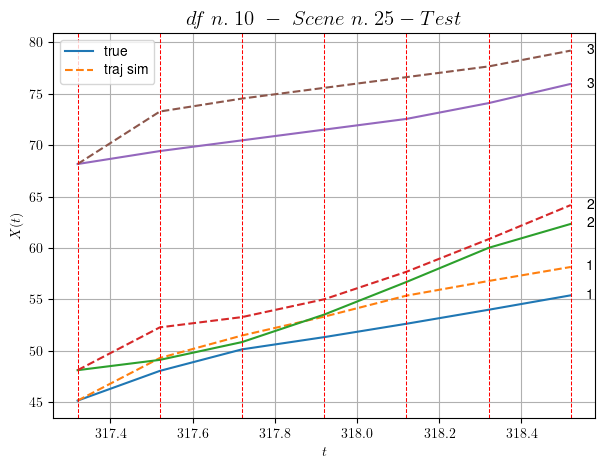

        For scene 25/67:
        * MSE = 6.721280264974792
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.26/67


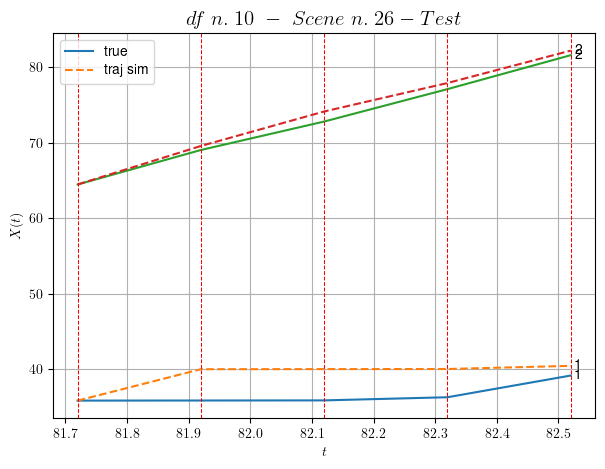

        For scene 26/67:
        * MSE = 5.321948591000429
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.27/67


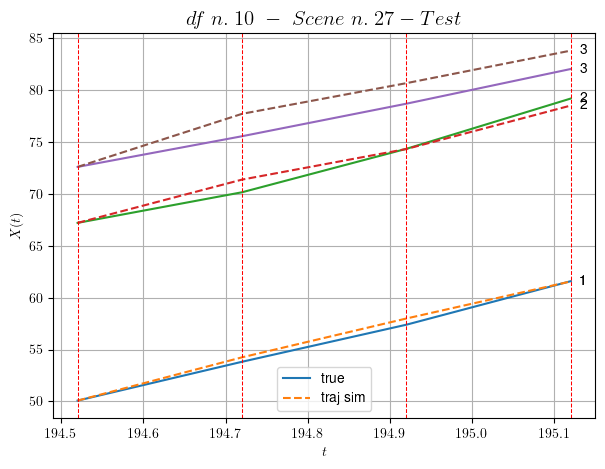

        For scene 27/67:
        * MSE = 1.1804701648479583
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.28/67


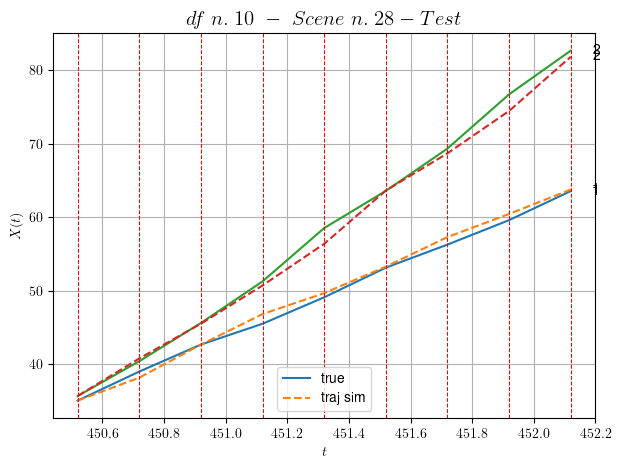

        For scene 28/67:
        * MSE = 0.879475173508626
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.29/67


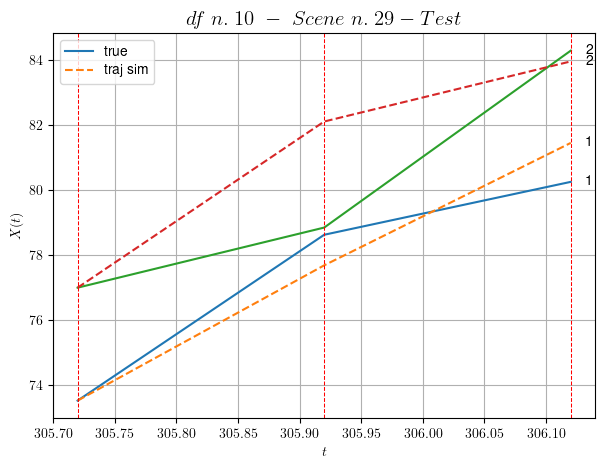

        For scene 29/67:
        * MSE = 2.176659527630855
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.30/67


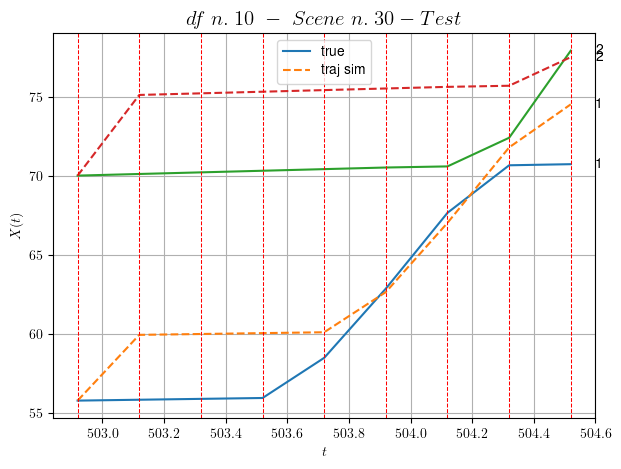

        For scene 30/67:
        * MSE = 12.840649187824255
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.31/67


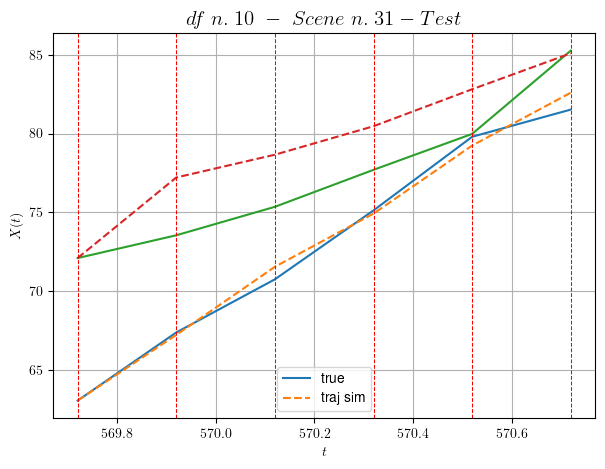

        For scene 31/67:
        * MSE = 3.514578382586585
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.32/67


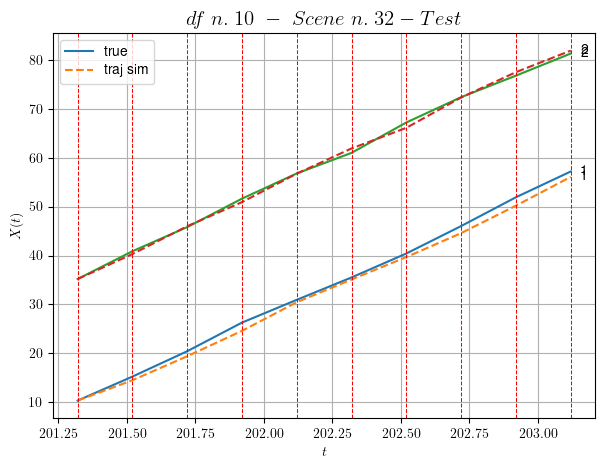

        For scene 32/67:
        * MSE = 0.7670508216770417
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.33/67


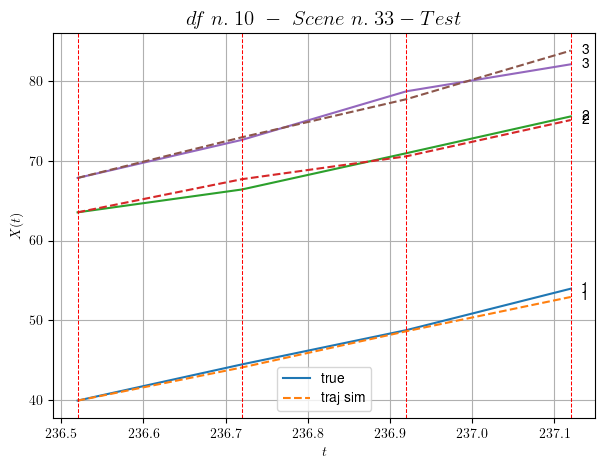

        For scene 33/67:
        * MSE = 0.6101141185235077
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.34/67


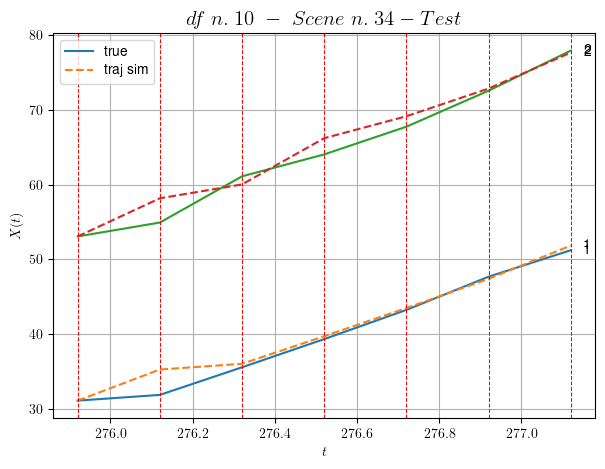

        For scene 34/67:
        * MSE = 2.2141965484025006
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.35/67


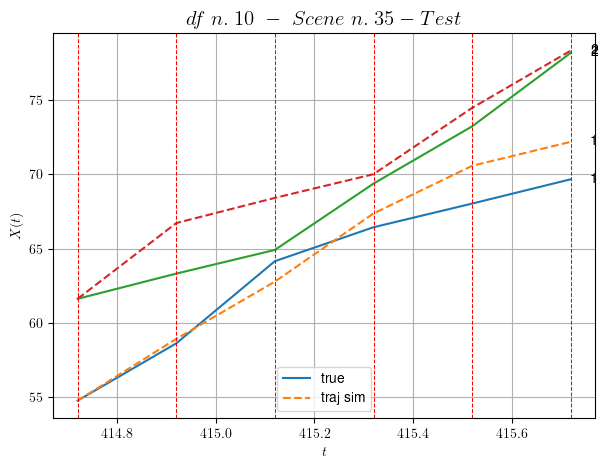

        For scene 35/67:
        * MSE = 3.4705335971516895
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.36/67


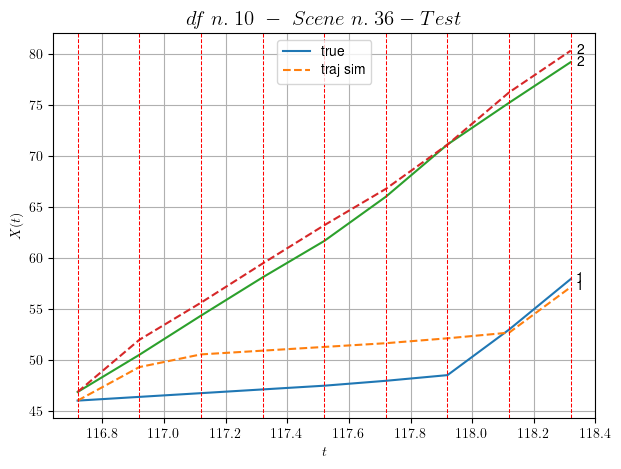

        For scene 36/67:
        * MSE = 5.000787113133029
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.37/67


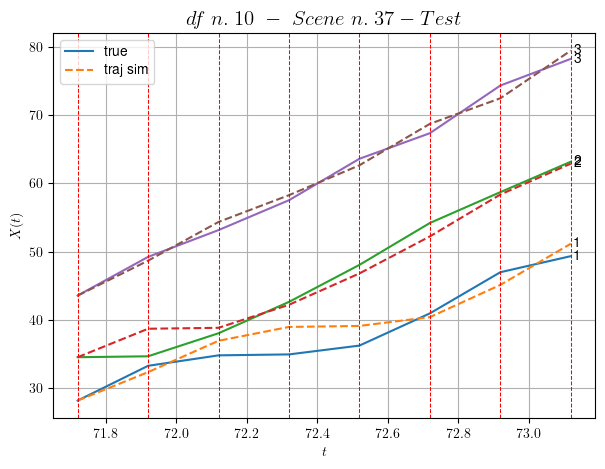

        For scene 37/67:
        * MSE = 2.892941724486736
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.38/67


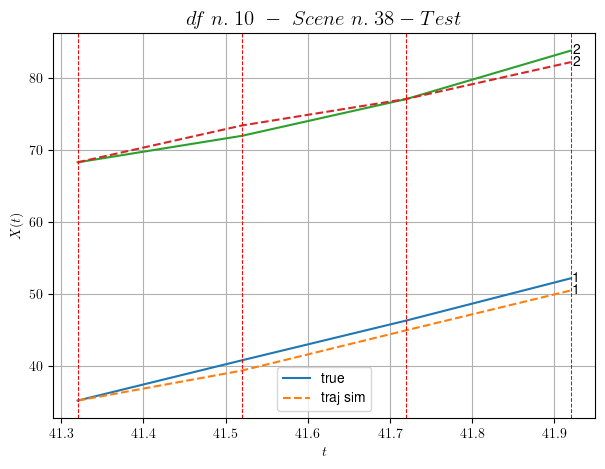

        For scene 38/67:
        * MSE = 1.40813007395371
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.39/67


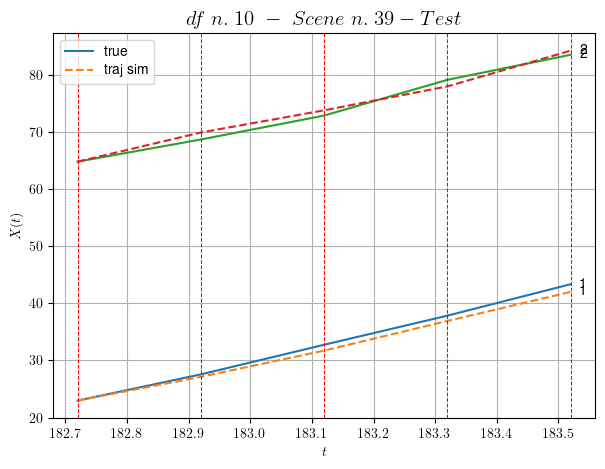

        For scene 39/67:
        * MSE = 0.8099695379093625
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.40/67


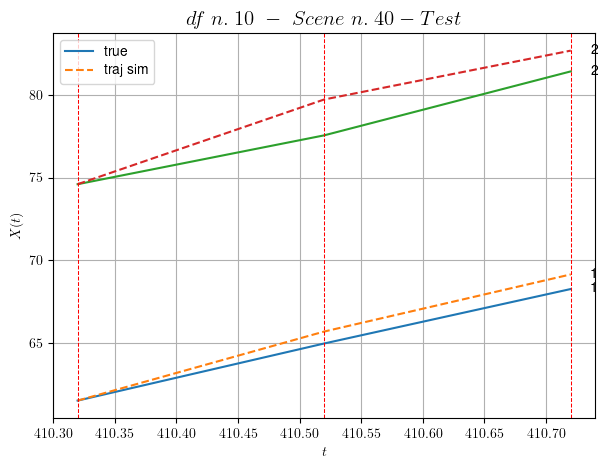

        For scene 40/67:
        * MSE = 1.2565832088783653
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.41/67


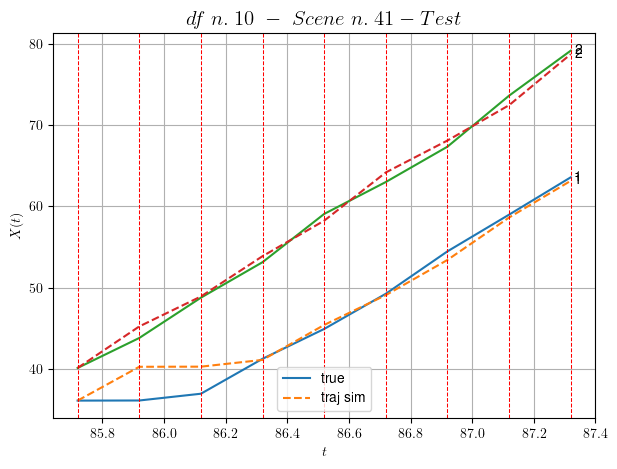

        For scene 41/67:
        * MSE = 2.0460577959519597
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.42/67


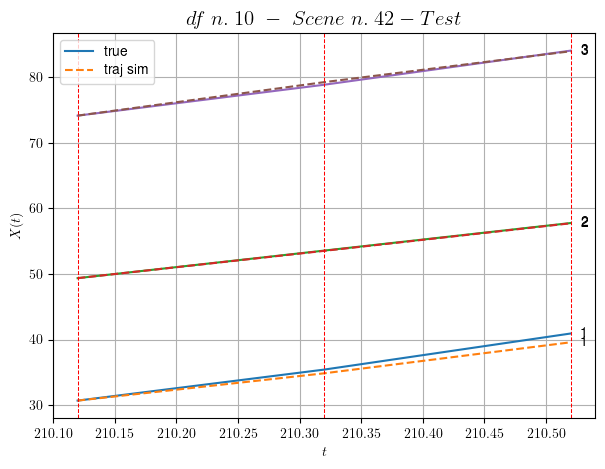

        For scene 42/67:
        * MSE = 0.2542651623226369
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.43/67


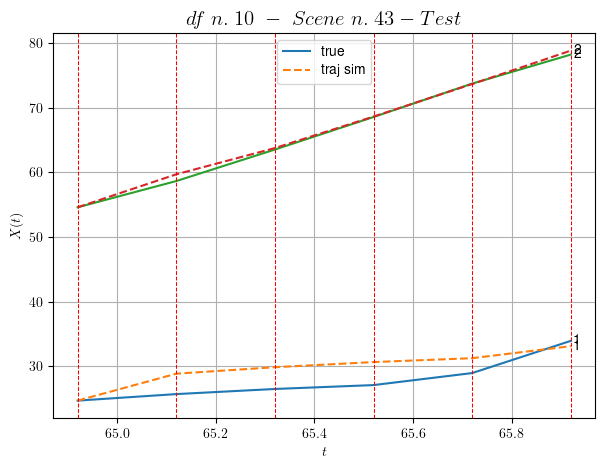

        For scene 43/67:
        * MSE = 3.461792892466789
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.44/67


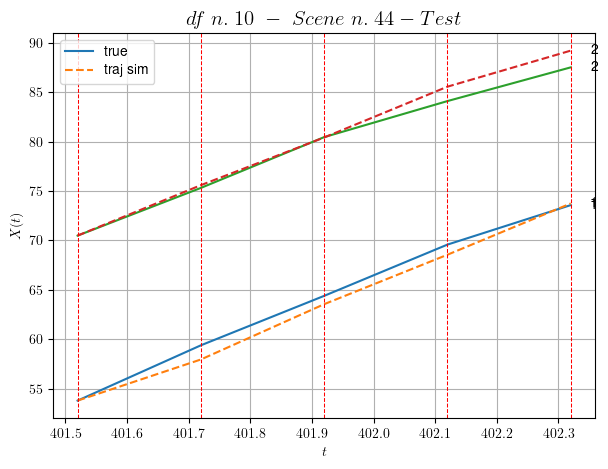

        For scene 44/67:
        * MSE = 0.8928915507346555
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.45/67


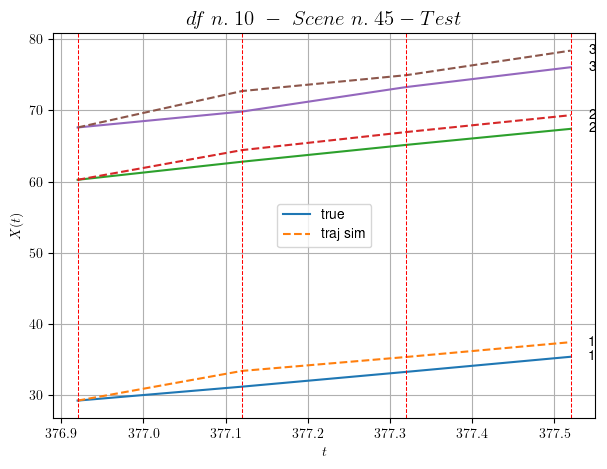

        For scene 45/67:
        * MSE = 3.2895952853465893
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.46/67


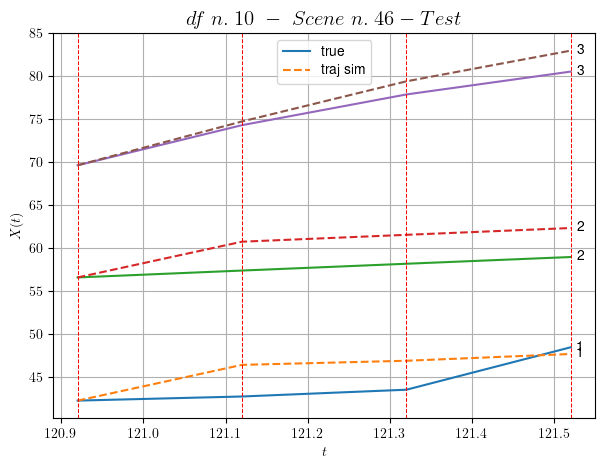

        For scene 46/67:
        * MSE = 5.682226374429175
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.47/67


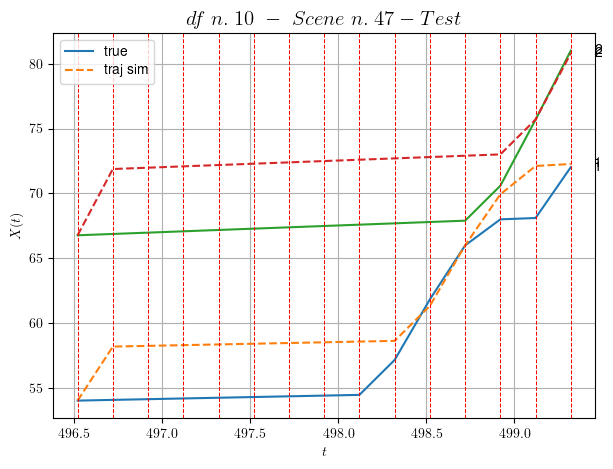

        For scene 47/67:
        * MSE = 14.632826208702857
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.48/67


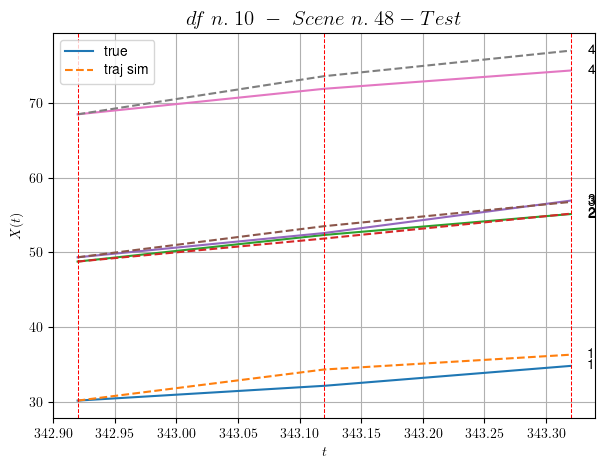

        For scene 48/67:
        * MSE = 1.5052766654426297
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.49/67


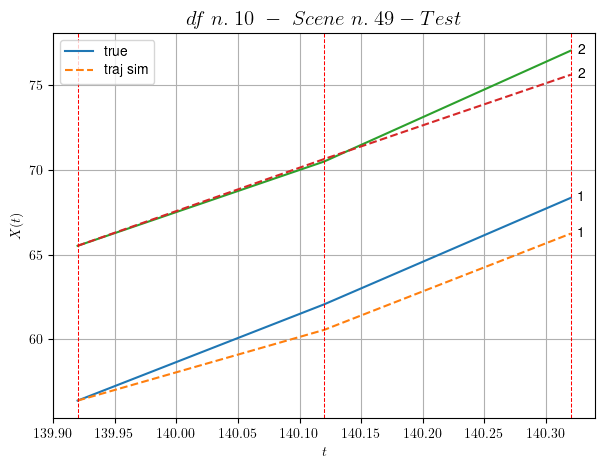

        For scene 49/67:
        * MSE = 1.4540062119078843
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.50/67


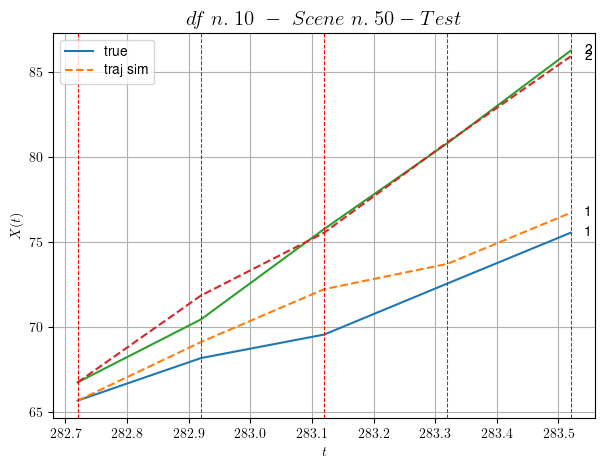

        For scene 50/67:
        * MSE = 1.2881305246081636
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.51/67


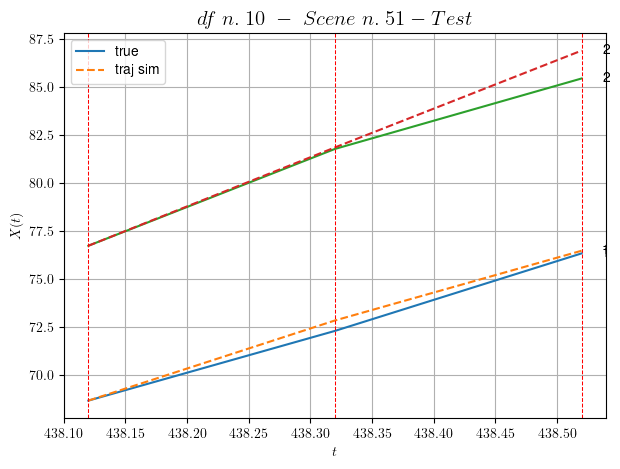

        For scene 51/67:
        * MSE = 0.40287799504327515
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.52/67


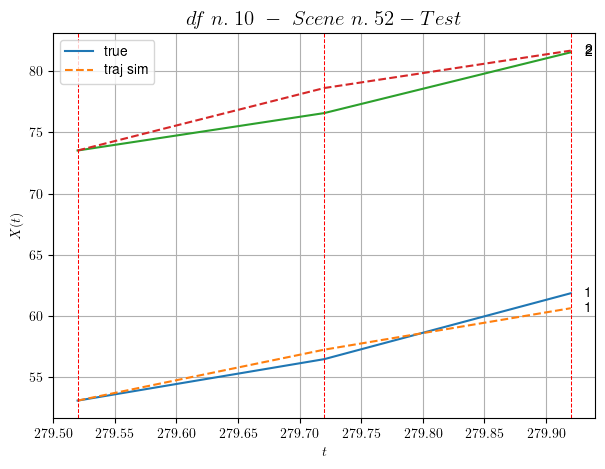

        For scene 52/67:
        * MSE = 1.0529525298897322
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.53/67


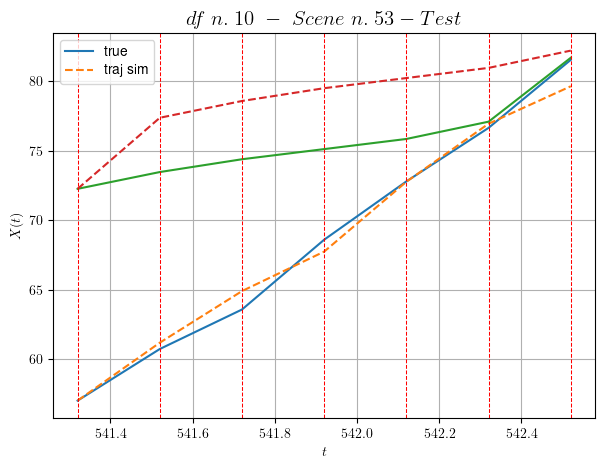

        For scene 53/67:
        * MSE = 6.62411693597832
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.54/67


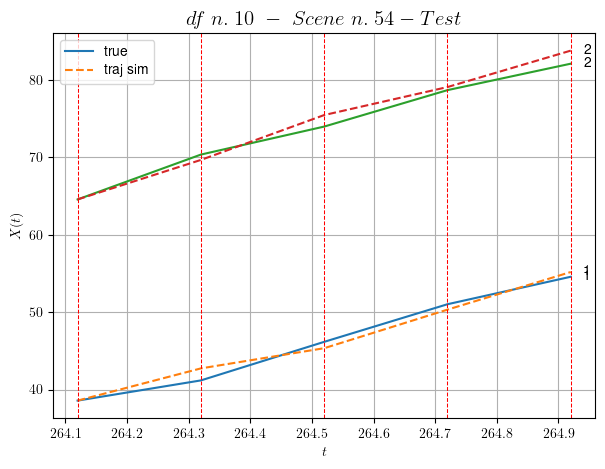

        For scene 54/67:
        * MSE = 0.9652372788328678
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.55/67


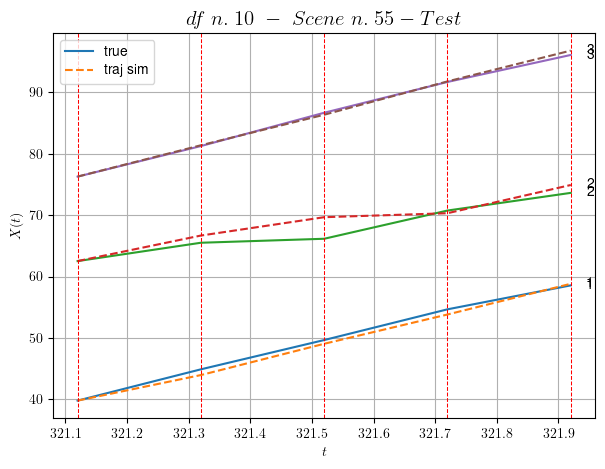

        For scene 55/67:
        * MSE = 1.2151538390873007
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.56/67


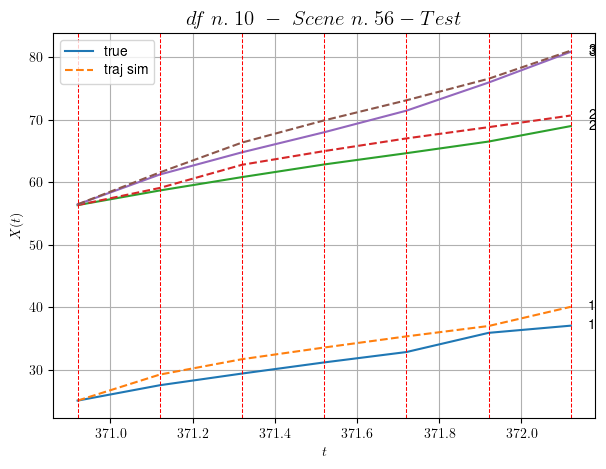

        For scene 56/67:
        * MSE = 2.956157400949115
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.57/67


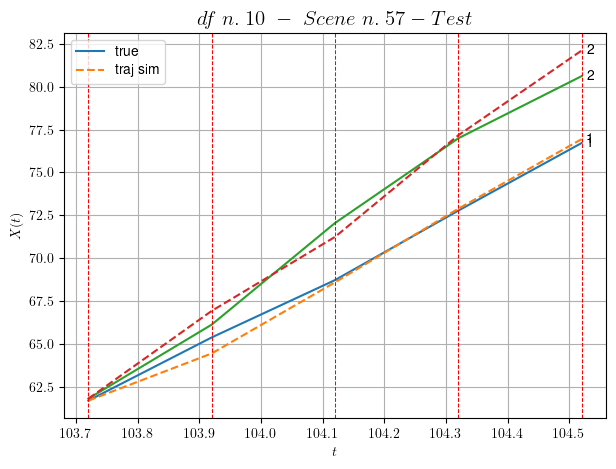

        For scene 57/67:
        * MSE = 0.4490108408619684
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.58/67


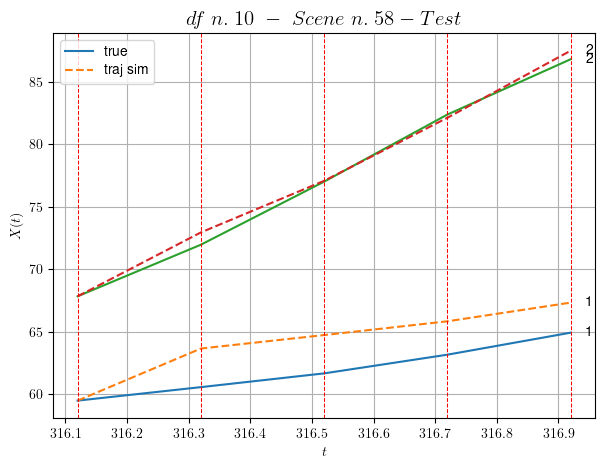

        For scene 58/67:
        * MSE = 3.33264531034878
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.59/67


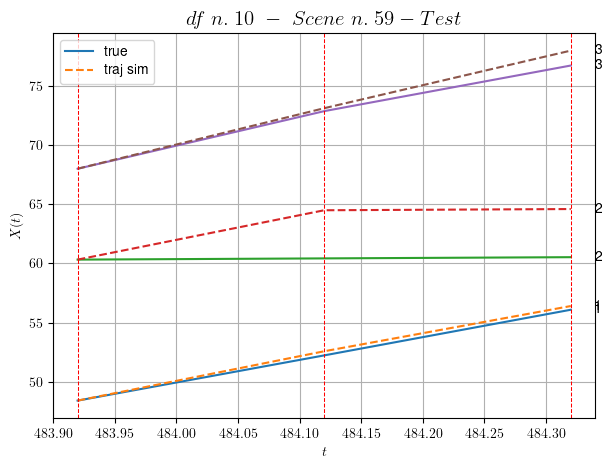

        For scene 59/67:
        * MSE = 3.874380837555893
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.60/67


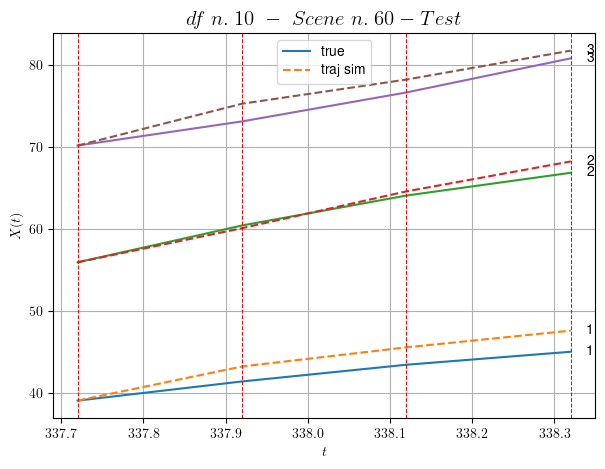

        For scene 60/67:
        * MSE = 2.066460681022118
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.61/67


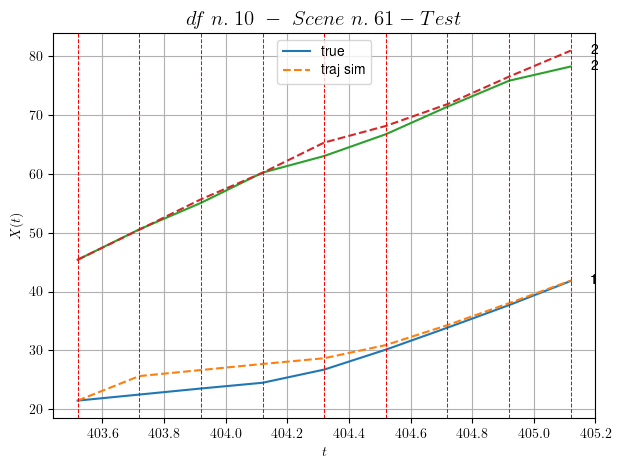

        For scene 61/67:
        * MSE = 2.7790236098758148
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.62/67


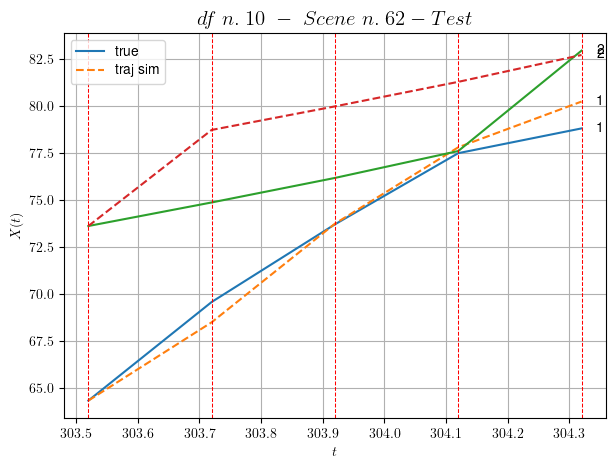

        For scene 62/67:
        * MSE = 4.62423843638229
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.63/67


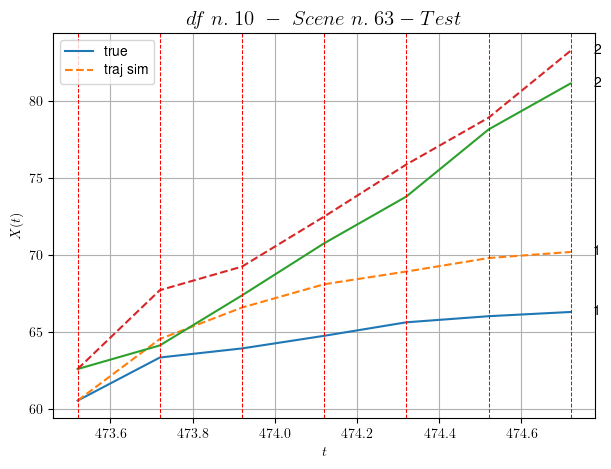

        For scene 63/67:
        * MSE = 6.318723494823864
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.64/67


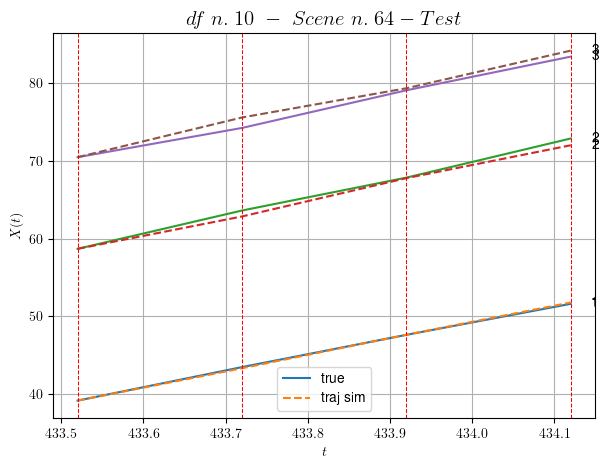

        For scene 64/67:
        * MSE = 0.3231205777299346
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.65/67


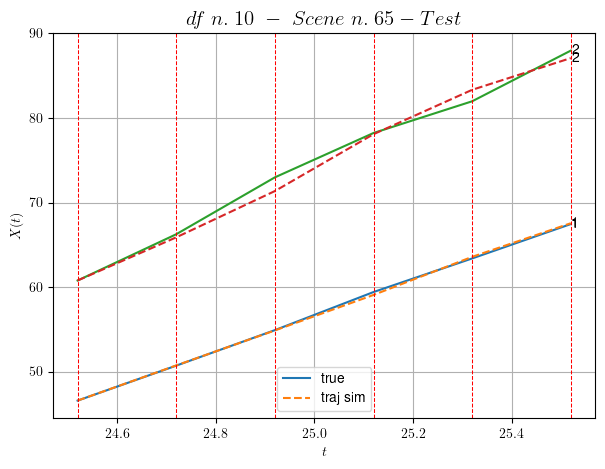

        For scene 65/67:
        * MSE = 0.4644992724584665
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.66/67


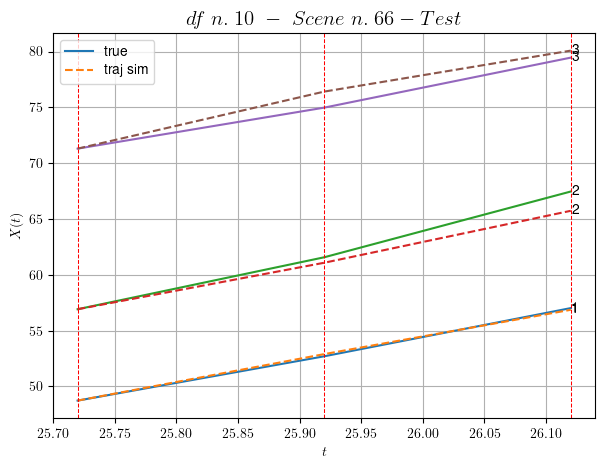

        For scene 66/67:
        * MSE = 0.6382789169935966
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.67/67


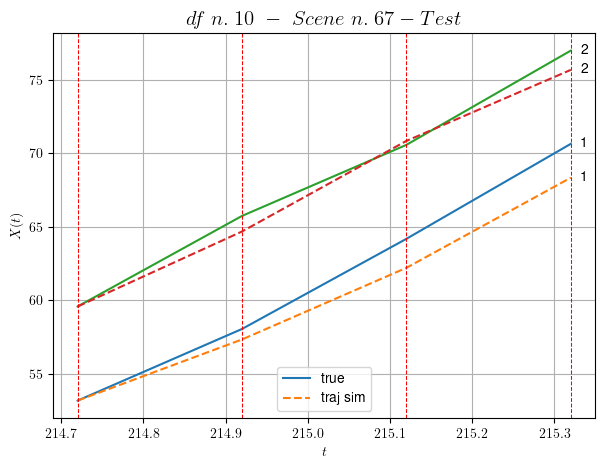

        For scene 67/67:
        * MSE = 1.5815020511046898
----------------------------------------------------------------------------------------------------


MSE test: 2.6851637593465925

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.5582759803007551
          * MSE test: 2.6851637593465925
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -






In [6]:
info_nn, model_trained = solve_nn_dataset(dataset, DOE, v0, processed_flag, NUM_ITER, LEARNING_RATE_v0,
                                           test, plot_flag)

In [7]:
get_stats(model_trained)


-------------------- Model Summary --------------------
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Hidden-Layer-1 (Dense)      (None, 1)                 2         
                                                                 
 Hidden-Layer-2 (Dense)      (None, 1)                 2         
                                                                 
 Output-Layer (Dense)        (None, 1)                 1         
                                                                 
Total params: 5 (20.00 Byte)
Trainable params: 5 (20.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________

-------------------- Weights and Biases --------------------
Layer:  Hidden-Layer-1
  --Kernels (Weights): 
[[-2.686431]]
  --Biases: 
[5.3143997]

Layer:  Hidden-Layer-2
  --Kernels (Weights): 
[[-0.3139167]]
  --Biases: 
[4.4867

## Plot

### Leading velocity $v_{0}$

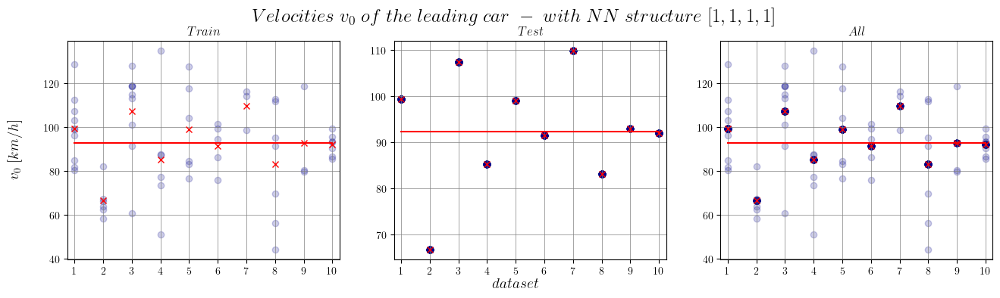

In [8]:
# Initialize the fig
nrow, ncol = 1, 3
width, height = 7, 5 # single subplot
fig, axes = plt.subplots(nrow,ncol,figsize=(width*ncol*.75,height*.75))

ms2kmh = 3.6

info_train = info_nn[info_nn["type"] == "train"]
info_test = info_nn[info_nn["type"] == "test"]
info_grouped = info_nn.groupby(['N. file', 'type']).mean(numeric_only=True)
info_grouped2 = info_nn.groupby(['N. file']).mean(numeric_only=True)
info_avg = info_nn.groupby(['type']).mean(numeric_only=True)

# For each scene, plot v0 mean
for _, scn in info_train.iterrows():
    axes[0].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');
    
for _, scn in info_test.iterrows():
    axes[1].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# Avg value
for (nf,typef), infof in info_grouped.iterrows():
    
    if typef == "train":
        axes[0].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")
        
    if typef == "test":
        axes[1].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")

# For each scene, plot v0 mean
for _, scn in info_nn.iterrows():
    axes[2].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
for nf, p in info_grouped2.iterrows():
    axes[2].plot(nf, p['v0']*ms2kmh, color = 'r', marker="x")

# Plot v0 mean over all dfs
alldfs = [a for a, _ in info_nn.groupby('N. file')]
v0_mean = np.mean([ infof['v0']*ms2kmh for _, infof in info_grouped.iterrows()])
axes[0].plot(alldfs, [info_avg['v0']['train']*ms2kmh]*len(alldfs), color = 'r')  
axes[1].plot(alldfs, [info_avg['v0']['test']*ms2kmh]*len(alldfs), color = 'r')  
axes[2].plot(alldfs, [v0_mean]*len(alldfs), color = 'r')  

# labeling     
axes[0].set_title(fr"$Train$",fontsize=12)
axes[1].set_title(fr"$Test$",fontsize=12)
axes[2].set_title(fr"$All$",fontsize=12)
fig.supxlabel(r"$data set$",fontsize=14, y=0.0005)
fig.supylabel(r"$v_{0}\ [km/h]$",fontsize=14, x = 0.075)
plt.suptitle(fr"$Velocities\ v_{0}\ of\ the\ leading\ car\ -\ with\ NN\ structure\ {str(DOE)}$",
             fontsize=18, y=1)

# Setting the values for all axes.
custom_xlim = (0.75,10.25)
custom_xticks = range(1,11)
plt.setp(axes, xlim=custom_xlim, xticks=custom_xticks)

axes[0].grid(color='grey', linestyle='-', linewidth=0.5);
axes[1].grid(color='grey', linestyle='-', linewidth=0.5);
axes[2].grid(color='grey', linestyle='-', linewidth=0.5);

plt.show()

### Test 1: `cons_dis` vs `velocities`

In [9]:
Nx = 10
Nt = 100
T = 0.5

In [10]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [11]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

In [12]:
y_pred

<tf.Tensor: shape=(9, 1), dtype=float32, numpy=
array([[13.638413 ],
       [14.633829 ],
       [13.7549515],
       [14.744089 ],
       [13.846842 ],
       [13.52404  ],
       [14.071982 ],
       [13.583377 ],
       [14.300044 ]], dtype=float32)>

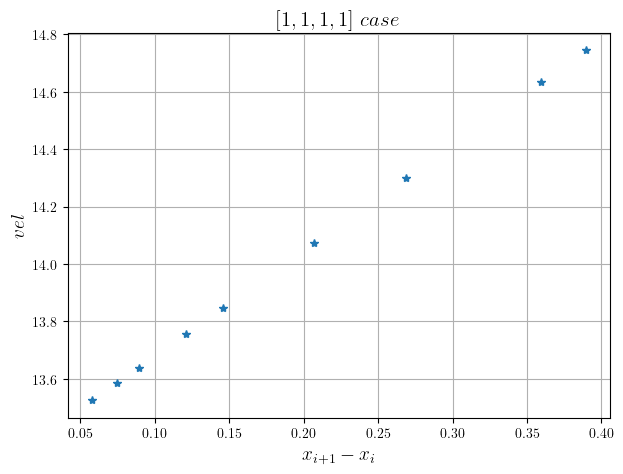

In [13]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

### Test 2: `cons_dis` vs `velocities`

In [14]:
Nx = 100
Nt = 100
T = 0.5

In [15]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [16]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

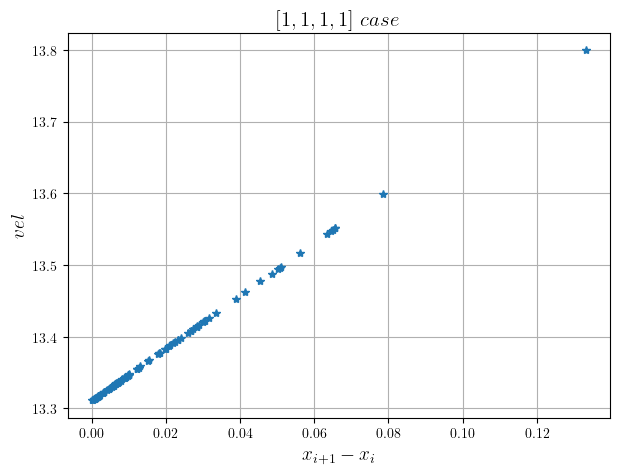

In [17]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

## Prepare the out dir

In [18]:
# Create the directory..
if flag_save:
    
    df_seen = [df['N. file'][0] for df in dataset]
    df_seen_str = '-'.join(str(x) for x in df_seen)
    
    # Create directory where to save the image
    now = datetime.now() 
    d = now.strftime(f"%Y-%m-%d_%H-%M-%S_df{df_seen_str}_{NUM_ITER}it-PRE-nn{str(DOE)}")
    
    path = 'out/' + d
    os.mkdir(path)
    
    # Save the solution in a file
    namefile = '/info_nn.txt'

    with open(path + namefile, 'w') as output:
        info_nn.to_csv(path + namefile, sep=',', index=False)
        
    # Save model in a file
    namefile_model = '/model_nn.keras'
    model_trained.compile(optimizer='SGD', loss='MAE')
    model_trained.save(path + namefile_model)  # The file needs to end with the .keras extension